In [1]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [2]:
%cd /content/drive/MyDrive/CS6604_Project


/content/drive/MyDrive/CS6604_Project


In [3]:
ls

aggregation.py            experiment_federated.py     imdb_data/    results/
checkpoints/              Experiments_CIFAR10.ipynb   LICENSE       sampling.py
data/                     Experiments_IMDB_IID.ipynb  models.py     utils.py
datasets.py               Experiments_MNIST.ipynb     __pycache__/
environment_federated.py  figures/                    README.md


In [ ]:
from __future__ import print_function
%matplotlib inline
import numpy as np
import torch
from experiment_federated import *
import random

MNIST using LFighter

In [ ]:

#=============================== Defining global variables ========================#
DATASET_NAME = "MNIST"
MODEL_NAME = "CNNMNIST"
DD_TYPE = 'NON_IID'
ALPHA = 1
NUM_PEERS = 50 # "number of peers: K"
FRAC_PEERS = 1 #'the fraction of peers: C to bel selected in each round'
SEED = 7 #fixed seed
random.seed(SEED)
CRITERION = nn.CrossEntropyLoss()
GLOBAL_ROUNDS = 20 #"number of rounds of federated model training"
LOCAL_EPOCHS = 3 #"the number of local epochs: E for each peer"
TEST_BATCH_SIZE = 1000
LOCAL_BS = 64 #"local batch size: B for each peer"
LOCAL_LR =  0.01#local learning rate: lr for each peer
LOCAL_MOMENTUM = 0.9 #local momentum for each peer
NUM_CLASSES = 10 # number of classes in an experiment
LABELS_DICT = {'Zero':0,
               'One':1,
               'Two':2,
               'Three':3,
               'Four':4,
               'Five':5,
               'Six':6,
               'Seven':7,
               'Eight':8,
               'Nine':9}

#select the device to work with cpu or gpu
if torch.cuda.is_available():
    DEVICE = "cuda"
else:
    DEVICE = "cpu"
DEVICE = torch.device(DEVICE)
SOURCE_CLASS = 7 # the source class
TARGET_CLASS = 1 # the target class

CLASS_PER_PEER = 10
SAMPLES_PER_CLASS = 582
RATE_UNBALANCE = 1

In [ ]:
RULE = 'lfighter'
ATTACK_TYPE='label_flipping'
MALICIOUS_BEHAVIOR_RATE = 1
for atr in [0.4]:
    run_exp(dataset_name = DATASET_NAME, model_name = MODEL_NAME, dd_type = DD_TYPE, num_peers = NUM_PEERS,
            frac_peers = FRAC_PEERS, seed = SEED, test_batch_size = TEST_BATCH_SIZE,
                criterion = CRITERION, global_rounds = GLOBAL_ROUNDS, local_epochs = LOCAL_EPOCHS, local_bs = LOCAL_BS,
                 local_lr = LOCAL_LR, local_momentum = LOCAL_MOMENTUM, labels_dict = LABELS_DICT, device = DEVICE,
                attackers_ratio = atr, attack_type=ATTACK_TYPE,
                 malicious_behavior_rate = MALICIOUS_BEHAVIOR_RATE, rule = RULE,
                source_class = SOURCE_CLASS, target_class = TARGET_CLASS,
               class_per_peer = CLASS_PER_PEER, samples_per_class = SAMPLES_PER_CLASS,
               rate_unbalance = RATE_UNBALANCE, alpha = ALPHA, resume = False)


--> Label FLIP experiment...
--> Loading of MNIST dataset
--> Dataset has been loaded!
--> Creating CNNMNIST model.....
--> Model has been created!
--> Distributing training data among peers
--> Training data have been distributed among peers
--> Creating peets instances
Data set: MNIST
Data distribution: NON_IID
Aggregation rule: lfighter
Attack Type: label_flipping
Attackers Ratio: 40.0 %
Malicious Behavior Rate: 100 %

===>Simulation started...

====>Global model training started...



  0%|          | 0/20 [00:00<?, ?it/s]


 | Global training round : 1/20 |

Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 46 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 18 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 37 to flip class  7  to class  1
Label flipping attack launched b

MNIST  using ours

In [ ]:

#=============================== Defining global variables ========================#
DATASET_NAME = "MNIST"
MODEL_NAME = "CNNMNIST"
DD_TYPE = 'IID'
ALPHA = 1
NUM_PEERS = 50 # "number of peers: K"
FRAC_PEERS = 1 #'the fraction of peers: C to bel selected in each round'
SEED = 7 #fixed seed
random.seed(SEED)
CRITERION = nn.CrossEntropyLoss()
GLOBAL_ROUNDS = 20 #"number of rounds of federated model training"
LOCAL_EPOCHS = 3 #"the number of local epochs: E for each peer"
TEST_BATCH_SIZE = 1000
LOCAL_BS = 64 #"local batch size: B for each peer"
LOCAL_LR =  0.01#local learning rate: lr for each peer
LOCAL_MOMENTUM = 0.9 #local momentum for each peer
NUM_CLASSES = 10 # number of classes in an experiment
LABELS_DICT = {'Zero':0,
               'One':1,
               'Two':2,
               'Three':3,
               'Four':4,
               'Five':5,
               'Six':6,
               'Seven':7,
               'Eight':8,
               'Nine':9}

#select the device to work with cpu or gpu
if torch.cuda.is_available():
    DEVICE = "cuda"
else:
    DEVICE = "cpu"
DEVICE = torch.device(DEVICE)
SOURCE_CLASS = 7 # the source class
TARGET_CLASS = 1 # the target class

CLASS_PER_PEER = 10
SAMPLES_PER_CLASS = 582
RATE_UNBALANCE = 1


--> Label FLIP experiment on our algo...
--> Loading of MNIST dataset
--> Dataset has been loaded!
--> Creating CNNMNIST model.....
--> Model has been created!
--> Distributing training data among peers
--> Training data have been distributed among peers
--> Creating peets instances
Data set: MNIST
Data distribution: IID
Aggregation rule: robutslfd
Attack Type: label_flipping
Attackers Ratio: 40.0 %
Malicious Behavior Rate: 100 %

===>Simulation started...

====>Global model training started...



  0%|          | 0/20 [00:00<?, ?it/s]


 | Global training round : 1/20 |

Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 13 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched 

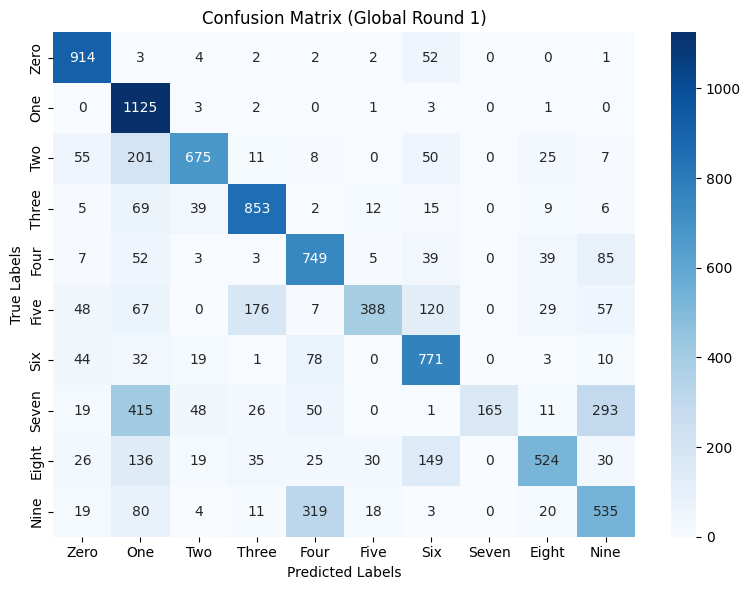


 | Global training round : 2/20 |

Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 37 to flip class  7  to class  1
Label flipping attack launched by Peer 46 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 18 to flip class  7  to class  1
Label flipping attack launched b

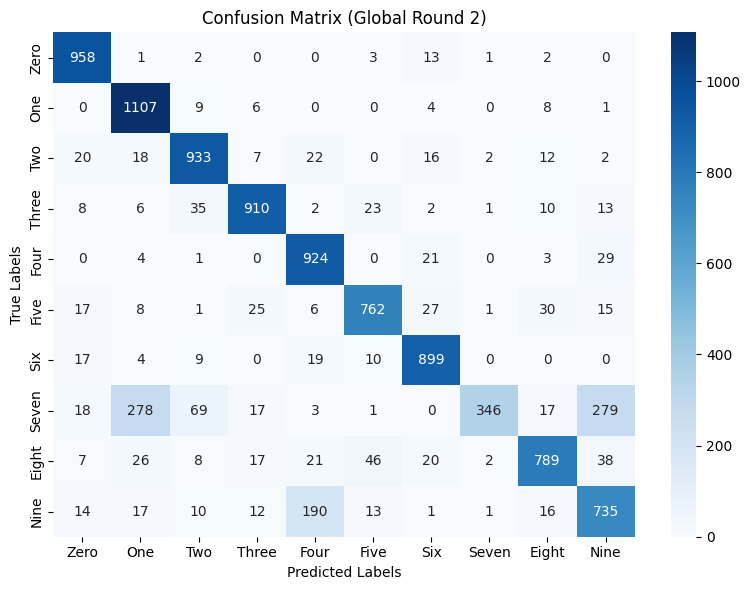


 | Global training round : 3/20 |

Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 46 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 13 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 18 to flip class  7  to class  1
Label flipping attack launched by

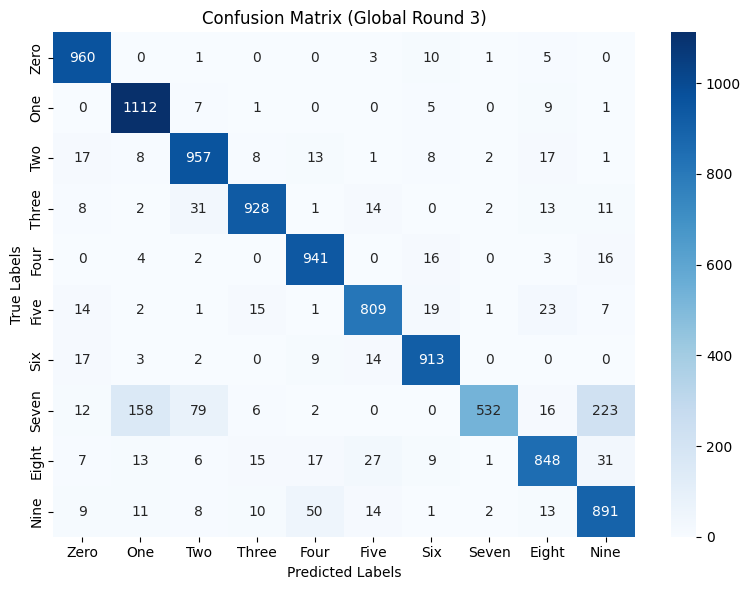


 | Global training round : 4/20 |

Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 18 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched b

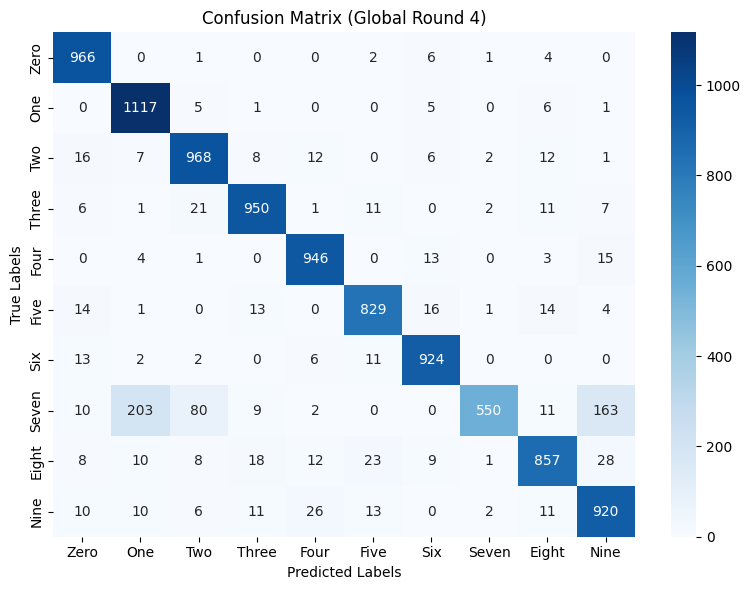


 | Global training round : 5/20 |

Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 37 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched b

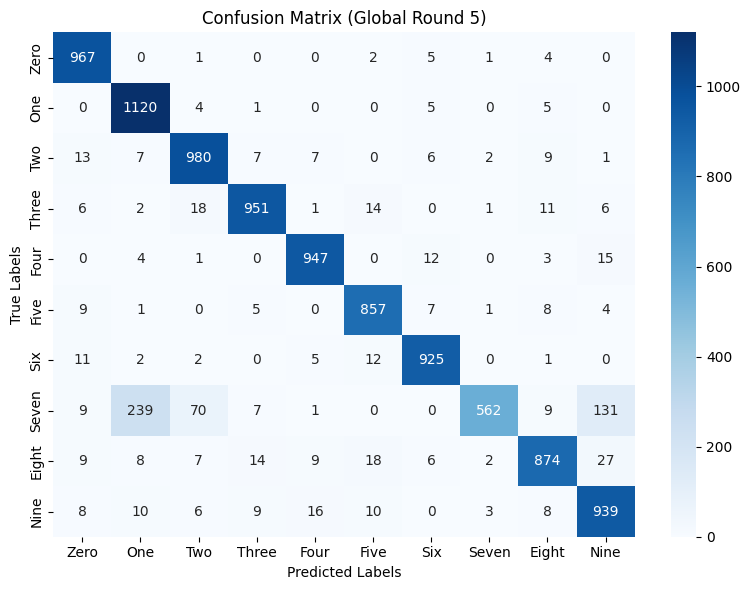


 | Global training round : 6/20 |

Label flipping attack launched by Peer 37 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 13 to flip class  7  to class  1
Label flipping attack launched by Peer 46 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by 

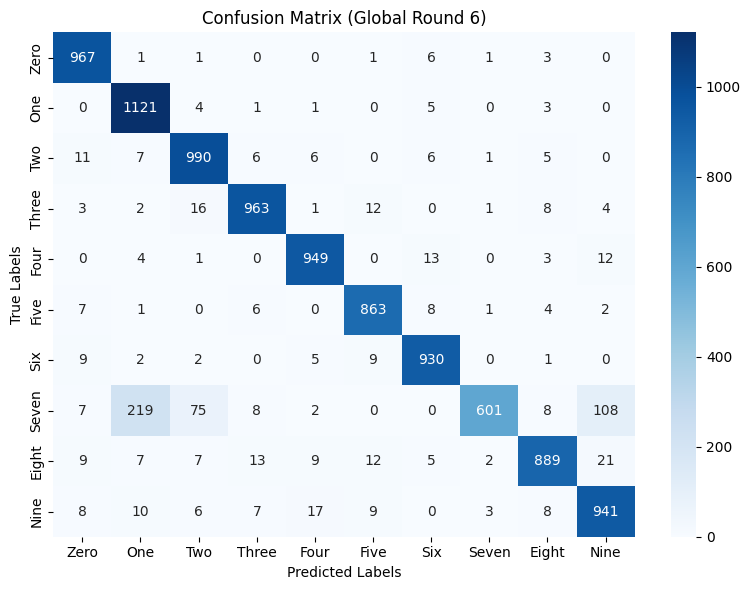


 | Global training round : 7/20 |

Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 18 to flip class  7  to class  1
Label flipping attack launched by Peer 37 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by

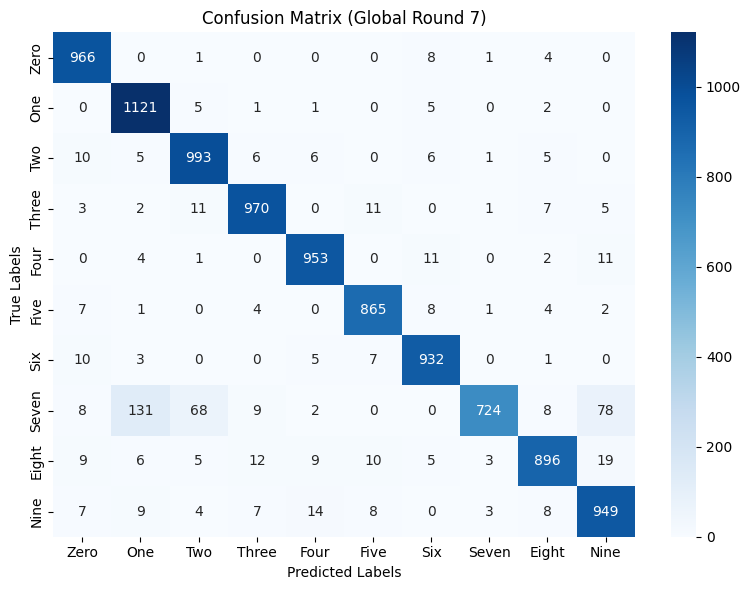


 | Global training round : 8/20 |

Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 18 to flip class  7  to class  1
Label flipping attack launched by Peer 37 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 13 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched

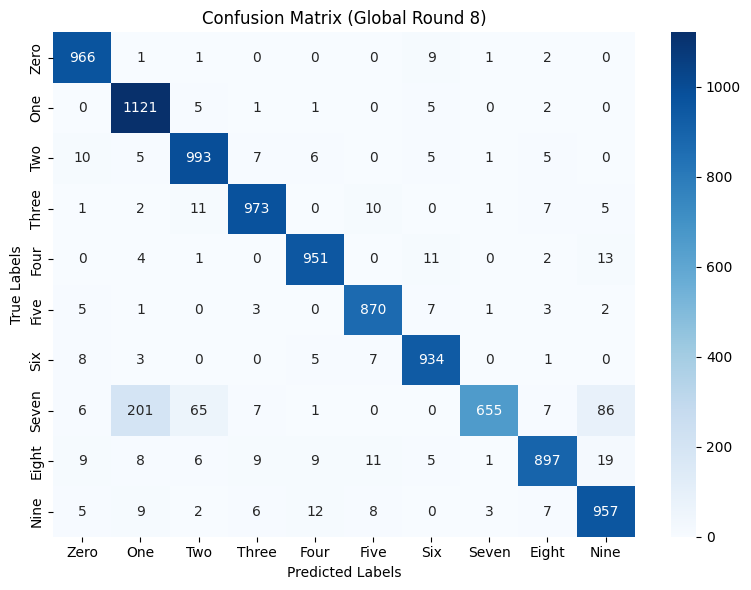


 | Global training round : 9/20 |

Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 18 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 37 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 46 to flip class  7  to class  1
Label flipping attack launched 

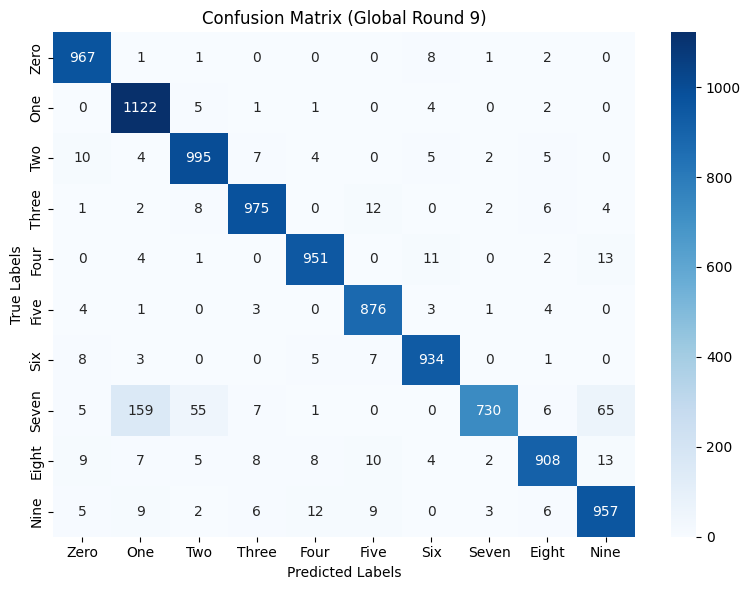


 | Global training round : 10/20 |

Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 46 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 18 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 37 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched 

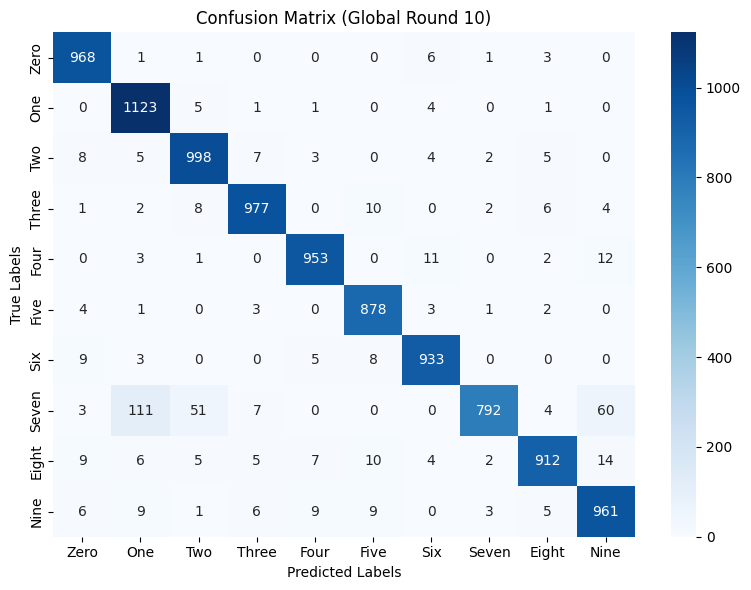


 | Global training round : 11/20 |

Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 46 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 18 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched 

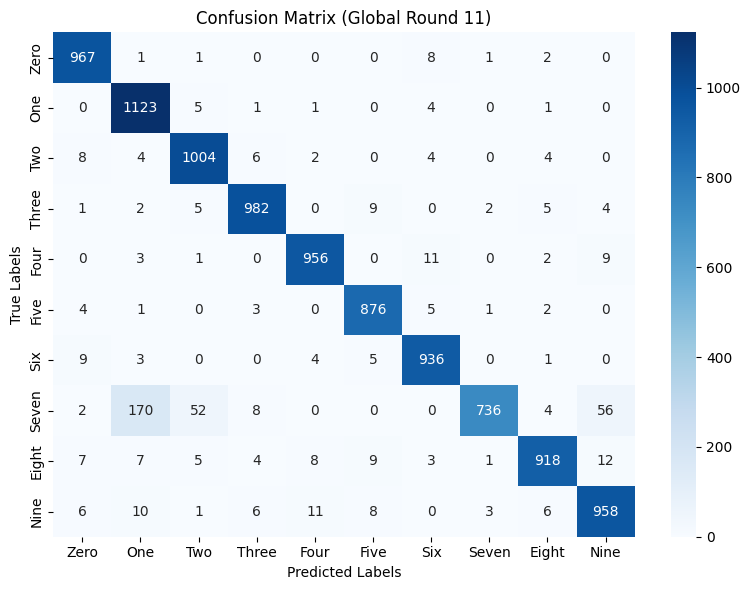


 | Global training round : 12/20 |

Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 37 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 46 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched 

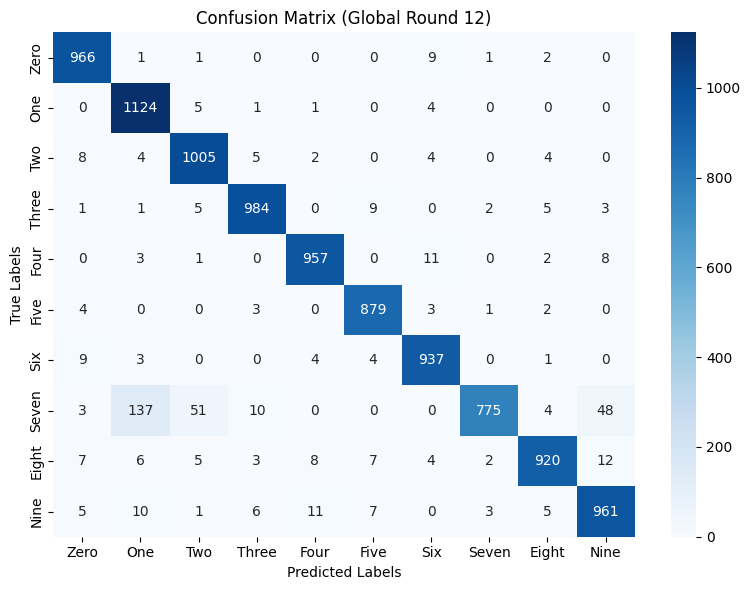


 | Global training round : 13/20 |

Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 18 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 37 to flip class  7  to class  1
Label flipping attack launched by Peer 46 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched 

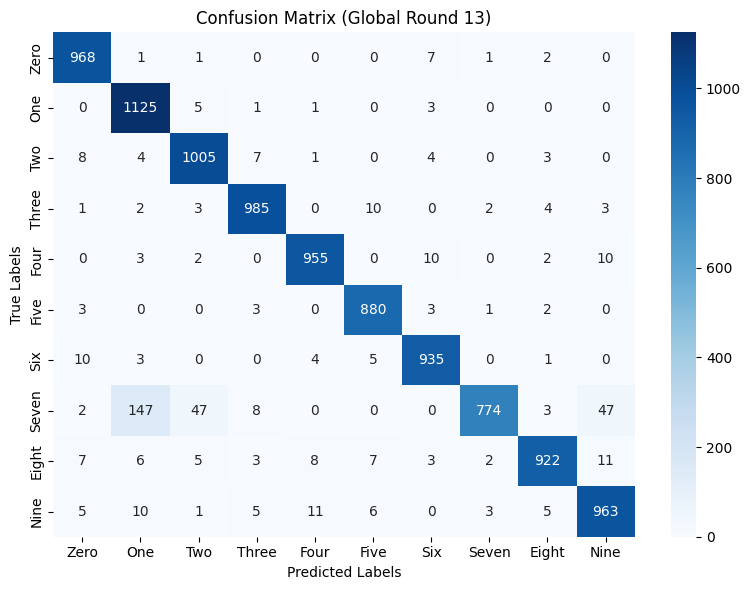


 | Global training round : 14/20 |

Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 13 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 18 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched b

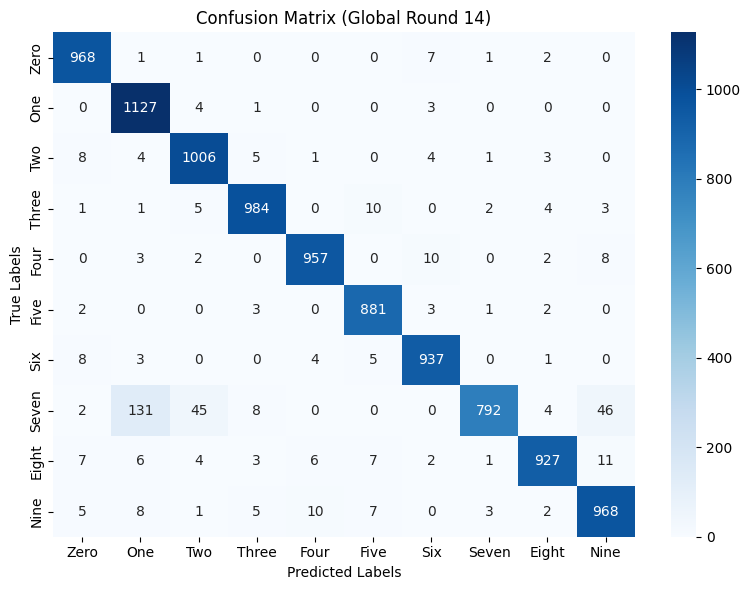


 | Global training round : 15/20 |

Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 46 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 13 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 37 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched 

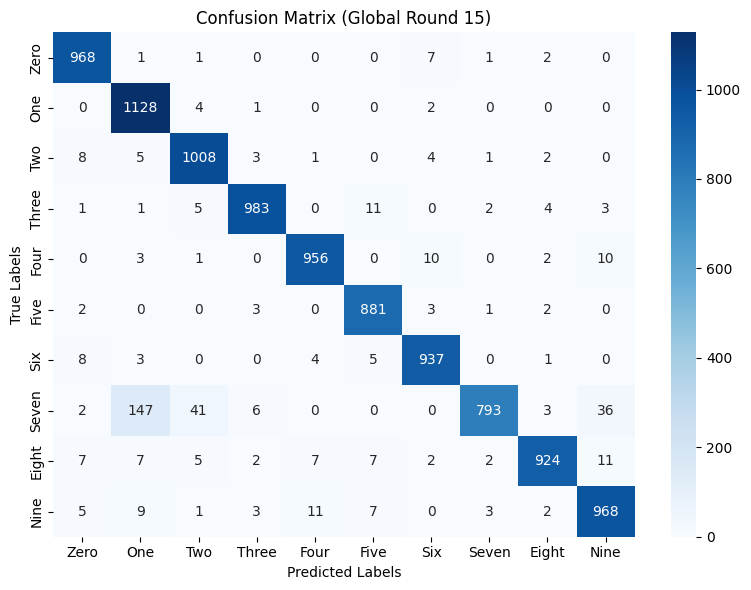


 | Global training round : 16/20 |

Label flipping attack launched by Peer 46 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 18 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 37 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched

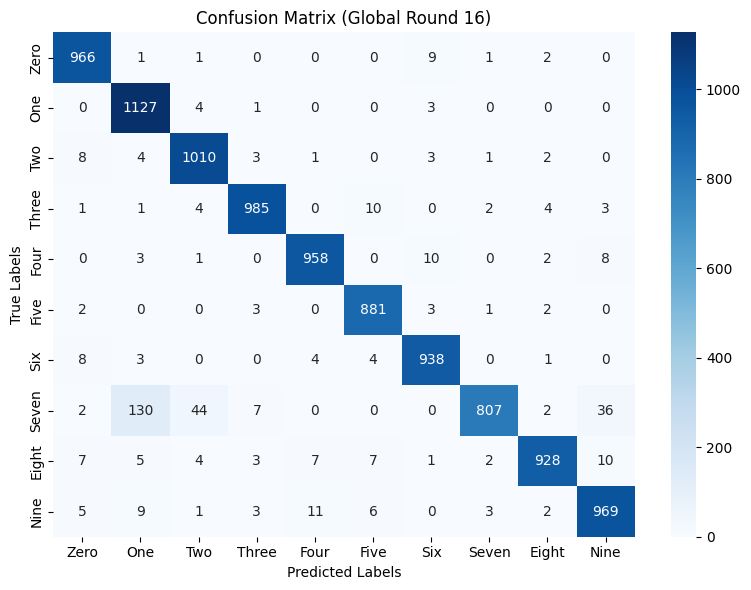


 | Global training round : 17/20 |

Label flipping attack launched by Peer 13 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 18 to flip class  7  to class  1
Label flipping attack launched by Peer 37 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 46 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launche

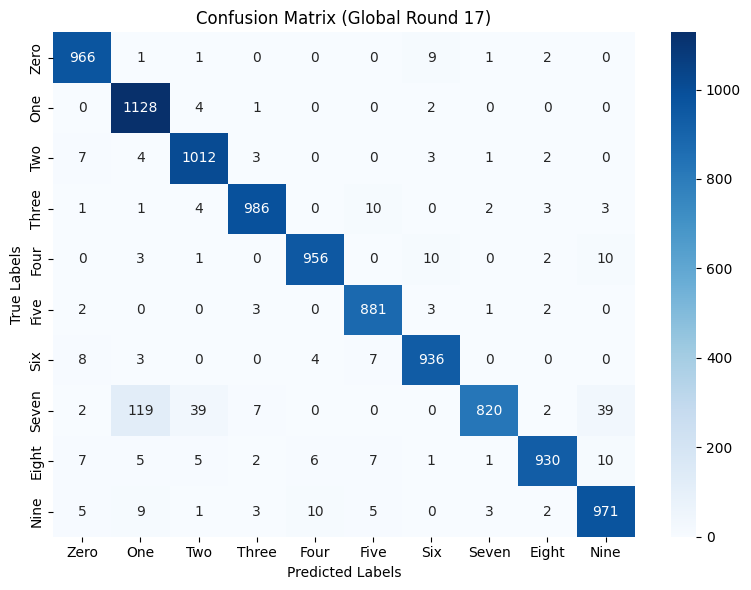


 | Global training round : 18/20 |

Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 37 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched b

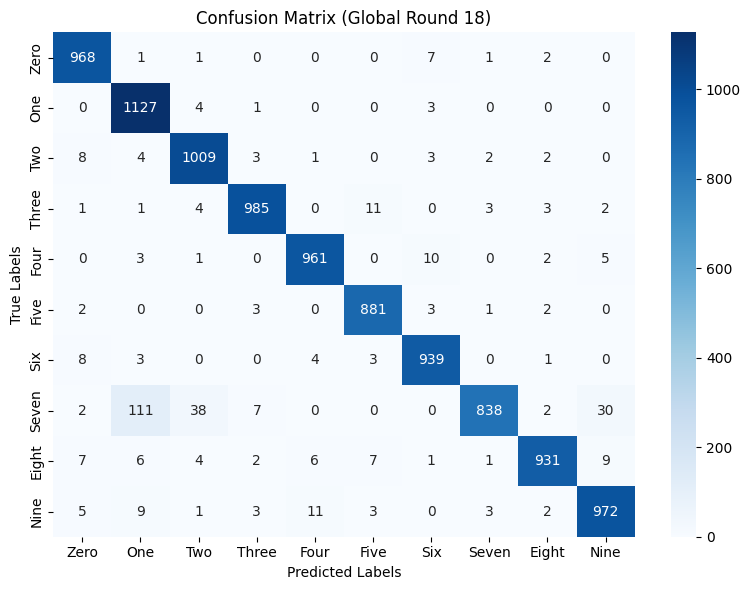


 | Global training round : 19/20 |

Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 18 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 46 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 37 to flip class  7  to class  1
Label flipping attack launched 

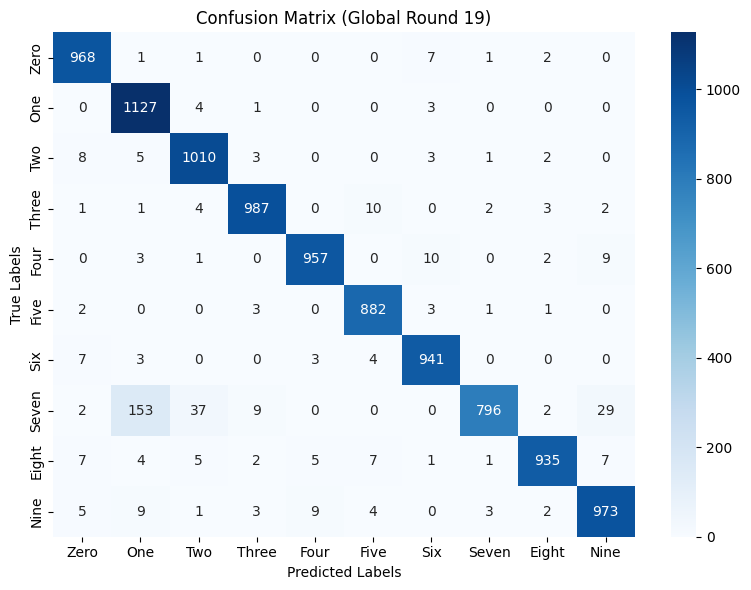


 | Global training round : 20/20 |

Label flipping attack launched by Peer 46 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 18 to flip class  7  to class  1
Label flipping attack launched b

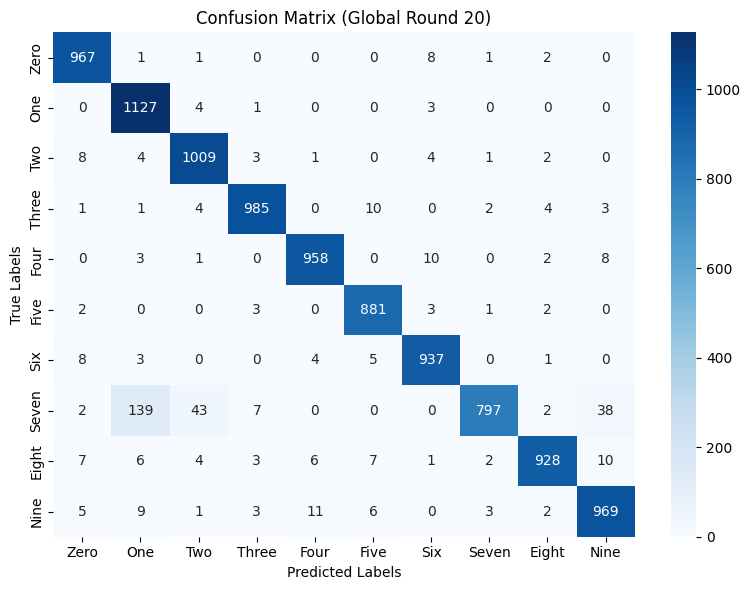

Global accuracies:  [np.float64(66.99), np.float64(83.63), np.float64(88.91), np.float64(90.27), np.float64(91.22), np.float64(92.14), np.float64(93.69), np.float64(93.17), np.float64(94.15), np.float64(94.95), np.float64(94.56), np.float64(95.08), np.float64(95.12), np.float64(95.47), np.float64(95.46), np.float64(95.69), np.float64(95.86), np.float64(96.11), np.float64(95.76), np.float64(96.26), np.float64(95.58)]
Class 7 accuracies:  [np.float64(16.05), np.float64(33.66), np.float64(51.75), np.float64(53.5), np.float64(54.67), np.float64(58.46), np.float64(70.43), np.float64(63.72), np.float64(71.01), np.float64(77.04), np.float64(71.6), np.float64(75.39), np.float64(75.29), np.float64(77.04), np.float64(77.14), np.float64(78.5), np.float64(79.77), np.float64(81.52), np.float64(77.43), np.float64(82.1), np.float64(77.53)]
Test loss: [np.float64(1.4701), np.float64(0.5303), np.float64(0.3615), np.float64(0.2936), np.float64(0.2582), np.float64(0.2346), np.float64(0.2024), np.float64(

In [ ]:
RULE = 'robutslfd'
ATTACK_TYPE='label_flipping'
MALICIOUS_BEHAVIOR_RATE = 1
for atr in [0.4]:
    run_exp(dataset_name = DATASET_NAME, model_name = MODEL_NAME, dd_type = DD_TYPE, num_peers = NUM_PEERS,
            frac_peers = FRAC_PEERS, seed = SEED, test_batch_size = TEST_BATCH_SIZE,
                criterion = CRITERION, global_rounds = GLOBAL_ROUNDS, local_epochs = LOCAL_EPOCHS, local_bs = LOCAL_BS,
                 local_lr = LOCAL_LR, local_momentum = LOCAL_MOMENTUM, labels_dict = LABELS_DICT, device = DEVICE,
                attackers_ratio = atr, attack_type=ATTACK_TYPE,
                 malicious_behavior_rate = MALICIOUS_BEHAVIOR_RATE, rule = RULE,
                source_class = SOURCE_CLASS, target_class = TARGET_CLASS,
               class_per_peer = CLASS_PER_PEER, samples_per_class = SAMPLES_PER_CLASS,
               rate_unbalance = RATE_UNBALANCE, alpha = ALPHA, resume = False)


Our algo, CIFAR, IID

In [ ]:
#=============================== Defining global variables ========================#
DATASET_NAME = "CIFAR10"
MODEL_NAME = "ResNet18"
DD_TYPE = 'IID'
ALPHA = 1
NUM_PEERS = 20 # "number of peers: K"
FRAC_PEERS = 1 #'the fraction of peers: C to bel selected in each round'
SEED = 7 #fixed seed
random.seed(SEED)
CRITERION = nn.CrossEntropyLoss()
GLOBAL_ROUNDS = 20 #"number of rounds of federated model training"
LOCAL_EPOCHS = 3 #"the number of local epochs: E for each peer"
TEST_BATCH_SIZE = 1000
LOCAL_BS = 32 #"local batch size: B for each peer"
LOCAL_LR =  0.01#local learning rate: lr for each peer
LOCAL_MOMENTUM = 0.9 #local momentum for each peer
NUM_CLASSES = 10 # number of classes in an experiment
LABELS_DICT = {'Plane':0,
               'Car':1,
               'Bird':2,
               'Cat':3,
               'Deer':4,
               'Dog':5,
               'Frog':6,
               'Horse':7,
               'Ship':8,
               'Truck':9}

#select the device to work with cpu or gpu
if torch.cuda.is_available():
    DEVICE = "cuda"
else:
    DEVICE = "cpu"
DEVICE = torch.device(DEVICE)
print(DEVICE)
SOURCE_CLASS = 5 # the source class
TARGET_CLASS = 3 # the target class

CLASS_PER_PEER = 1
SAMPLES_PER_CLASS = 582
RATE_UNBALANCE = 1


cuda



--> Label FLIP experiment on our algo...
--> Loading of CIFAR10 dataset
--> Dataset has been loaded!
--> Creating ResNet18 model.....
--> Model has been created!
--> Distributing training data among peers
--> Training data have been distributed among peers
--> Creating peets instances
Data set: CIFAR10
Data distribution: IID
Aggregation rule: robutslfd
Attack Type: label_flipping
Attackers Ratio: 40.0 %
Malicious Behavior Rate: 100 %

===>Simulation started...

====>Global model training started...



  0%|          | 0/20 [00:00<?, ?it/s]


 | Global training round : 1/20 |

Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 2.3856, Test accuracy: 1000/10000 (10.00%)

Class      - Accuracy
Plane      - 0.0
Car        - 0.0
Bird       - 0.0
Cat        - 100.0
Deer       - 0.0
Dog        - 0.0
Frog       - 0.0
Horse      - 0.0
Ship       - 0.0
Truck      - 0.0


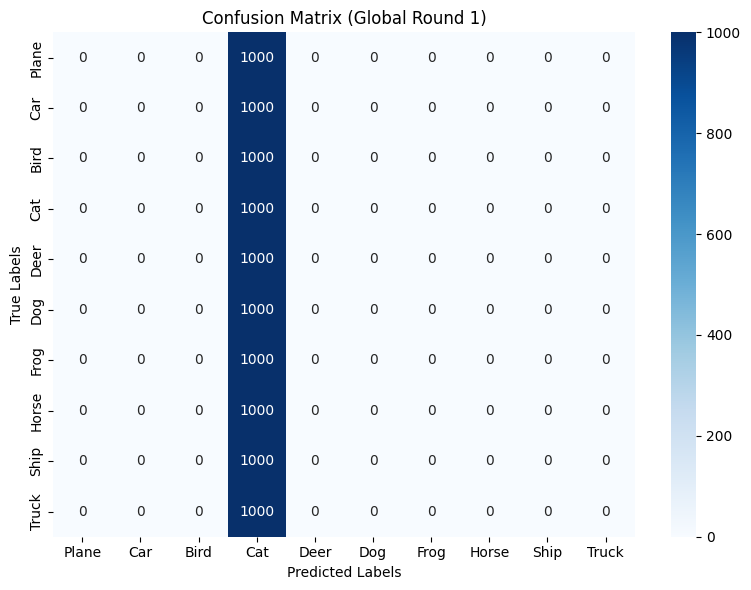


 | Global training round : 2/20 |

Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 2.3254, Test accuracy: 1384/10000 (13.84%)

Class      - Accuracy
Plane      - 29.8
Car        - 0.0
Bird       - 9.6
Cat        - 99.0
Deer       - 0.0
Dog        - 0.0
Frog       - 0.0
Horse      - 0.0
Ship       - 0.0
Truck      - 0.0


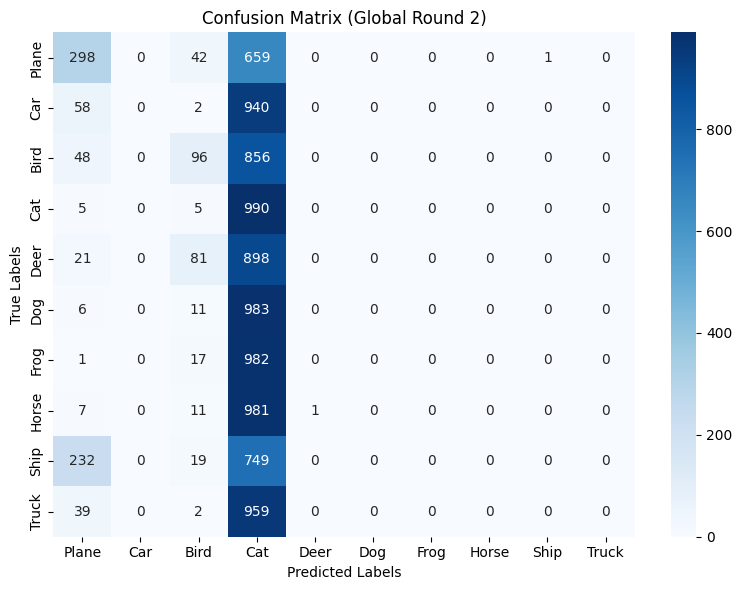


 | Global training round : 3/20 |

Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.8798, Test accuracy: 3478/10000 (34.78%)

Class      - Accuracy
Plane      - 30.4
Car        - 17.9
Bird       - 14.3
Cat        - 57.2
Deer       - 76.2
Dog        - 0.0
Frog       - 39.8
Horse      - 23.5
Ship       - 71.4
Truck      - 17.1


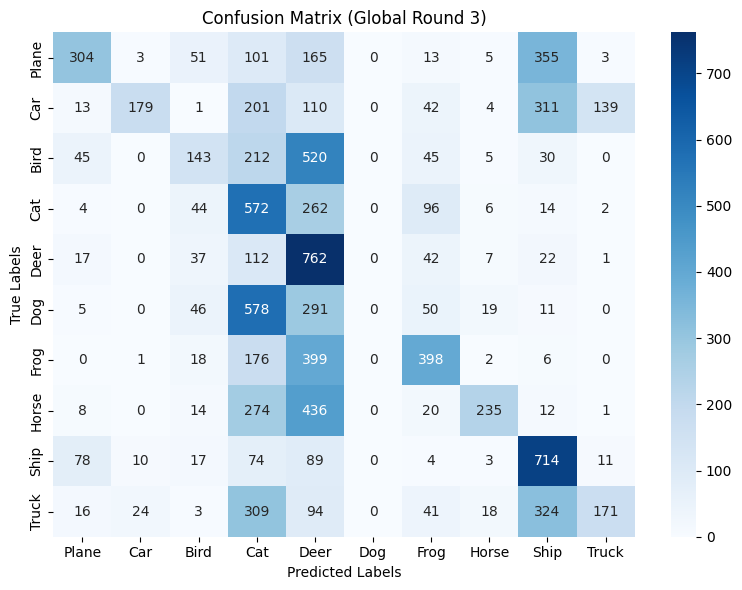


 | Global training round : 4/20 |

Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.5237, Test accuracy: 4835/10000 (48.35%)

Class      - Accuracy
Plane      - 40.2
Car        - 53.4
Bird       - 23.8
Cat        - 48.4
Deer       - 61.8
Dog        - 0.0
Frog       - 70.4
Horse      - 61.0
Ship       - 78.0
Truck      - 46.5


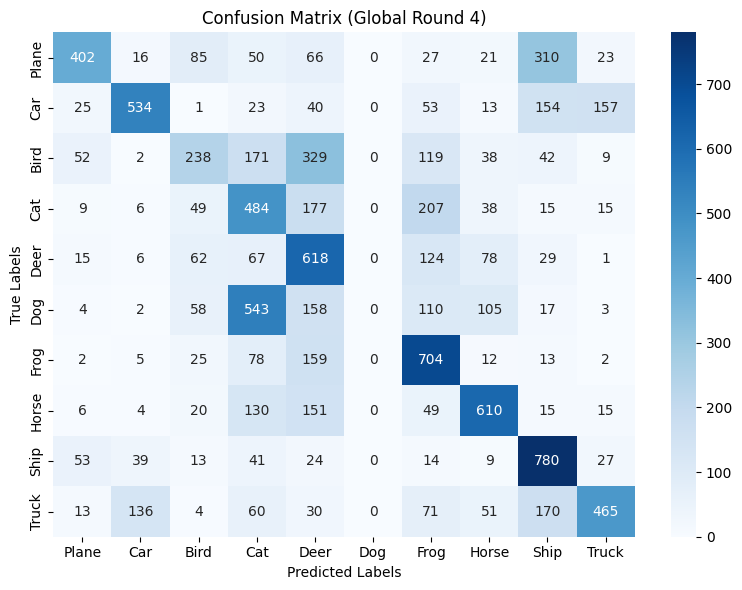


 | Global training round : 5/20 |

Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.3634, Test accuracy: 5401/10000 (54.01%)

Class      - Accuracy
Plane      - 51.2
Car        - 61.9
Bird       - 30.4
Cat        - 55.7
Deer       - 62.3
Dog        - 0.0
Frog       - 74.2
Horse      - 61.5
Ship       - 83.9
Truck      - 59.0


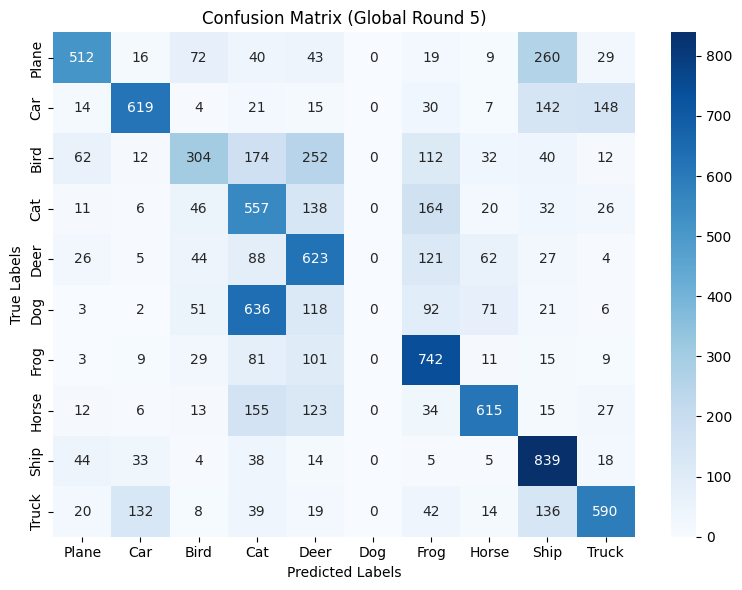


 | Global training round : 6/20 |

Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.2754, Test accuracy: 5813/10000 (58.13%)

Class      - Accuracy
Plane      - 56.8
Car        - 73.0
Bird       - 33.2
Cat        - 61.4
Deer       - 68.6
Dog        - 0.0
Frog       - 77.8
Horse      - 67.2
Ship       - 82.0
Truck      - 61.3


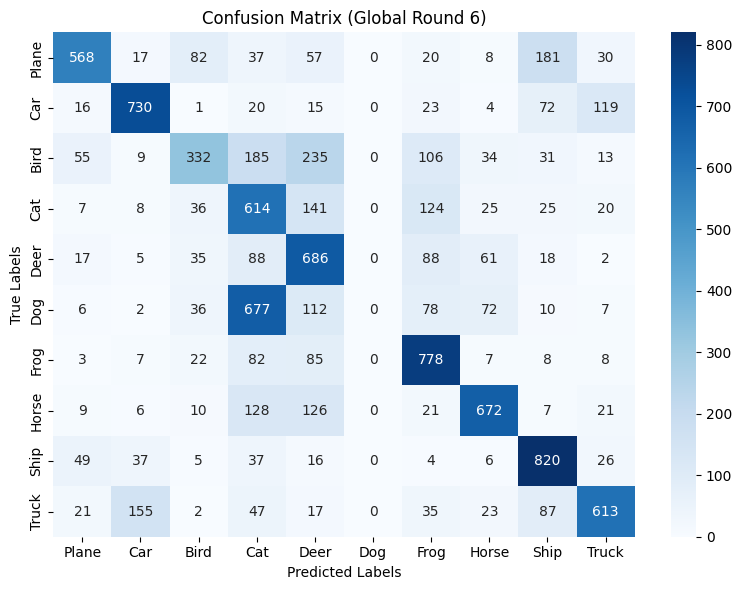


 | Global training round : 7/20 |

Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.2718, Test accuracy: 5939/10000 (59.39%)

Class      - Accuracy
Plane      - 53.4
Car        - 74.7
Bird       - 37.3
Cat        - 59.2
Deer       - 67.7
Dog        - 0.6
Frog       - 84.2
Horse      - 67.6
Ship       - 85.6
Truck      - 63.6


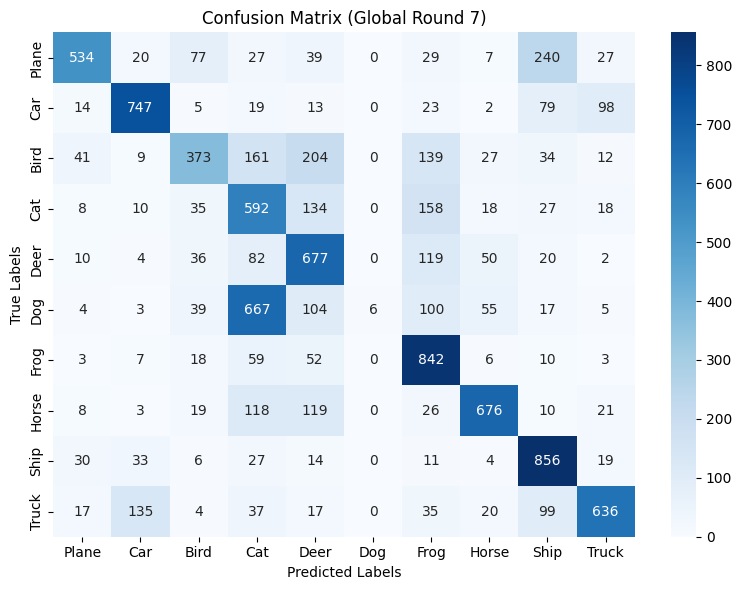


 | Global training round : 8/20 |

Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.2260, Test accuracy: 6204/10000 (62.04%)

Class      - Accuracy
Plane      - 61.9
Car        - 77.3
Bird       - 38.9
Cat        - 62.8
Deer       - 72.7
Dog        - 1.8
Frog       - 81.8
Horse      - 71.2
Ship       - 85.8
Truck      - 66.2


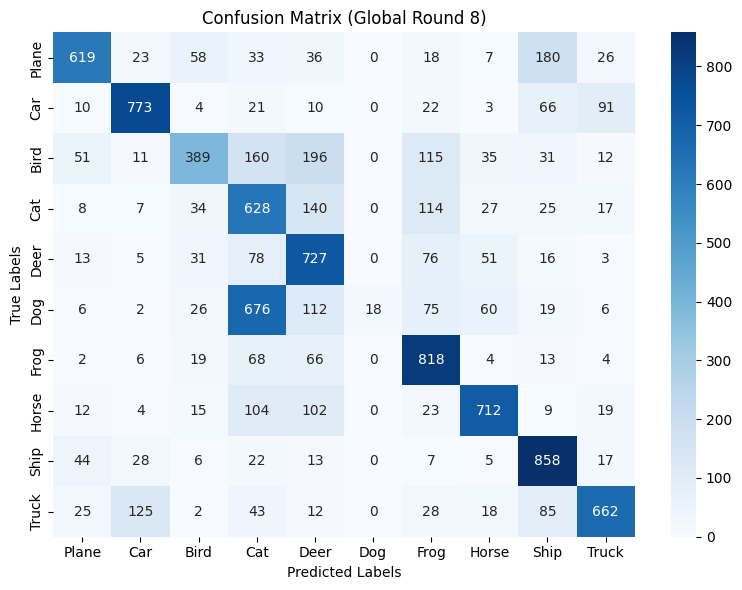


 | Global training round : 9/20 |

Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.1923, Test accuracy: 6350/10000 (63.50%)

Class      - Accuracy
Plane      - 70.6
Car        - 78.2
Bird       - 37.7
Cat        - 63.0
Deer       - 74.4
Dog        - 3.2
Frog       - 79.0
Horse      - 71.8
Ship       - 85.4
Truck      - 71.7


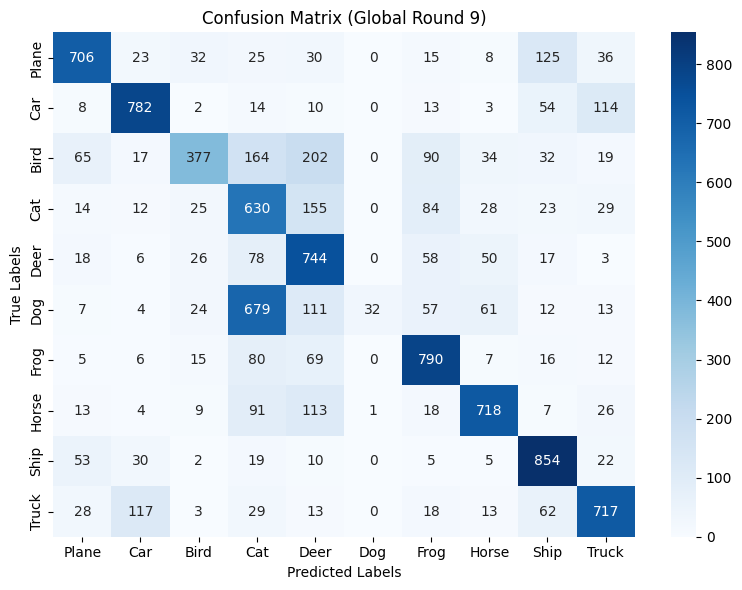


 | Global training round : 10/20 |

Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.2178, Test accuracy: 6408/10000 (64.08%)

Class      - Accuracy
Plane      - 69.1
Car        - 76.9
Bird       - 37.9
Cat        - 65.8
Deer       - 77.4
Dog        - 3.7
Frog       - 82.3
Horse      - 70.2
Ship       - 84.3
Truck      - 73.2


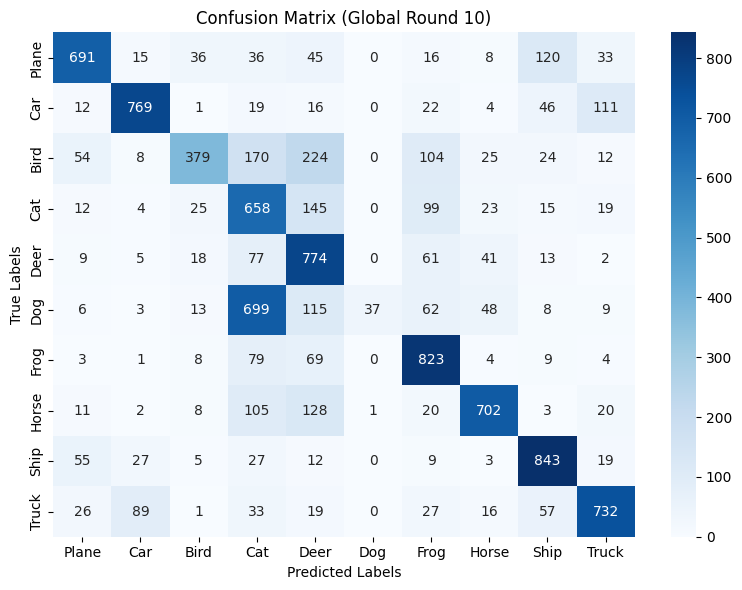


 | Global training round : 11/20 |

Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.1697, Test accuracy: 6540/10000 (65.40%)

Class      - Accuracy
Plane      - 69.2
Car        - 80.2
Bird       - 44.6
Cat        - 66.1
Deer       - 76.1
Dog        - 4.4
Frog       - 81.6
Horse      - 71.8
Ship       - 86.9
Truck      - 73.1


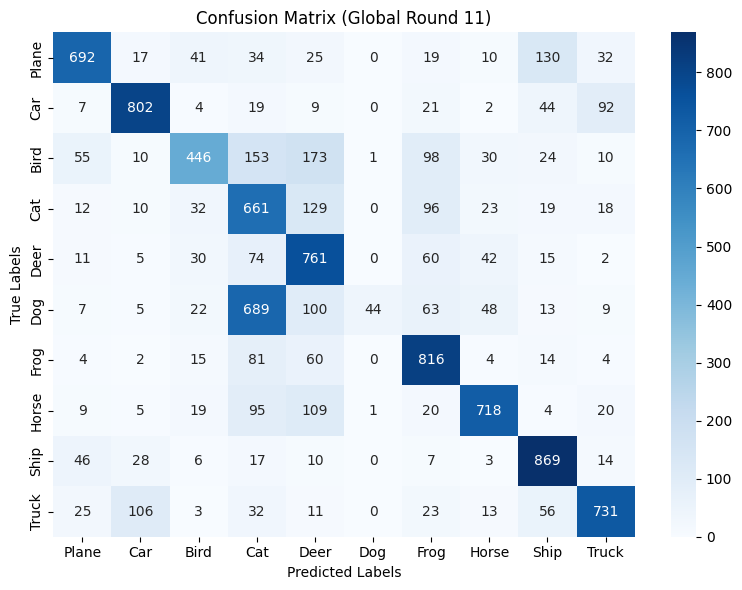


 | Global training round : 12/20 |

Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.1701, Test accuracy: 6626/10000 (66.26%)

Class      - Accuracy
Plane      - 69.0
Car        - 77.7
Bird       - 48.2
Cat        - 68.1
Deer       - 76.0
Dog        - 6.8
Frog       - 82.6
Horse      - 73.6
Ship       - 86.0
Truck      - 74.6


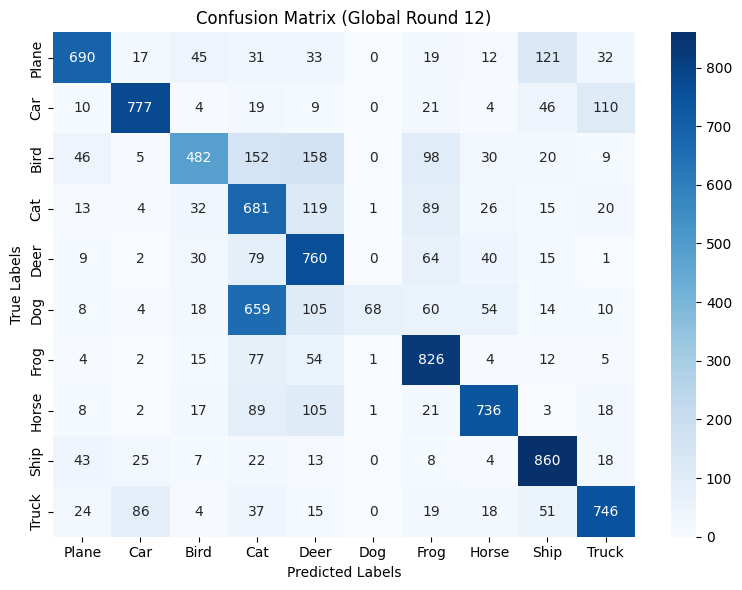


 | Global training round : 13/20 |

Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.1376, Test accuracy: 6771/10000 (67.71%)

Class      - Accuracy
Plane      - 75.8
Car        - 81.1
Bird       - 45.7
Cat        - 70.7
Deer       - 77.4
Dog        - 8.8
Frog       - 80.6
Horse      - 76.6
Ship       - 85.4
Truck      - 75.0


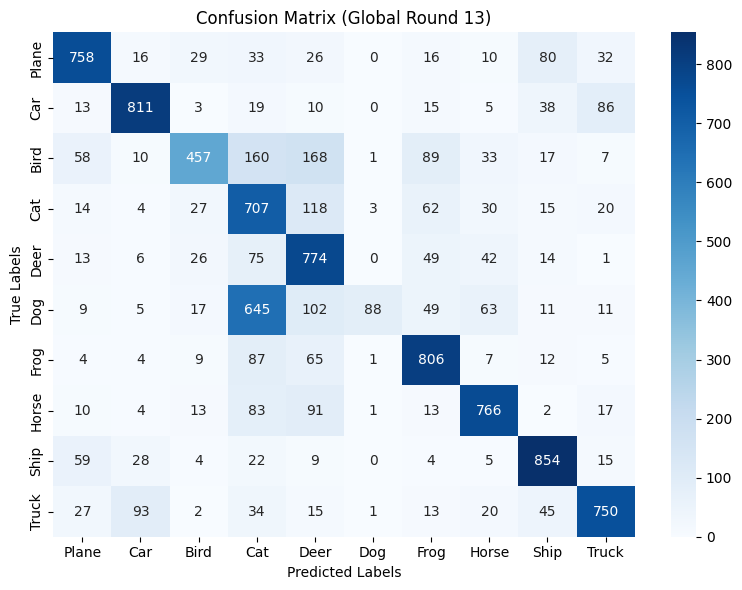


 | Global training round : 14/20 |

Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.1087, Test accuracy: 6812/10000 (68.12%)

Class      - Accuracy
Plane      - 76.4
Car        - 81.8
Bird       - 48.3
Cat        - 64.6
Deer       - 79.1
Dog        - 9.8
Frog       - 83.1
Horse      - 75.2
Ship       - 86.4
Truck      - 76.5


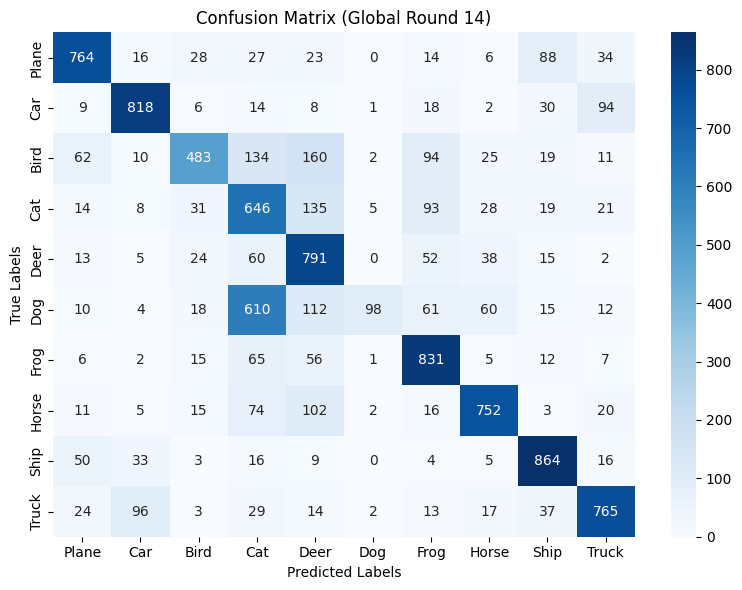


 | Global training round : 15/20 |

Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.1673, Test accuracy: 6770/10000 (67.70%)

Class      - Accuracy
Plane      - 74.7
Car        - 82.4
Bird       - 47.0
Cat        - 69.6
Deer       - 77.5
Dog        - 5.9
Frog       - 82.8
Horse      - 74.7
Ship       - 87.3
Truck      - 75.1


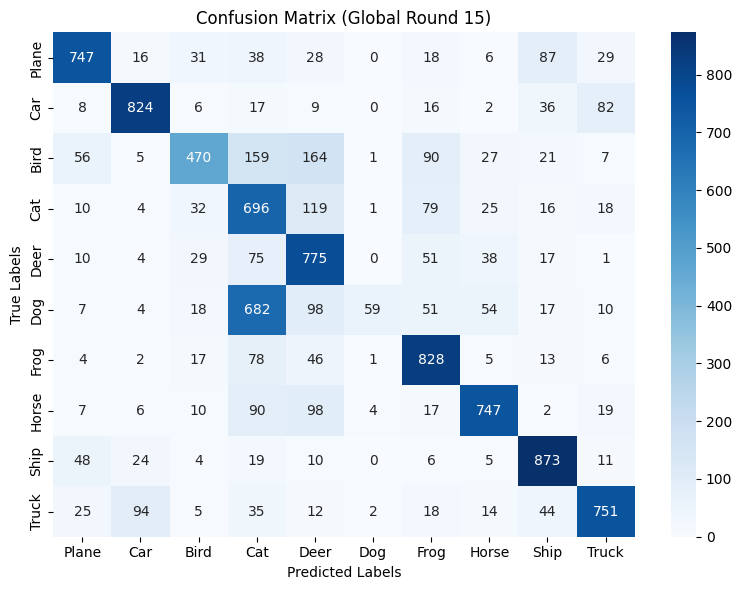


 | Global training round : 16/20 |

Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.1421, Test accuracy: 6825/10000 (68.25%)

Class      - Accuracy
Plane      - 75.5
Car        - 81.1
Bird       - 49.2
Cat        - 66.0
Deer       - 75.6
Dog        - 9.9
Frog       - 86.2
Horse      - 76.6
Ship       - 86.9
Truck      - 75.5


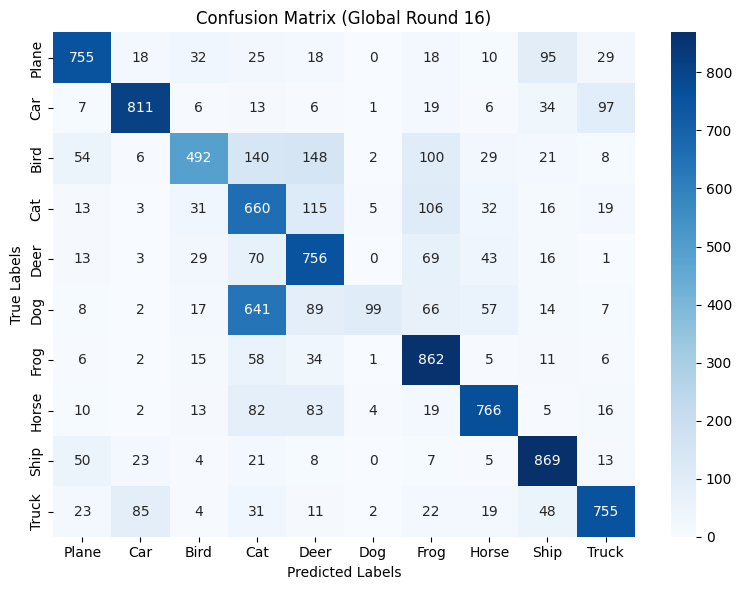


 | Global training round : 17/20 |

Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.1150, Test accuracy: 6906/10000 (69.06%)

Class      - Accuracy
Plane      - 76.8
Car        - 82.0
Bird       - 51.5
Cat        - 68.6
Deer       - 78.3
Dog        - 11.7
Frog       - 83.3
Horse      - 76.7
Ship       - 85.1
Truck      - 76.6


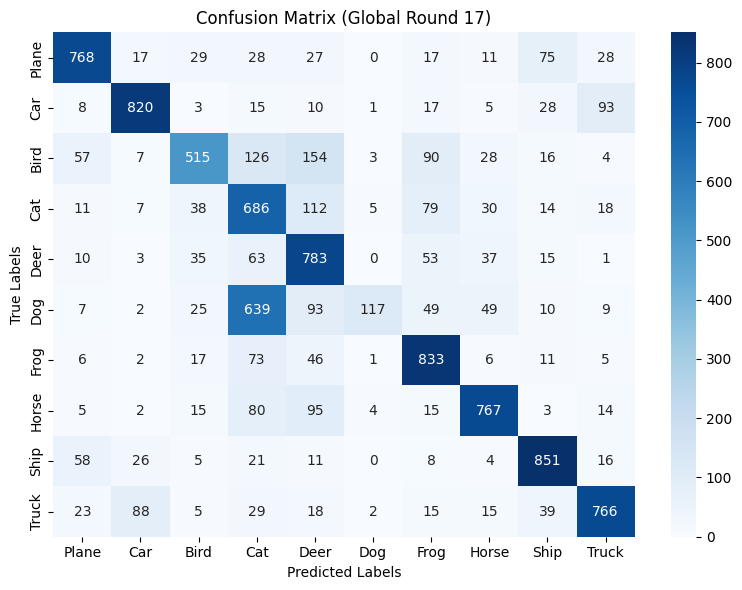


 | Global training round : 18/20 |

Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0977, Test accuracy: 6957/10000 (69.57%)

Class      - Accuracy
Plane      - 77.4
Car        - 83.1
Bird       - 50.9
Cat        - 70.0
Deer       - 76.7
Dog        - 12.5
Frog       - 84.9
Horse      - 77.9
Ship       - 86.7
Truck      - 75.6


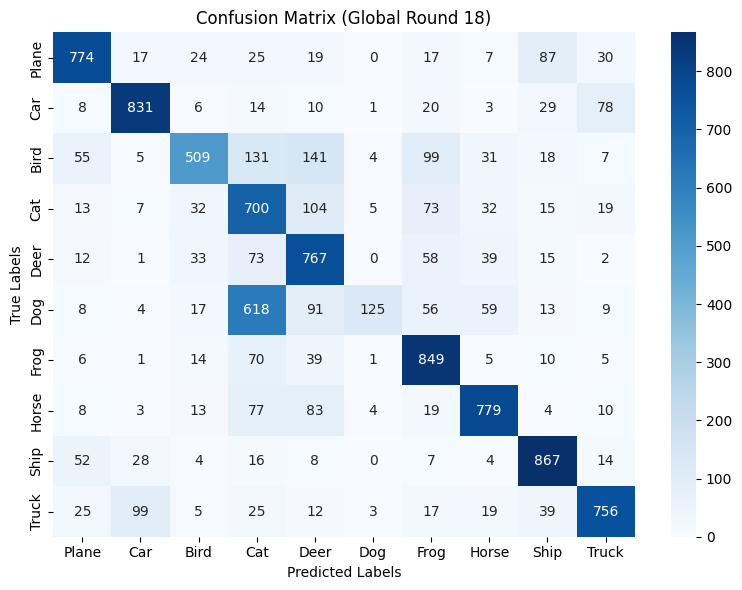


 | Global training round : 19/20 |

Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.1209, Test accuracy: 6970/10000 (69.70%)

Class      - Accuracy
Plane      - 77.5
Car        - 82.7
Bird       - 53.4
Cat        - 72.7
Deer       - 76.7
Dog        - 10.6
Frog       - 83.7
Horse      - 76.6
Ship       - 84.8
Truck      - 78.3


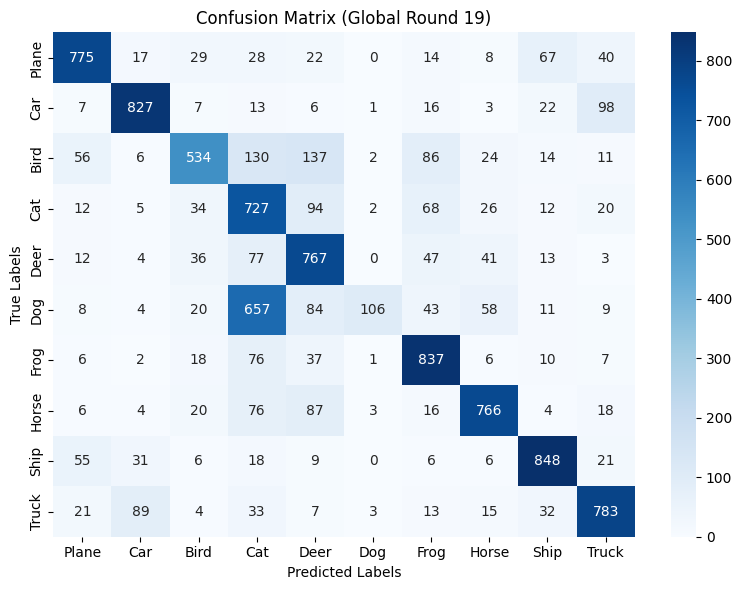


 | Global training round : 20/20 |

Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0889, Test accuracy: 6977/10000 (69.77%)

Class      - Accuracy
Plane      - 76.2
Car        - 83.6
Bird       - 53.8
Cat        - 69.1
Deer       - 76.8
Dog        - 13.3
Frog       - 84.2
Horse      - 76.5
Ship       - 87.3
Truck      - 76.9
Last 10 updates results

Average test loss: 1.1189, Test accuracy: 6818/10000 (68.18%)

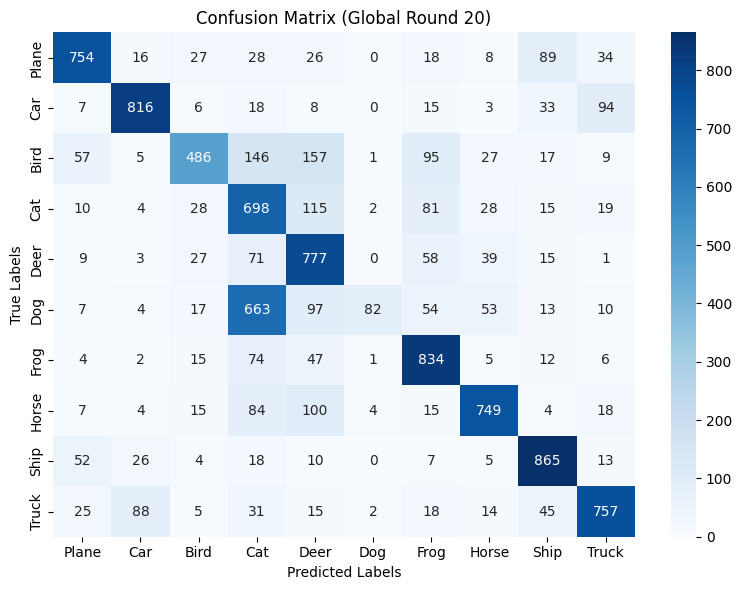

Global accuracies:  [np.float64(10.0), np.float64(13.84), np.float64(34.78), np.float64(48.35), np.float64(54.01), np.float64(58.13), np.float64(59.39), np.float64(62.04), np.float64(63.5), np.float64(64.08), np.float64(65.4), np.float64(66.26), np.float64(67.71), np.float64(68.12), np.float64(67.7), np.float64(68.25), np.float64(69.06), np.float64(69.57), np.float64(69.7), np.float64(69.77), np.float64(68.18)]
Class 5 accuracies:  [np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.6), np.float64(1.8), np.float64(3.2), np.float64(3.7), np.float64(4.4), np.float64(6.8), np.float64(8.8), np.float64(9.8), np.float64(5.9), np.float64(9.9), np.float64(11.7), np.float64(12.5), np.float64(10.6), np.float64(13.3), np.float64(8.2)]
Test loss: [np.float64(2.3856), np.float64(2.3254), np.float64(1.8798), np.float64(1.5237), np.float64(1.3634), np.float64(1.2754), np.float64(1.2718), np.float64(1.226), np.float64(1.1923), np.float64(

In [ ]:
RULE = 'robutslfd'
ATTACK_TYPE='label_flipping'
MALICIOUS_BEHAVIOR_RATE = 1
for atr in [0.4]:
    run_exp(dataset_name = DATASET_NAME, model_name = MODEL_NAME, dd_type = DD_TYPE, num_peers = NUM_PEERS,
            frac_peers = FRAC_PEERS, seed = SEED, test_batch_size = TEST_BATCH_SIZE,
                criterion = CRITERION, global_rounds = GLOBAL_ROUNDS, local_epochs = LOCAL_EPOCHS, local_bs = LOCAL_BS,
                 local_lr = LOCAL_LR, local_momentum = LOCAL_MOMENTUM, labels_dict = LABELS_DICT, device = DEVICE,
                attackers_ratio = atr, attack_type=ATTACK_TYPE,
                 malicious_behavior_rate = MALICIOUS_BEHAVIOR_RATE, rule = RULE,
                source_class = SOURCE_CLASS, target_class = TARGET_CLASS,
               class_per_peer = CLASS_PER_PEER, samples_per_class = SAMPLES_PER_CLASS,
               rate_unbalance = RATE_UNBALANCE, alpha = ALPHA, resume = False)

Our lago,cifar NOn-IID

In [ ]:
#=============================== Defining global variables ========================#
DATASET_NAME = "CIFAR10"
MODEL_NAME = "ResNet18"
DD_TYPE = 'NON_IID'
ALPHA = 1
NUM_PEERS = 20 # "number of peers: K"
FRAC_PEERS = 1 #'the fraction of peers: C to bel selected in each round'
SEED = 7 #fixed seed
random.seed(SEED)
CRITERION = nn.CrossEntropyLoss()
GLOBAL_ROUNDS = 20 #"number of rounds of federated model training"
LOCAL_EPOCHS = 3 #"the number of local epochs: E for each peer"
TEST_BATCH_SIZE = 1000
LOCAL_BS = 32 #"local batch size: B for each peer"
LOCAL_LR =  0.01#local learning rate: lr for each peer
LOCAL_MOMENTUM = 0.9 #local momentum for each peer
NUM_CLASSES = 10 # number of classes in an experiment
LABELS_DICT = {'Plane':0,
               'Car':1,
               'Bird':2,
               'Cat':3,
               'Deer':4,
               'Dog':5,
               'Frog':6,
               'Horse':7,
               'Ship':8,
               'Truck':9}

#select the device to work with cpu or gpu
if torch.cuda.is_available():
    DEVICE = "cuda"
else:
    DEVICE = "cpu"
DEVICE = torch.device(DEVICE)
print(DEVICE)
SOURCE_CLASS = 5 # the source class
TARGET_CLASS = 3 # the target class

CLASS_PER_PEER = 1
SAMPLES_PER_CLASS = 582
RATE_UNBALANCE = 1


cuda



--> Label FLIP experiment on our algo...
--> Loading of CIFAR10 dataset
--> Dataset has been loaded!
--> Creating ResNet18 model.....
--> Model has been created!
--> Distributing training data among peers
--> Training data have been distributed among peers
--> Creating peets instances
Data set: CIFAR10
Data distribution: NON_IID
Aggregation rule: robutslfd
Attack Type: label_flipping
Attackers Ratio: 40.0 %
Malicious Behavior Rate: 100 %

===>Simulation started...

====>Global model training started...



  0%|          | 0/20 [00:00<?, ?it/s]


 | Global training round : 1/20 |

Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 2.3930, Test accuracy: 1000/10000 (10.00%)

Class      - Accuracy
Plane      - 0.0
Car        - 0.0
Bird       - 0.0
Cat        - 100.0
Deer       - 0.0
Dog        - 0.0
Frog       - 0.0
Horse      - 0.0
Ship       - 0.0
Truck      - 0.0


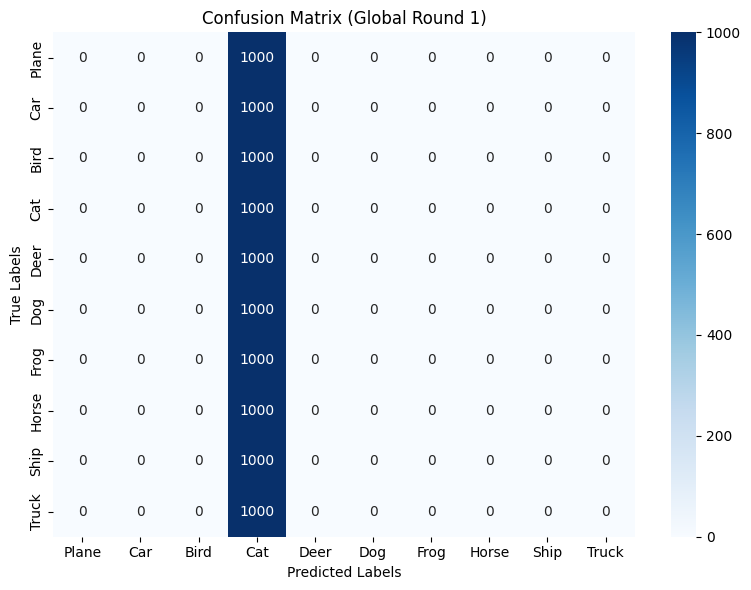


 | Global training round : 2/20 |

Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 2.3276, Test accuracy: 1034/10000 (10.34%)

Class      - Accuracy
Plane      - 3.4
Car        - 0.0
Bird       - 0.0
Cat        - 100.0
Deer       - 0.0
Dog        - 0.0
Frog       - 0.0
Horse      - 0.0
Ship       - 0.0
Truck      - 0.0


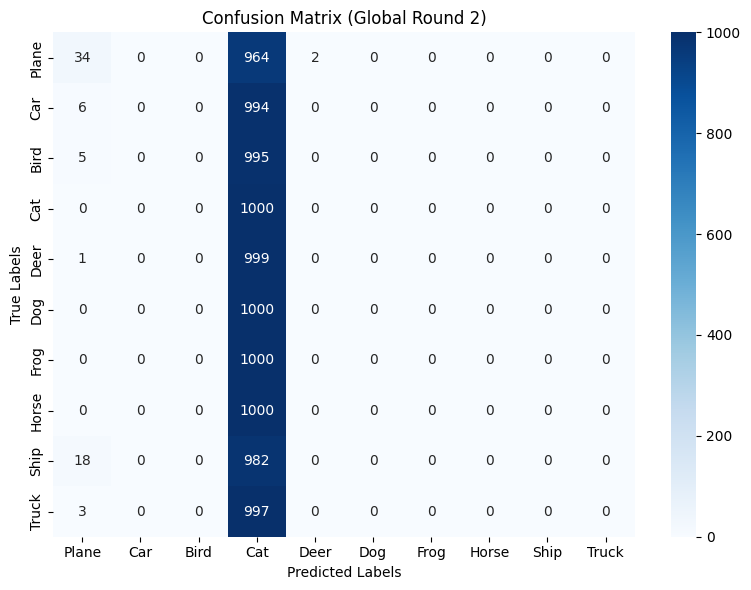


 | Global training round : 3/20 |

Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 2.0788, Test accuracy: 2480/10000 (24.80%)

Class      - Accuracy
Plane      - 39.5
Car        - 16.7
Bird       - 0.3
Cat        - 56.3
Deer       - 87.3
Dog        - 0.0
Frog       - 17.5
Horse      - 0.0
Ship       - 8.0
Truck      - 22.4


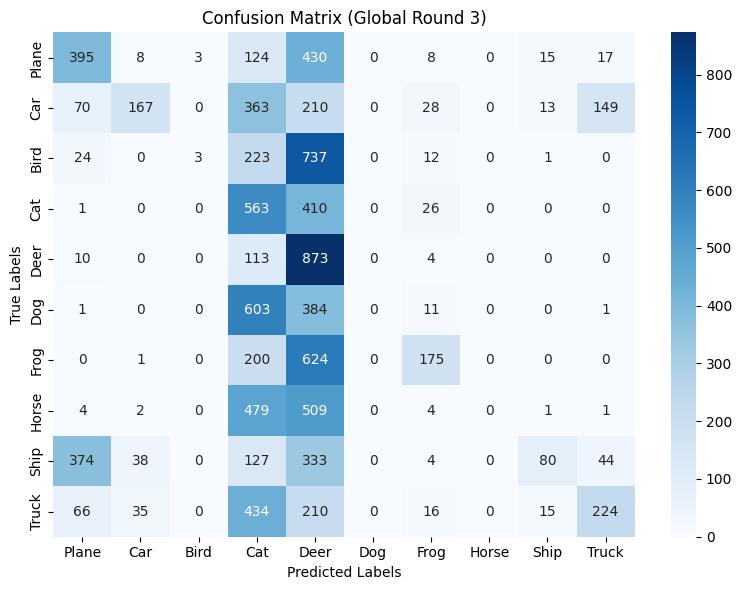


 | Global training round : 4/20 |

Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.6333, Test accuracy: 4393/10000 (43.93%)

Class      - Accuracy
Plane      - 52.9
Car        - 44.8
Bird       - 27.9
Cat        - 57.5
Deer       - 62.1
Dog        - 0.0
Frog       - 69.1
Horse      - 22.6
Ship       - 45.9
Truck      - 56.5


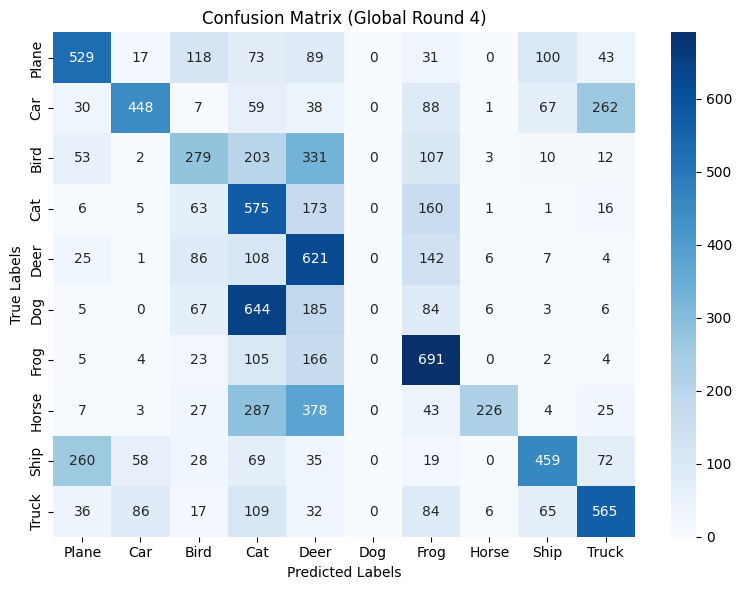


 | Global training round : 5/20 |

Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.4418, Test accuracy: 5177/10000 (51.77%)

Class      - Accuracy
Plane      - 55.7
Car        - 63.9
Bird       - 27.6
Cat        - 55.9
Deer       - 64.0
Dog        - 0.0
Frog       - 78.2
Horse      - 42.0
Ship       - 68.3
Truck      - 62.1


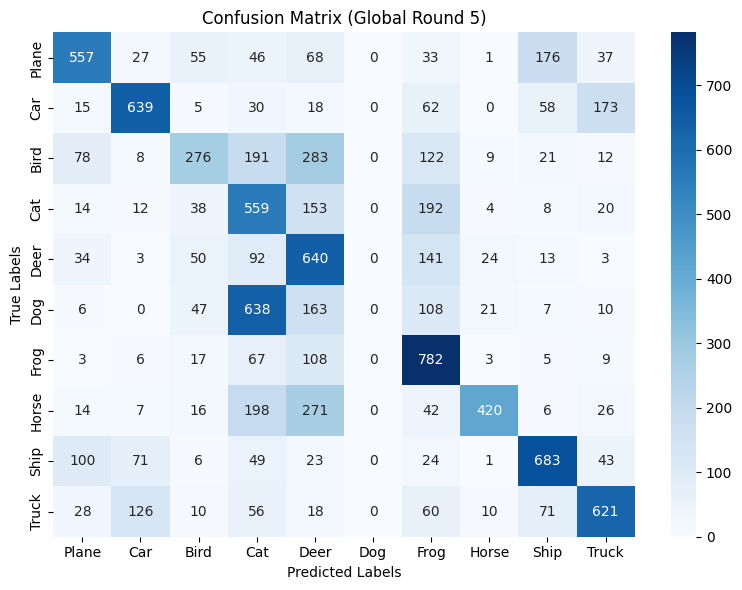


 | Global training round : 6/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.3339, Test accuracy: 5538/10000 (55.38%)

Class      - Accuracy
Plane      - 62.7
Car        - 73.6
Bird       - 31.4
Cat        - 59.8
Deer       - 70.0
Dog        - 0.0
Frog       - 77.8
Horse      - 47.3
Ship       - 67.6
Truck      - 63.6


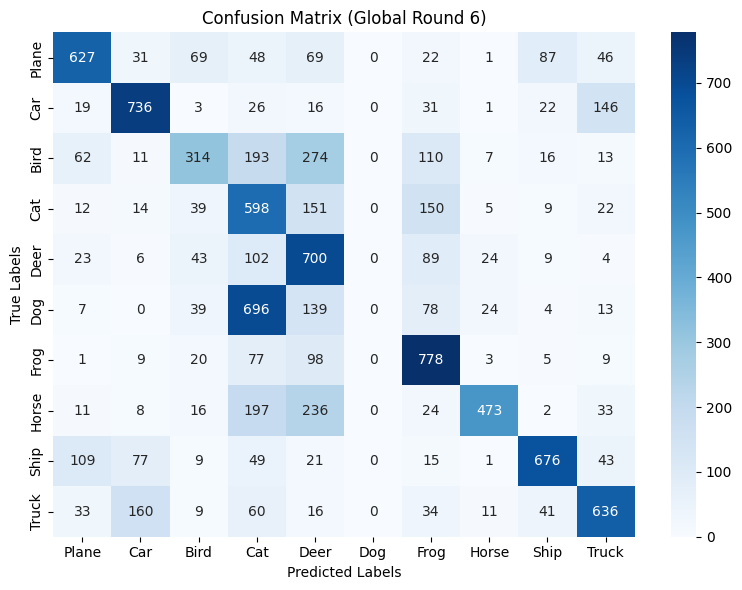


 | Global training round : 7/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.2785, Test accuracy: 5831/10000 (58.31%)

Class      - Accuracy
Plane      - 66.2
Car        - 70.9
Bird       - 41.7
Cat        - 60.0
Deer       - 66.5
Dog        - 0.0
Frog       - 81.6
Horse      - 53.1
Ship       - 74.9
Truck      - 68.2


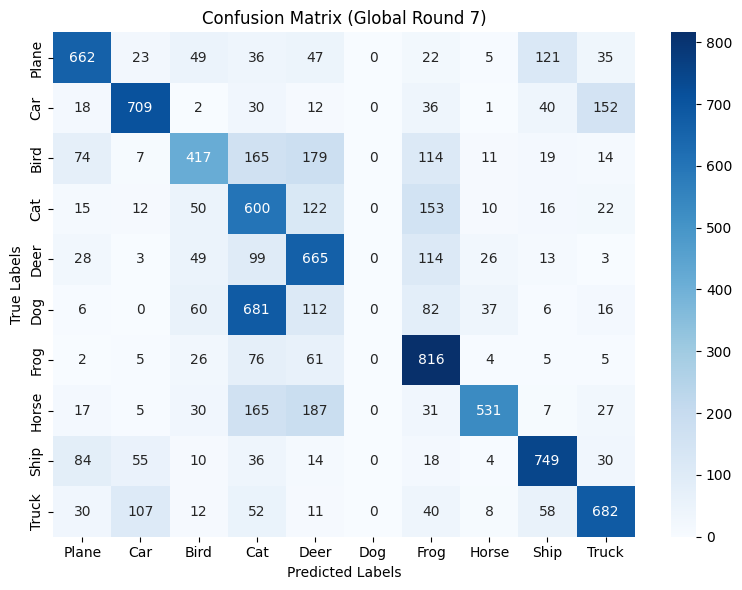


 | Global training round : 8/20 |

Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.2702, Test accuracy: 5998/10000 (59.98%)

Class      - Accuracy
Plane      - 66.4
Car        - 73.4
Bird       - 40.9
Cat        - 59.9
Deer       - 70.6
Dog        - 0.2
Frog       - 82.9
Horse      - 52.0
Ship       - 81.0
Truck      - 72.5


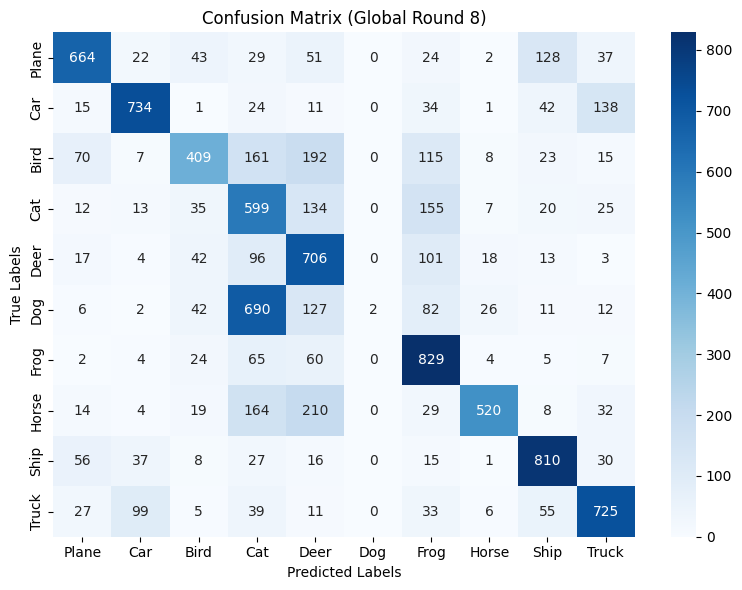


 | Global training round : 9/20 |

Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.2290, Test accuracy: 6126/10000 (61.26%)

Class      - Accuracy
Plane      - 63.1
Car        - 76.5
Bird       - 40.2
Cat        - 61.5
Deer       - 76.2
Dog        - 1.8
Frog       - 80.6
Horse      - 57.9
Ship       - 82.9
Truck      - 71.9


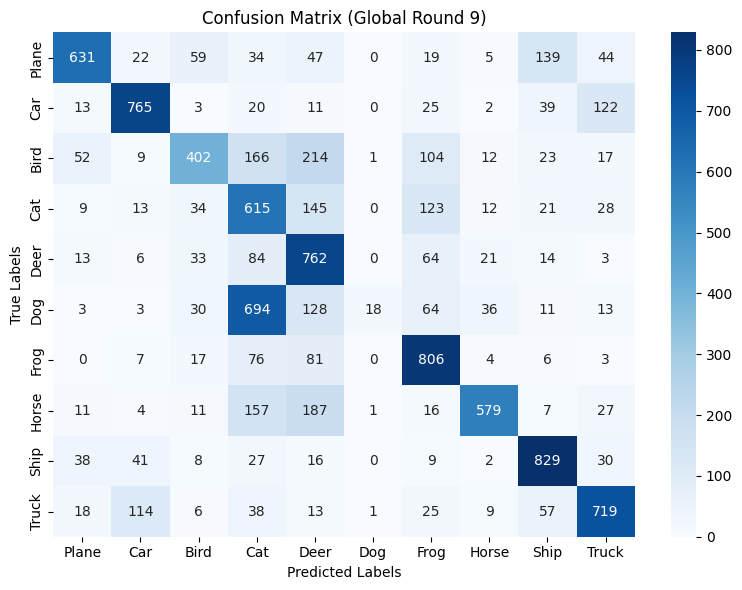


 | Global training round : 10/20 |

Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.2210, Test accuracy: 6232/10000 (62.32%)

Class      - Accuracy
Plane      - 68.4
Car        - 75.1
Bird       - 43.0
Cat        - 67.1
Deer       - 76.6
Dog        - 2.2
Frog       - 78.6
Horse      - 55.9
Ship       - 82.2
Truck      - 74.1


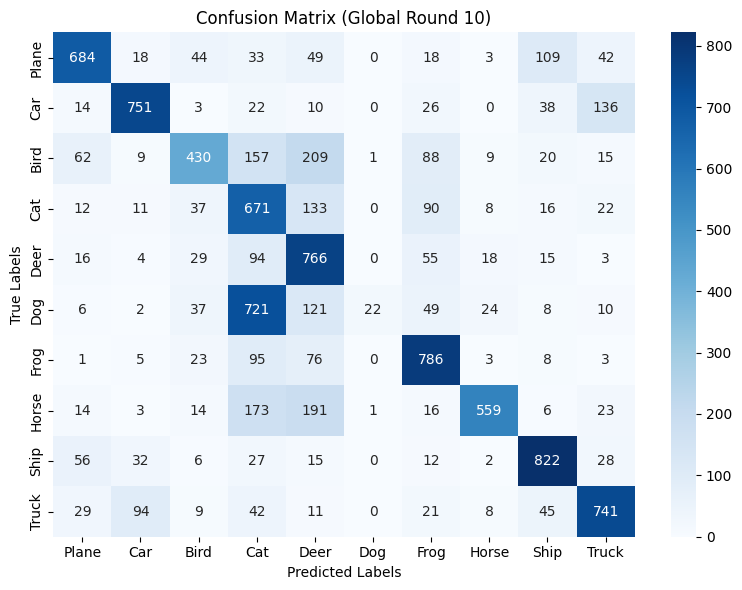


 | Global training round : 11/20 |

Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.1755, Test accuracy: 6378/10000 (63.78%)

Class      - Accuracy
Plane      - 71.4
Car        - 76.2
Bird       - 45.1
Cat        - 65.7
Deer       - 75.4
Dog        - 5.8
Frog       - 83.1
Horse      - 58.5
Ship       - 81.6
Truck      - 75.0


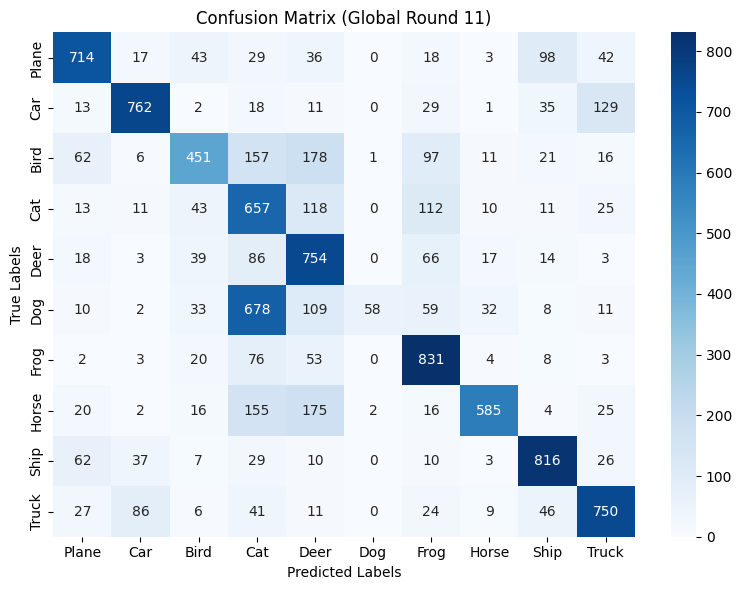


 | Global training round : 12/20 |

Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.1696, Test accuracy: 6441/10000 (64.41%)

Class      - Accuracy
Plane      - 71.6
Car        - 77.6
Bird       - 46.2
Cat        - 70.2
Deer       - 75.2
Dog        - 4.1
Frog       - 81.3
Horse      - 58.4
Ship       - 83.2
Truck      - 76.3


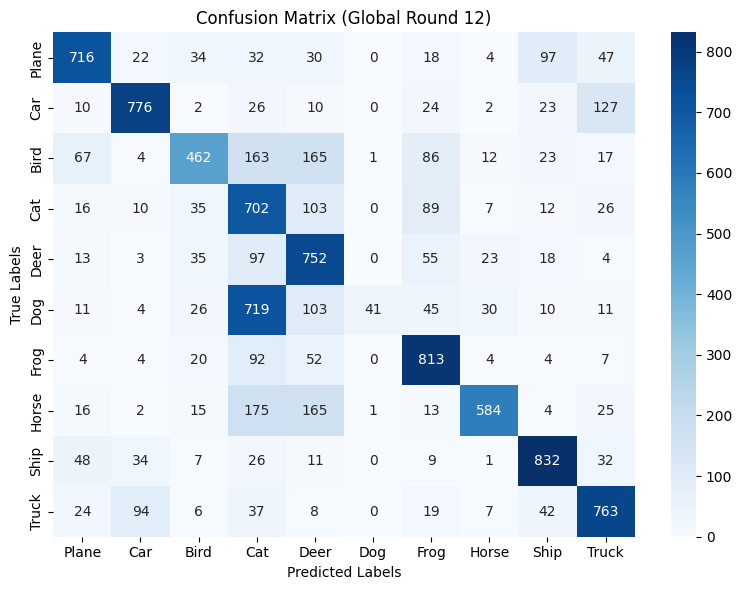


 | Global training round : 13/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.2028, Test accuracy: 6476/10000 (64.76%)

Class      - Accuracy
Plane      - 71.3
Car        - 77.5
Bird       - 45.3
Cat        - 68.4
Deer       - 78.0
Dog        - 5.4
Frog       - 83.7
Horse      - 58.7
Ship       - 82.2
Truck      - 77.1


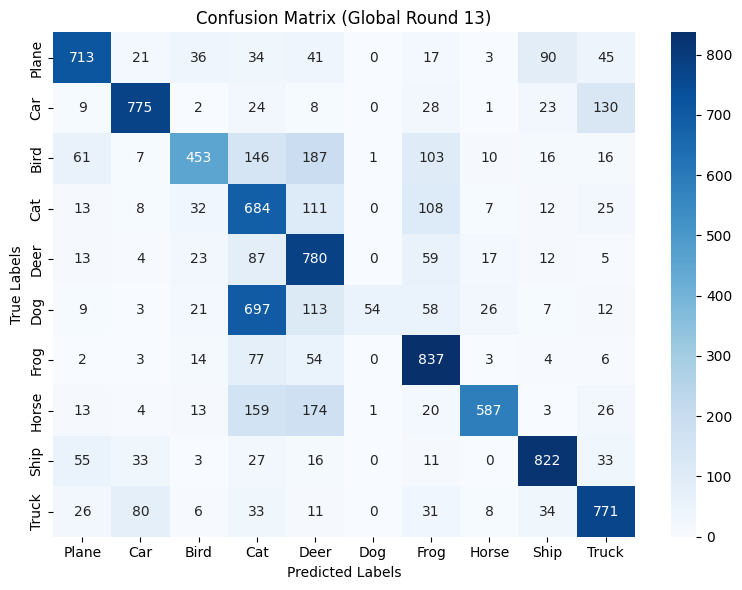


 | Global training round : 14/20 |

Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.1607, Test accuracy: 6579/10000 (65.79%)

Class      - Accuracy
Plane      - 73.3
Car        - 83.1
Bird       - 48.9
Cat        - 67.8
Deer       - 76.1
Dog        - 6.5
Frog       - 85.1
Horse      - 58.3
Ship       - 83.5
Truck      - 75.3


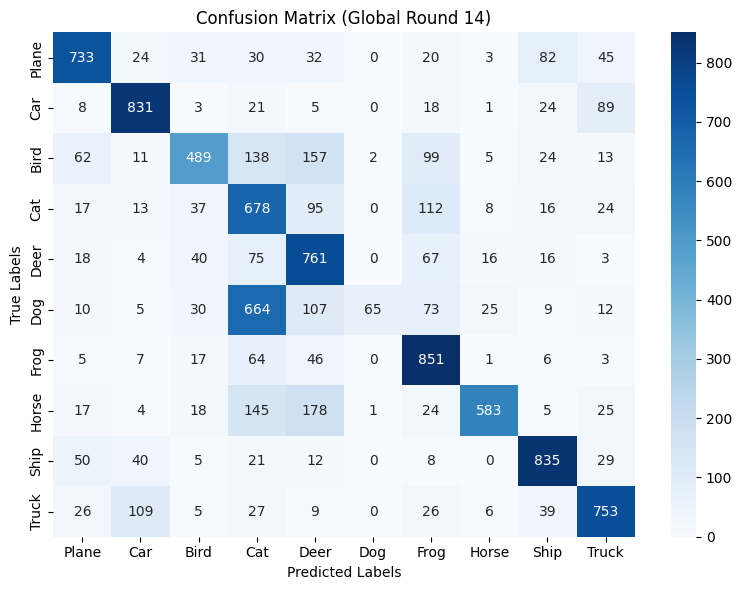


 | Global training round : 15/20 |

Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.1345, Test accuracy: 6630/10000 (66.30%)

Class      - Accuracy
Plane      - 73.3
Car        - 80.7
Bird       - 47.4
Cat        - 66.8
Deer       - 78.2
Dog        - 7.0
Frog       - 86.4
Horse      - 61.8
Ship       - 83.4
Truck      - 78.0


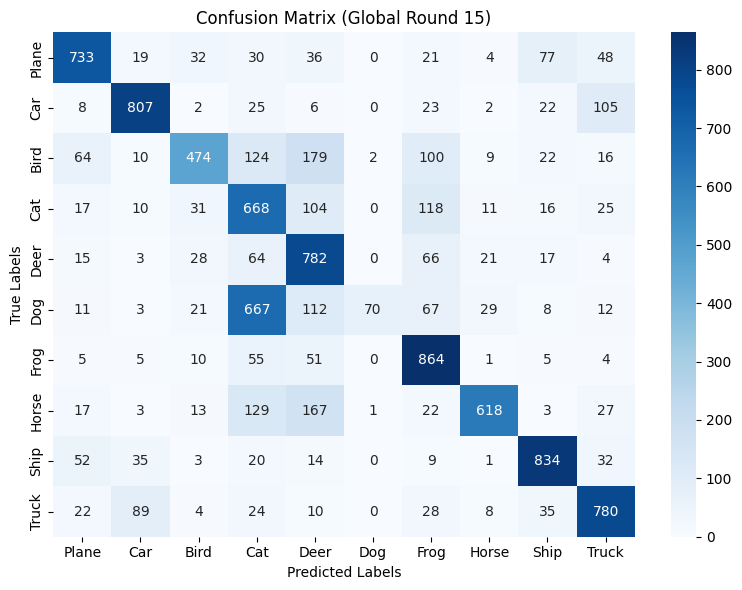


 | Global training round : 16/20 |

Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.1121, Test accuracy: 6666/10000 (66.66%)

Class      - Accuracy
Plane      - 74.9
Car        - 80.2
Bird       - 48.9
Cat        - 67.7
Deer       - 76.9
Dog        - 7.5
Frog       - 84.2
Horse      - 62.1
Ship       - 84.5
Truck      - 79.7


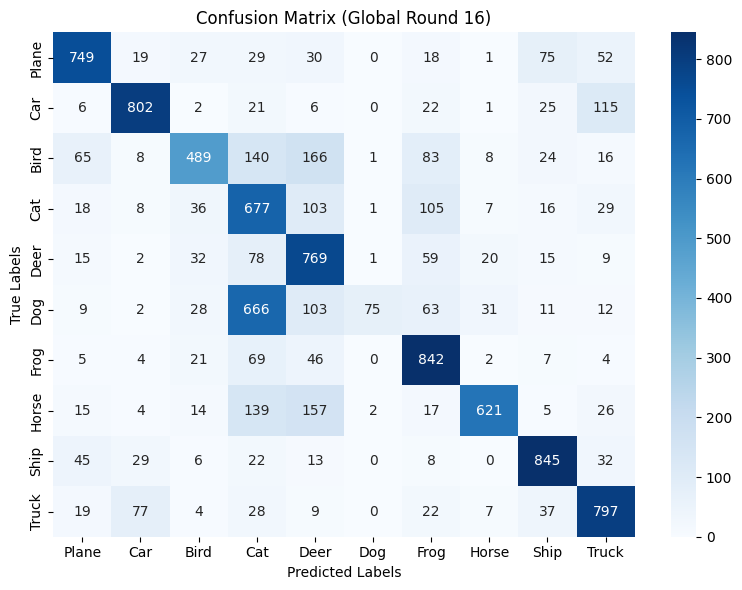


 | Global training round : 17/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.1164, Test accuracy: 6685/10000 (66.85%)

Class      - Accuracy
Plane      - 74.3
Car        - 80.0
Bird       - 49.9
Cat        - 69.3
Deer       - 77.5
Dog        - 8.4
Frog       - 84.7
Horse      - 60.8
Ship       - 83.9
Truck      - 79.7


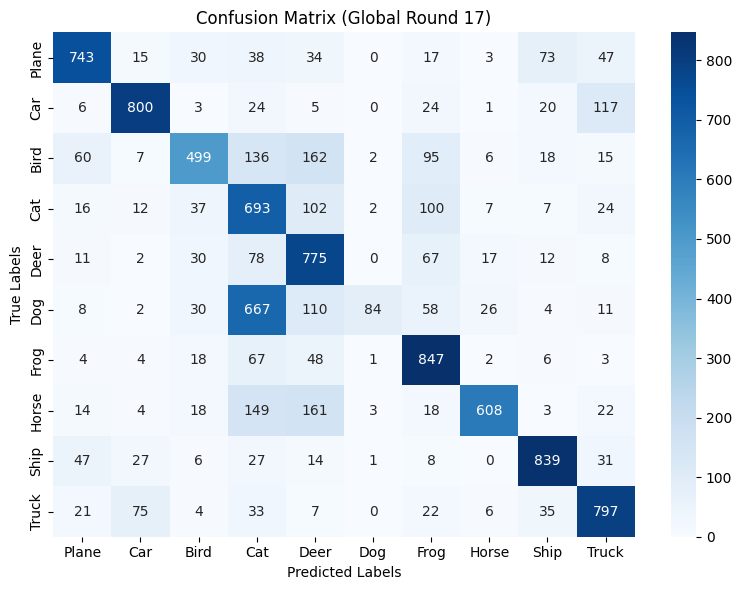


 | Global training round : 18/20 |

Label flipping attack launched by Peer 2 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0713, Test accuracy: 6819/10000 (68.19%)

Class      - Accuracy
Plane      - 75.5
Car        - 81.9
Bird       - 51.6
Cat        - 67.0
Deer       - 79.2
Dog        - 13.0
Frog       - 83.6
Horse      - 65.7
Ship       - 84.5
Truck      - 79.9


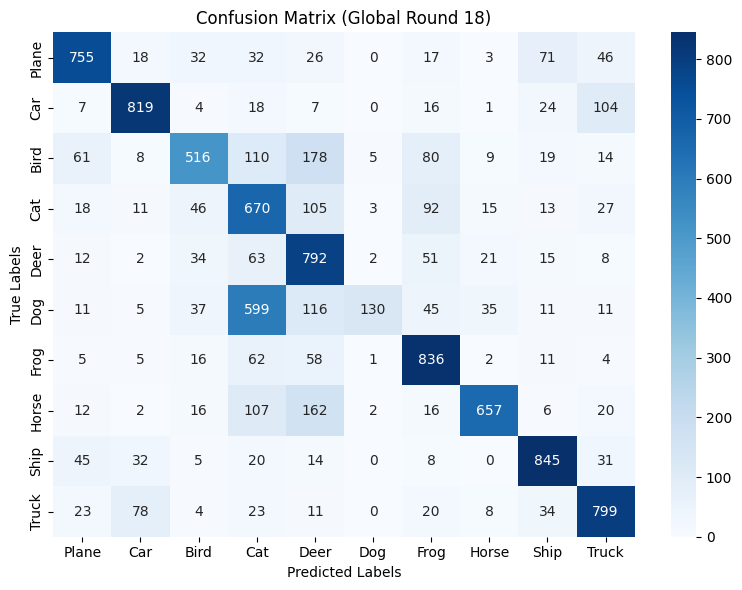


 | Global training round : 19/20 |

Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0813, Test accuracy: 6828/10000 (68.28%)

Class      - Accuracy
Plane      - 73.1
Car        - 83.3
Bird       - 53.7
Cat        - 69.2
Deer       - 78.2
Dog        - 14.2
Frog       - 84.6
Horse      - 64.0
Ship       - 84.6
Truck      - 77.9


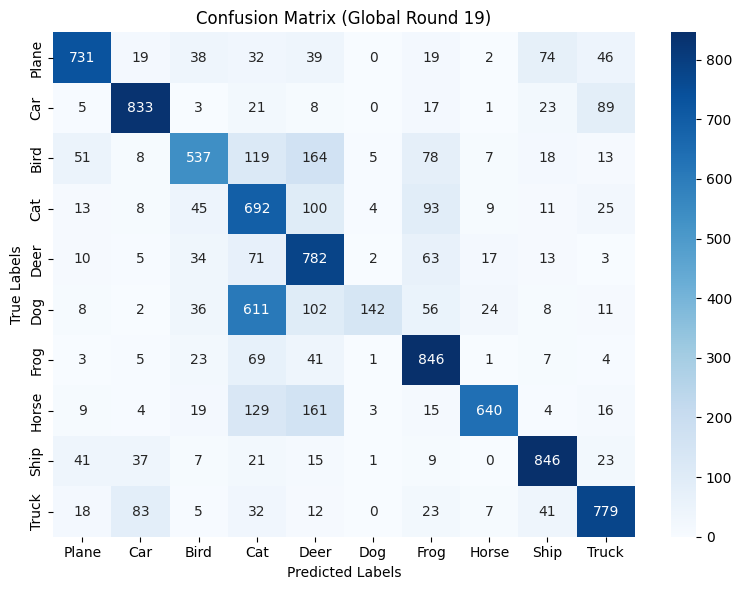


 | Global training round : 20/20 |

Label flipping attack launched by Peer 16 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 7 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 9 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 2 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0865, Test accuracy: 6822/10000 (68.22%)

Class      - Accuracy
Plane      - 75.3
Car        - 81.6
Bird       - 51.6
Cat        - 70.3
Deer       - 75.0
Dog        - 12.9
Frog       - 86.0
Horse      - 66.4
Ship       - 85.1
Truck      - 78.0
Last 10 updates results

Average test loss: 1.1229, Test accuracy: 6622/10000 (66.22%)

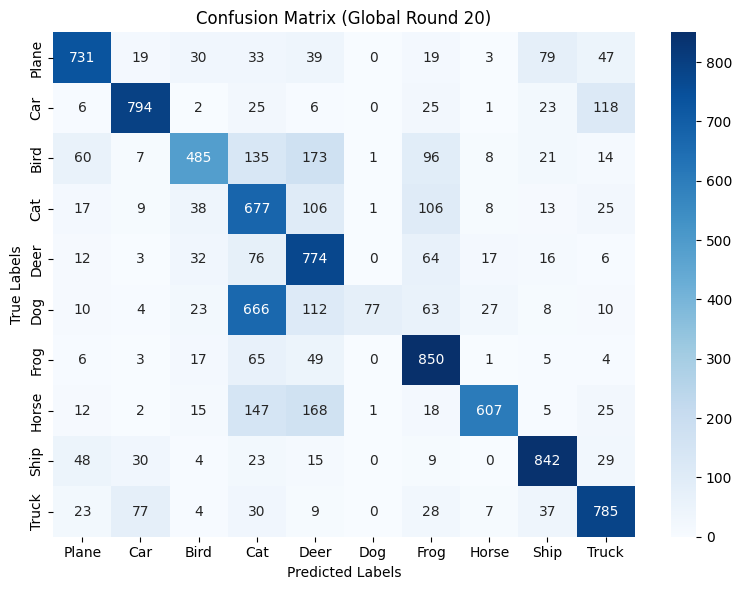

Global accuracies:  [np.float64(10.0), np.float64(10.34), np.float64(24.8), np.float64(43.93), np.float64(51.77), np.float64(55.38), np.float64(58.31), np.float64(59.98), np.float64(61.26), np.float64(62.32), np.float64(63.78), np.float64(64.41), np.float64(64.76), np.float64(65.79), np.float64(66.3), np.float64(66.66), np.float64(66.85), np.float64(68.19), np.float64(68.28), np.float64(68.22), np.float64(66.22)]
Class 5 accuracies:  [np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.2), np.float64(1.8), np.float64(2.2), np.float64(5.8), np.float64(4.1), np.float64(5.4), np.float64(6.5), np.float64(7.0), np.float64(7.5), np.float64(8.4), np.float64(13.0), np.float64(14.2), np.float64(12.9), np.float64(7.7)]
Test loss: [np.float64(2.393), np.float64(2.3276), np.float64(2.0788), np.float64(1.6333), np.float64(1.4418), np.float64(1.3339), np.float64(1.2785), np.float64(1.2702), np.float64(1.229), np.float64(

In [ ]:
RULE = 'robutslfd'
ATTACK_TYPE='label_flipping'
MALICIOUS_BEHAVIOR_RATE = 1
for atr in [0.4]:
    run_exp(dataset_name = DATASET_NAME, model_name = MODEL_NAME, dd_type = DD_TYPE, num_peers = NUM_PEERS,
            frac_peers = FRAC_PEERS, seed = SEED, test_batch_size = TEST_BATCH_SIZE,
                criterion = CRITERION, global_rounds = GLOBAL_ROUNDS, local_epochs = LOCAL_EPOCHS, local_bs = LOCAL_BS,
                 local_lr = LOCAL_LR, local_momentum = LOCAL_MOMENTUM, labels_dict = LABELS_DICT, device = DEVICE,
                attackers_ratio = atr, attack_type=ATTACK_TYPE,
                 malicious_behavior_rate = MALICIOUS_BEHAVIOR_RATE, rule = RULE,
                source_class = SOURCE_CLASS, target_class = TARGET_CLASS,
               class_per_peer = CLASS_PER_PEER, samples_per_class = SAMPLES_PER_CLASS,
               rate_unbalance = RATE_UNBALANCE, alpha = ALPHA, resume = False)

MNIST , NON-IID. 10% attacker

In [ ]:

#=============================== Defining global variables ========================#
DATASET_NAME = "MNIST"
MODEL_NAME = "CNNMNIST"
DD_TYPE = 'NON_IID'
ALPHA = 1
NUM_PEERS = 50 # "number of peers: K"
FRAC_PEERS = 1 #'the fraction of peers: C to bel selected in each round'
SEED = 7 #fixed seed
random.seed(SEED)
CRITERION = nn.CrossEntropyLoss()
GLOBAL_ROUNDS = 20 #"number of rounds of federated model training"
LOCAL_EPOCHS = 3 #"the number of local epochs: E for each peer"
TEST_BATCH_SIZE = 1000
LOCAL_BS = 64 #"local batch size: B for each peer"
LOCAL_LR =  0.01#local learning rate: lr for each peer
LOCAL_MOMENTUM = 0.9 #local momentum for each peer
NUM_CLASSES = 10 # number of classes in an experiment
LABELS_DICT = {'Zero':0,
               'One':1,
               'Two':2,
               'Three':3,
               'Four':4,
               'Five':5,
               'Six':6,
               'Seven':7,
               'Eight':8,
               'Nine':9}

#select the device to work with cpu or gpu
if torch.cuda.is_available():
    DEVICE = "cuda"
else:
    DEVICE = "cpu"
DEVICE = torch.device(DEVICE)
SOURCE_CLASS = 7 # the source class
TARGET_CLASS = 1 # the target class

CLASS_PER_PEER = 10
SAMPLES_PER_CLASS = 582
RATE_UNBALANCE = 1


--> Label FLIP experiment on our algo...
--> Loading of MNIST dataset
--> Dataset has been loaded!
--> Creating CNNMNIST model.....
--> Model has been created!
--> Distributing training data among peers
--> Training data have been distributed among peers
--> Creating peets instances
Data set: MNIST
Data distribution: NON_IID
Aggregation rule: robutslfd
Attack Type: label_flipping
Attackers Ratio: 10.0 %
Malicious Behavior Rate: 100 %

===>Simulation started...

====>Global model training started...



  0%|          | 0/20 [00:00<?, ?it/s]


 | Global training round : 1/20 |

Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 1.6473, Test accuracy: 7424/10000 (74.24%)

Class      - Accuracy
Zero       - 95.0
One        - 98.5
Two        - 72.2
Three      - 88.5
Four       - 85.1
Five       - 29.4
Six        - 73.6
Seven      - 87.5
Eight      - 68.3
Nine       - 36.5


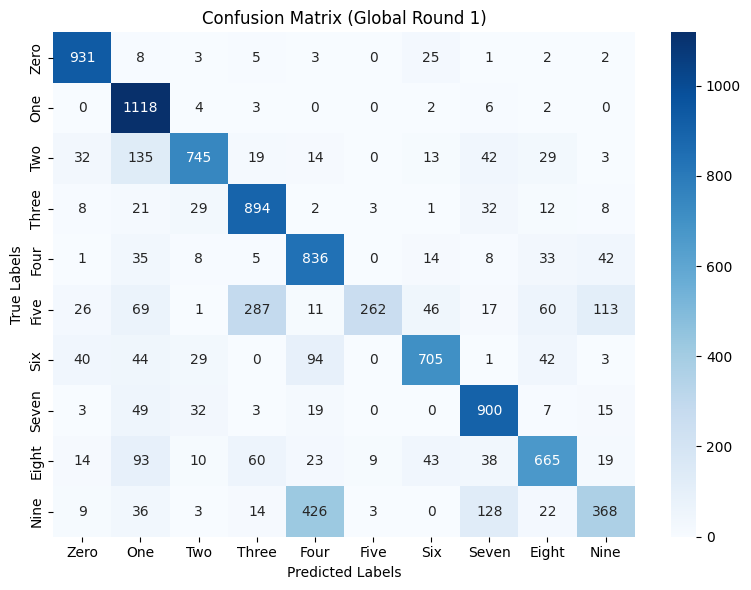


 | Global training round : 2/20 |

Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.5077, Test accuracy: 8823/10000 (88.23%)

Class      - Accuracy
Zero       - 98.0
One        - 98.0
Two        - 88.5
Three      - 88.1
Four       - 94.4
Five       - 76.0
Six        - 92.4
Seven      - 89.8
Eight      - 81.1
Nine       - 73.8


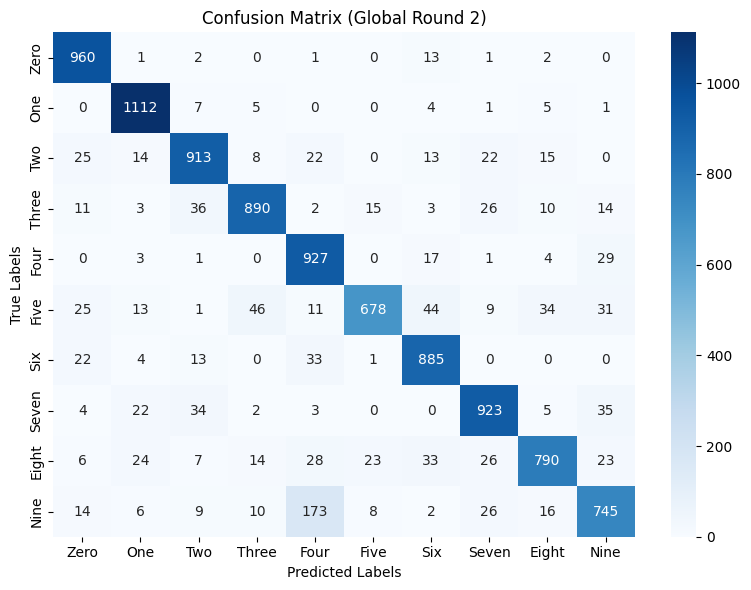


 | Global training round : 3/20 |

Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.3125, Test accuracy: 9195/10000 (91.95%)

Class      - Accuracy
Zero       - 98.4
One        - 98.5
Two        - 90.9
Three      - 89.8
Four       - 96.3
Five       - 88.1
Six        - 95.5
Seven      - 89.2
Eight      - 85.7
Nine       - 86.1


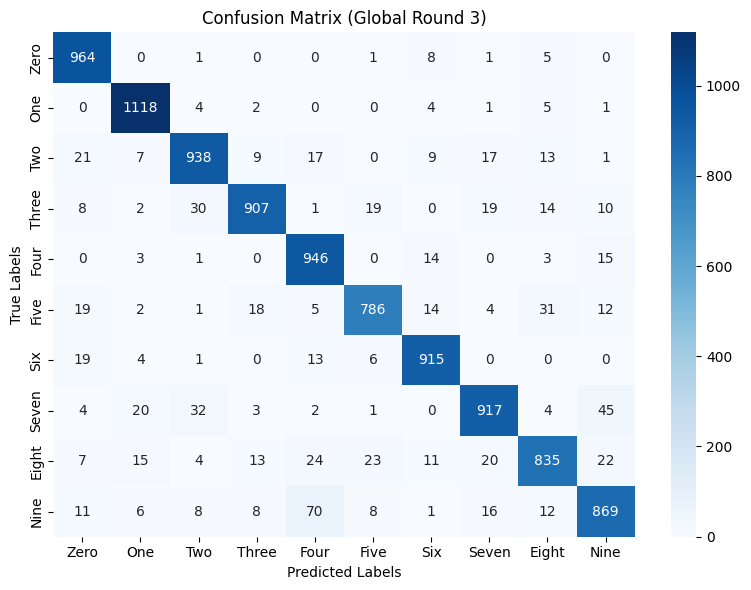


 | Global training round : 4/20 |

Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.2381, Test accuracy: 9352/10000 (93.52%)

Class      - Accuracy
Zero       - 98.6
One        - 98.5
Two        - 92.3
Three      - 93.3
Four       - 97.0
Five       - 92.2
Six        - 96.9
Seven      - 89.4
Eight      - 87.2
Nine       - 89.4


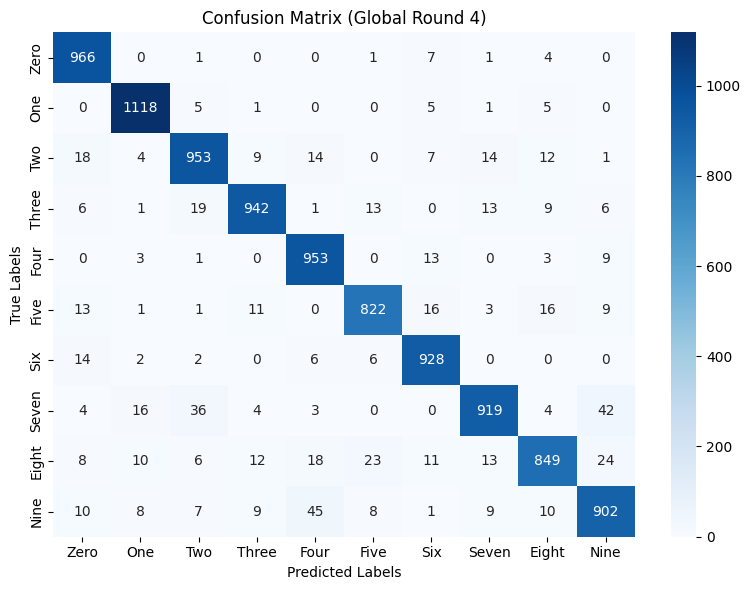


 | Global training round : 5/20 |

Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.1958, Test accuracy: 9432/10000 (94.32%)

Class      - Accuracy
Zero       - 98.7
One        - 98.7
Two        - 93.5
Three      - 93.0
Four       - 96.5
Five       - 94.2
Six        - 97.0
Seven      - 90.1
Eight      - 89.5
Nine       - 91.8


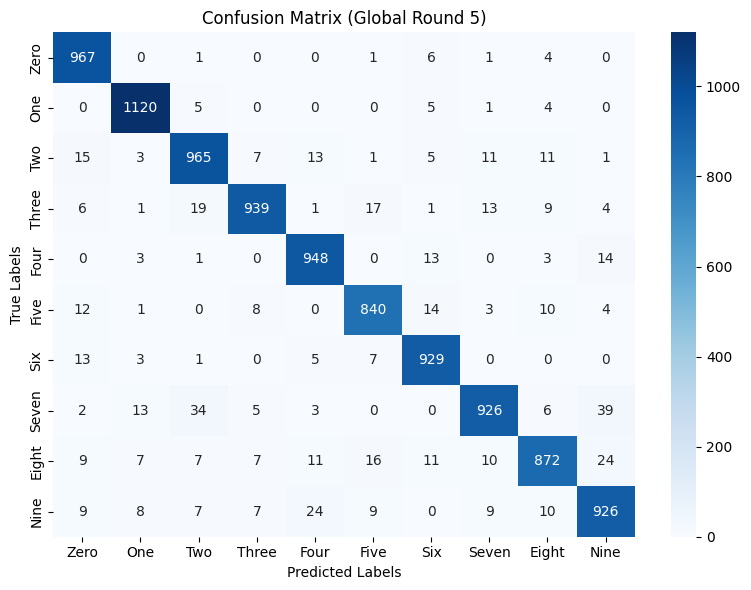


 | Global training round : 6/20 |

Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.1708, Test accuracy: 9505/10000 (95.05%)

Class      - Accuracy
Zero       - 98.9
One        - 98.7
Two        - 94.3
Three      - 93.7
Four       - 96.8
Five       - 95.7
Six        - 97.2
Seven      - 91.0
Eight      - 90.7
Nine       - 93.5


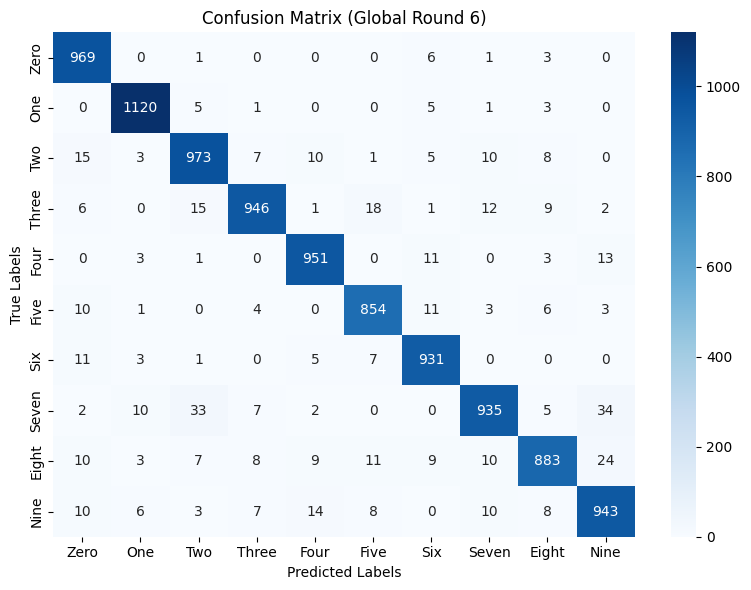


 | Global training round : 7/20 |

Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.1509, Test accuracy: 9540/10000 (95.40%)

Class      - Accuracy
Zero       - 98.8
One        - 98.7
Two        - 95.0
Three      - 94.6
Four       - 97.0
Five       - 95.9
Six        - 97.3
Seven      - 90.8
Eight      - 92.1
Nine       - 93.9


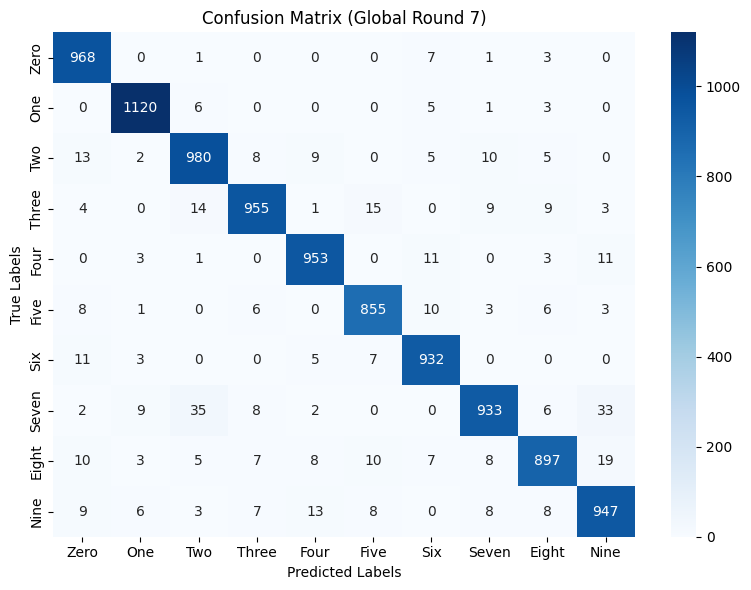


 | Global training round : 8/20 |

Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.1378, Test accuracy: 9578/10000 (95.78%)

Class      - Accuracy
Zero       - 98.8
One        - 98.7
Two        - 95.9
Three      - 95.2
Four       - 97.1
Five       - 96.4
Six        - 97.1
Seven      - 92.0
Eight      - 92.3
Nine       - 94.1


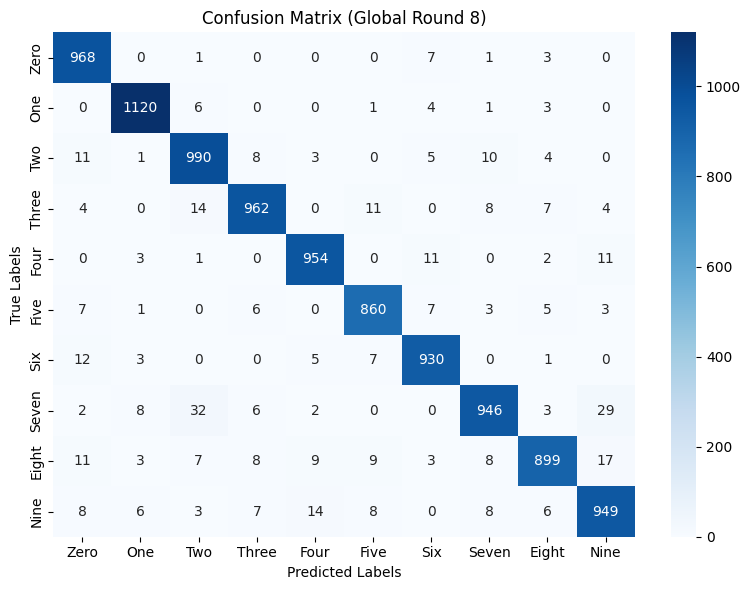


 | Global training round : 9/20 |

Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.1276, Test accuracy: 9606/10000 (96.06%)

Class      - Accuracy
Zero       - 98.8
One        - 98.7
Two        - 95.8
Three      - 95.1
Four       - 97.1
Five       - 96.9
Six        - 97.5
Seven      - 92.3
Eight      - 93.8
Nine       - 94.4


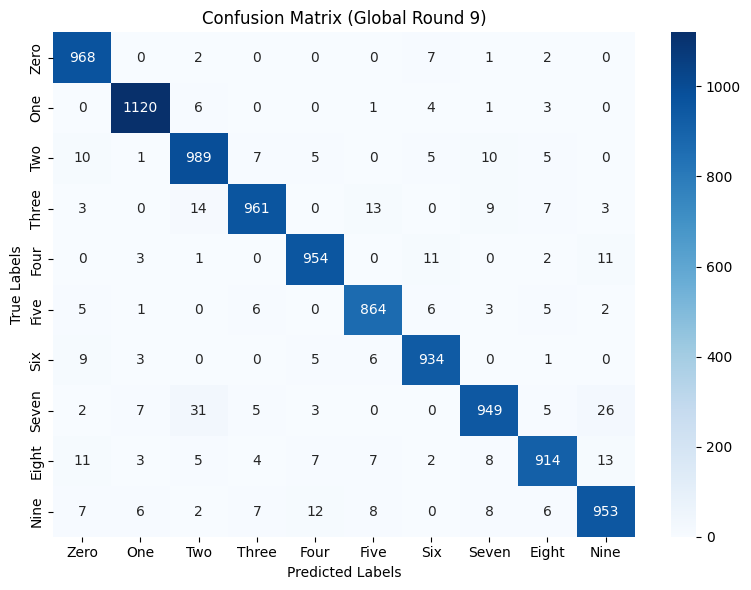


 | Global training round : 10/20 |

Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.1203, Test accuracy: 9626/10000 (96.26%)

Class      - Accuracy
Zero       - 98.9
One        - 98.9
Two        - 95.9
Three      - 95.0
Four       - 97.0
Five       - 97.3
Six        - 97.5
Seven      - 93.0
Eight      - 93.8
Nine       - 95.0


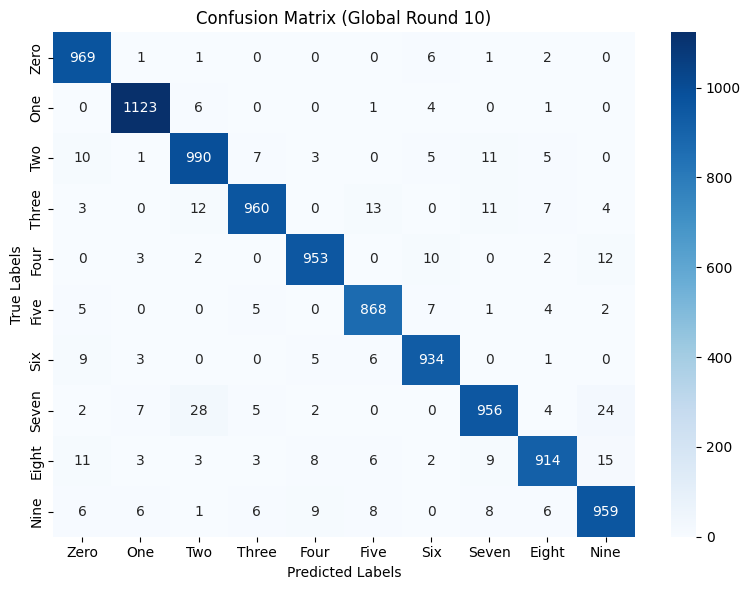


 | Global training round : 11/20 |

Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.1127, Test accuracy: 9657/10000 (96.57%)

Class      - Accuracy
Zero       - 98.9
One        - 99.0
Two        - 96.9
Three      - 96.2
Four       - 97.1
Five       - 97.3
Six        - 97.4
Seven      - 93.3
Eight      - 94.0
Nine       - 95.3


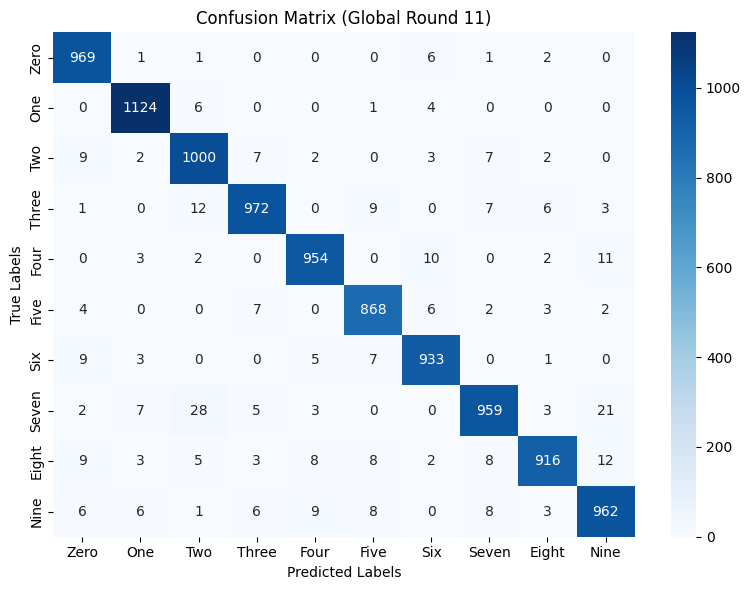


 | Global training round : 12/20 |

Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.1080, Test accuracy: 9667/10000 (96.67%)

Class      - Accuracy
Zero       - 98.8
One        - 99.1
Two        - 96.7
Three      - 96.3
Four       - 96.9
Five       - 98.0
Six        - 97.5
Seven      - 93.0
Eight      - 94.7
Nine       - 95.6


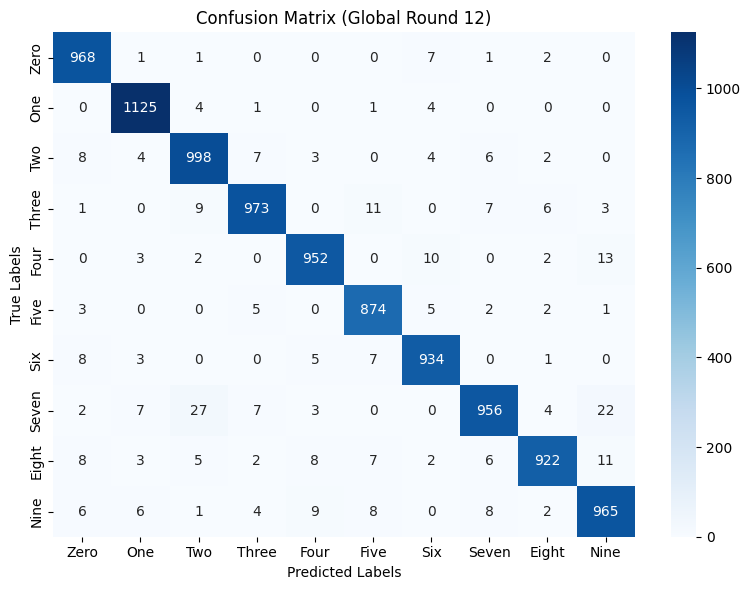


 | Global training round : 13/20 |

Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.1025, Test accuracy: 9688/10000 (96.88%)

Class      - Accuracy
Zero       - 99.0
One        - 99.1
Two        - 97.1
Three      - 96.5
Four       - 97.5
Five       - 98.1
Six        - 97.6
Seven      - 93.9
Eight      - 94.4
Nine       - 95.6


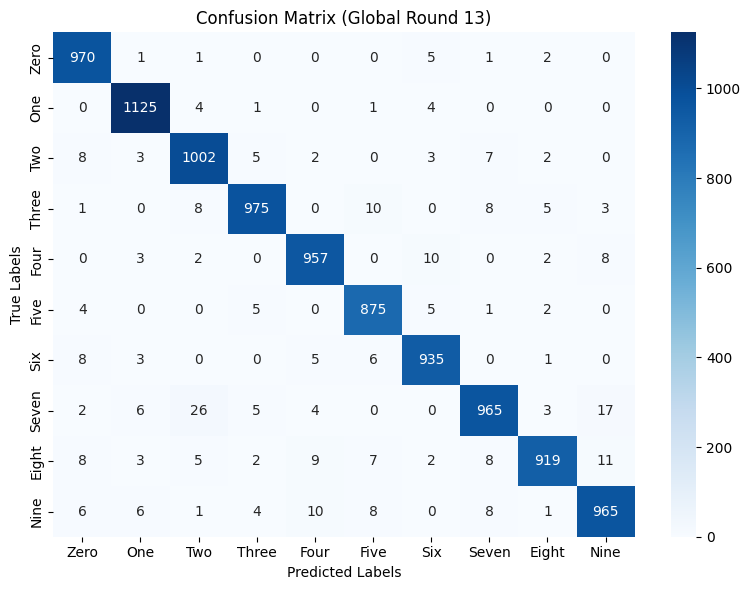


 | Global training round : 14/20 |

Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.0978, Test accuracy: 9706/10000 (97.06%)

Class      - Accuracy
Zero       - 99.0
One        - 99.1
Two        - 97.2
Three      - 96.4
Four       - 97.6
Five       - 98.0
Six        - 97.9
Seven      - 94.3
Eight      - 95.2
Nine       - 95.9


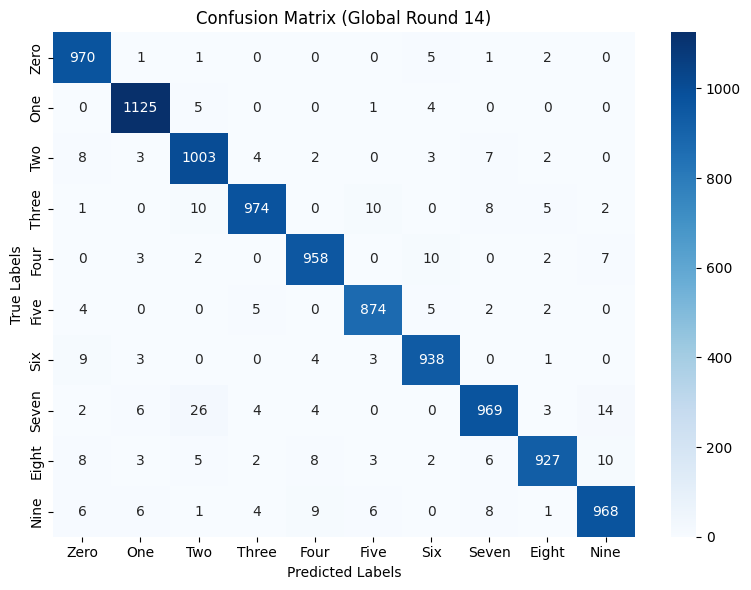


 | Global training round : 15/20 |

Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.0940, Test accuracy: 9717/10000 (97.17%)

Class      - Accuracy
Zero       - 99.0
One        - 99.2
Two        - 97.1
Three      - 96.8
Four       - 97.7
Five       - 98.0
Six        - 98.0
Seven      - 94.7
Eight      - 95.2
Nine       - 95.9


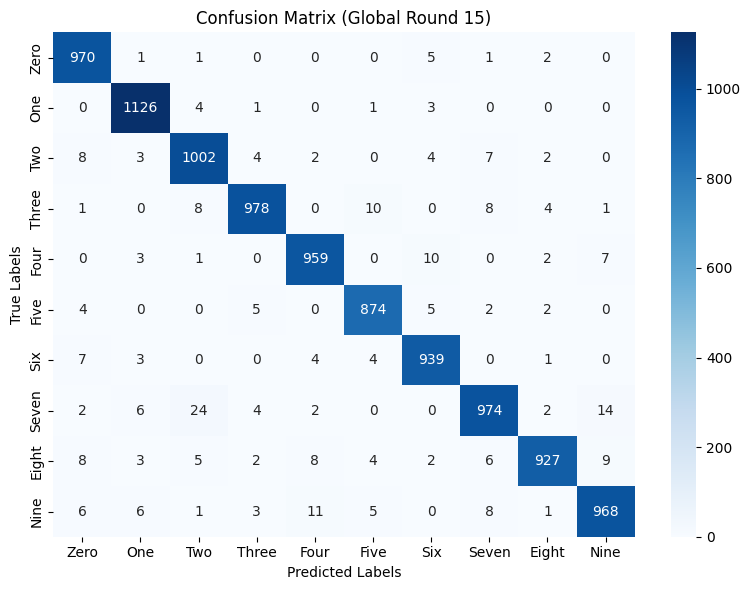


 | Global training round : 16/20 |

Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.0894, Test accuracy: 9731/10000 (97.31%)

Class      - Accuracy
Zero       - 99.1
One        - 99.3
Two        - 97.3
Three      - 97.1
Four       - 97.6
Five       - 98.3
Six        - 97.8
Seven      - 94.6
Eight      - 95.8
Nine       - 96.1


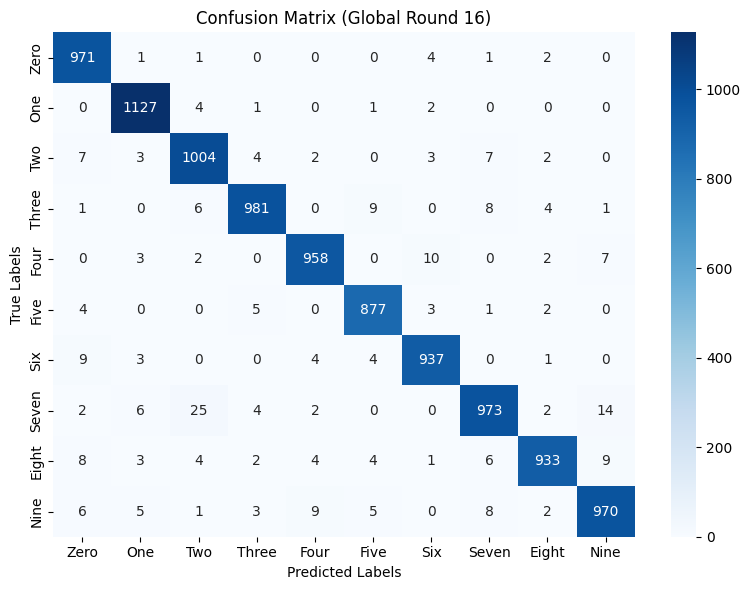


 | Global training round : 17/20 |

Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.0884, Test accuracy: 9732/10000 (97.32%)

Class      - Accuracy
Zero       - 99.2
One        - 99.3
Two        - 97.4
Three      - 97.0
Four       - 97.6
Five       - 98.1
Six        - 97.9
Seven      - 94.9
Eight      - 95.6
Nine       - 96.1


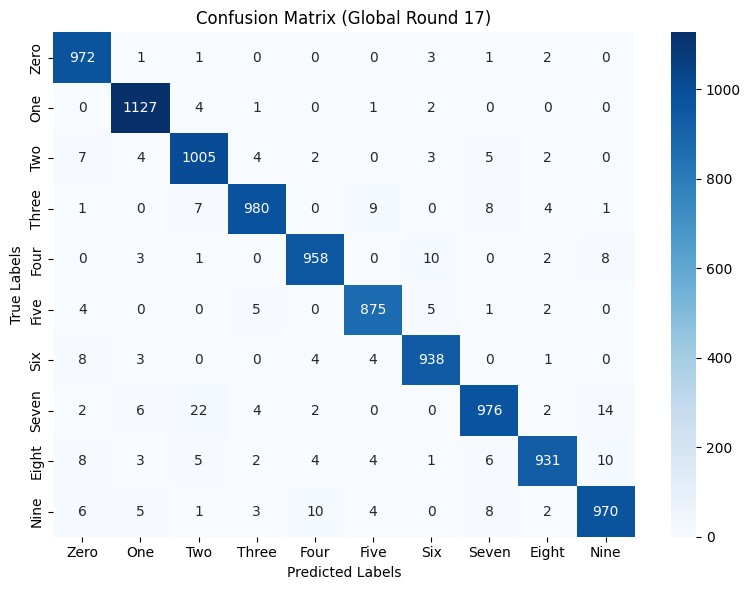


 | Global training round : 18/20 |

Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.0851, Test accuracy: 9744/10000 (97.44%)

Class      - Accuracy
Zero       - 99.2
One        - 99.3
Two        - 97.6
Three      - 97.1
Four       - 97.5
Five       - 98.4
Six        - 98.2
Seven      - 95.0
Eight      - 95.8
Nine       - 96.2


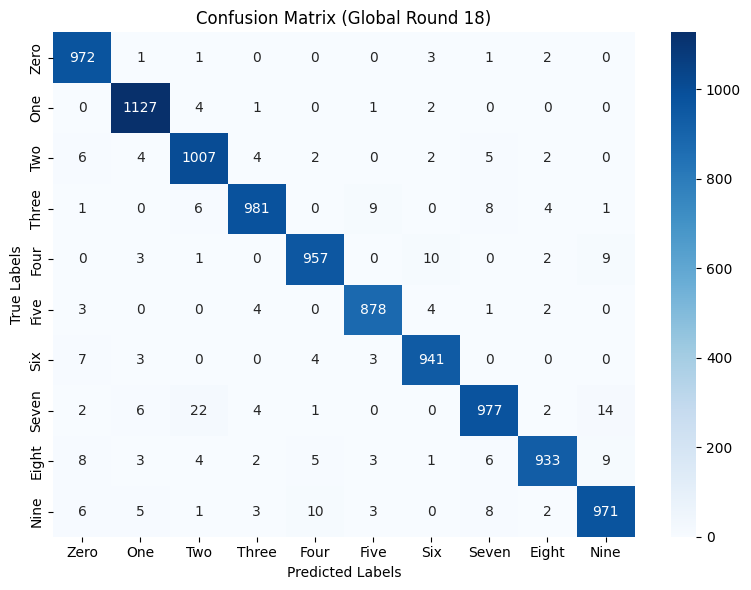


 | Global training round : 19/20 |

Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.0821, Test accuracy: 9751/10000 (97.51%)

Class      - Accuracy
Zero       - 99.2
One        - 99.3
Two        - 97.9
Three      - 97.3
Four       - 97.7
Five       - 98.5
Six        - 98.0
Seven      - 95.1
Eight      - 95.9
Nine       - 96.1


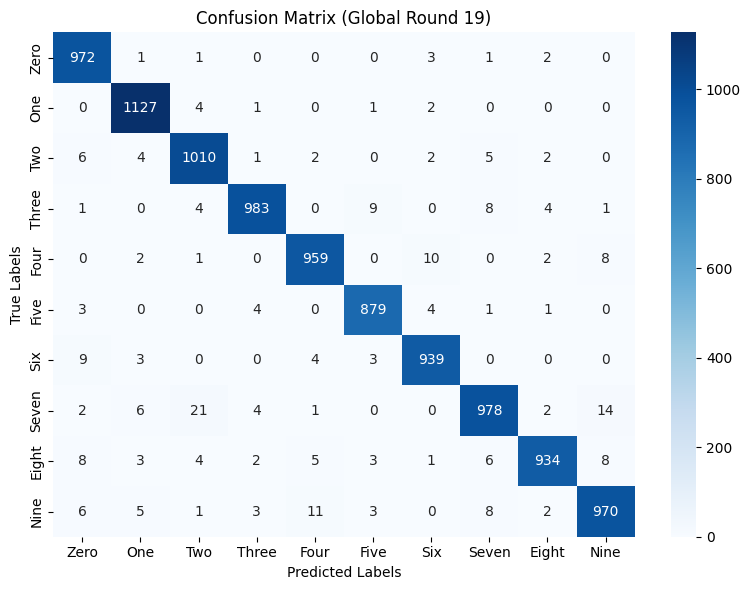


 | Global training round : 20/20 |

Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.0800, Test accuracy: 9755/10000 (97.55%)

Class      - Accuracy
Zero       - 99.2
One        - 99.2
Two        - 97.9
Three      - 97.1
Four       - 97.9
Five       - 98.4
Six        - 98.3
Seven      - 95.3
Eight      - 96.0
Nine       - 96.1
Last 10 updates results

Average test loss: 0.0931, Test accuracy: 9714/10000 (97.14%)

***********************************************************************************
Class      - Accuracy
Zero       - 99.1
One        - 99.2
Two        - 97.2
Three      - 96.9
Four       - 97.5
Five       - 98

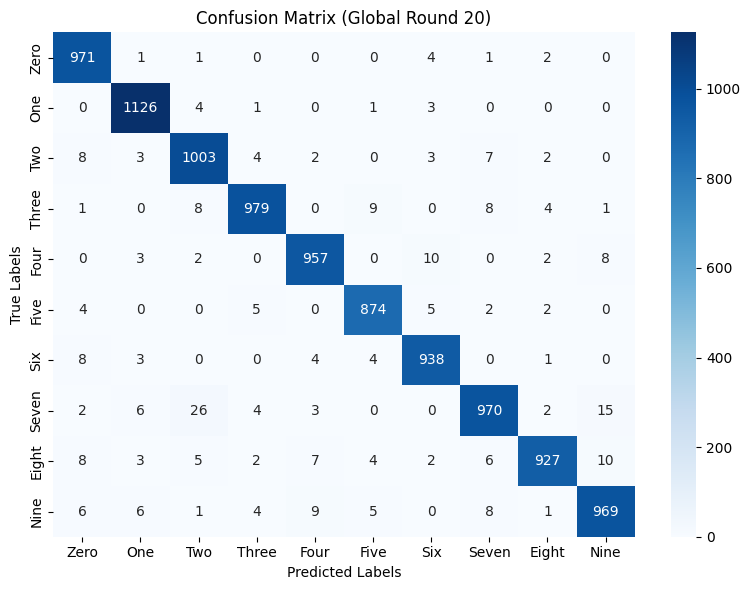

Global accuracies:  [np.float64(74.24), np.float64(88.23), np.float64(91.95), np.float64(93.52), np.float64(94.32), np.float64(95.05), np.float64(95.4), np.float64(95.78), np.float64(96.06), np.float64(96.26), np.float64(96.57), np.float64(96.67), np.float64(96.88), np.float64(97.06), np.float64(97.17), np.float64(97.31), np.float64(97.32), np.float64(97.44), np.float64(97.51), np.float64(97.55), np.float64(97.14)]
Class 7 accuracies:  [np.float64(87.55), np.float64(89.79), np.float64(89.2), np.float64(89.4), np.float64(90.08), np.float64(90.95), np.float64(90.76), np.float64(92.02), np.float64(92.32), np.float64(93.0), np.float64(93.29), np.float64(93.0), np.float64(93.87), np.float64(94.26), np.float64(94.75), np.float64(94.65), np.float64(94.94), np.float64(95.04), np.float64(95.14), np.float64(95.33), np.float64(94.36)]
Test loss: [np.float64(1.6473), np.float64(0.5077), np.float64(0.3125), np.float64(0.2381), np.float64(0.1958), np.float64(0.1708), np.float64(0.1509), np.float64(0

In [ ]:
RULE = 'robutslfd'
ATTACK_TYPE='label_flipping'
MALICIOUS_BEHAVIOR_RATE = 1
for atr in [0.1]:
    run_exp(dataset_name = DATASET_NAME, model_name = MODEL_NAME, dd_type = DD_TYPE, num_peers = NUM_PEERS,
            frac_peers = FRAC_PEERS, seed = SEED, test_batch_size = TEST_BATCH_SIZE,
                criterion = CRITERION, global_rounds = GLOBAL_ROUNDS, local_epochs = LOCAL_EPOCHS, local_bs = LOCAL_BS,
                 local_lr = LOCAL_LR, local_momentum = LOCAL_MOMENTUM, labels_dict = LABELS_DICT, device = DEVICE,
                attackers_ratio = atr, attack_type=ATTACK_TYPE,
                 malicious_behavior_rate = MALICIOUS_BEHAVIOR_RATE, rule = RULE,
                source_class = SOURCE_CLASS, target_class = TARGET_CLASS,
               class_per_peer = CLASS_PER_PEER, samples_per_class = SAMPLES_PER_CLASS,
               rate_unbalance = RATE_UNBALANCE, alpha = ALPHA, resume = False)


MNIST, NON-IID, 20% attaker

In [ ]:

#=============================== Defining global variables ========================#
DATASET_NAME = "MNIST"
MODEL_NAME = "CNNMNIST"
DD_TYPE = 'NON_IID'
ALPHA = 1
NUM_PEERS = 50 # "number of peers: K"
FRAC_PEERS = 1 #'the fraction of peers: C to bel selected in each round'
SEED = 7 #fixed seed
random.seed(SEED)
CRITERION = nn.CrossEntropyLoss()
GLOBAL_ROUNDS = 20 #"number of rounds of federated model training"
LOCAL_EPOCHS = 3 #"the number of local epochs: E for each peer"
TEST_BATCH_SIZE = 1000
LOCAL_BS = 64 #"local batch size: B for each peer"
LOCAL_LR =  0.01#local learning rate: lr for each peer
LOCAL_MOMENTUM = 0.9 #local momentum for each peer
NUM_CLASSES = 10 # number of classes in an experiment
LABELS_DICT = {'Zero':0,
               'One':1,
               'Two':2,
               'Three':3,
               'Four':4,
               'Five':5,
               'Six':6,
               'Seven':7,
               'Eight':8,
               'Nine':9}

#select the device to work with cpu or gpu
if torch.cuda.is_available():
    DEVICE = "cuda"
else:
    DEVICE = "cpu"
DEVICE = torch.device(DEVICE)
SOURCE_CLASS = 7 # the source class
TARGET_CLASS = 1 # the target class

CLASS_PER_PEER = 10
SAMPLES_PER_CLASS = 582
RATE_UNBALANCE = 1


--> Label FLIP experiment on our algo...
--> Loading of MNIST dataset
--> Dataset has been loaded!
--> Creating CNNMNIST model.....
--> Model has been created!
--> Distributing training data among peers
--> Training data have been distributed among peers
--> Creating peets instances
Data set: MNIST
Data distribution: NON_IID
Aggregation rule: robutslfd
Attack Type: label_flipping
Attackers Ratio: 20.0 %
Malicious Behavior Rate: 100 %

===>Simulation started...

====>Global model training started...



  0%|          | 0/20 [00:00<?, ?it/s]


 | Global training round : 1/20 |

Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 1.6827, Test accuracy: 7301/10000 (73.01%)

Class      - Accuracy
Zero       - 94.4
One        - 99.0
Two        - 70.3
Three      - 88.6
Four       - 83.5
Five       - 26.8
Six        - 7

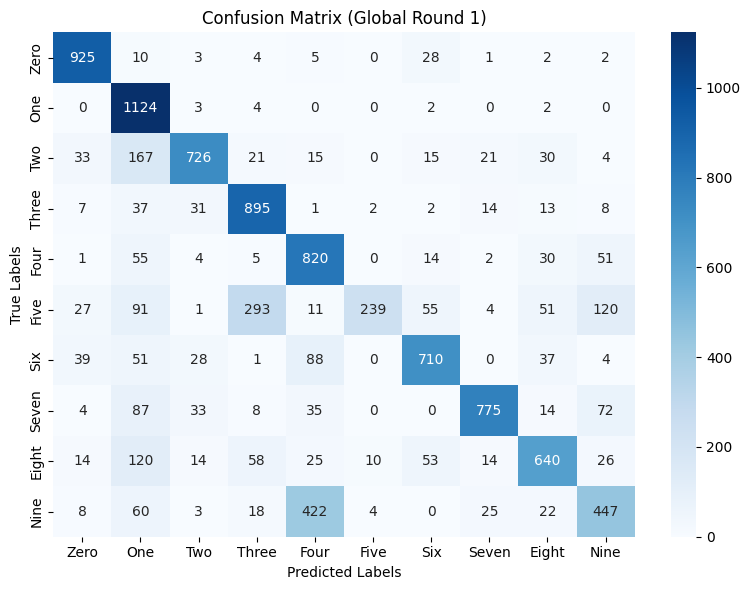


 | Global training round : 2/20 |

Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.5337, Test accuracy: 8761/10000 (87.61%)

Class      - Accuracy
Zero       - 98.0
One        - 98.2
Two        - 88.1
Three      - 90.8
Four       - 93.7
Five       - 75.1
Six        - 9

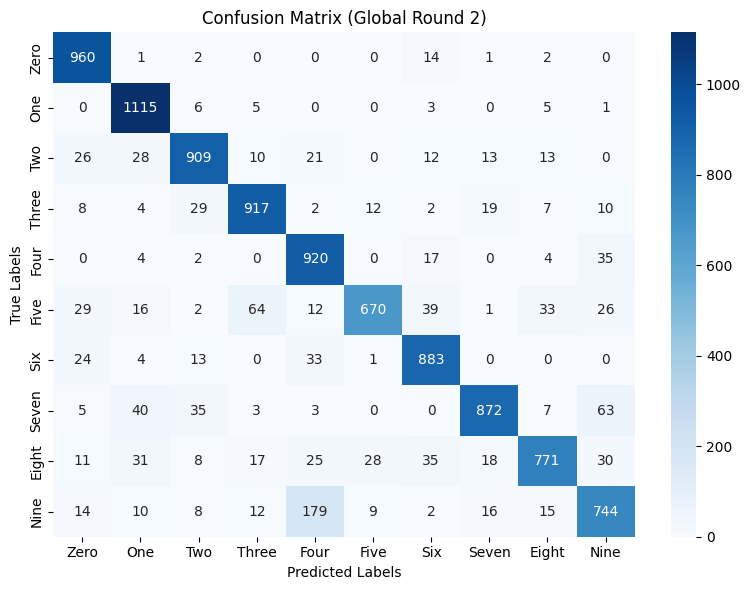


 | Global training round : 3/20 |

Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.3289, Test accuracy: 9137/10000 (91.37%)

Class      - Accuracy
Zero       - 98.5
One        - 98.1
Two        - 92.0
Three      - 91.5
Four       - 96.6
Five       - 87.9
Six        - 9

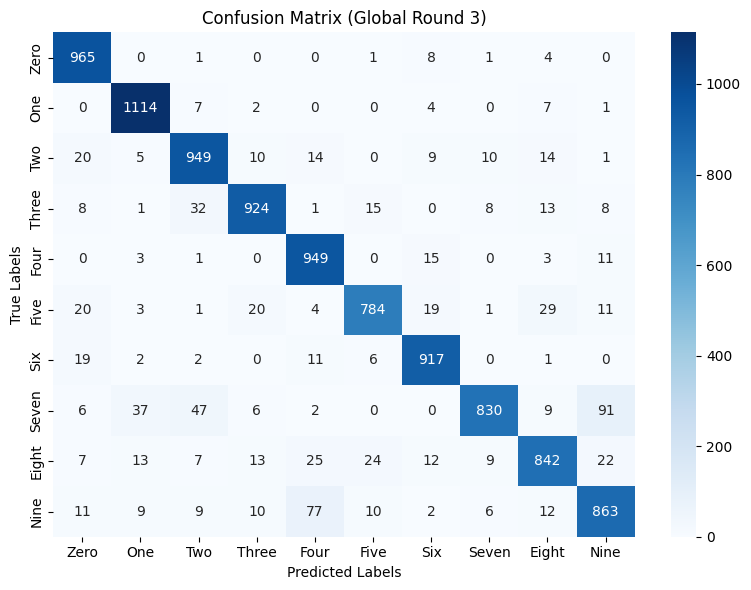


 | Global training round : 4/20 |

Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.2517, Test accuracy: 9301/10000 (93.01%)

Class      - Accuracy
Zero       - 98.6
One        - 98.6
Two        - 93.0
Three      - 92.7
Four       - 97.0
Five       - 91.7
Six        - 9

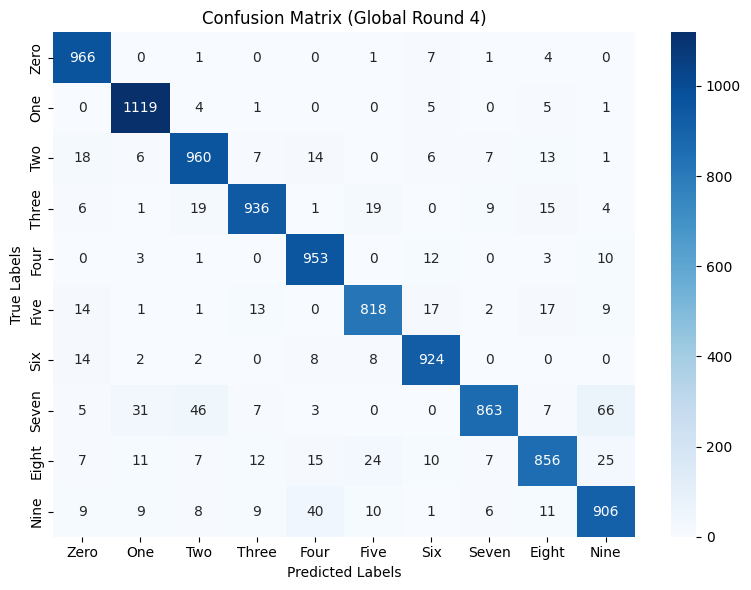


 | Global training round : 5/20 |

Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.2046, Test accuracy: 9399/10000 (93.99%)

Class      - Accuracy
Zero       - 98.6
One        - 98.7
Two        - 94.0
Three      - 94.0
Four       - 96.4
Five       - 93.9
Six        - 9

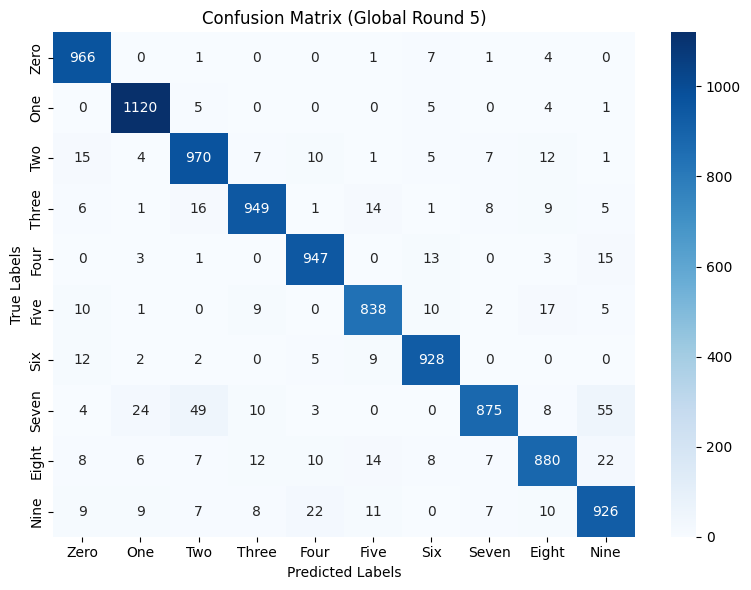


 | Global training round : 6/20 |

Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.1804, Test accuracy: 9464/10000 (94.64%)

Class      - Accuracy
Zero       - 98.8
One        - 98.7
Two        - 94.4
Three      - 94.5
Four       - 96.6
Five       - 95.2
Six        - 9

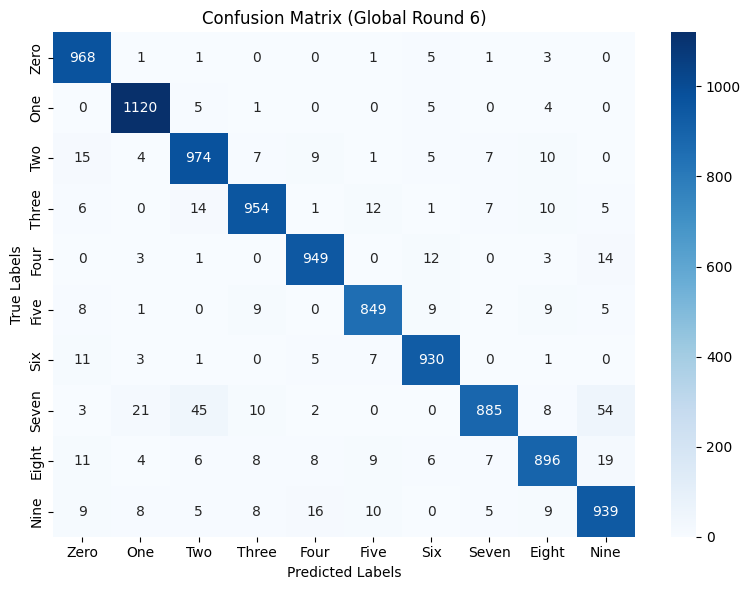


 | Global training round : 7/20 |

Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.1609, Test accuracy: 9506/10000 (95.06%)

Class      - Accuracy
Zero       - 98.7
One        - 98.8
Two        - 95.4
Three      - 95.0
Four       - 96.6
Five       - 96.3
Six        - 9

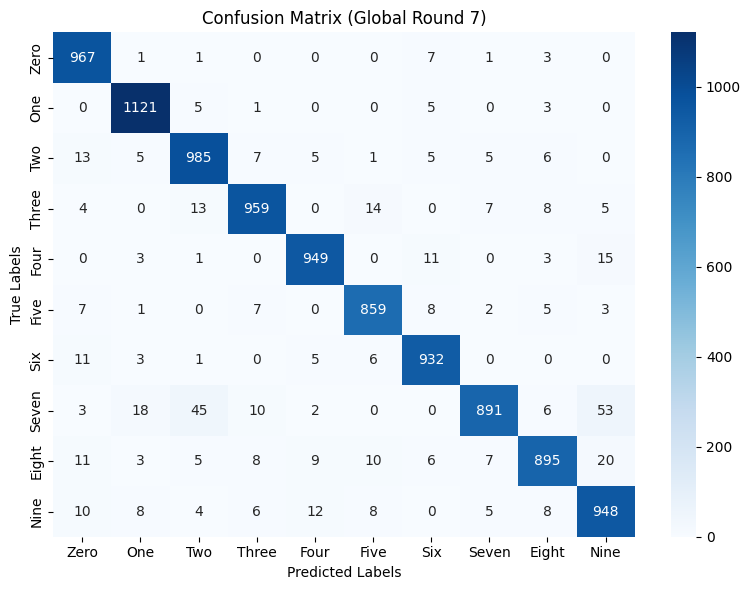


 | Global training round : 8/20 |

Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.1481, Test accuracy: 9549/10000 (95.49%)

Class      - Accuracy
Zero       - 98.9
One        - 98.9
Two        - 96.0
Three      - 95.3
Four       - 97.1
Five       - 96.4
Six        - 9

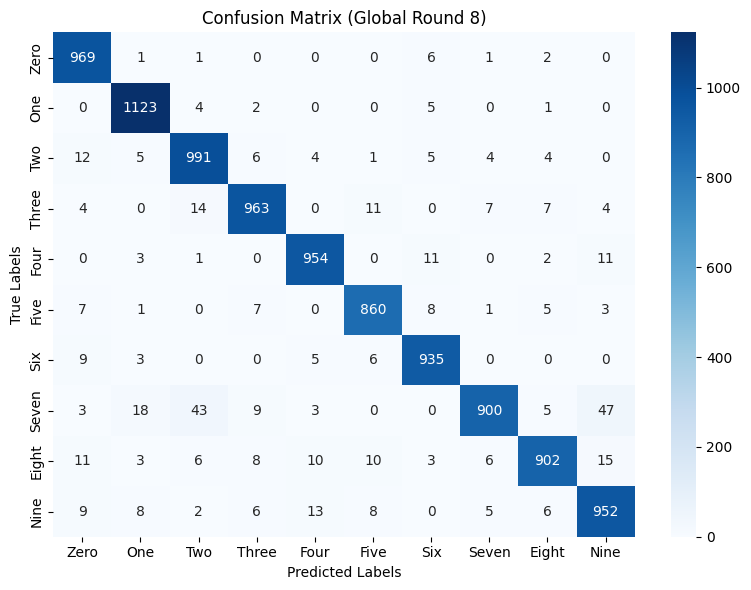


 | Global training round : 9/20 |

Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.1383, Test accuracy: 9576/10000 (95.76%)

Class      - Accuracy
Zero       - 98.7
One        - 99.0
Two        - 96.6
Three      - 95.3
Four       - 96.8
Five       - 97.0
Six        - 9

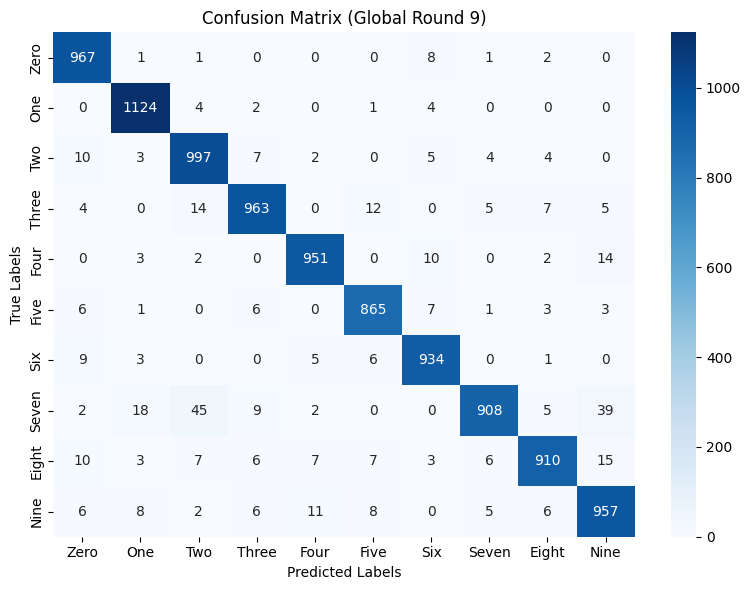


 | Global training round : 10/20 |

Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.1288, Test accuracy: 9612/10000 (96.12%)

Class      - Accuracy
Zero       - 98.8
One        - 98.9
Two        - 96.2
Three      - 95.7
Four       - 97.1
Five       - 97.4
Six        - 

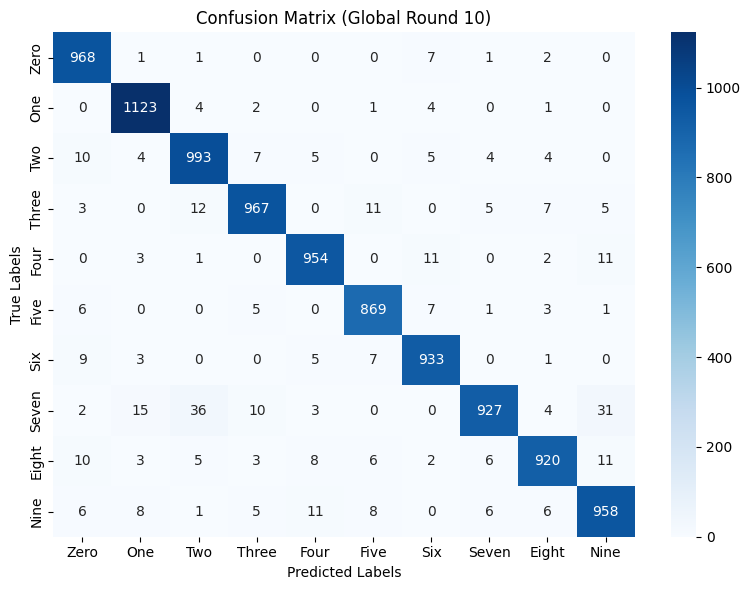


 | Global training round : 11/20 |

Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.1219, Test accuracy: 9631/10000 (96.31%)

Class      - Accuracy
Zero       - 98.8
One        - 99.0
Two        - 96.7
Three      - 96.2
Four       - 97.1
Five       - 97.8
Six        - 

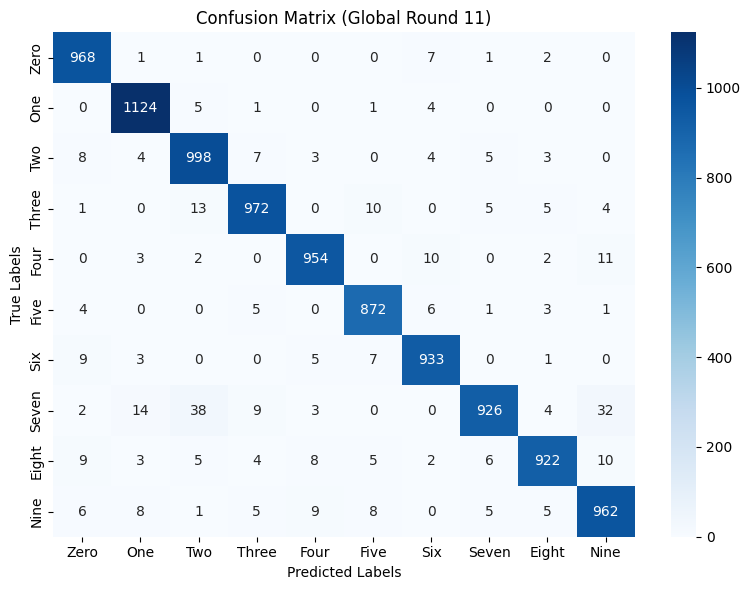


 | Global training round : 12/20 |

Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.1163, Test accuracy: 9654/10000 (96.54%)

Class      - Accuracy
Zero       - 98.8
One        - 99.0
Two        - 96.6
Three      - 96.9
Four       - 97.5
Five       - 97.9
Six        - 

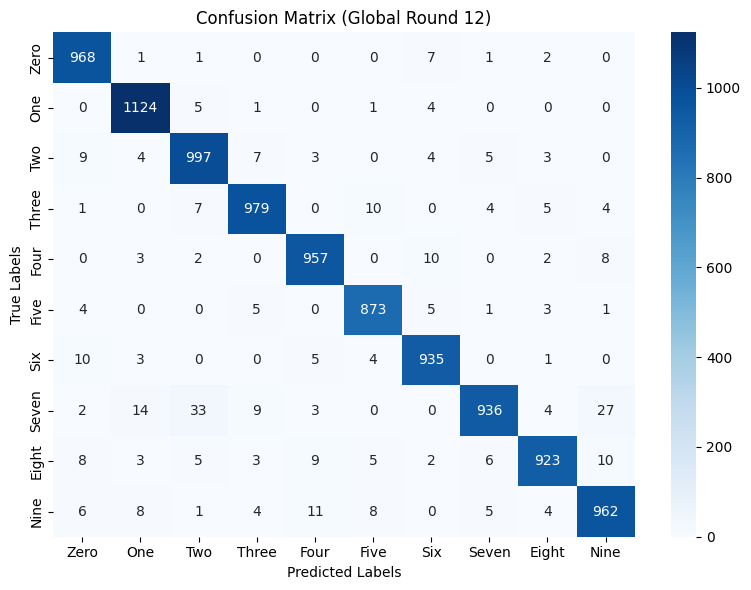


 | Global training round : 13/20 |

Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.1095, Test accuracy: 9671/10000 (96.71%)

Class      - Accuracy
Zero       - 98.8
One        - 99.0
Two        - 96.9
Three      - 96.8
Four       - 97.6
Five       - 98.1
Six        - 

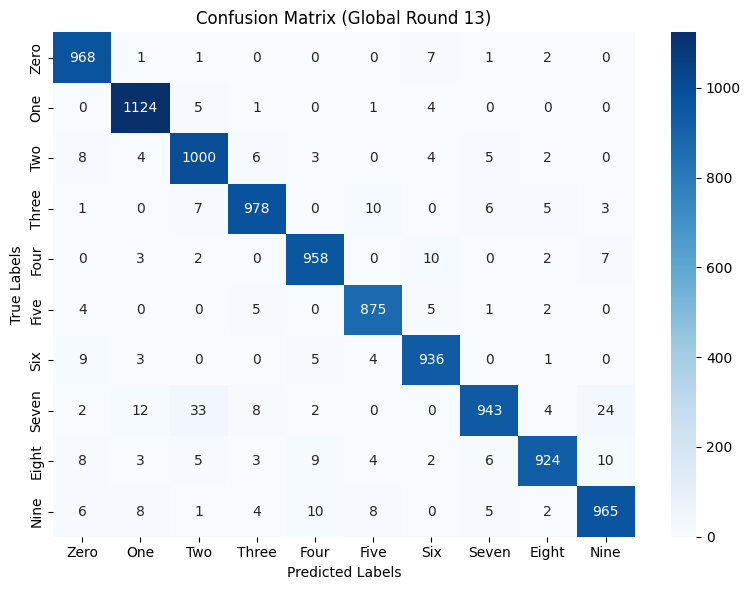


 | Global training round : 14/20 |

Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.1085, Test accuracy: 9678/10000 (96.78%)

Class      - Accuracy
Zero       - 99.0
One        - 99.1
Two        - 97.4
Three      - 96.5
Four       - 97.4
Five       - 98.1
Six        - 

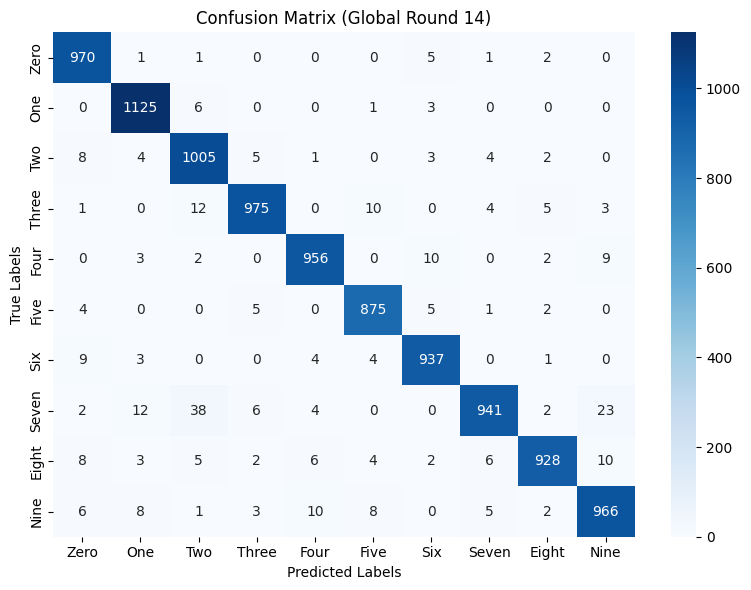


 | Global training round : 15/20 |

Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.1021, Test accuracy: 9696/10000 (96.96%)

Class      - Accuracy
Zero       - 99.1
One        - 99.2
Two        - 97.4
Three      - 97.0
Four       - 97.4
Five       - 98.3
Six        - 

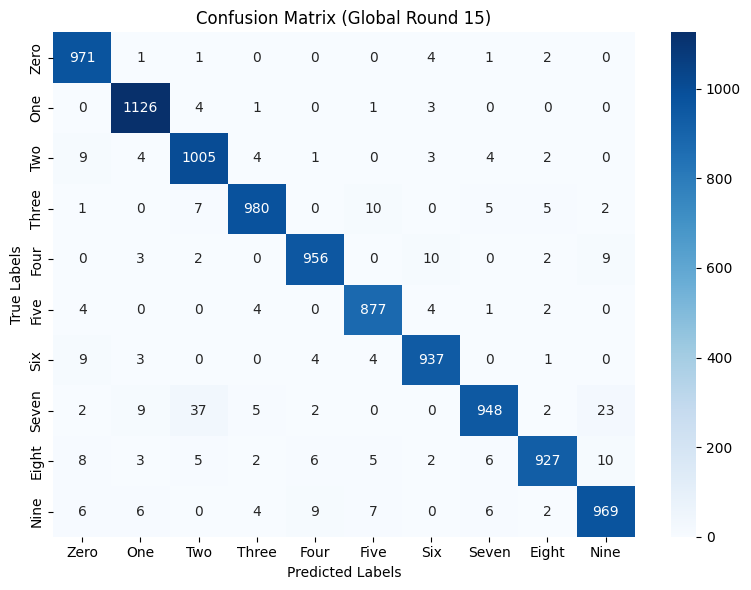


 | Global training round : 16/20 |

Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.0988, Test accuracy: 9701/10000 (97.01%)

Class      - Accuracy
Zero       - 99.1
One        - 99.2
Two        - 97.6
Three      - 97.1
Four       - 97.4
Five       - 98.2
Six        - 

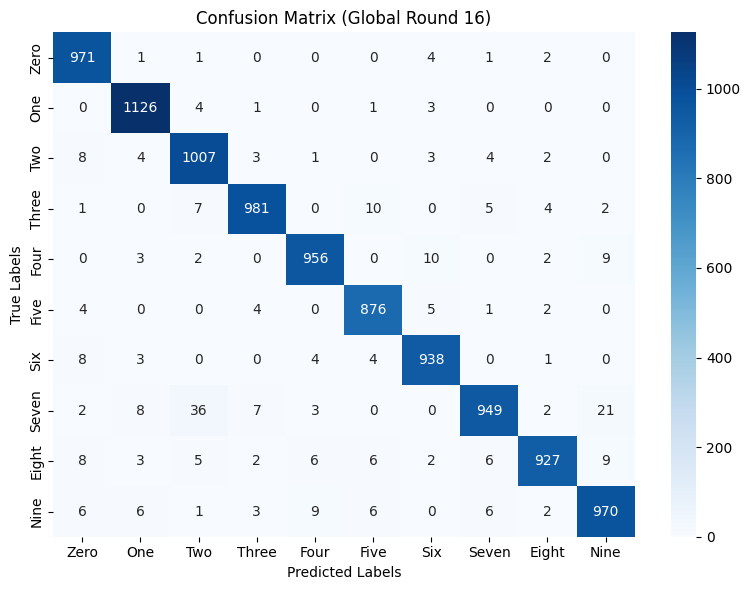


 | Global training round : 17/20 |

Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.0963, Test accuracy: 9713/10000 (97.13%)

Class      - Accuracy
Zero       - 99.2
One        - 99.3
Two        - 97.6
Three      - 97.1
Four       - 97.6
Five       - 98.1
Six        - 

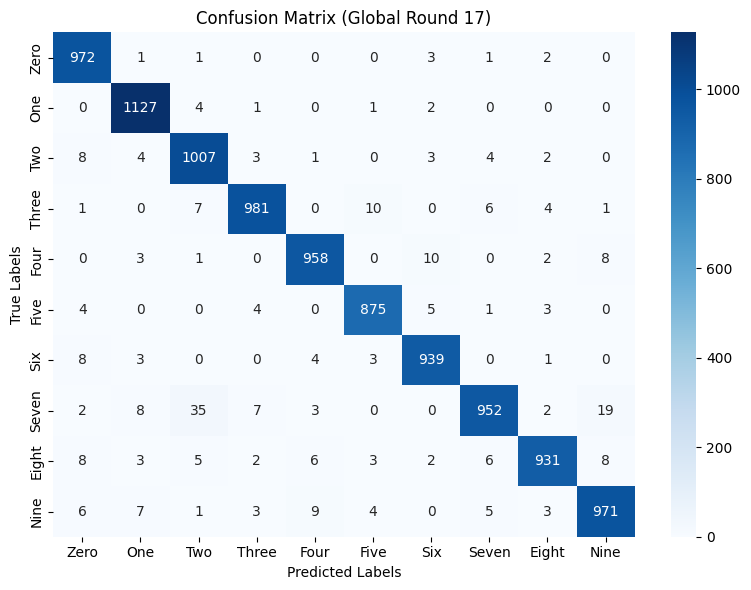


 | Global training round : 18/20 |

Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.0927, Test accuracy: 9722/10000 (97.22%)

Class      - Accuracy
Zero       - 99.0
One        - 99.3
Two        - 97.7
Three      - 97.5
Four       - 97.5
Five       - 98.3
Six        - 

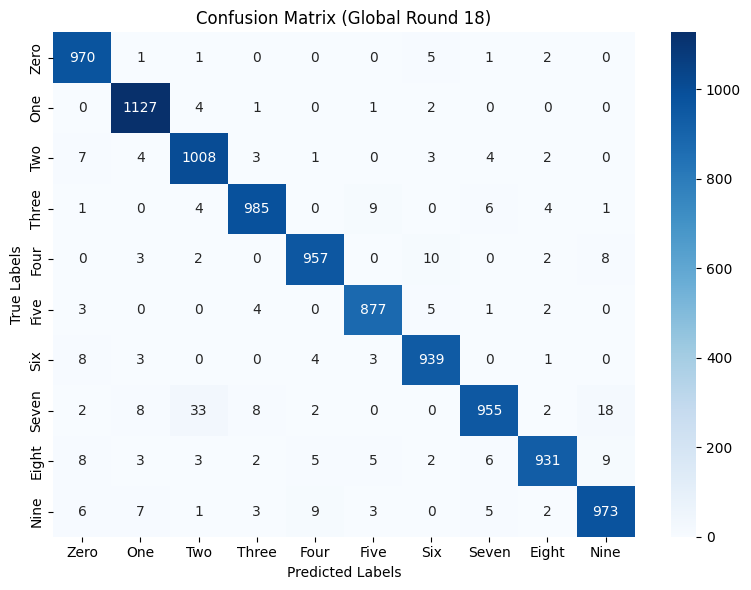


 | Global training round : 19/20 |

Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.0891, Test accuracy: 9732/10000 (97.32%)

Class      - Accuracy
Zero       - 99.2
One        - 99.3
Two        - 98.0
Three      - 97.3
Four       - 97.8
Five       - 98.4
Six        - 

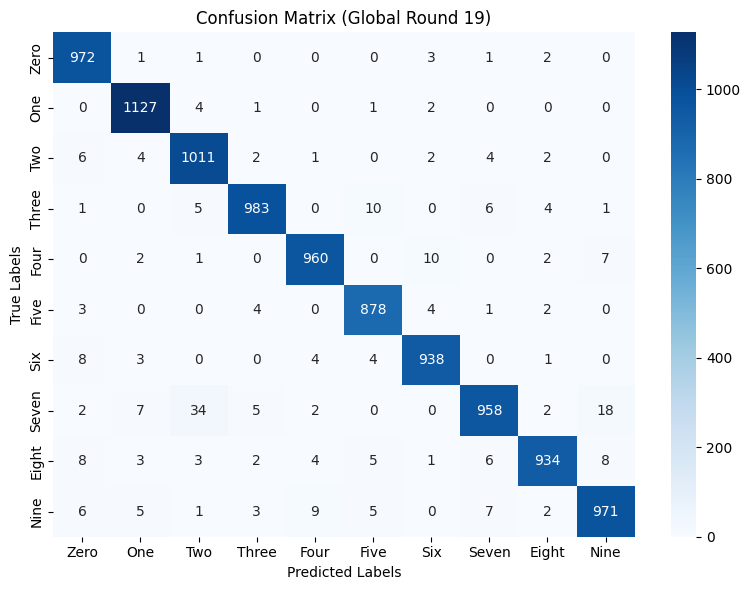


 | Global training round : 20/20 |

Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 0.0871, Test accuracy: 9733/10000 (97.33%)

Class      - Accuracy
Zero       - 99.1
One        - 99.3
Two        - 97.8
Three      - 97.3
Four       - 97.3
Five       - 98.5
Six        - 

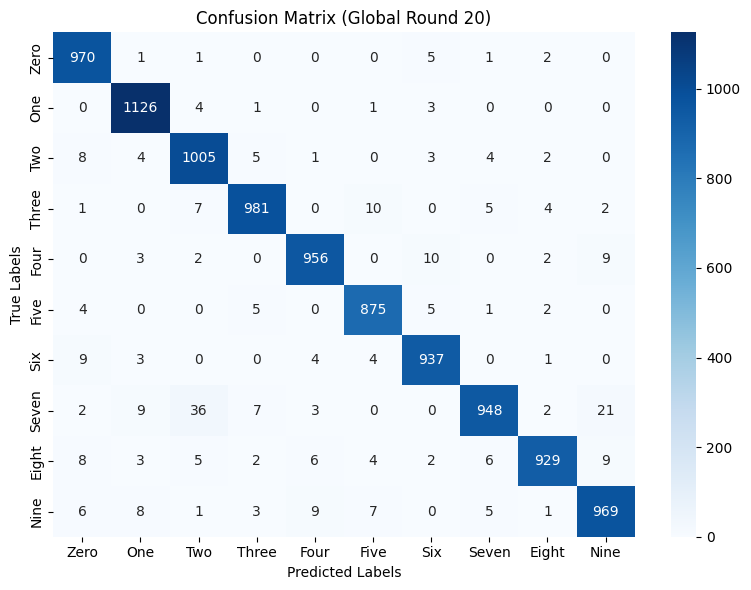

Global accuracies:  [np.float64(73.01), np.float64(87.61), np.float64(91.37), np.float64(93.01), np.float64(93.99), np.float64(94.64), np.float64(95.06), np.float64(95.49), np.float64(95.76), np.float64(96.12), np.float64(96.31), np.float64(96.54), np.float64(96.71), np.float64(96.78), np.float64(96.96), np.float64(97.01), np.float64(97.13), np.float64(97.22), np.float64(97.32), np.float64(97.33), np.float64(96.96)]
Class 7 accuracies:  [np.float64(75.39), np.float64(84.82), np.float64(80.74), np.float64(83.95), np.float64(85.12), np.float64(86.09), np.float64(86.67), np.float64(87.55), np.float64(88.33), np.float64(90.18), np.float64(90.08), np.float64(91.05), np.float64(91.73), np.float64(91.54), np.float64(92.22), np.float64(92.32), np.float64(92.61), np.float64(92.9), np.float64(93.19), np.float64(93.19), np.float64(92.22)]
Test loss: [np.float64(1.6827), np.float64(0.5337), np.float64(0.3289), np.float64(0.2517), np.float64(0.2046), np.float64(0.1804), np.float64(0.1609), np.float

In [ ]:
RULE = 'robutslfd'
ATTACK_TYPE='label_flipping'
MALICIOUS_BEHAVIOR_RATE = 1
for atr in [0.2]:
    run_exp(dataset_name = DATASET_NAME, model_name = MODEL_NAME, dd_type = DD_TYPE, num_peers = NUM_PEERS,
            frac_peers = FRAC_PEERS, seed = SEED, test_batch_size = TEST_BATCH_SIZE,
                criterion = CRITERION, global_rounds = GLOBAL_ROUNDS, local_epochs = LOCAL_EPOCHS, local_bs = LOCAL_BS,
                 local_lr = LOCAL_LR, local_momentum = LOCAL_MOMENTUM, labels_dict = LABELS_DICT, device = DEVICE,
                attackers_ratio = atr, attack_type=ATTACK_TYPE,
                 malicious_behavior_rate = MALICIOUS_BEHAVIOR_RATE, rule = RULE,
                source_class = SOURCE_CLASS, target_class = TARGET_CLASS,
               class_per_peer = CLASS_PER_PEER, samples_per_class = SAMPLES_PER_CLASS,
               rate_unbalance = RATE_UNBALANCE, alpha = ALPHA, resume = False)


MNIST, NON-IID, 30% attacker

In [ ]:

#=============================== Defining global variables ========================#
DATASET_NAME = "MNIST"
MODEL_NAME = "CNNMNIST"
DD_TYPE = 'NON_IID'
ALPHA = 1
NUM_PEERS = 50 # "number of peers: K"
FRAC_PEERS = 1 #'the fraction of peers: C to bel selected in each round'
SEED = 7 #fixed seed
random.seed(SEED)
CRITERION = nn.CrossEntropyLoss()
GLOBAL_ROUNDS = 20 #"number of rounds of federated model training"
LOCAL_EPOCHS = 3 #"the number of local epochs: E for each peer"
TEST_BATCH_SIZE = 1000
LOCAL_BS = 64 #"local batch size: B for each peer"
LOCAL_LR =  0.01#local learning rate: lr for each peer
LOCAL_MOMENTUM = 0.9 #local momentum for each peer
NUM_CLASSES = 10 # number of classes in an experiment
LABELS_DICT = {'Zero':0,
               'One':1,
               'Two':2,
               'Three':3,
               'Four':4,
               'Five':5,
               'Six':6,
               'Seven':7,
               'Eight':8,
               'Nine':9}

#select the device to work with cpu or gpu
if torch.cuda.is_available():
    DEVICE = "cuda"
else:
    DEVICE = "cpu"
DEVICE = torch.device(DEVICE)
print(DEVICE)
SOURCE_CLASS = 7 # the source class
TARGET_CLASS = 1 # the target class

CLASS_PER_PEER = 10
SAMPLES_PER_CLASS = 582
RATE_UNBALANCE = 1

cuda



--> Label FLIP experiment on our algo...
--> Loading of MNIST dataset
--> Dataset has been loaded!
--> Creating CNNMNIST model.....
--> Model has been created!
--> Distributing training data among peers
--> Training data have been distributed among peers
--> Creating peets instances
Data set: MNIST
Data distribution: NON_IID
Aggregation rule: robutslfd
Attack Type: label_flipping
Attackers Ratio: 30.0 %
Malicious Behavior Rate: 100 %

===>Simulation started...

====>Global model training started...



  0%|          | 0/20 [00:00<?, ?it/s]


 | Global training round : 1/20 |

Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched b

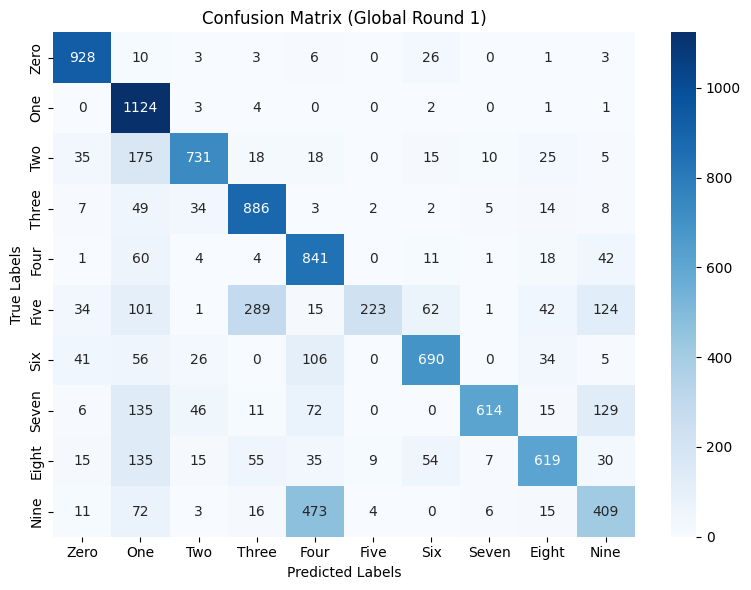


 | Global training round : 2/20 |

Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched b

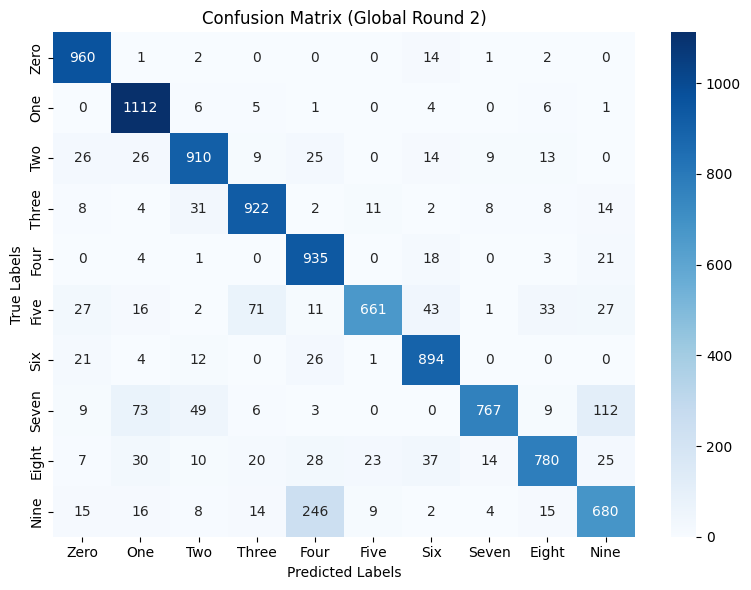


 | Global training round : 3/20 |

Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched 

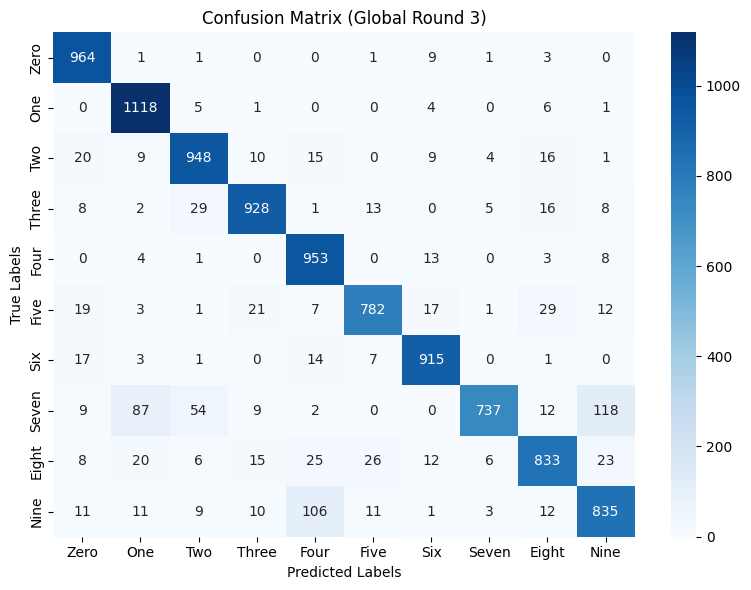


 | Global training round : 4/20 |

Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by

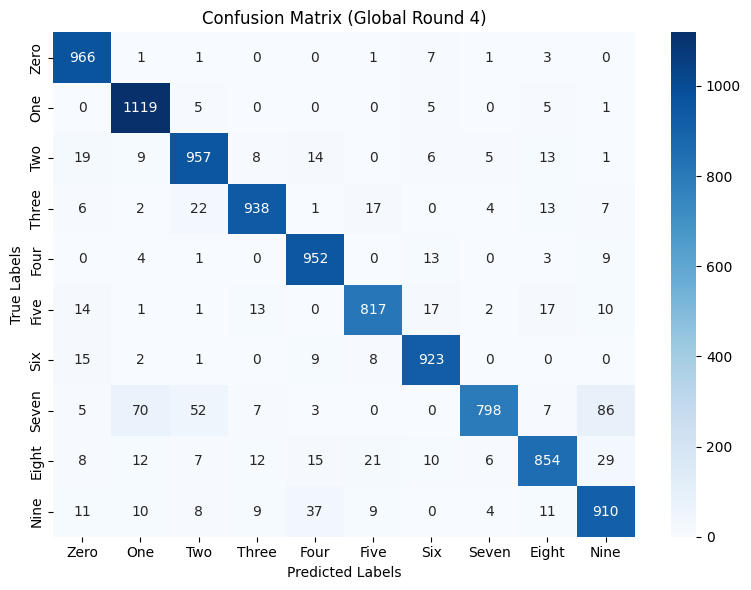


 | Global training round : 5/20 |

Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by

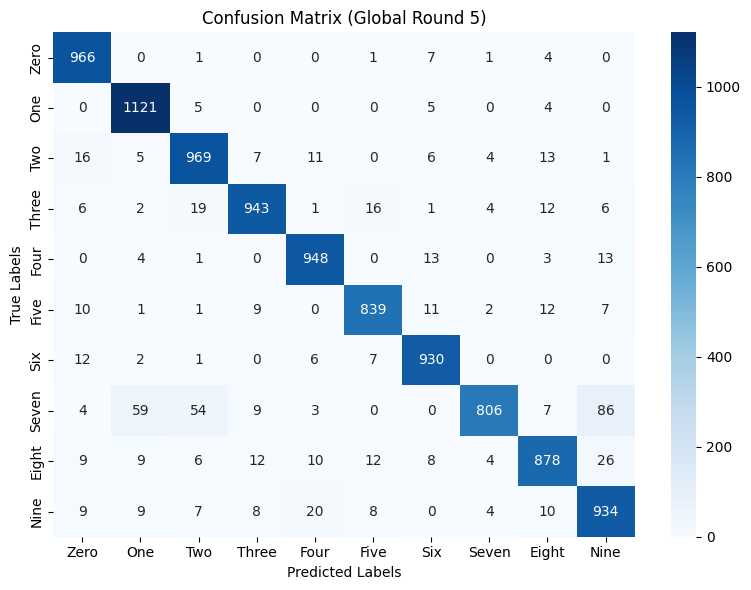


 | Global training round : 6/20 |

Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched b

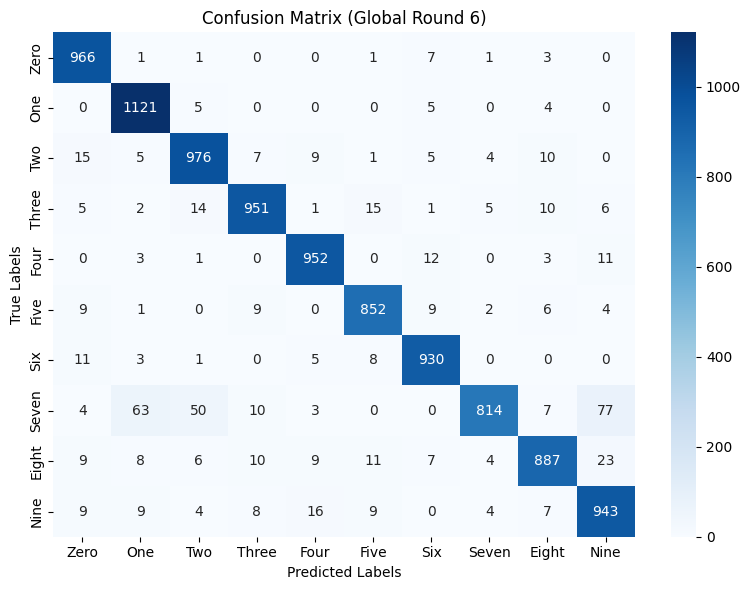


 | Global training round : 7/20 |

Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched b

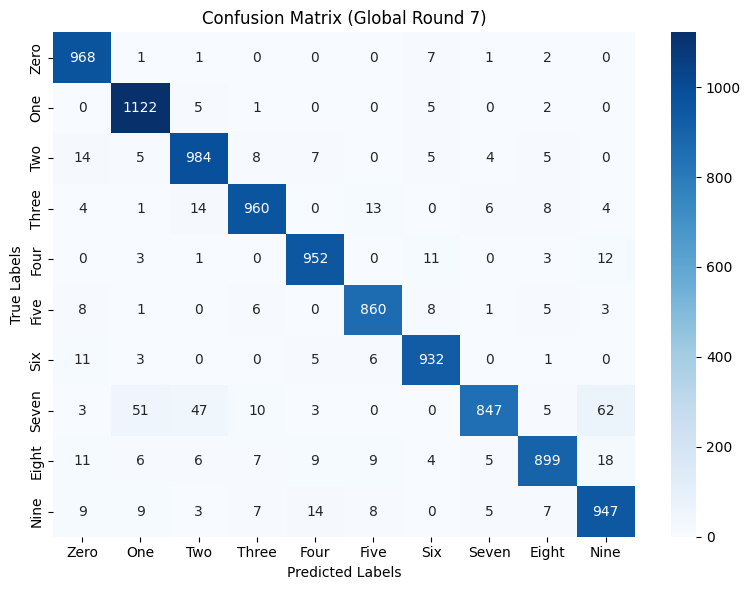


 | Global training round : 8/20 |

Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched b

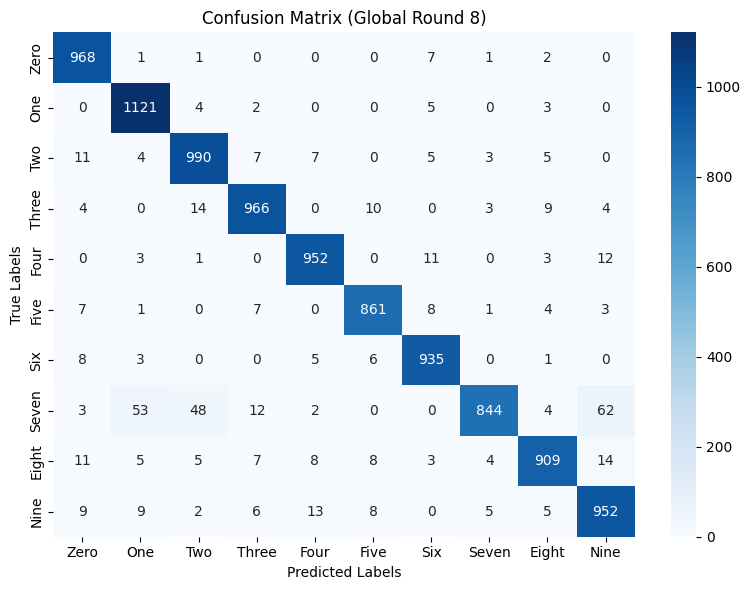


 | Global training round : 9/20 |

Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched b

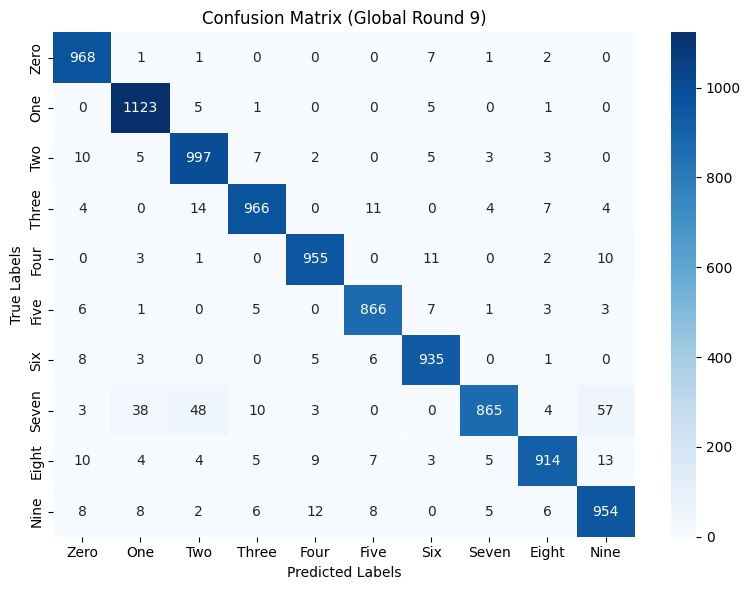


 | Global training round : 10/20 |

Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched 

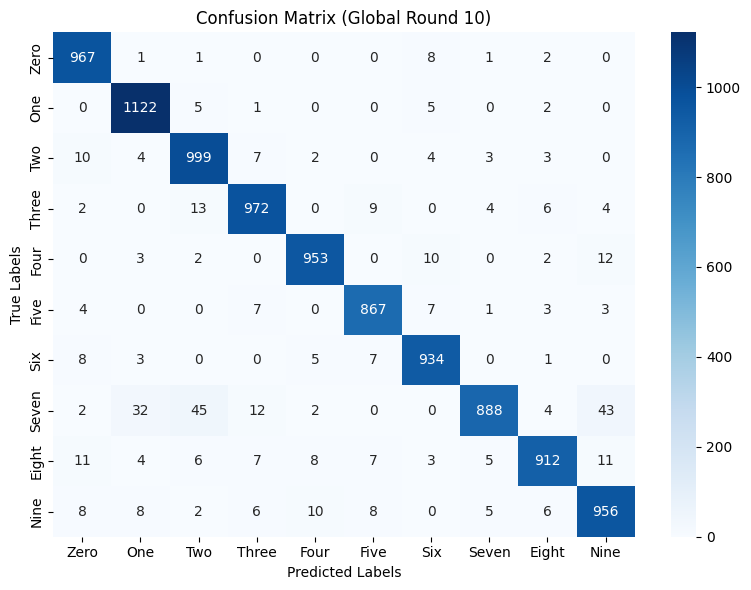


 | Global training round : 11/20 |

Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched

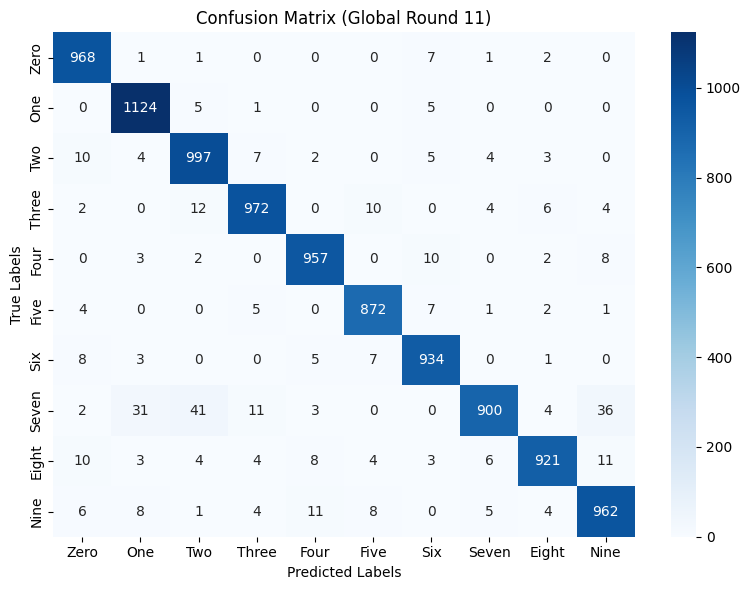


 | Global training round : 12/20 |

Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched b

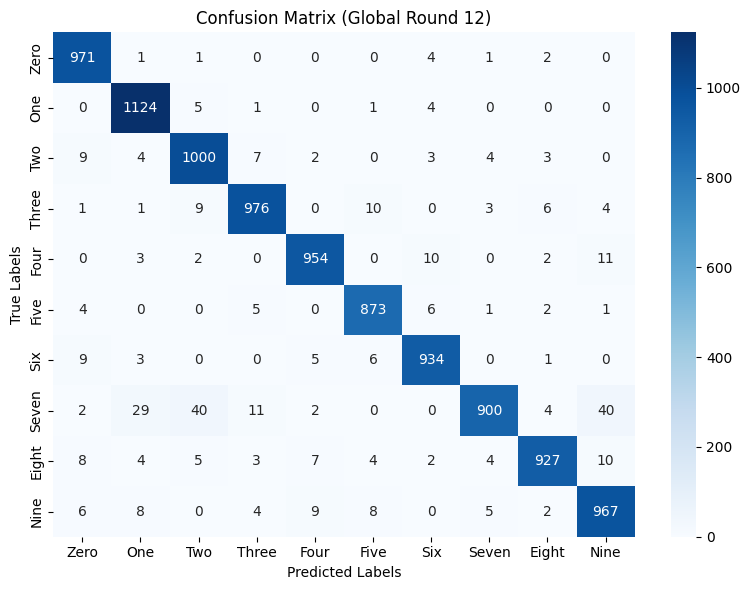


 | Global training round : 13/20 |

Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched

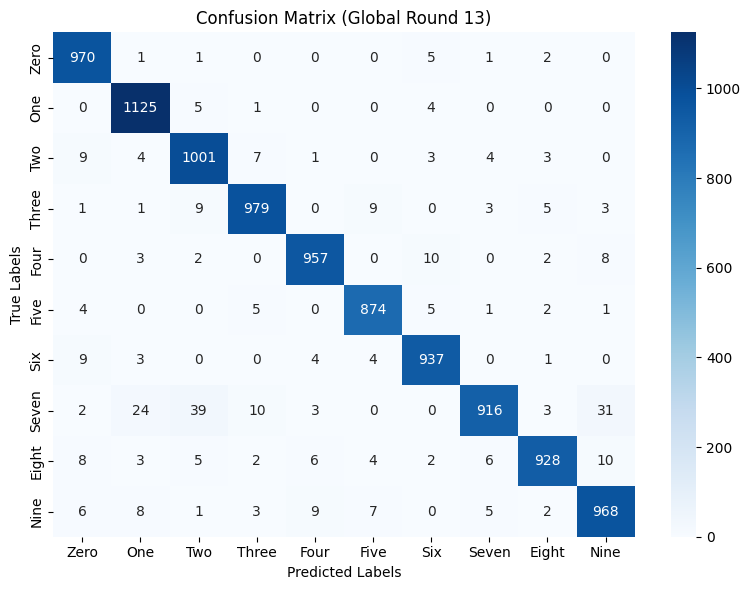


 | Global training round : 14/20 |

Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched 

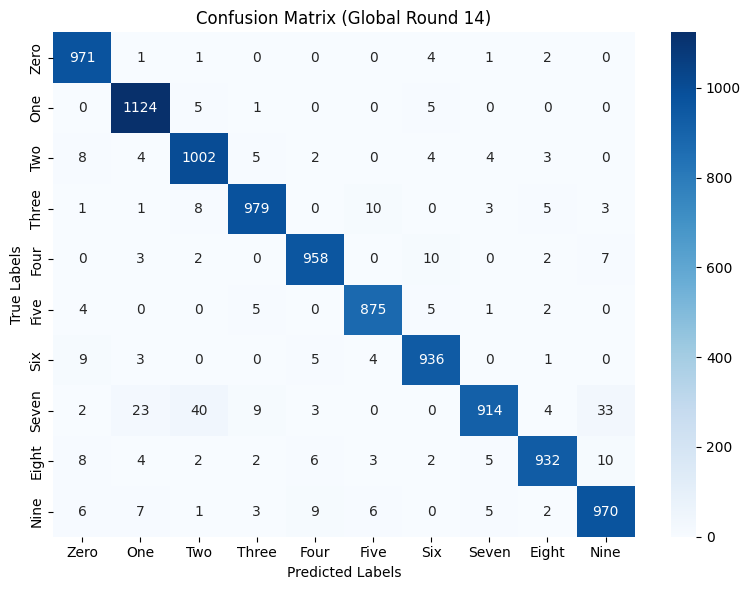


 | Global training round : 15/20 |

Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched 

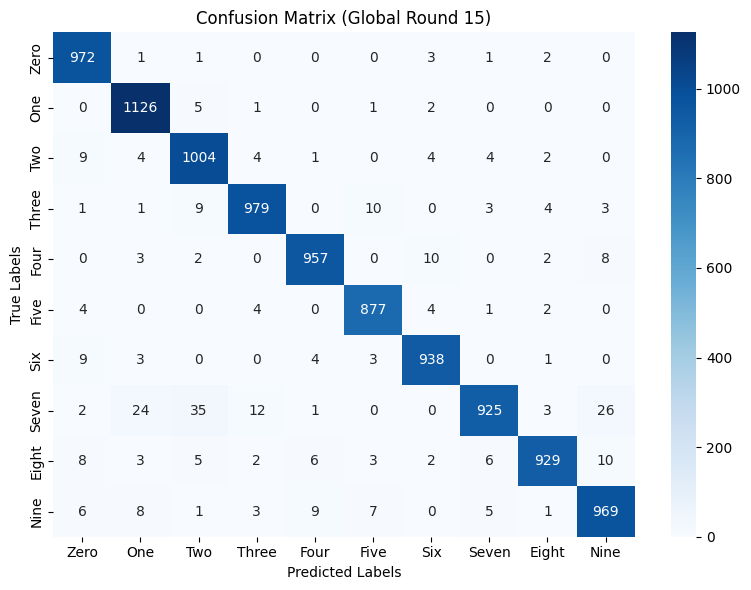


 | Global training round : 16/20 |

Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched b

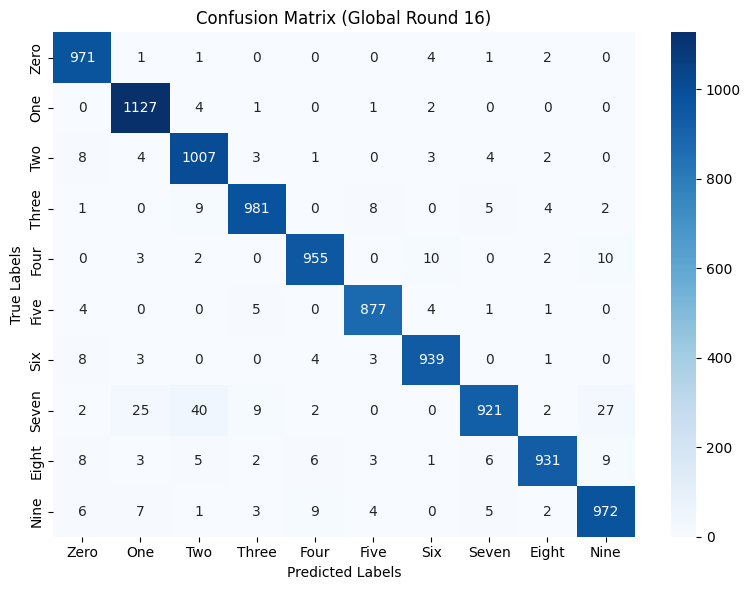


 | Global training round : 17/20 |

Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched 

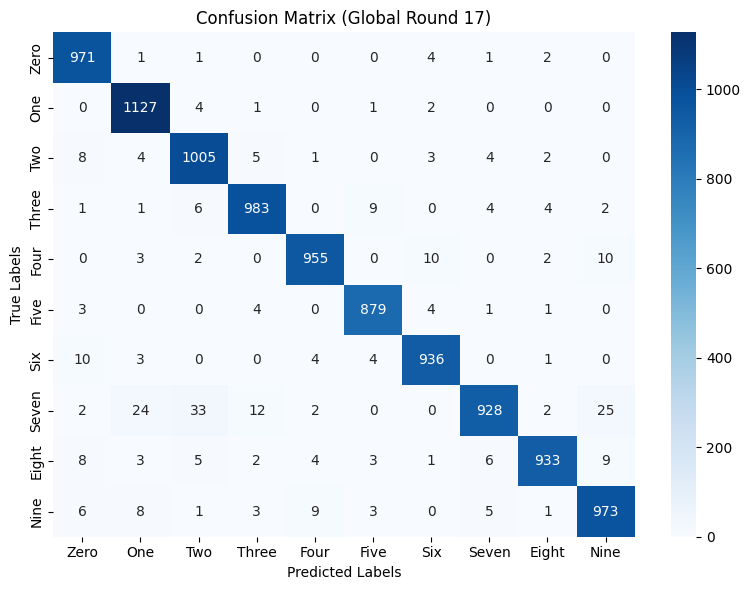


 | Global training round : 18/20 |

Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched b

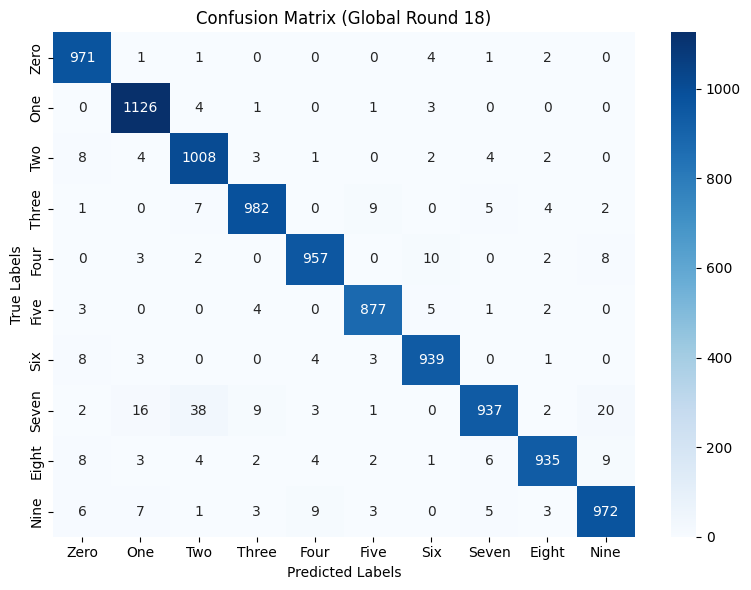


 | Global training round : 19/20 |

Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 6 to flip class  7  to class  1
Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched 

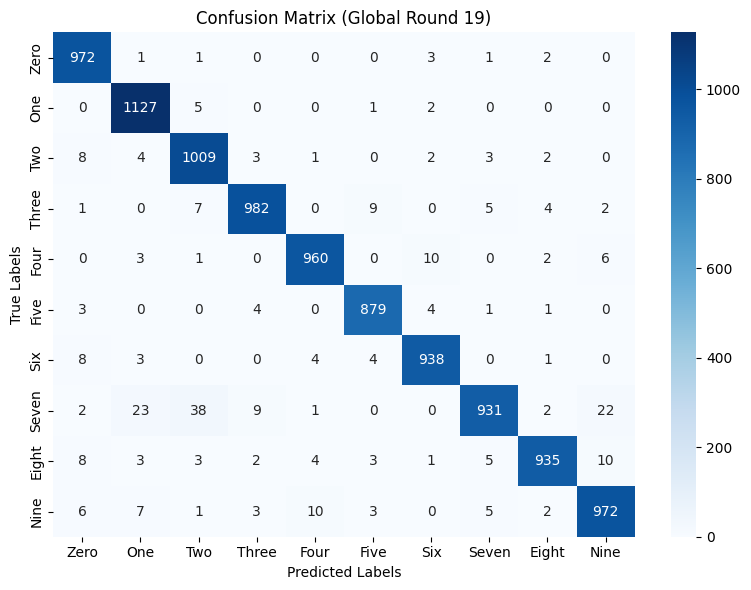


 | Global training round : 20/20 |

Label flipping attack launched by Peer 1 to flip class  7  to class  1
Label flipping attack launched by Peer 28 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 45 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 48 to flip class  7  to class  1
Label flipping attack launched by Peer 47 to flip class  7  to class  1
Label flipping attack launched by Peer 19 to flip class  7  to class  1
Label flipping attack launched by Peer 8 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 40 to flip class  7  to class  1
Label flipping attack launched by Peer 29 to flip class  7  to class  1
Label flipping attack launched by Peer 22 to flip class  7  to class  1
Label flipping attack launched

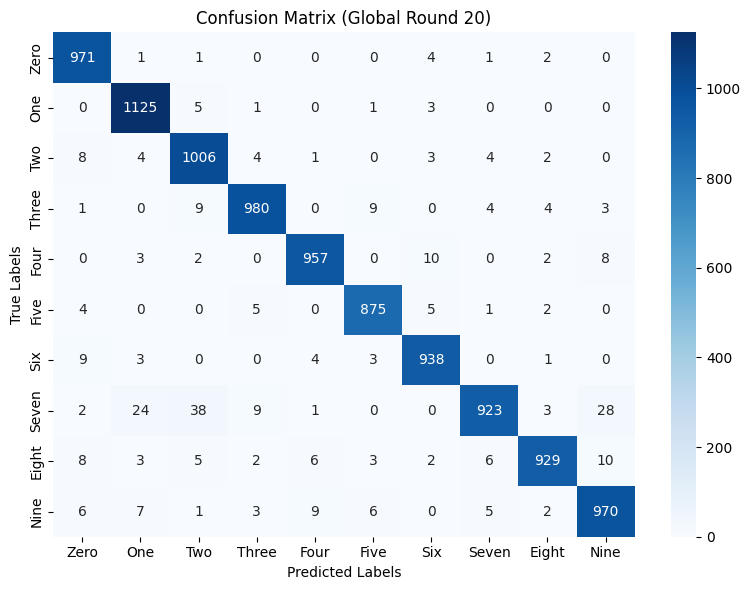

Global accuracies:  [np.float64(70.65), np.float64(86.21), np.float64(90.13), np.float64(92.34), np.float64(93.34), np.float64(93.92), np.float64(94.71), np.float64(94.98), np.float64(95.43), np.float64(95.7), np.float64(96.07), np.float64(96.26), np.float64(96.55), np.float64(96.61), np.float64(96.76), np.float64(96.81), np.float64(96.9), np.float64(97.04), np.float64(97.05), np.float64(97.16), np.float64(96.74)]
Class 7 accuracies:  [np.float64(59.73), np.float64(74.61), np.float64(71.69), np.float64(77.63), np.float64(78.4), np.float64(79.18), np.float64(82.39), np.float64(82.1), np.float64(84.14), np.float64(86.38), np.float64(87.55), np.float64(87.55), np.float64(89.11), np.float64(88.91), np.float64(89.98), np.float64(89.59), np.float64(90.27), np.float64(91.15), np.float64(90.56), np.float64(91.25), np.float64(89.79)]
Test loss: [np.float64(1.7037), np.float64(0.5597), np.float64(0.352), np.float64(0.2629), np.float64(0.2237), np.float64(0.1984), np.float64(0.1775), np.float64(0

In [ ]:
RULE = 'robutslfd'
ATTACK_TYPE='label_flipping'
MALICIOUS_BEHAVIOR_RATE = 1
for atr in [0.3]:
    run_exp(dataset_name = DATASET_NAME, model_name = MODEL_NAME, dd_type = DD_TYPE, num_peers = NUM_PEERS,
            frac_peers = FRAC_PEERS, seed = SEED, test_batch_size = TEST_BATCH_SIZE,
                criterion = CRITERION, global_rounds = GLOBAL_ROUNDS, local_epochs = LOCAL_EPOCHS, local_bs = LOCAL_BS,
                 local_lr = LOCAL_LR, local_momentum = LOCAL_MOMENTUM, labels_dict = LABELS_DICT, device = DEVICE,
                attackers_ratio = atr, attack_type=ATTACK_TYPE,
                 malicious_behavior_rate = MALICIOUS_BEHAVIOR_RATE, rule = RULE,
                source_class = SOURCE_CLASS, target_class = TARGET_CLASS,
               class_per_peer = CLASS_PER_PEER, samples_per_class = SAMPLES_PER_CLASS,
               rate_unbalance = RATE_UNBALANCE, alpha = ALPHA, resume = False)


Cifar, NON-IID, 10% attacker

In [ ]:
#=============================== Defining global variables ========================#
DATASET_NAME = "CIFAR10"
MODEL_NAME = "ResNet18"
DD_TYPE = 'NON_IID'
ALPHA = 1
NUM_PEERS = 20 # "number of peers: K"
FRAC_PEERS = 1 #'the fraction of peers: C to bel selected in each round'
SEED = 7 #fixed seed
random.seed(SEED)
CRITERION = nn.CrossEntropyLoss()
GLOBAL_ROUNDS = 20 #"number of rounds of federated model training"
LOCAL_EPOCHS = 3 #"the number of local epochs: E for each peer"
TEST_BATCH_SIZE = 1000
LOCAL_BS = 32 #"local batch size: B for each peer"
LOCAL_LR =  0.01#local learning rate: lr for each peer
LOCAL_MOMENTUM = 0.9 #local momentum for each peer
NUM_CLASSES = 10 # number of classes in an experiment
LABELS_DICT = {'Plane':0,
               'Car':1,
               'Bird':2,
               'Cat':3,
               'Deer':4,
               'Dog':5,
               'Frog':6,
               'Horse':7,
               'Ship':8,
               'Truck':9}

#select the device to work with cpu or gpu
if torch.cuda.is_available():
    DEVICE = "cuda"
else:
    DEVICE = "cpu"
DEVICE = torch.device(DEVICE)
print(DEVICE)
SOURCE_CLASS = 5 # the source class
TARGET_CLASS = 3 # the target class

CLASS_PER_PEER = 1
SAMPLES_PER_CLASS = 582
RATE_UNBALANCE = 1


cuda



--> Label FLIP experiment on our algo...
--> Loading of CIFAR10 dataset
--> Dataset has been loaded!
--> Creating ResNet18 model.....
--> Model has been created!
--> Distributing training data among peers
--> Training data have been distributed among peers
--> Creating peets instances
Data set: CIFAR10
Data distribution: NON_IID
Aggregation rule: robutslfd
Attack Type: label_flipping
Attackers Ratio: 10.0 %
Malicious Behavior Rate: 100 %

===>Simulation started...

====>Global model training started...



  0%|          | 0/20 [00:00<?, ?it/s]


 | Global training round : 1/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 2.3579, Test accuracy: 1000/10000 (10.00%)

Class      - Accuracy
Plane      - 0.0
Car        - 0.0
Bird       - 100.0
Cat        - 0.0
Deer       - 0.0
Dog        - 0.0
Frog       - 0.0
Horse      - 0.0
Ship       - 0.0
Truck      - 0.0


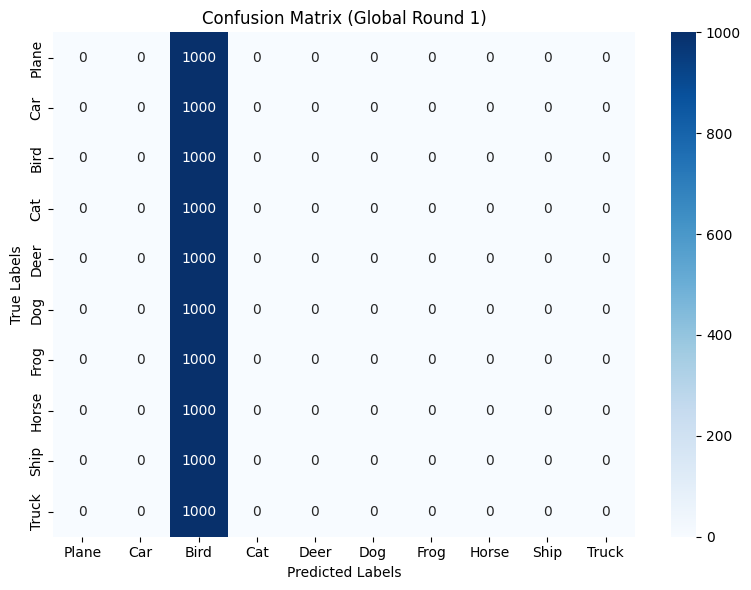


 | Global training round : 2/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 2.3090, Test accuracy: 1007/10000 (10.07%)

Class      - Accuracy
Plane      - 0.0
Car        - 0.0
Bird       - 0.8
Cat        - 99.9
Deer       - 0.0
Dog        - 0.0
Frog       - 0.0
Horse      - 0.0
Ship       - 0.0
Truck      - 0.0


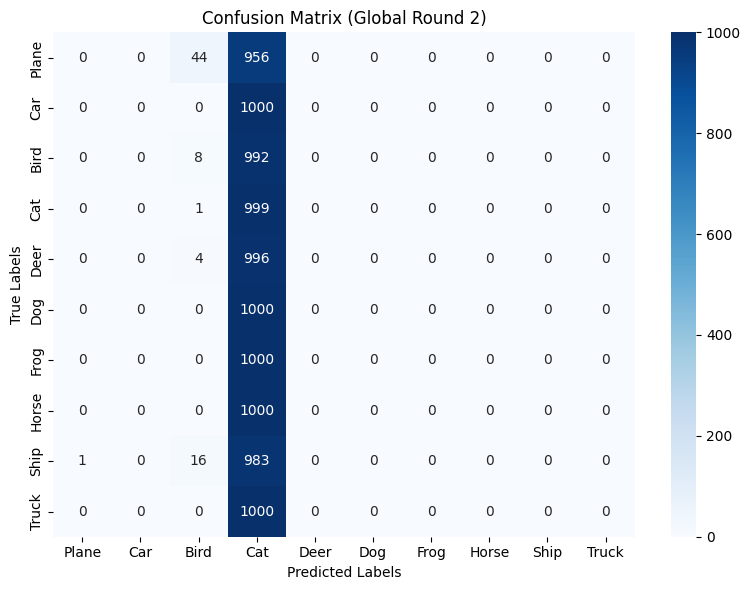


 | Global training round : 3/20 |

Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.9748, Test accuracy: 2766/10000 (27.66%)

Class      - Accuracy
Plane      - 33.5
Car        - 15.0
Bird       - 15.8
Cat        - 61.1
Deer       - 80.4
Dog        - 0.0
Frog       - 15.8
Horse      - 0.4
Ship       - 29.9
Truck      - 24.7


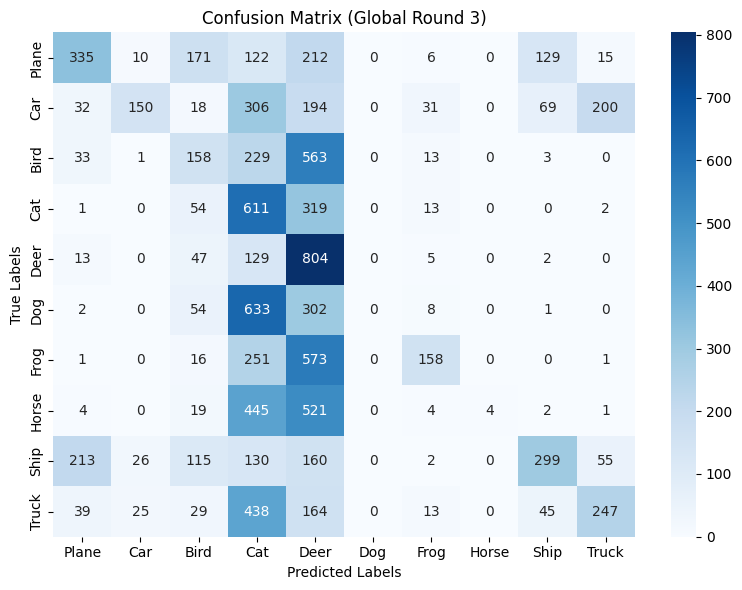


 | Global training round : 4/20 |

Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.4745, Test accuracy: 4711/10000 (47.11%)

Class      - Accuracy
Plane      - 44.8
Car        - 54.5
Bird       - 42.7
Cat        - 57.5
Deer       - 59.2
Dog        - 0.0
Frog       - 56.2
Horse      - 33.1
Ship       - 59.1
Truck      - 64.0


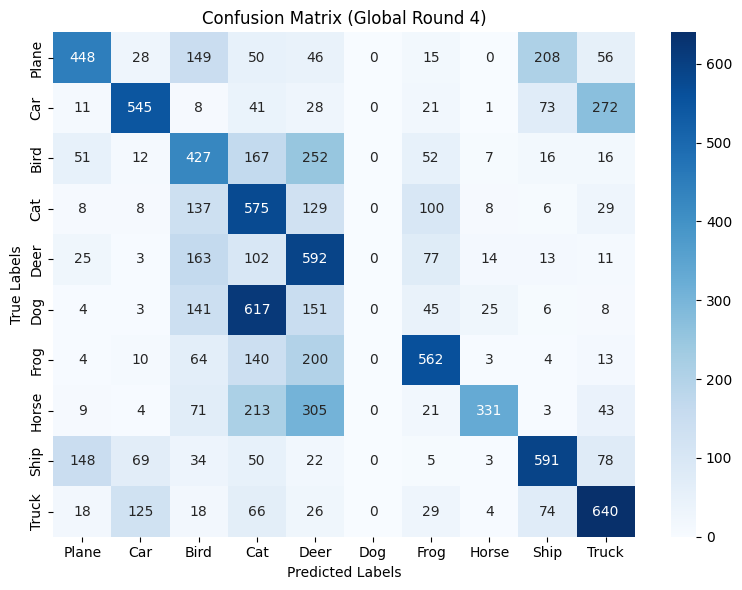


 | Global training round : 5/20 |

Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.2887, Test accuracy: 5290/10000 (52.90%)

Class      - Accuracy
Plane      - 47.2
Car        - 63.8
Bird       - 37.6
Cat        - 62.7
Deer       - 65.3
Dog        - 4.3
Frog       - 64.6
Horse      - 44.6
Ship       - 74.8
Truck      - 64.1


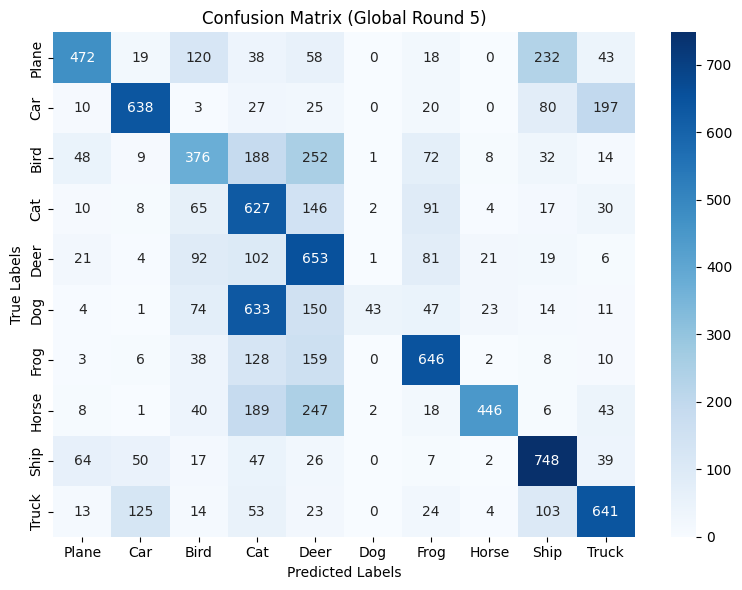


 | Global training round : 6/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.1767, Test accuracy: 5787/10000 (57.87%)

Class      - Accuracy
Plane      - 57.5
Car        - 68.7
Bird       - 38.6
Cat        - 59.5
Deer       - 67.8
Dog        - 17.9
Frog       - 73.4
Horse      - 53.3
Ship       - 75.6
Truck      - 66.4


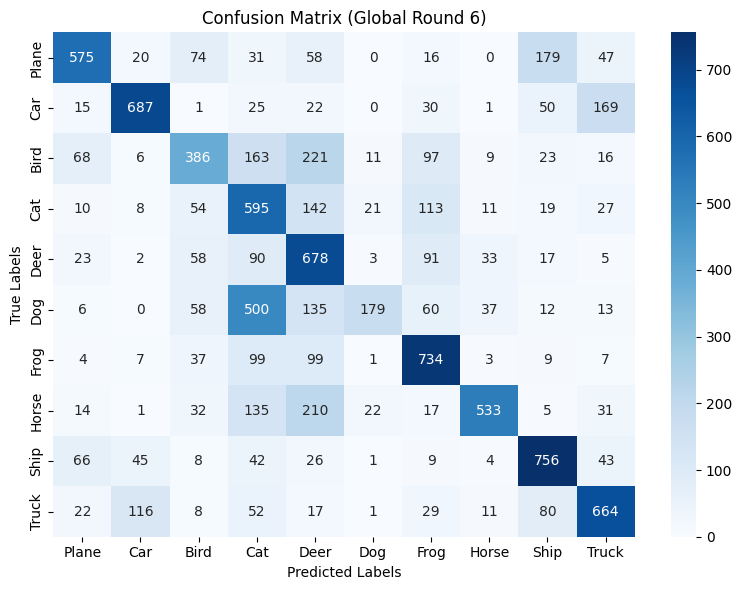


 | Global training round : 7/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.1185, Test accuracy: 6117/10000 (61.17%)

Class      - Accuracy
Plane      - 59.6
Car        - 69.0
Bird       - 42.1
Cat        - 57.8
Deer       - 71.5
Dog        - 24.9
Frog       - 77.5
Horse      - 56.2
Ship       - 81.9
Truck      - 71.2


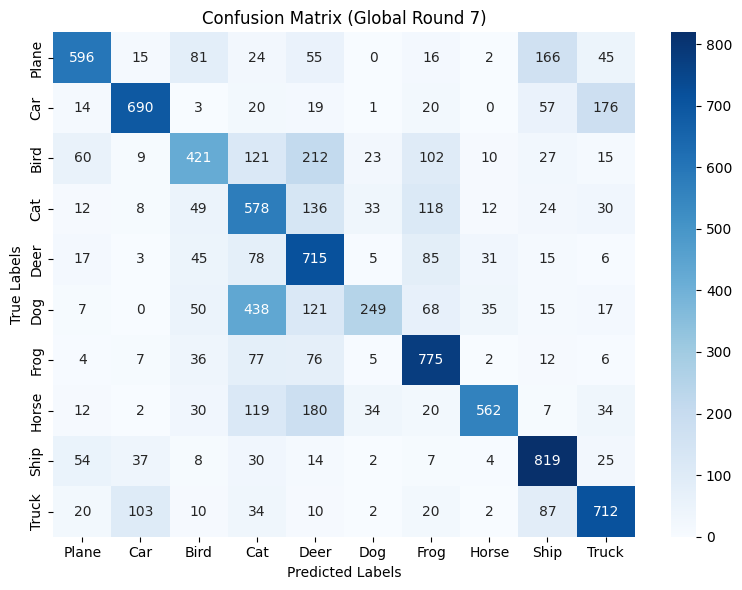


 | Global training round : 8/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0751, Test accuracy: 6342/10000 (63.42%)

Class      - Accuracy
Plane      - 65.7
Car        - 72.0
Bird       - 46.5
Cat        - 59.3
Deer       - 74.8
Dog        - 29.4
Frog       - 75.6
Horse      - 59.0
Ship       - 79.7
Truck      - 72.2


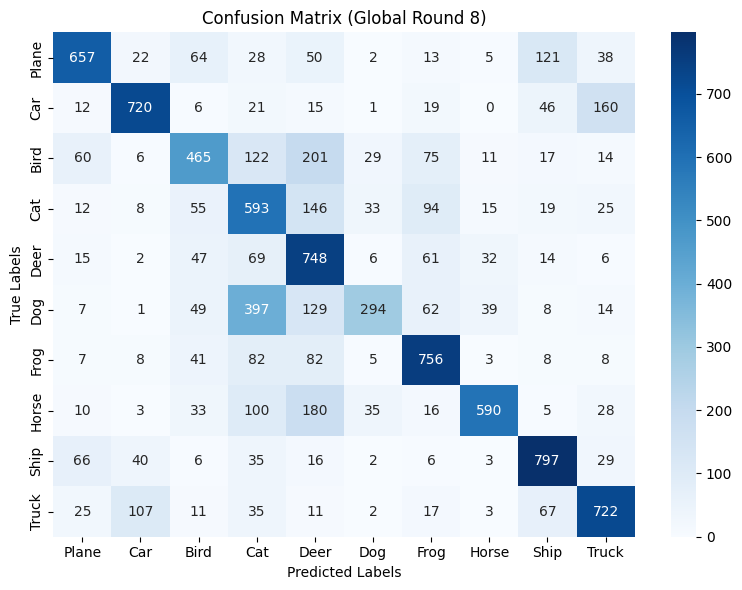


 | Global training round : 9/20 |

Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0455, Test accuracy: 6501/10000 (65.01%)

Class      - Accuracy
Plane      - 65.9
Car        - 72.2
Bird       - 44.4
Cat        - 59.5
Deer       - 76.1
Dog        - 33.9
Frog       - 80.1
Horse      - 60.7
Ship       - 82.7
Truck      - 74.6


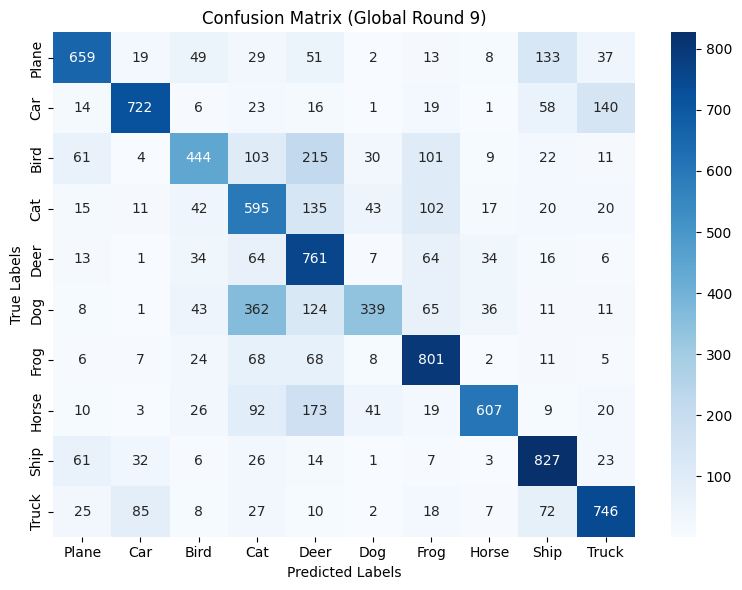


 | Global training round : 10/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0191, Test accuracy: 6685/10000 (66.85%)

Class      - Accuracy
Plane      - 69.3
Car        - 74.8
Bird       - 48.1
Cat        - 57.7
Deer       - 77.8
Dog        - 41.3
Frog       - 80.3
Horse      - 61.0
Ship       - 80.8
Truck      - 77.4


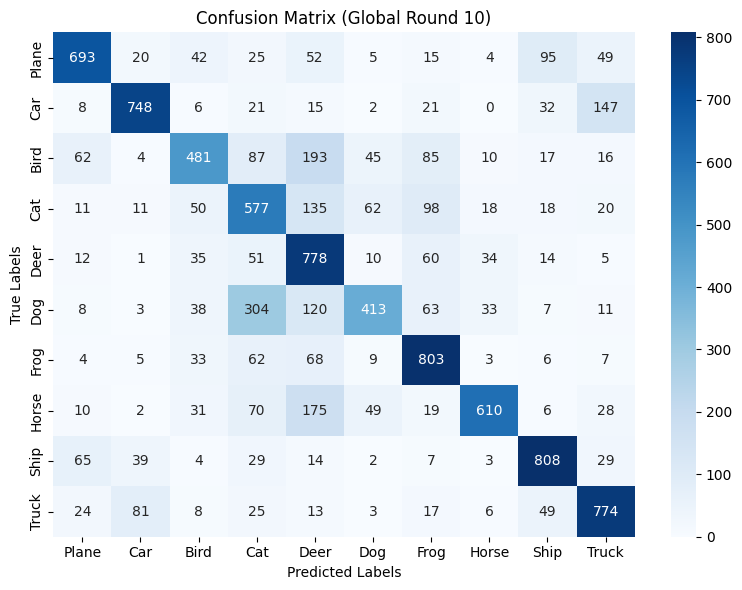


 | Global training round : 11/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0171, Test accuracy: 6734/10000 (67.34%)

Class      - Accuracy
Plane      - 72.1
Car        - 78.9
Bird       - 51.6
Cat        - 55.8
Deer       - 77.0
Dog        - 37.3
Frog       - 81.0
Horse      - 61.9
Ship       - 82.2
Truck      - 75.6


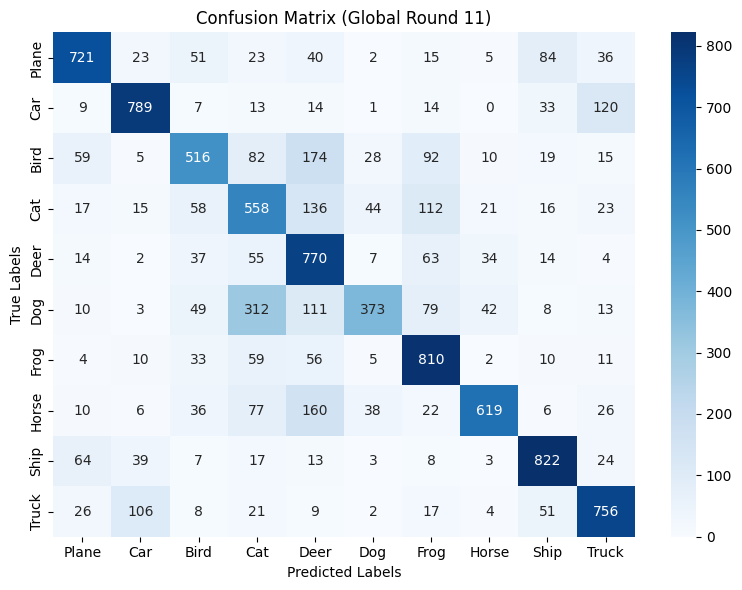


 | Global training round : 12/20 |

Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0106, Test accuracy: 6828/10000 (68.28%)

Class      - Accuracy
Plane      - 74.6
Car        - 78.4
Bird       - 51.0
Cat        - 58.8
Deer       - 77.8
Dog        - 37.7
Frog       - 81.5
Horse      - 63.2
Ship       - 84.5
Truck      - 75.3


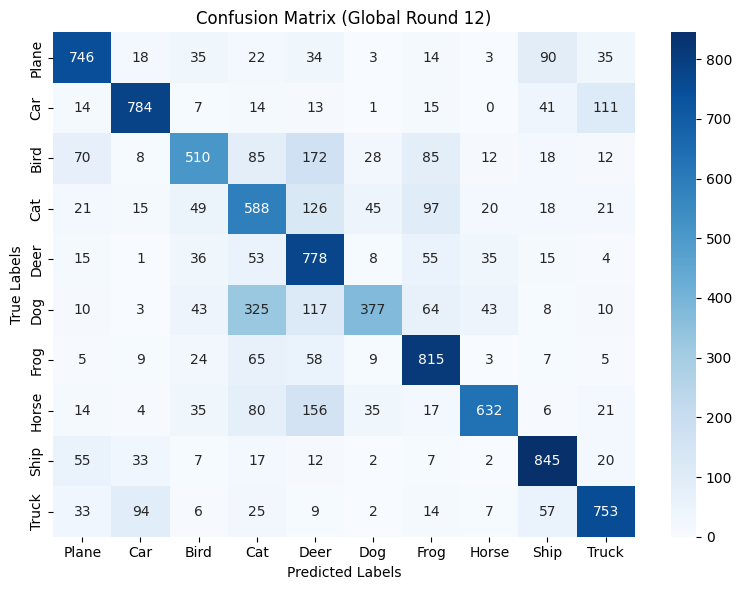


 | Global training round : 13/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 0.9834, Test accuracy: 6917/10000 (69.17%)

Class      - Accuracy
Plane      - 73.5
Car        - 77.3
Bird       - 48.4
Cat        - 61.3
Deer       - 77.4
Dog        - 42.3
Frog       - 82.9
Horse      - 66.0
Ship       - 84.7
Truck      - 77.9


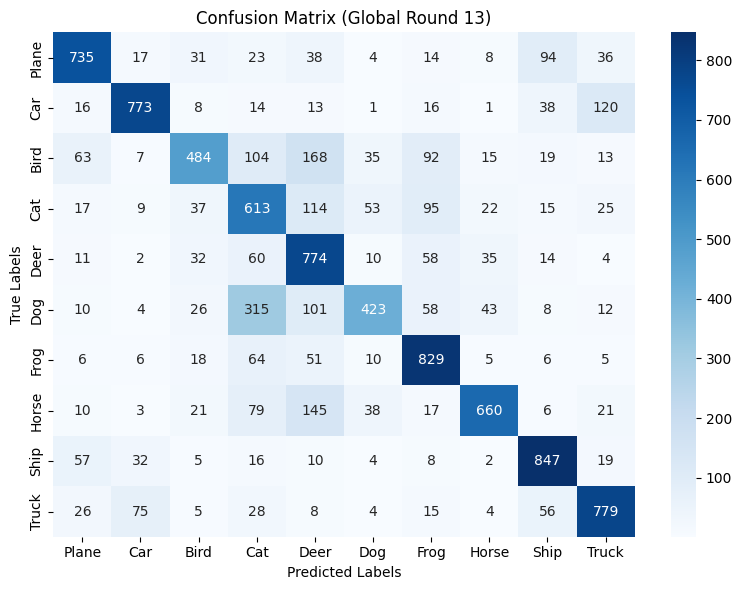


 | Global training round : 14/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 0.9921, Test accuracy: 6961/10000 (69.61%)

Class      - Accuracy
Plane      - 75.4
Car        - 80.3
Bird       - 53.9
Cat        - 62.8
Deer       - 78.4
Dog        - 39.2
Frog       - 83.6
Horse      - 62.6
Ship       - 82.5
Truck      - 77.4


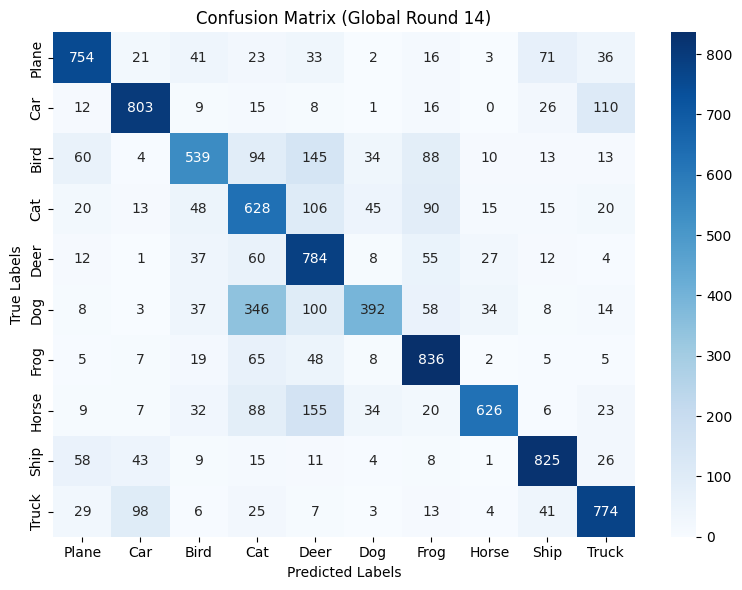


 | Global training round : 15/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 0.9760, Test accuracy: 6989/10000 (69.89%)

Class      - Accuracy
Plane      - 76.1
Car        - 81.0
Bird       - 52.0
Cat        - 56.7
Deer       - 79.8
Dog        - 41.0
Frog       - 84.5
Horse      - 65.1
Ship       - 83.8
Truck      - 78.9


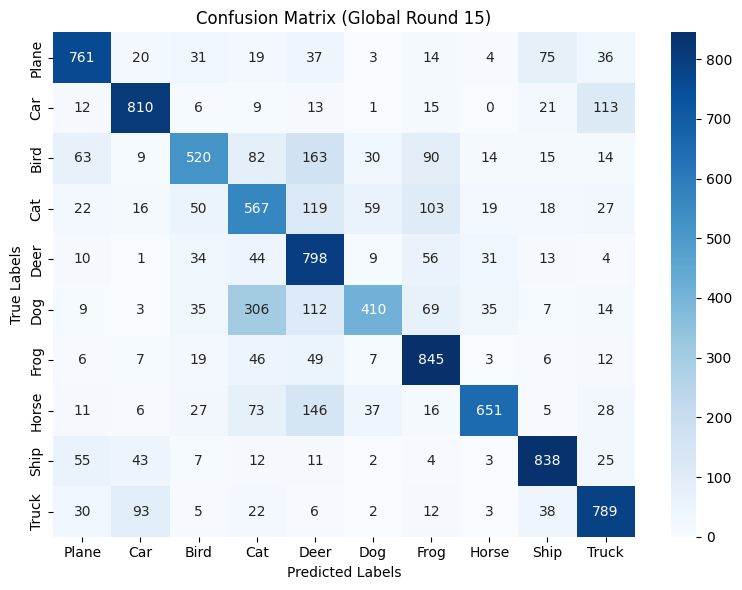


 | Global training round : 16/20 |

Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 0.9480, Test accuracy: 7071/10000 (70.71%)

Class      - Accuracy
Plane      - 75.8
Car        - 79.2
Bird       - 51.1
Cat        - 60.6
Deer       - 79.8
Dog        - 47.5
Frog       - 81.8
Horse      - 66.5
Ship       - 85.5
Truck      - 79.3


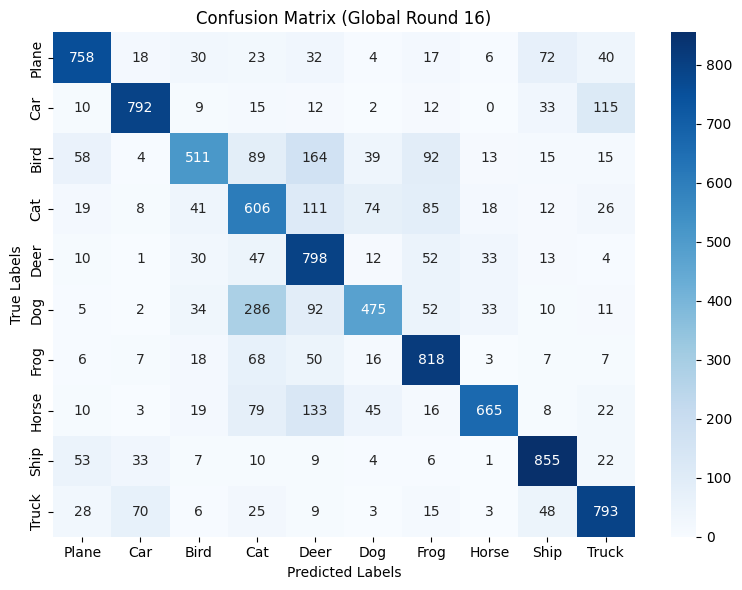


 | Global training round : 17/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 0.9376, Test accuracy: 7099/10000 (70.99%)

Class      - Accuracy
Plane      - 76.0
Car        - 79.3
Bird       - 55.1
Cat        - 58.4
Deer       - 78.7
Dog        - 48.5
Frog       - 81.9
Horse      - 67.3
Ship       - 84.5
Truck      - 80.2


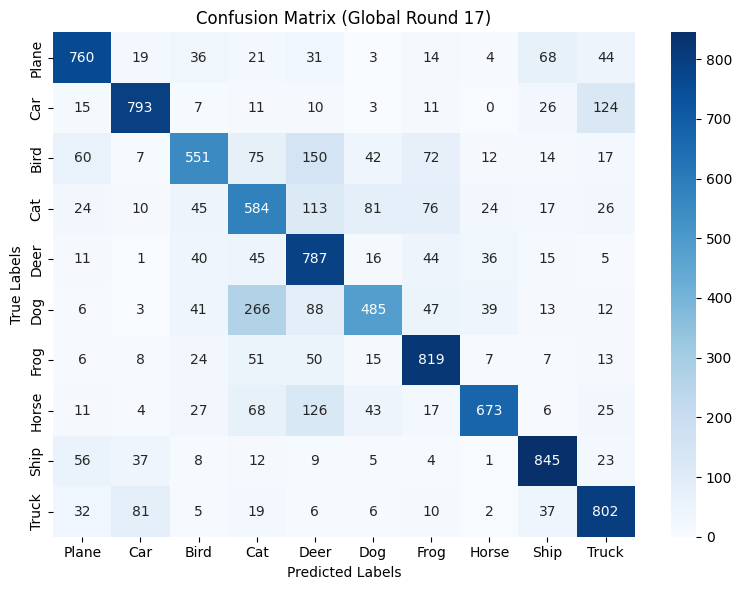


 | Global training round : 18/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 0.9637, Test accuracy: 7077/10000 (70.77%)

Class      - Accuracy
Plane      - 76.0
Car        - 80.4
Bird       - 52.8
Cat        - 56.4
Deer       - 80.2
Dog        - 45.1
Frog       - 86.0
Horse      - 66.6
Ship       - 83.3
Truck      - 80.9


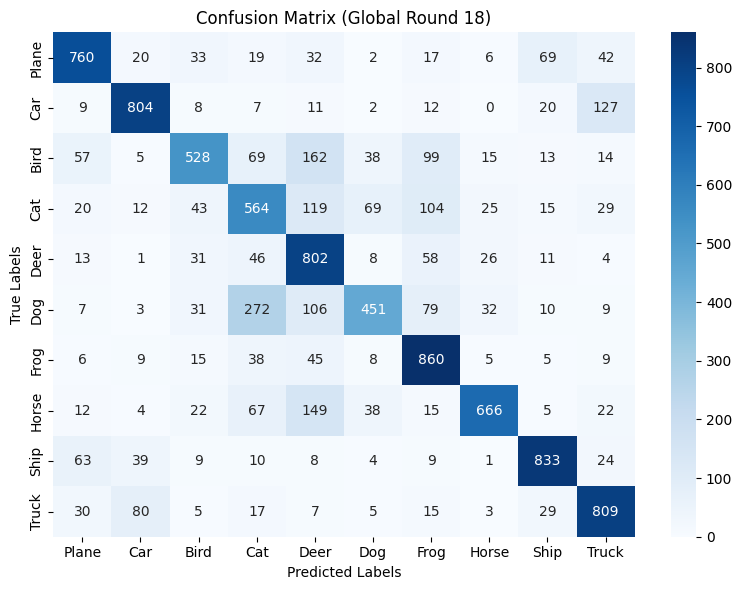


 | Global training round : 19/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 0.9295, Test accuracy: 7153/10000 (71.53%)

Class      - Accuracy
Plane      - 76.6
Car        - 79.7
Bird       - 55.8
Cat        - 61.6
Deer       - 78.2
Dog        - 45.9
Frog       - 84.4
Horse      - 67.1
Ship       - 86.8
Truck      - 79.2


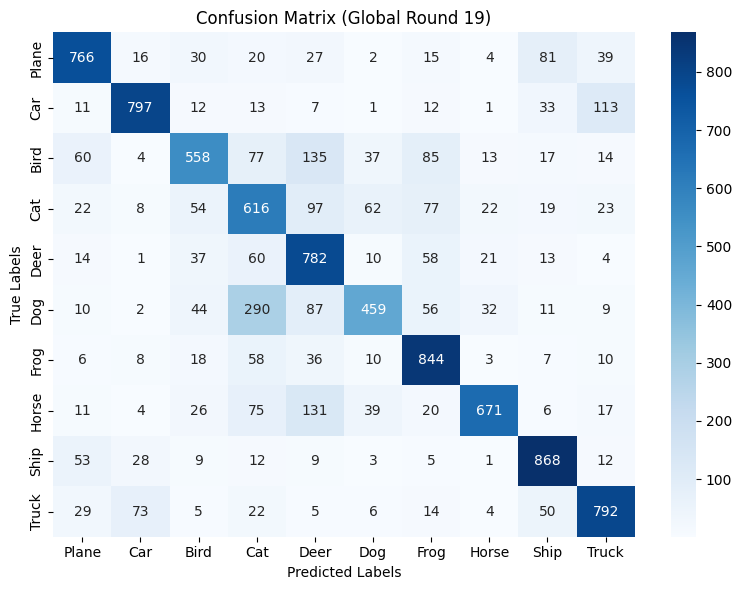


 | Global training round : 20/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 0.9219, Test accuracy: 7201/10000 (72.01%)

Class      - Accuracy
Plane      - 77.5
Car        - 84.1
Bird       - 58.1
Cat        - 57.6
Deer       - 78.0
Dog        - 47.7
Frog       - 85.8
Horse      - 68.0
Ship       - 84.2
Truck      - 79.1
Last 10 updates results

Average test loss: 0.9542, Test accuracy: 7025/10000 (70.25%)

***********************************************************************************
Class      - Accuracy
Plane      - 75.8
Car        - 79.4
Bird       - 52.2
Cat        - 59.9
Deer       - 79.4
Dog        - 43.5
Frog       - 83.8
Horse      - 65.3
Ship       - 84.3
Truck      - 78.9


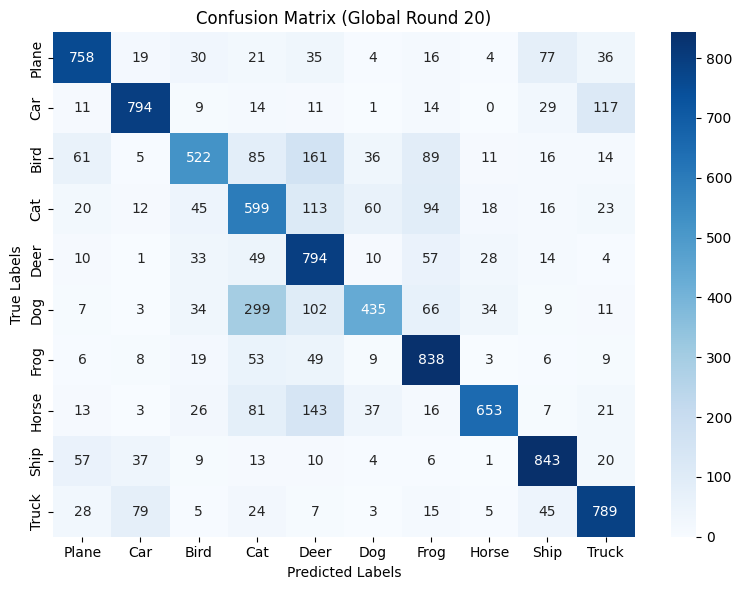

Global accuracies:  [np.float64(10.0), np.float64(10.07), np.float64(27.66), np.float64(47.11), np.float64(52.9), np.float64(57.87), np.float64(61.17), np.float64(63.42), np.float64(65.01), np.float64(66.85), np.float64(67.34), np.float64(68.28), np.float64(69.17), np.float64(69.61), np.float64(69.89), np.float64(70.71), np.float64(70.99), np.float64(70.77), np.float64(71.53), np.float64(72.01), np.float64(70.25)]
Class 5 accuracies:  [np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(4.3), np.float64(17.9), np.float64(24.9), np.float64(29.4), np.float64(33.9), np.float64(41.3), np.float64(37.3), np.float64(37.7), np.float64(42.3), np.float64(39.2), np.float64(41.0), np.float64(47.5), np.float64(48.5), np.float64(45.1), np.float64(45.9), np.float64(47.7), np.float64(43.5)]
Test loss: [np.float64(2.3579), np.float64(2.309), np.float64(1.9748), np.float64(1.4745), np.float64(1.2887), np.float64(1.1767), np.float64(1.1185), np.float64(1.0751), np.float64(1.045

In [ ]:
RULE = 'robutslfd'
ATTACK_TYPE='label_flipping'
MALICIOUS_BEHAVIOR_RATE = 1
for atr in [0.1]:
    run_exp(dataset_name = DATASET_NAME, model_name = MODEL_NAME, dd_type = DD_TYPE, num_peers = NUM_PEERS,
            frac_peers = FRAC_PEERS, seed = SEED, test_batch_size = TEST_BATCH_SIZE,
                criterion = CRITERION, global_rounds = GLOBAL_ROUNDS, local_epochs = LOCAL_EPOCHS, local_bs = LOCAL_BS,
                 local_lr = LOCAL_LR, local_momentum = LOCAL_MOMENTUM, labels_dict = LABELS_DICT, device = DEVICE,
                attackers_ratio = atr, attack_type=ATTACK_TYPE,
                 malicious_behavior_rate = MALICIOUS_BEHAVIOR_RATE, rule = RULE,
                source_class = SOURCE_CLASS, target_class = TARGET_CLASS,
               class_per_peer = CLASS_PER_PEER, samples_per_class = SAMPLES_PER_CLASS,
               rate_unbalance = RATE_UNBALANCE, alpha = ALPHA, resume = False)

cifar, NON-IID, 20%attacker

In [ ]:
#=============================== Defining global variables ========================#
DATASET_NAME = "CIFAR10"
MODEL_NAME = "ResNet18"
DD_TYPE = 'NON_IID'
ALPHA = 1
NUM_PEERS = 20 # "number of peers: K"
FRAC_PEERS = 1 #'the fraction of peers: C to bel selected in each round'
SEED = 7 #fixed seed
random.seed(SEED)
CRITERION = nn.CrossEntropyLoss()
GLOBAL_ROUNDS = 20 #"number of rounds of federated model training"
LOCAL_EPOCHS = 3 #"the number of local epochs: E for each peer"
TEST_BATCH_SIZE = 1000
LOCAL_BS = 32 #"local batch size: B for each peer"
LOCAL_LR =  0.01#local learning rate: lr for each peer
LOCAL_MOMENTUM = 0.9 #local momentum for each peer
NUM_CLASSES = 10 # number of classes in an experiment
LABELS_DICT = {'Plane':0,
               'Car':1,
               'Bird':2,
               'Cat':3,
               'Deer':4,
               'Dog':5,
               'Frog':6,
               'Horse':7,
               'Ship':8,
               'Truck':9}

#select the device to work with cpu or gpu
if torch.cuda.is_available():
    DEVICE = "cuda"
else:
    DEVICE = "cpu"
DEVICE = torch.device(DEVICE)
print(DEVICE)
SOURCE_CLASS = 5 # the source class
TARGET_CLASS = 3 # the target class

CLASS_PER_PEER = 1
SAMPLES_PER_CLASS = 582
RATE_UNBALANCE = 1


cuda



--> Label FLIP experiment on our algo...
--> Loading of CIFAR10 dataset
--> Dataset has been loaded!
--> Creating ResNet18 model.....
--> Model has been created!
--> Distributing training data among peers
--> Training data have been distributed among peers
--> Creating peets instances
Data set: CIFAR10
Data distribution: NON_IID
Aggregation rule: robutslfd
Attack Type: label_flipping
Attackers Ratio: 20.0 %
Malicious Behavior Rate: 100 %

===>Simulation started...

====>Global model training started...



  0%|          | 0/20 [00:00<?, ?it/s]


 | Global training round : 1/20 |

Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 2.3655, Test accuracy: 1000/10000 (10.00%)

Class      - Accuracy
Plane      - 0.0
Car        - 0.0
Bird       - 100.0
Cat        - 0.0
Deer       - 0.0
Dog        - 0.0
Frog       - 0.0
Horse      - 0.0
Ship       - 0.0
Truck      - 0.0


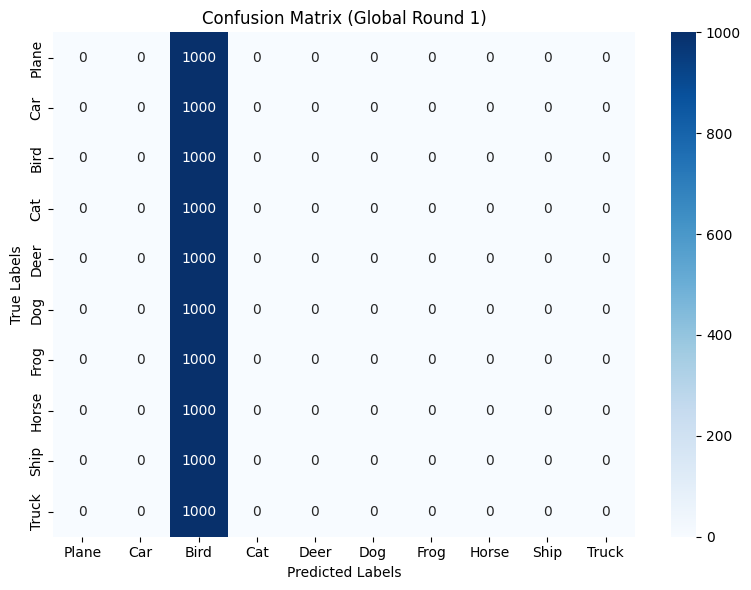


 | Global training round : 2/20 |

Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 2.2445, Test accuracy: 1128/10000 (11.28%)

Class      - Accuracy
Plane      - 11.2
Car        - 0.2
Bird       - 0.0
Cat        - 100.0
Deer       - 0.0
Dog        - 0.0
Frog       - 0.0
Horse      - 0.0
Ship       - 0.0
Truck      - 1.4


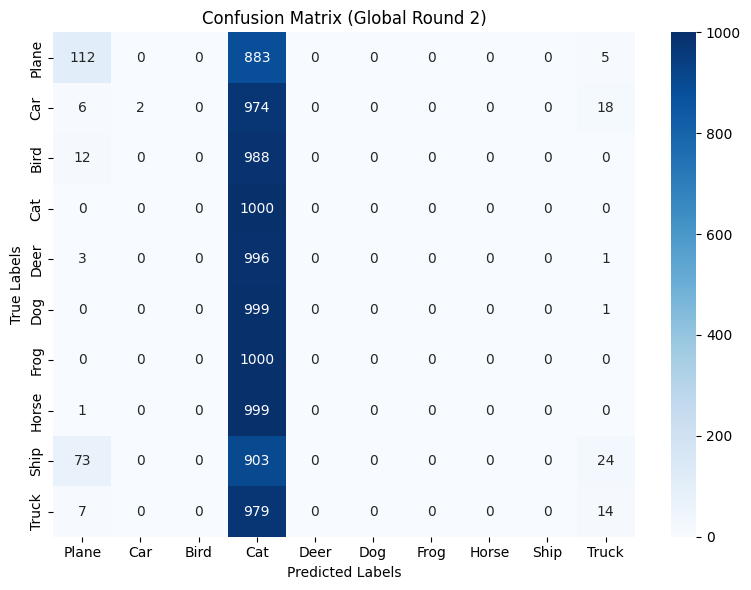


 | Global training round : 3/20 |

Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
 our aggregation
inside robust aggregate
Clustering failed (low silhouette). Using all clients.

Average test loss: 1.9634, Test accuracy: 3125/10000 (31.25%)

Class      - Accuracy
Plane      - 32.6
Car        - 31.8
Bird       - 8.9
Cat        - 57.6
Deer       - 77.5
Dog        - 0.0
Frog       - 44.7
Horse      - 0.2
Ship       - 34.7
Truck      - 24.5


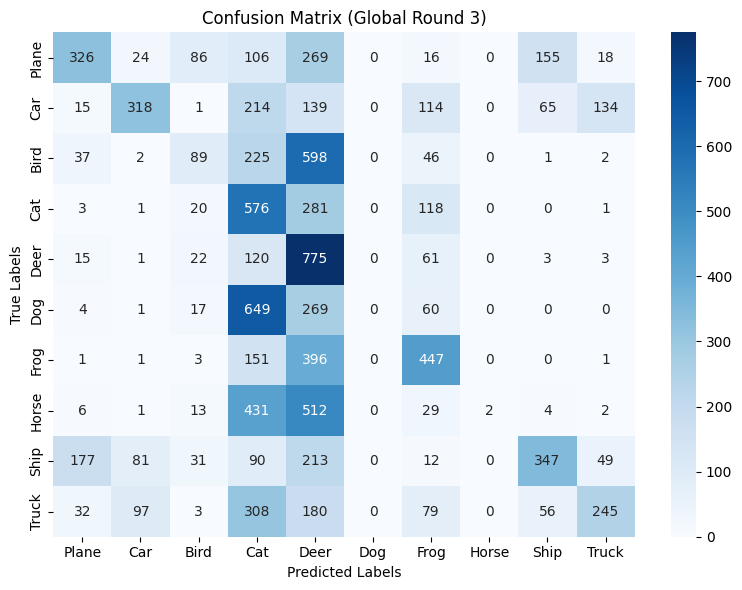


 | Global training round : 4/20 |

Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.5558, Test accuracy: 4353/10000 (43.53%)

Class      - Accuracy
Plane      - 35.8
Car        - 52.5
Bird       - 20.7
Cat        - 48.9
Deer       - 67.6
Dog        - 0.0
Frog       - 72.3
Horse      - 23.6
Ship       - 63.1
Truck      - 50.8


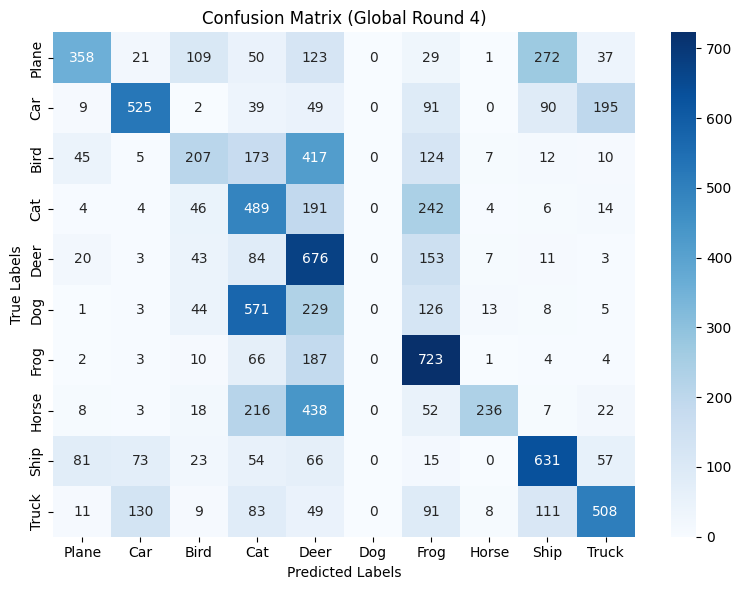


 | Global training round : 5/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.3188, Test accuracy: 5268/10000 (52.68%)

Class      - Accuracy
Plane      - 55.8
Car        - 65.4
Bird       - 39.6
Cat        - 63.3
Deer       - 53.9
Dog        - 0.1
Frog       - 74.1
Horse      - 47.8
Ship       - 64.2
Truck      - 62.6


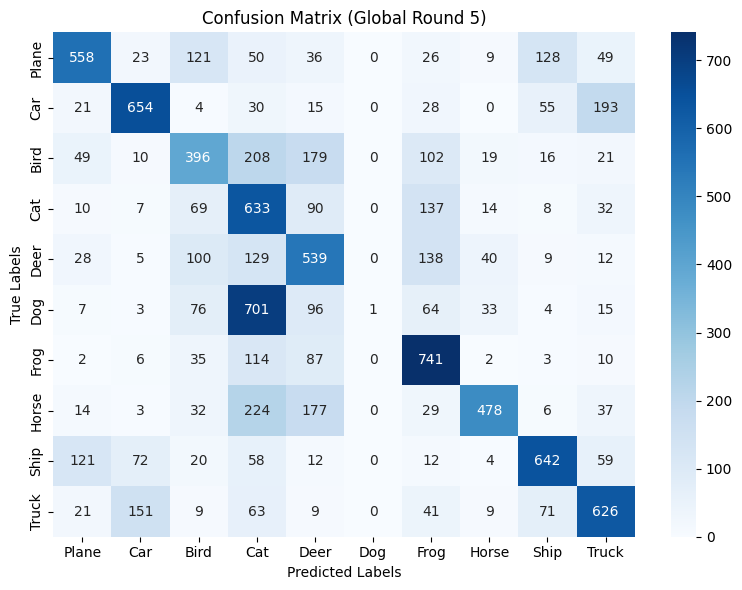


 | Global training round : 6/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.2087, Test accuracy: 5632/10000 (56.32%)

Class      - Accuracy
Plane      - 54.9
Car        - 65.2
Bird       - 35.6
Cat        - 67.3
Deer       - 68.8
Dog        - 6.8
Frog       - 70.6
Horse      - 52.3
Ship       - 76.5
Truck      - 65.2


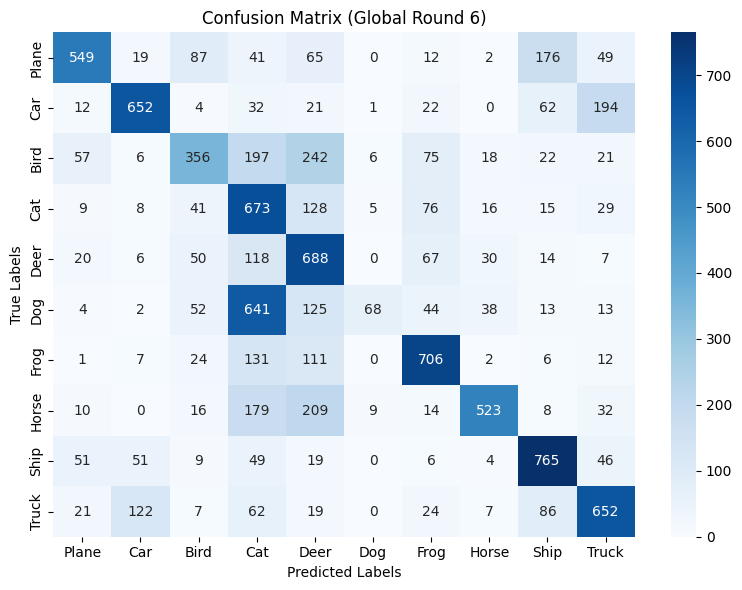


 | Global training round : 7/20 |

Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.1500, Test accuracy: 5982/10000 (59.82%)

Class      - Accuracy
Plane      - 62.9
Car        - 72.2
Bird       - 41.7
Cat        - 60.0
Deer       - 73.5
Dog        - 12.1
Frog       - 77.8
Horse      - 54.8
Ship       - 77.6
Truck      - 65.6


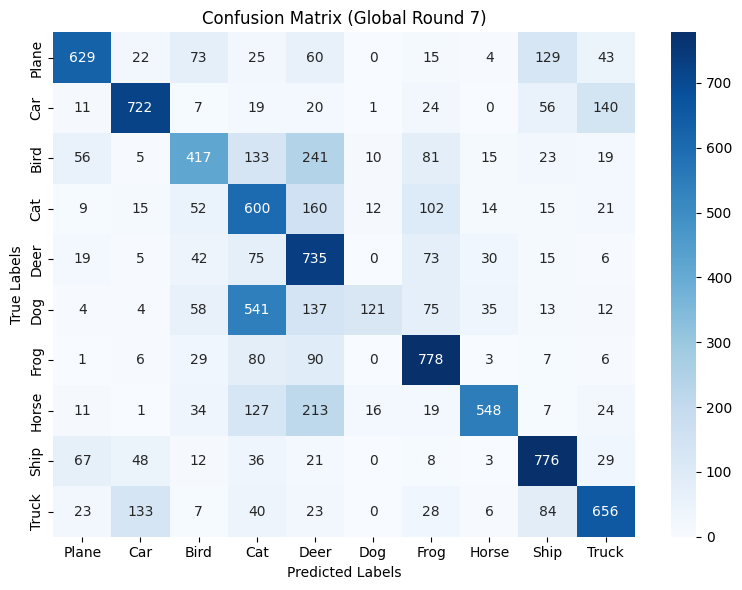


 | Global training round : 8/20 |

Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.1108, Test accuracy: 6233/10000 (62.33%)

Class      - Accuracy
Plane      - 67.5
Car        - 73.0
Bird       - 40.3
Cat        - 62.6
Deer       - 72.3
Dog        - 17.8
Frog       - 79.2
Horse      - 59.6
Ship       - 80.6
Truck      - 70.4


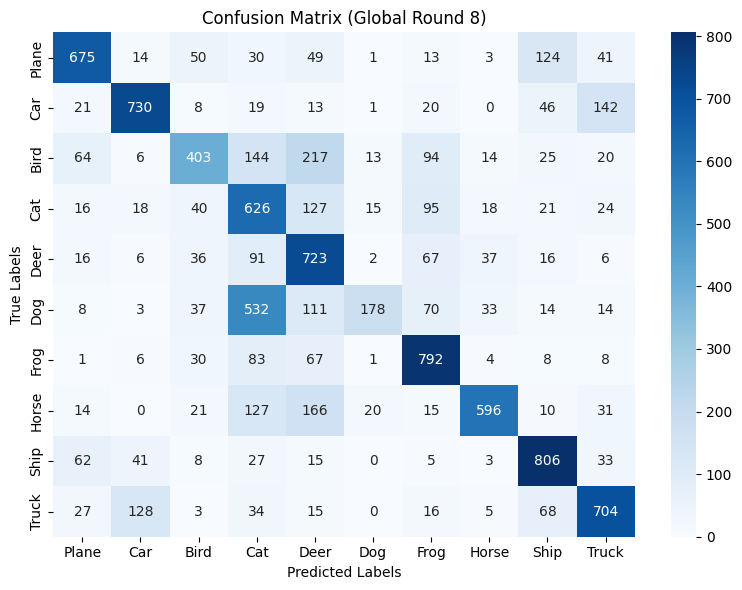


 | Global training round : 9/20 |

Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0893, Test accuracy: 6420/10000 (64.20%)

Class      - Accuracy
Plane      - 66.7
Car        - 71.8
Bird       - 42.1
Cat        - 55.7
Deer       - 79.1
Dog        - 27.0
Frog       - 82.4
Horse      - 59.9
Ship       - 81.3
Truck      - 76.0


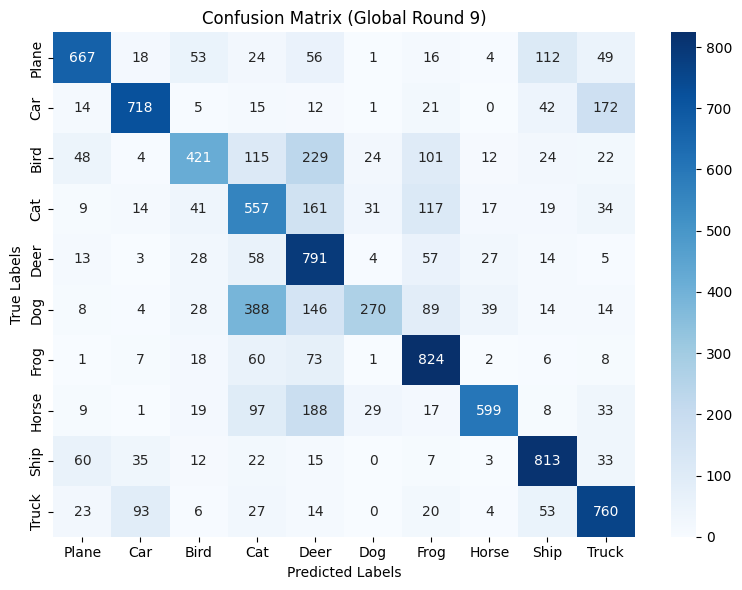


 | Global training round : 10/20 |

Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0868, Test accuracy: 6487/10000 (64.87%)

Class      - Accuracy
Plane      - 66.7
Car        - 76.9
Bird       - 44.9
Cat        - 56.5
Deer       - 79.1
Dog        - 24.9
Frog       - 82.9
Horse      - 60.7
Ship       - 83.2
Truck      - 72.9


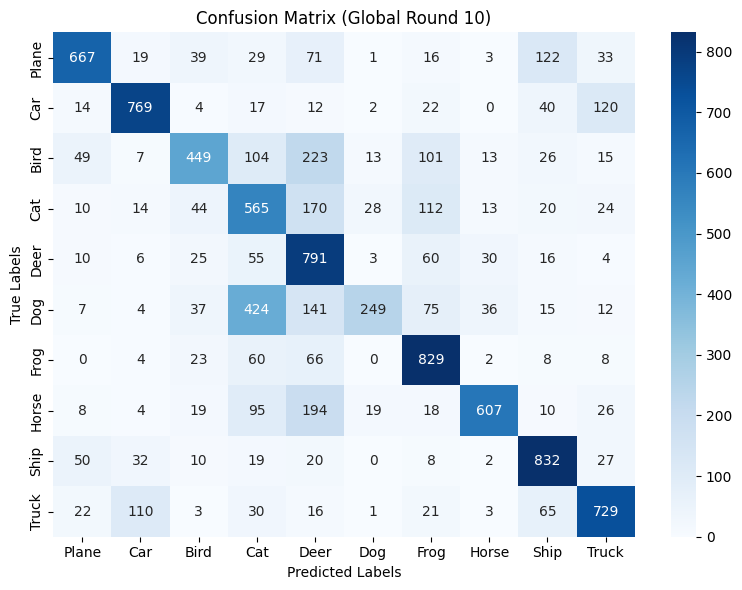


 | Global training round : 11/20 |

Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0416, Test accuracy: 6657/10000 (66.57%)

Class      - Accuracy
Plane      - 68.0
Car        - 78.3
Bird       - 44.7
Cat        - 59.6
Deer       - 77.6
Dog        - 31.8
Frog       - 81.6
Horse      - 64.7
Ship       - 83.8
Truck      - 75.6


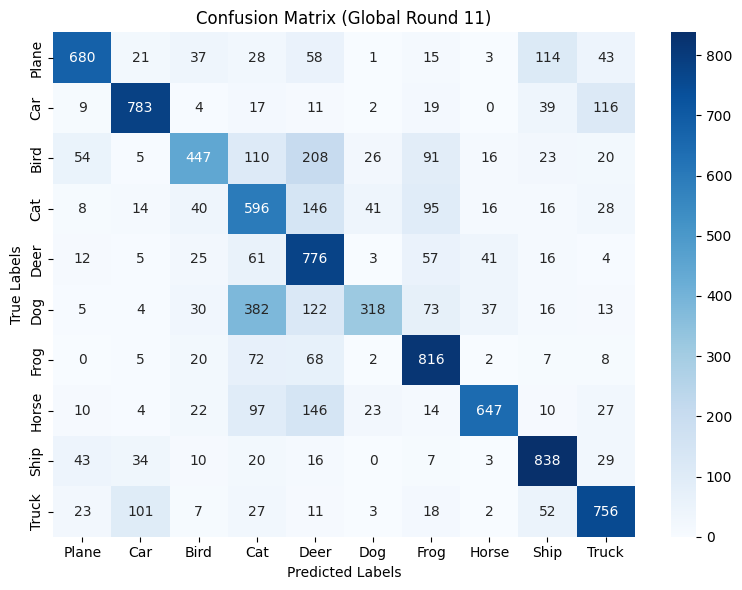


 | Global training round : 12/20 |

Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0297, Test accuracy: 6755/10000 (67.55%)

Class      - Accuracy
Plane      - 72.0
Car        - 80.3
Bird       - 48.0
Cat        - 57.8
Deer       - 80.5
Dog        - 31.5
Frog       - 83.3
Horse      - 63.8
Ship       - 83.7
Truck      - 74.6


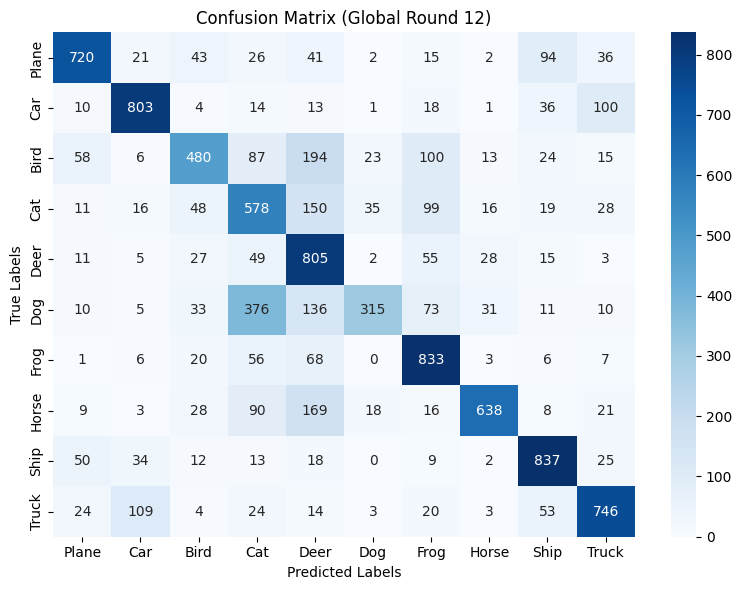


 | Global training round : 13/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0119, Test accuracy: 6822/10000 (68.22%)

Class      - Accuracy
Plane      - 70.4
Car        - 79.1
Bird       - 50.9
Cat        - 59.3
Deer       - 80.7
Dog        - 33.3
Frog       - 81.4
Horse      - 65.6
Ship       - 85.6
Truck      - 75.9


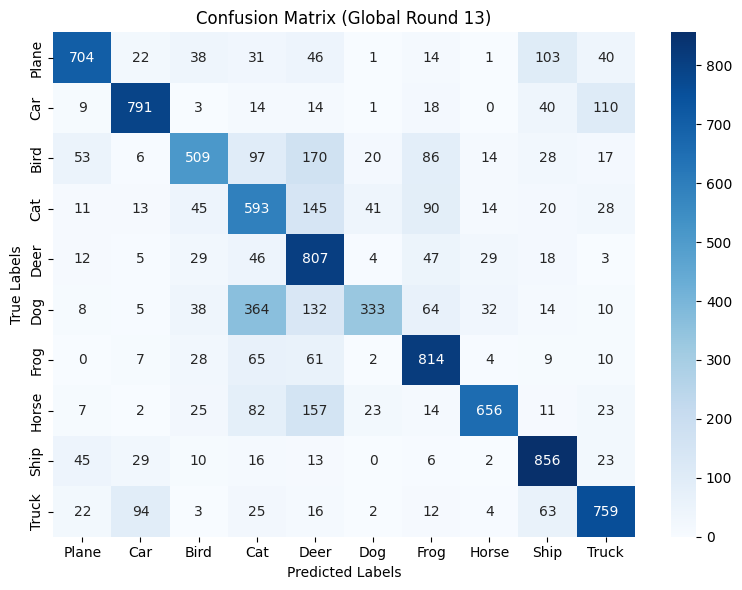


 | Global training round : 14/20 |

Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0188, Test accuracy: 6858/10000 (68.58%)

Class      - Accuracy
Plane      - 73.6
Car        - 80.4
Bird       - 50.3
Cat        - 58.2
Deer       - 81.7
Dog        - 33.6
Frog       - 85.1
Horse      - 63.1
Ship       - 85.3
Truck      - 74.5


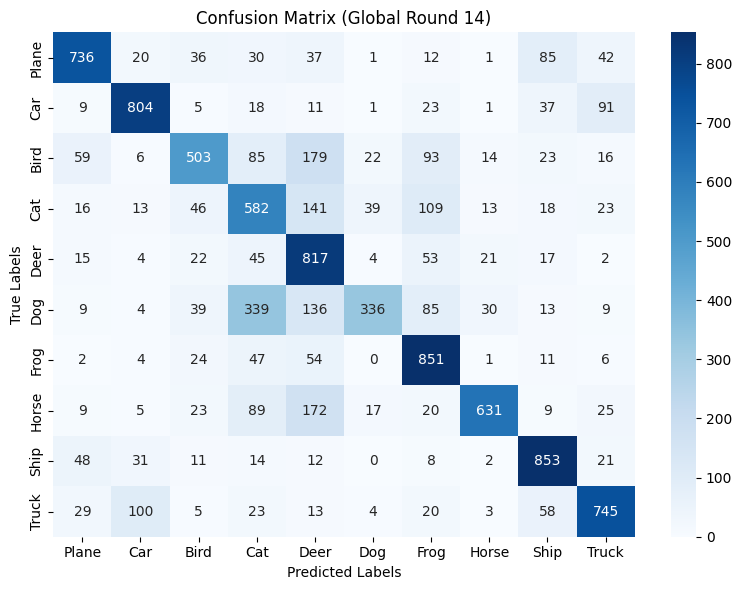


 | Global training round : 15/20 |

Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0081, Test accuracy: 6912/10000 (69.12%)

Class      - Accuracy
Plane      - 75.0
Car        - 78.1
Bird       - 50.1
Cat        - 56.7
Deer       - 82.8
Dog        - 37.0
Frog       - 82.4
Horse      - 66.9
Ship       - 83.3
Truck      - 78.9


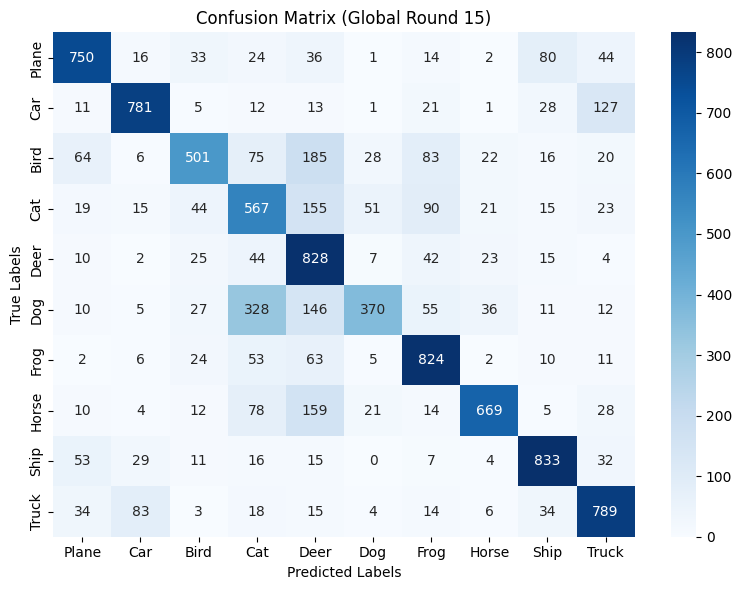


 | Global training round : 16/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0301, Test accuracy: 6894/10000 (68.94%)

Class      - Accuracy
Plane      - 74.0
Car        - 82.1
Bird       - 51.7
Cat        - 61.6
Deer       - 81.1
Dog        - 29.5
Frog       - 84.7
Horse      - 65.2
Ship       - 82.7
Truck      - 76.8


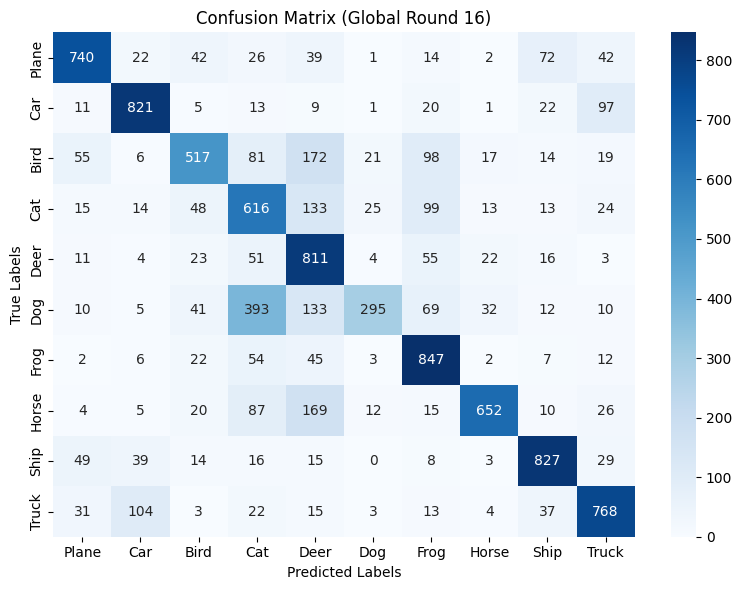


 | Global training round : 17/20 |

Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0015, Test accuracy: 6989/10000 (69.89%)

Class      - Accuracy
Plane      - 73.4
Car        - 81.0
Bird       - 54.6
Cat        - 61.0
Deer       - 80.9
Dog        - 36.4
Frog       - 84.4
Horse      - 64.8
Ship       - 84.7
Truck      - 77.7


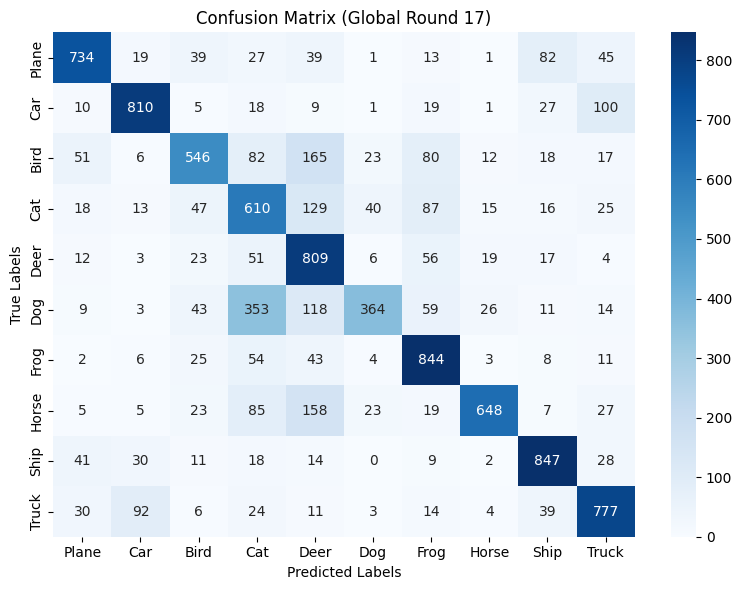


 | Global training round : 18/20 |

Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0136, Test accuracy: 6962/10000 (69.62%)

Class      - Accuracy
Plane      - 77.2
Car        - 83.5
Bird       - 51.4
Cat        - 61.4
Deer       - 82.0
Dog        - 31.7
Frog       - 84.9
Horse      - 63.5
Ship       - 85.2
Truck      - 75.4


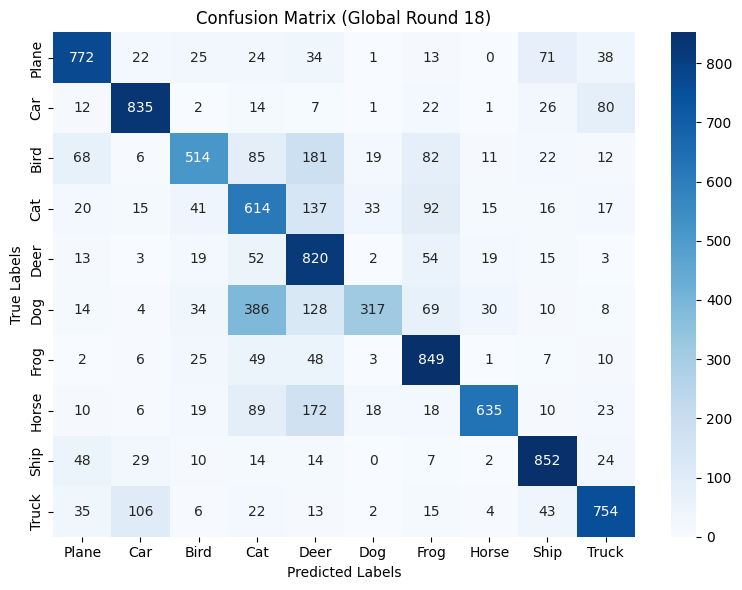


 | Global training round : 19/20 |

Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 0.9849, Test accuracy: 7046/10000 (70.46%)

Class      - Accuracy
Plane      - 76.5
Car        - 82.2
Bird       - 56.4
Cat        - 59.0
Deer       - 81.0
Dog        - 38.3
Frog       - 85.8
Horse      - 64.8
Ship       - 83.9
Truck      - 76.7


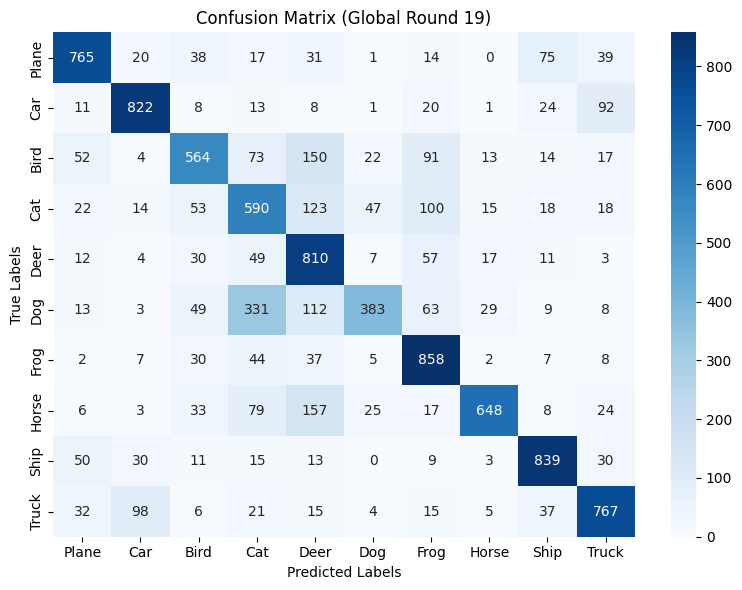


 | Global training round : 20/20 |

Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 0.9942, Test accuracy: 7051/10000 (70.51%)

Class      - Accuracy
Plane      - 75.0
Car        - 83.9
Bird       - 56.0
Cat        - 61.7
Deer       - 81.3
Dog        - 32.3
Frog       - 85.0
Horse      - 68.3
Ship       - 85.2
Truck      - 76.4
Last 10 updates results

Average test loss: 1.0035, Test accuracy: 6897/10000 (68.97%)

***********************************************************************************
Class      - Accuracy
Plane      - 73.0
Car        - 80.5
Bird       - 50.6
Cat        - 59.7
Deer       - 82.0
Dog        - 33.8
Frog       - 84.6
Horse      - 64.8
Ship       - 84.5
Truck      - 76

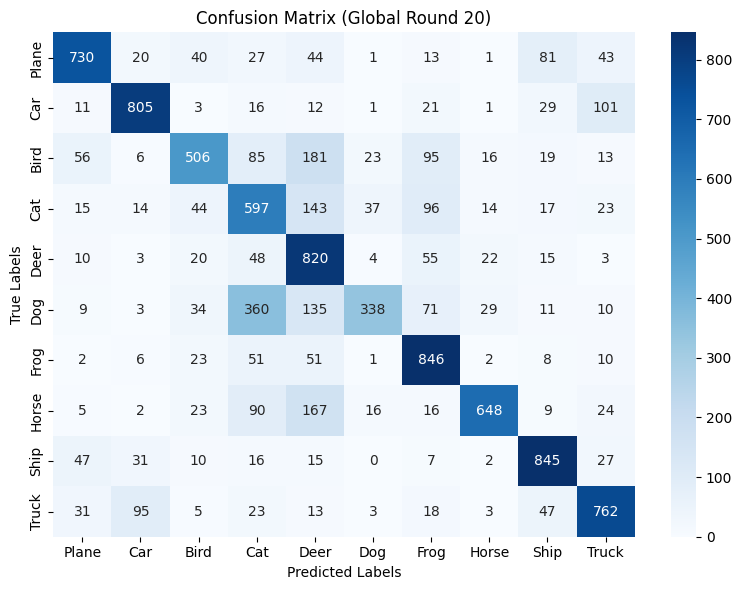

Global accuracies:  [np.float64(10.0), np.float64(11.28), np.float64(31.25), np.float64(43.53), np.float64(52.68), np.float64(56.32), np.float64(59.82), np.float64(62.33), np.float64(64.2), np.float64(64.87), np.float64(66.57), np.float64(67.55), np.float64(68.22), np.float64(68.58), np.float64(69.12), np.float64(68.94), np.float64(69.89), np.float64(69.62), np.float64(70.46), np.float64(70.51), np.float64(68.97)]
Class 5 accuracies:  [np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.1), np.float64(6.8), np.float64(12.1), np.float64(17.8), np.float64(27.0), np.float64(24.9), np.float64(31.8), np.float64(31.5), np.float64(33.3), np.float64(33.6), np.float64(37.0), np.float64(29.5), np.float64(36.4), np.float64(31.7), np.float64(38.3), np.float64(32.3), np.float64(33.8)]
Test loss: [np.float64(2.3655), np.float64(2.2445), np.float64(1.9634), np.float64(1.5558), np.float64(1.3188), np.float64(1.2087), np.float64(1.15), np.float64(1.1108), np.float64(1.0893)

In [ ]:
RULE = 'robutslfd'
ATTACK_TYPE='label_flipping'
MALICIOUS_BEHAVIOR_RATE = 1
for atr in [0.2]:
    run_exp(dataset_name = DATASET_NAME, model_name = MODEL_NAME, dd_type = DD_TYPE, num_peers = NUM_PEERS,
            frac_peers = FRAC_PEERS, seed = SEED, test_batch_size = TEST_BATCH_SIZE,
                criterion = CRITERION, global_rounds = GLOBAL_ROUNDS, local_epochs = LOCAL_EPOCHS, local_bs = LOCAL_BS,
                 local_lr = LOCAL_LR, local_momentum = LOCAL_MOMENTUM, labels_dict = LABELS_DICT, device = DEVICE,
                attackers_ratio = atr, attack_type=ATTACK_TYPE,
                 malicious_behavior_rate = MALICIOUS_BEHAVIOR_RATE, rule = RULE,
                source_class = SOURCE_CLASS, target_class = TARGET_CLASS,
               class_per_peer = CLASS_PER_PEER, samples_per_class = SAMPLES_PER_CLASS,
               rate_unbalance = RATE_UNBALANCE, alpha = ALPHA, resume = False)

cifar, NON-IID, 30% attacker

In [ ]:
#=============================== Defining global variables ========================#
DATASET_NAME = "CIFAR10"
MODEL_NAME = "ResNet18"
DD_TYPE = 'NON_IID'
ALPHA = 1
NUM_PEERS = 20 # "number of peers: K"
FRAC_PEERS = 1 #'the fraction of peers: C to bel selected in each round'
SEED = 7 #fixed seed
random.seed(SEED)
CRITERION = nn.CrossEntropyLoss()
GLOBAL_ROUNDS = 20 #"number of rounds of federated model training"
LOCAL_EPOCHS = 3 #"the number of local epochs: E for each peer"
TEST_BATCH_SIZE = 1000
LOCAL_BS = 32 #"local batch size: B for each peer"
LOCAL_LR =  0.01#local learning rate: lr for each peer
LOCAL_MOMENTUM = 0.9 #local momentum for each peer
NUM_CLASSES = 10 # number of classes in an experiment
LABELS_DICT = {'Plane':0,
               'Car':1,
               'Bird':2,
               'Cat':3,
               'Deer':4,
               'Dog':5,
               'Frog':6,
               'Horse':7,
               'Ship':8,
               'Truck':9}

#select the device to work with cpu or gpu
if torch.cuda.is_available():
    DEVICE = "cuda"
else:
    DEVICE = "cpu"
DEVICE = torch.device(DEVICE)
print(DEVICE)
SOURCE_CLASS = 5 # the source class
TARGET_CLASS = 3 # the target class

CLASS_PER_PEER = 1
SAMPLES_PER_CLASS = 582
RATE_UNBALANCE = 1


cuda



--> Label FLIP experiment on our algo...
--> Loading of CIFAR10 dataset
--> Dataset has been loaded!
--> Creating ResNet18 model.....
--> Model has been created!
--> Distributing training data among peers
--> Training data have been distributed among peers
--> Creating peets instances
Data set: CIFAR10
Data distribution: NON_IID
Aggregation rule: robutslfd
Attack Type: label_flipping
Attackers Ratio: 20.0 %
Malicious Behavior Rate: 100 %

===>Simulation started...

====>Global model training started...



  0%|          | 0/20 [00:00<?, ?it/s]


 | Global training round : 1/20 |

Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 2.3467, Test accuracy: 1000/10000 (10.00%)

Class      - Accuracy
Plane      - 0.0
Car        - 0.0
Bird       - 100.0
Cat        - 0.0
Deer       - 0.0
Dog        - 0.0
Frog       - 0.0
Horse      - 0.0
Ship       - 0.0
Truck      - 0.0


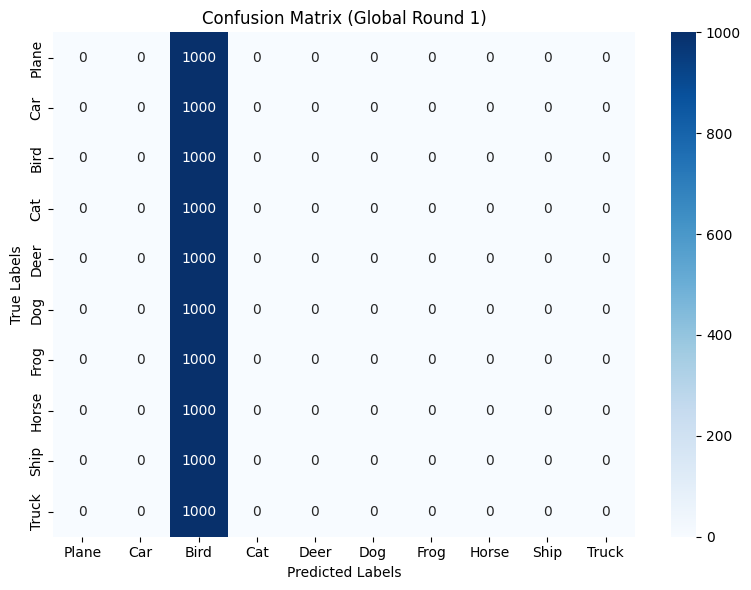


 | Global training round : 2/20 |

Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 2.2699, Test accuracy: 1330/10000 (13.30%)

Class      - Accuracy
Plane      - 15.8
Car        - 0.0
Bird       - 0.0
Cat        - 98.5
Deer       - 10.9
Dog        - 0.0
Frog       - 0.0
Horse      - 0.0
Ship       - 0.0
Truck      - 7.8


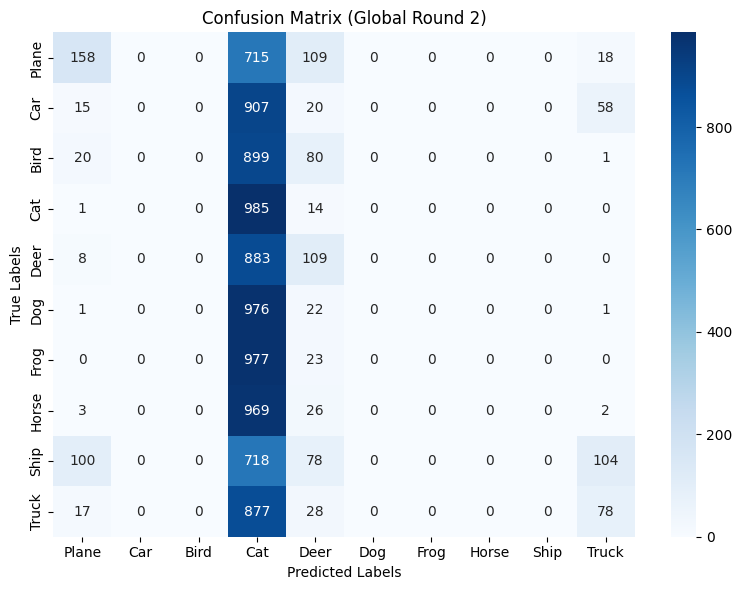


 | Global training round : 3/20 |

Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.9803, Test accuracy: 2810/10000 (28.10%)

Class      - Accuracy
Plane      - 35.5
Car        - 17.6
Bird       - 14.4
Cat        - 48.4
Deer       - 86.4
Dog        - 0.0
Frog       - 11.6
Horse      - 0.1
Ship       - 36.9
Truck      - 30.1


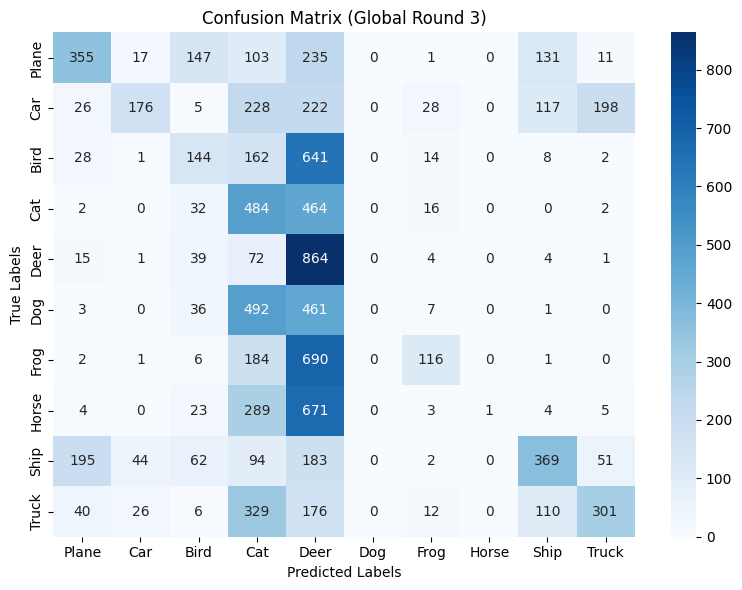


 | Global training round : 4/20 |

Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.5995, Test accuracy: 4194/10000 (41.94%)

Class      - Accuracy
Plane      - 38.3
Car        - 27.9
Bird       - 18.2
Cat        - 48.1
Deer       - 74.5
Dog        - 0.0
Frog       - 66.4
Horse      - 23.3
Ship       - 63.0
Truck      - 59.7


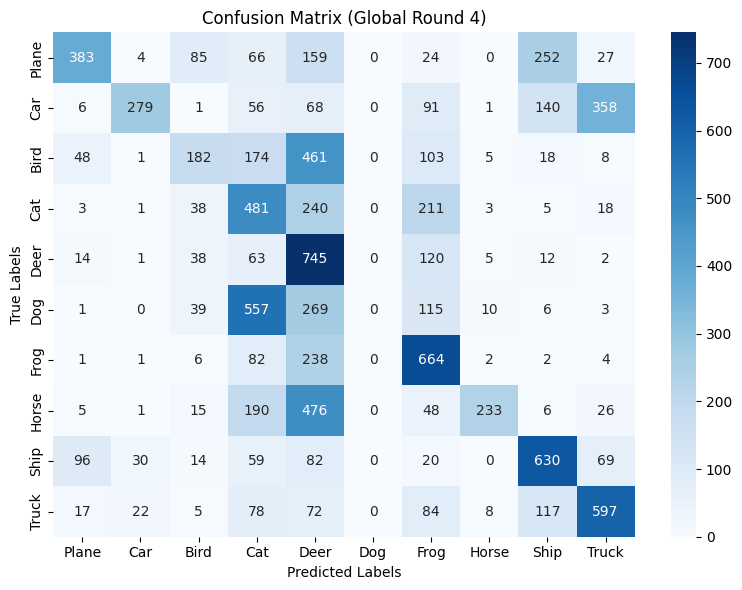


 | Global training round : 5/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.3340, Test accuracy: 5218/10000 (52.18%)

Class      - Accuracy
Plane      - 47.8
Car        - 58.7
Bird       - 43.9
Cat        - 64.8
Deer       - 54.0
Dog        - 0.4
Frog       - 68.4
Horse      - 48.2
Ship       - 69.2
Truck      - 66.4


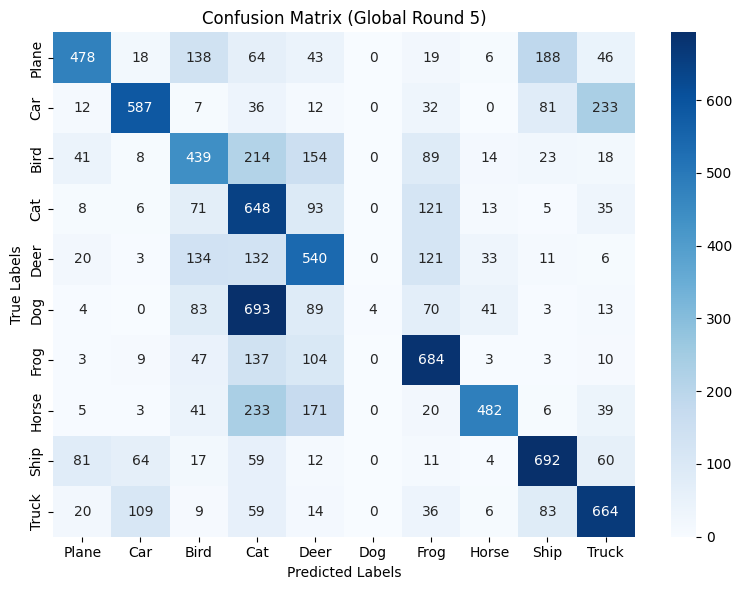


 | Global training round : 6/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.1945, Test accuracy: 5679/10000 (56.79%)

Class      - Accuracy
Plane      - 57.7
Car        - 60.9
Bird       - 41.2
Cat        - 58.8
Deer       - 67.3
Dog        - 6.9
Frog       - 74.3
Horse      - 55.4
Ship       - 73.5
Truck      - 71.9


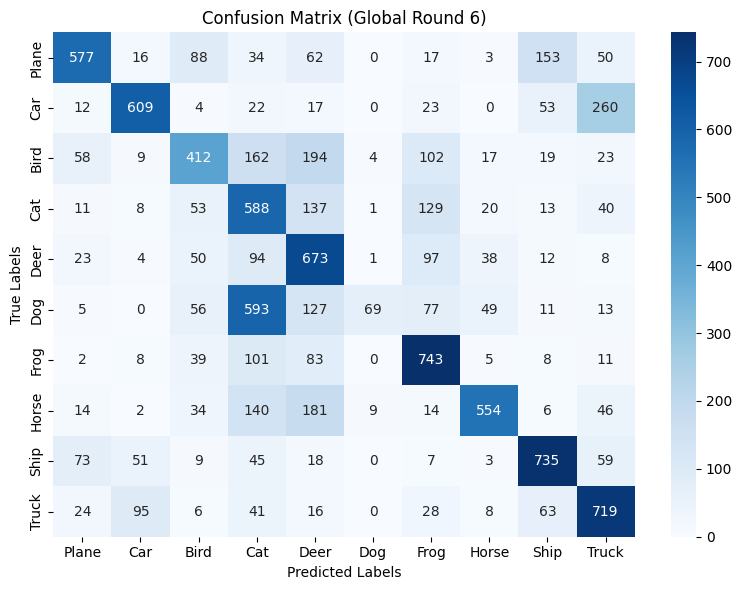


 | Global training round : 7/20 |

Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.1425, Test accuracy: 5986/10000 (59.86%)

Class      - Accuracy
Plane      - 62.7
Car        - 68.6
Bird       - 41.5
Cat        - 60.4
Deer       - 73.4
Dog        - 10.2
Frog       - 77.5
Horse      - 57.0
Ship       - 76.8
Truck      - 70.5


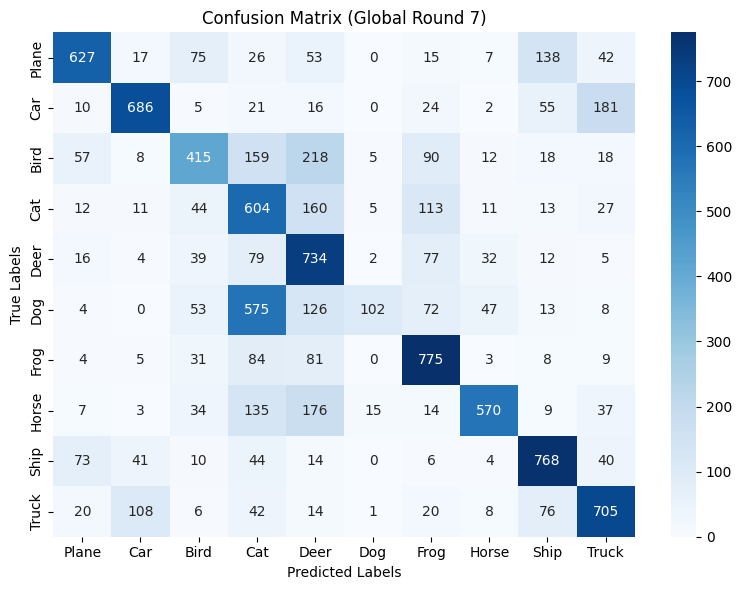


 | Global training round : 8/20 |

Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.1097, Test accuracy: 6177/10000 (61.77%)

Class      - Accuracy
Plane      - 65.8
Car        - 71.5
Bird       - 41.0
Cat        - 64.9
Deer       - 73.0
Dog        - 13.1
Frog       - 79.0
Horse      - 58.7
Ship       - 78.2
Truck      - 72.5


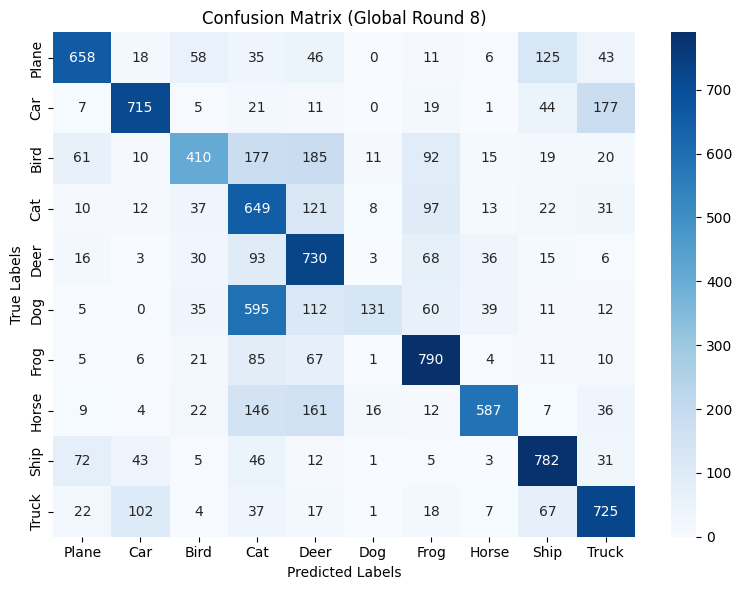


 | Global training round : 9/20 |

Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0847, Test accuracy: 6361/10000 (63.61%)

Class      - Accuracy
Plane      - 64.8
Car        - 70.3
Bird       - 44.8
Cat        - 61.0
Deer       - 74.9
Dog        - 20.6
Frog       - 83.5
Horse      - 60.1
Ship       - 80.2
Truck      - 75.9


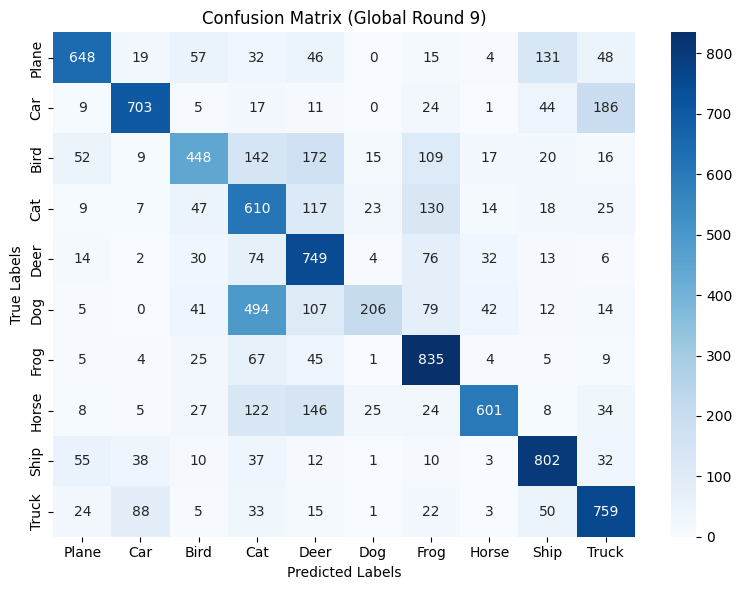


 | Global training round : 10/20 |

Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0906, Test accuracy: 6461/10000 (64.61%)

Class      - Accuracy
Plane      - 66.5
Car        - 73.0
Bird       - 45.6
Cat        - 64.8
Deer       - 77.8
Dog        - 19.8
Frog       - 80.8
Horse      - 60.6
Ship       - 81.2
Truck      - 76.0


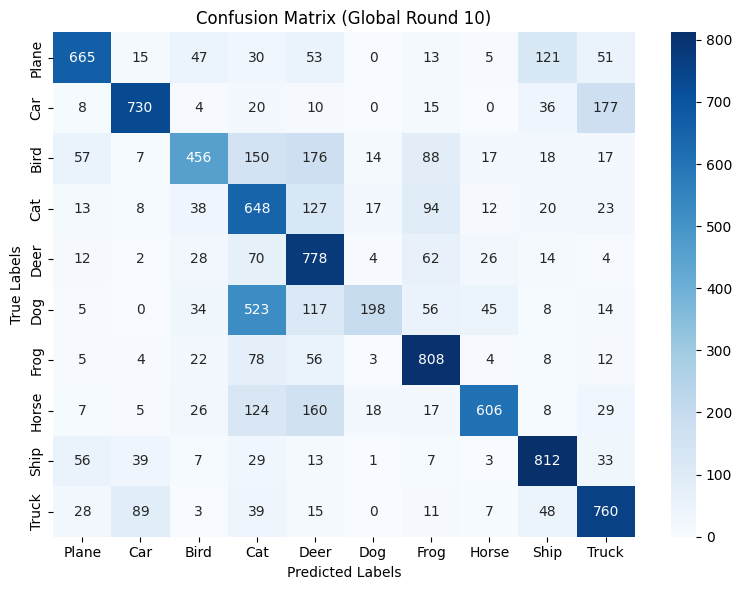


 | Global training round : 11/20 |

Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0561, Test accuracy: 6562/10000 (65.62%)

Class      - Accuracy
Plane      - 64.1
Car        - 75.9
Bird       - 47.2
Cat        - 62.9
Deer       - 76.9
Dog        - 25.5
Frog       - 80.7
Horse      - 63.0
Ship       - 81.5
Truck      - 78.5


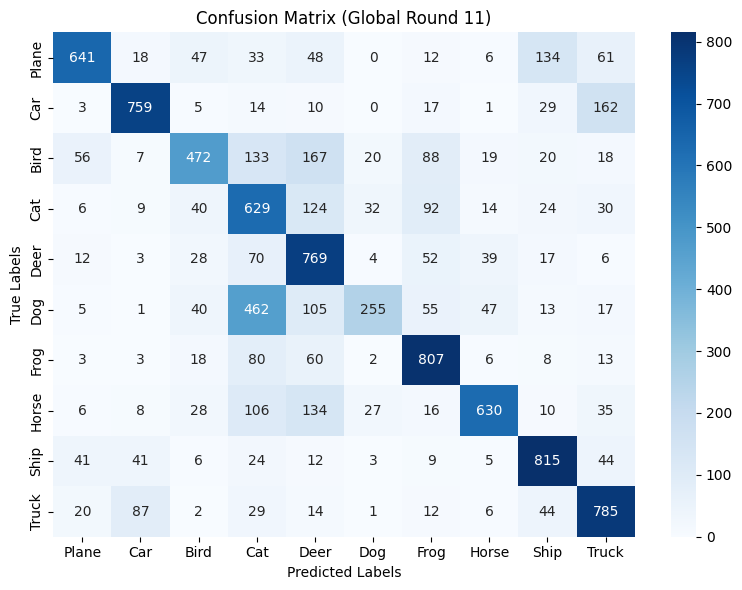


 | Global training round : 12/20 |

Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0416, Test accuracy: 6704/10000 (67.04%)

Class      - Accuracy
Plane      - 68.8
Car        - 78.5
Bird       - 47.3
Cat        - 67.0
Deer       - 77.5
Dog        - 27.3
Frog       - 79.2
Horse      - 65.5
Ship       - 81.6
Truck      - 77.7


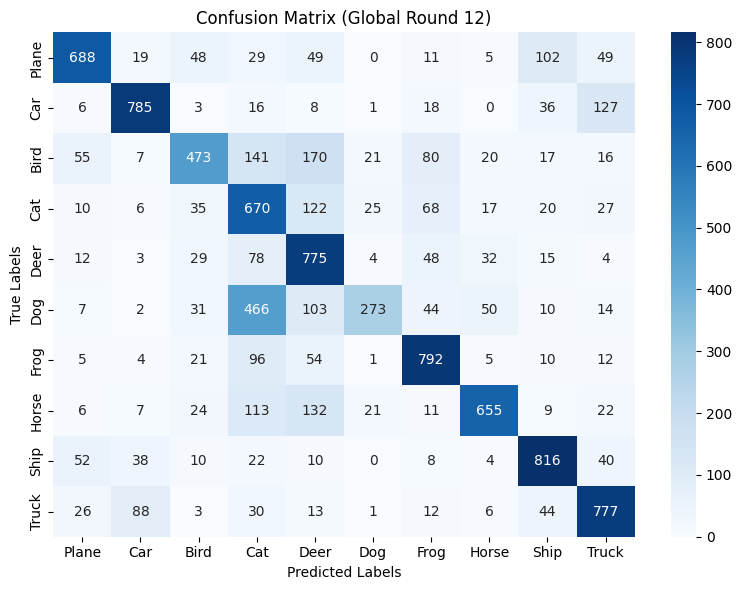


 | Global training round : 13/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0404, Test accuracy: 6764/10000 (67.64%)

Class      - Accuracy
Plane      - 70.4
Car        - 76.0
Bird       - 51.1
Cat        - 63.2
Deer       - 77.9
Dog        - 27.1
Frog       - 83.6
Horse      - 64.9
Ship       - 84.1
Truck      - 78.1


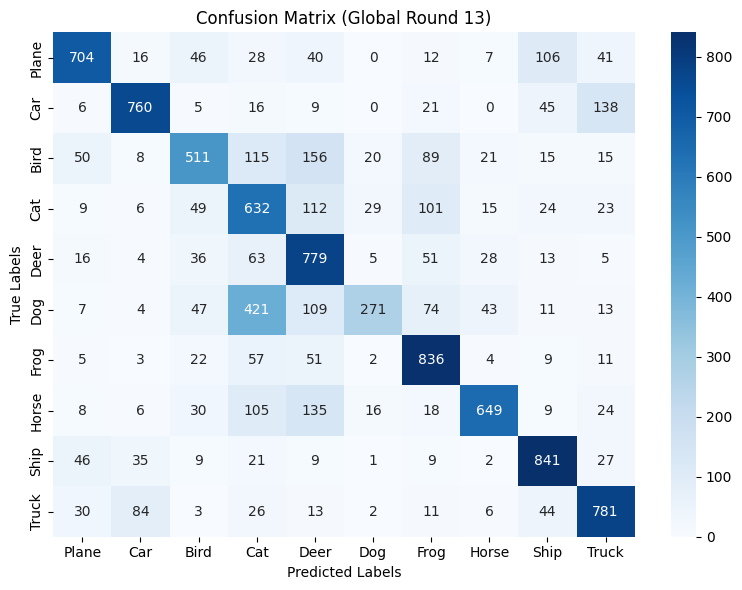


 | Global training round : 14/20 |

Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0283, Test accuracy: 6804/10000 (68.04%)

Class      - Accuracy
Plane      - 69.7
Car        - 78.9
Bird       - 51.9
Cat        - 61.9
Deer       - 78.3
Dog        - 28.9
Frog       - 85.3
Horse      - 64.5
Ship       - 83.3
Truck      - 77.7


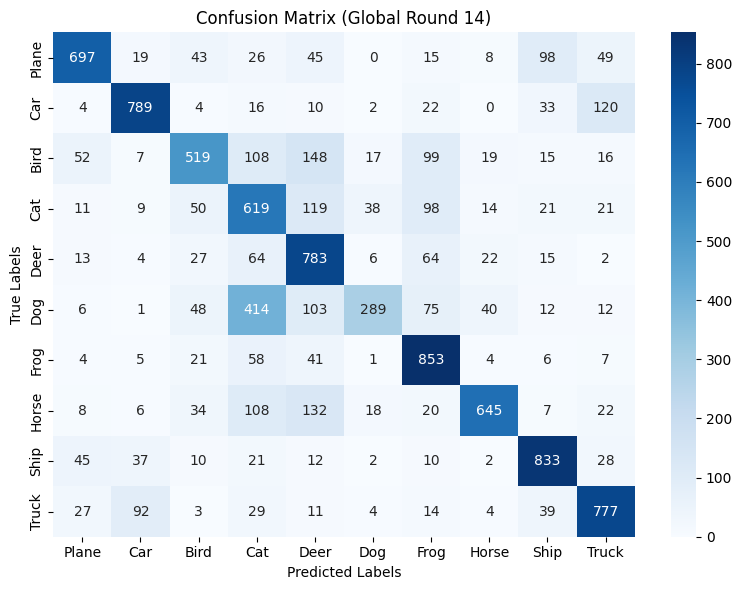


 | Global training round : 15/20 |

Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0123, Test accuracy: 6934/10000 (69.34%)

Class      - Accuracy
Plane      - 71.7
Car        - 78.7
Bird       - 51.6
Cat        - 65.0
Deer       - 78.8
Dog        - 34.6
Frog       - 83.4
Horse      - 65.1
Ship       - 84.9
Truck      - 79.6


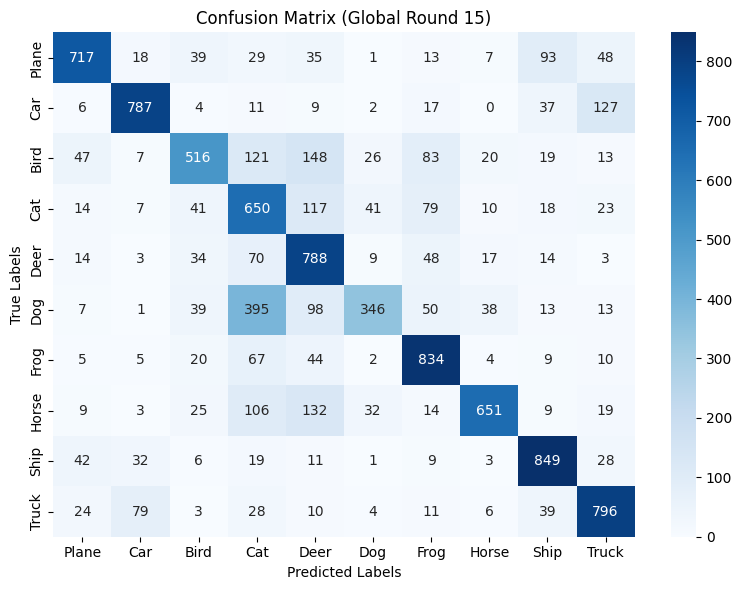


 | Global training round : 16/20 |

Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0461, Test accuracy: 6881/10000 (68.81%)

Class      - Accuracy
Plane      - 72.4
Car        - 81.1
Bird       - 51.9
Cat        - 66.1
Deer       - 78.6
Dog        - 26.1
Frog       - 83.3
Horse      - 65.5
Ship       - 83.4
Truck      - 79.7


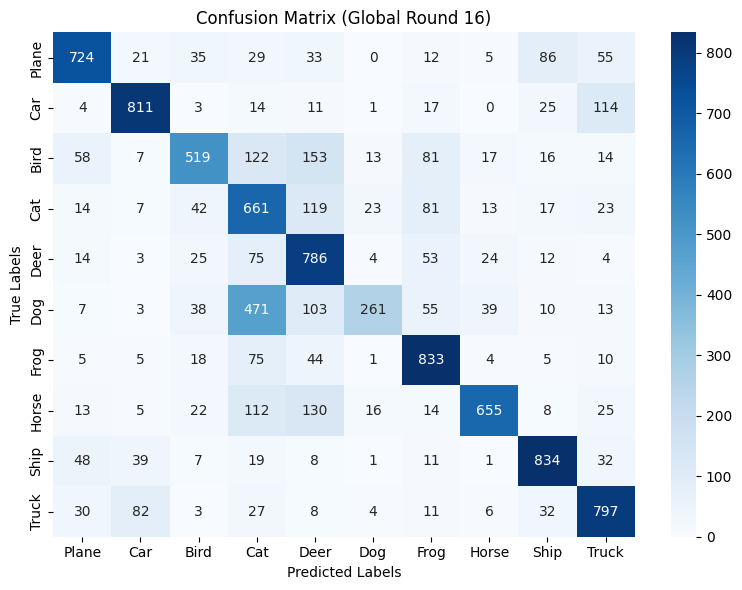


 | Global training round : 17/20 |

Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0289, Test accuracy: 6911/10000 (69.11%)

Class      - Accuracy
Plane      - 72.2
Car        - 79.8
Bird       - 55.0
Cat        - 64.2
Deer       - 78.1
Dog        - 29.9
Frog       - 84.2
Horse      - 64.3
Ship       - 84.2
Truck      - 79.2


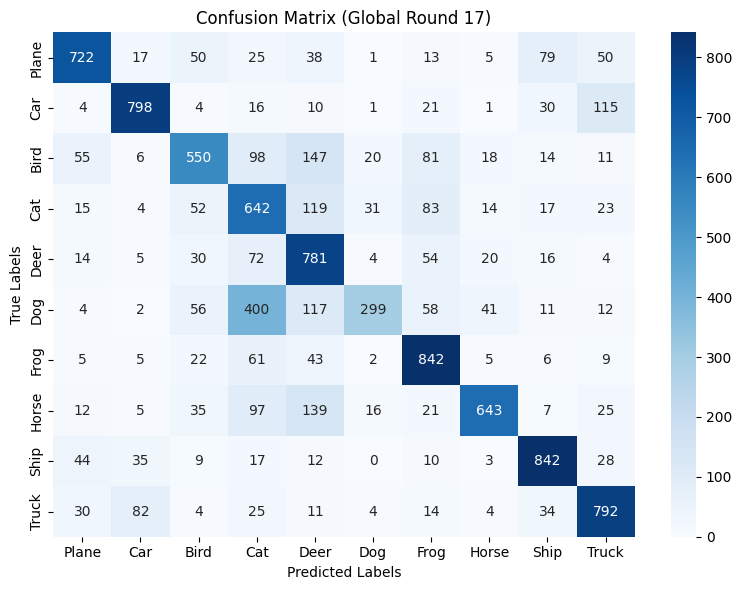


 | Global training round : 18/20 |

Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 3 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 1.0344, Test accuracy: 6938/10000 (69.38%)

Class      - Accuracy
Plane      - 73.4
Car        - 79.2
Bird       - 54.4
Cat        - 66.6
Deer       - 78.6
Dog        - 27.5
Frog       - 83.6
Horse      - 64.9
Ship       - 84.3
Truck      - 81.3


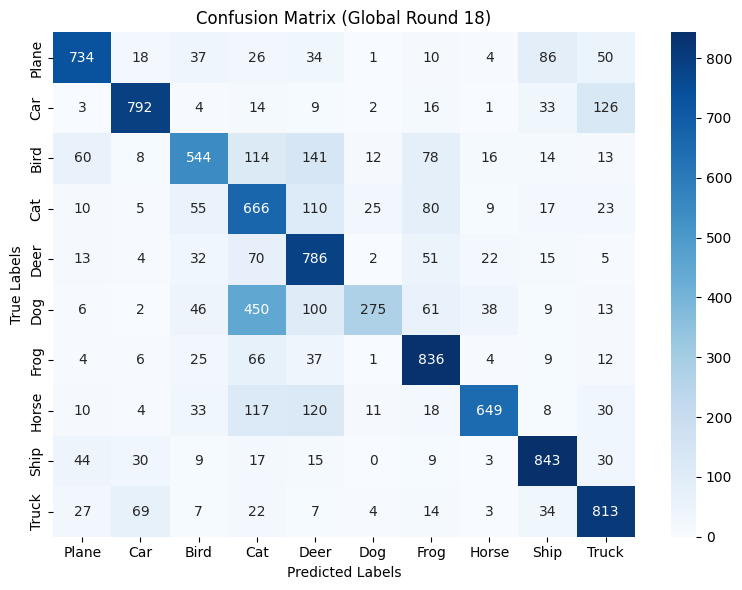


 | Global training round : 19/20 |

Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 0.9953, Test accuracy: 7058/10000 (70.58%)

Class      - Accuracy
Plane      - 72.1
Car        - 81.3
Bird       - 55.2
Cat        - 65.6
Deer       - 78.6
Dog        - 36.3
Frog       - 85.5
Horse      - 67.3
Ship       - 83.5
Truck      - 80.4


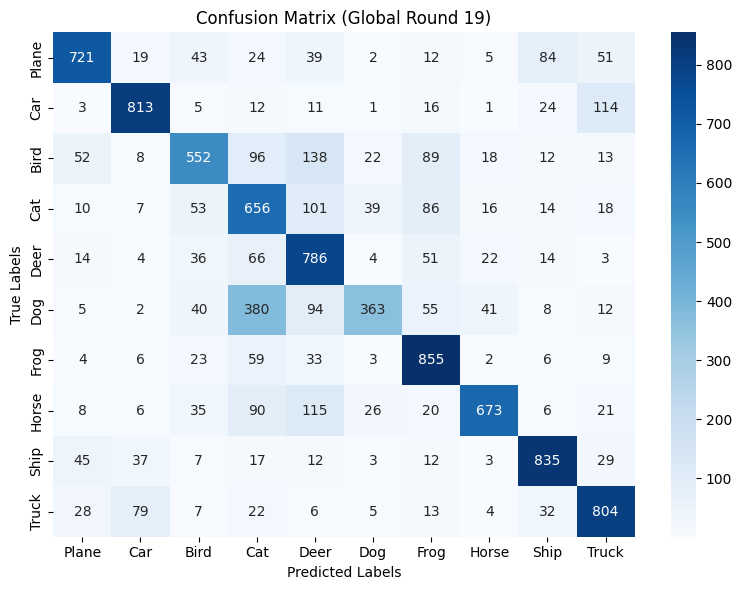


 | Global training round : 20/20 |

Label flipping attack launched by Peer 3 to flip class  5  to class  3
Label flipping attack launched by Peer 1 to flip class  5  to class  3
Label flipping attack launched by Peer 6 to flip class  5  to class  3
Label flipping attack launched by Peer 13 to flip class  5  to class  3
 our aggregation
inside robust aggregate

Average test loss: 0.9948, Test accuracy: 7054/10000 (70.54%)

Class      - Accuracy
Plane      - 74.6
Car        - 82.1
Bird       - 56.0
Cat        - 67.4
Deer       - 78.6
Dog        - 30.4
Frog       - 85.6
Horse      - 68.3
Ship       - 82.7
Truck      - 79.7
Last 10 updates results

Average test loss: 1.0176, Test accuracy: 6880/10000 (68.80%)

***********************************************************************************
Class      - Accuracy
Plane      - 71.5
Car        - 78.5
Bird       - 52.4
Cat        - 65.4
Deer       - 79.1
Dog        - 28.8
Frog       - 83.8
Horse      - 64.4
Ship       - 84.6
Truck      - 79

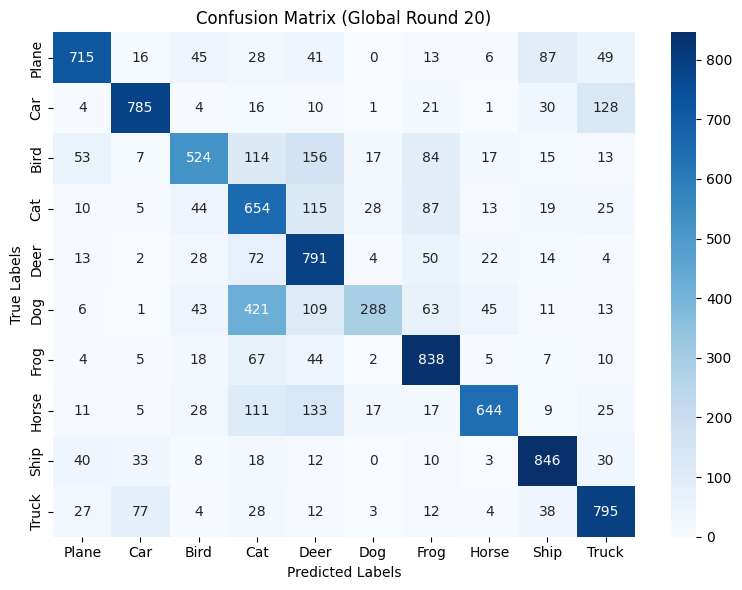

Global accuracies:  [np.float64(10.0), np.float64(13.3), np.float64(28.1), np.float64(41.94), np.float64(52.18), np.float64(56.79), np.float64(59.86), np.float64(61.77), np.float64(63.61), np.float64(64.61), np.float64(65.62), np.float64(67.04), np.float64(67.64), np.float64(68.04), np.float64(69.34), np.float64(68.81), np.float64(69.11), np.float64(69.38), np.float64(70.58), np.float64(70.54), np.float64(68.8)]
Class 5 accuracies:  [np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.4), np.float64(6.9), np.float64(10.2), np.float64(13.1), np.float64(20.6), np.float64(19.8), np.float64(25.5), np.float64(27.3), np.float64(27.1), np.float64(28.9), np.float64(34.6), np.float64(26.1), np.float64(29.9), np.float64(27.5), np.float64(36.3), np.float64(30.4), np.float64(28.8)]
Test loss: [np.float64(2.3467), np.float64(2.2699), np.float64(1.9803), np.float64(1.5995), np.float64(1.334), np.float64(1.1945), np.float64(1.1425), np.float64(1.1097), np.float64(1.0847),

In [ ]:
RULE = 'robutslfd'
ATTACK_TYPE='label_flipping'
MALICIOUS_BEHAVIOR_RATE = 1
for atr in [0.2]:
    run_exp(dataset_name = DATASET_NAME, model_name = MODEL_NAME, dd_type = DD_TYPE, num_peers = NUM_PEERS,
            frac_peers = FRAC_PEERS, seed = SEED, test_batch_size = TEST_BATCH_SIZE,
                criterion = CRITERION, global_rounds = GLOBAL_ROUNDS, local_epochs = LOCAL_EPOCHS, local_bs = LOCAL_BS,
                 local_lr = LOCAL_LR, local_momentum = LOCAL_MOMENTUM, labels_dict = LABELS_DICT, device = DEVICE,
                attackers_ratio = atr, attack_type=ATTACK_TYPE,
                 malicious_behavior_rate = MALICIOUS_BEHAVIOR_RATE, rule = RULE,
                source_class = SOURCE_CLASS, target_class = TARGET_CLASS,
               class_per_peer = CLASS_PER_PEER, samples_per_class = SAMPLES_PER_CLASS,
               rate_unbalance = RATE_UNBALANCE, alpha = ALPHA, resume = False)

IMDB, IID, 40% attacker

In [ ]:
#=============================== Defining global variables ========================#
DATASET_NAME = "IMDB"
MODEL_NAME = "BiLSTM"
DD_TYPE = 'IID'
ALPHA = 1
NUM_PEERS = 20 # "number of peers: K"
FRAC_PEERS = 1 #'the fraction of peers: C to bel selected in each round'
SEED = 7 #fixed seed
random.seed(SEED)
CRITERION = nn.BCEWithLogitsLoss()
GLOBAL_ROUNDS = 50 #"number of rounds of federated model training"
LOCAL_EPOCHS = 1 #"the number of local epochs: E for each peer"
TEST_BATCH_SIZE = 100
LOCAL_BS = 32 #"local batch size: B for each peer"
LOCAL_LR =  0.001#local learning rate: lr for each peer
LOCAL_MOMENTUM = 0.9 #local momentum for each peer
NUM_CLASSES = 10 # number of classes in an experiment

LABELS_DICT = {'Negative':0,
               'Positive':1}

#select the device to work with cpu or gpu
if torch.cuda.is_available():
    DEVICE = "cuda"
else:
    DEVICE = "cpu"
DEVICE = torch.device(DEVICE)
print(DEVICE)
SOURCE_CLASS = 1 # the source class positive
TARGET_CLASS = 0 # the target class negative

CLASS_PER_PEER = 1
SAMPLES_PER_CLASS = 582
RATE_UNBALANCE = 1

cuda



--> Label FLIP experiment on our algo...
--> Loading of IMDB dataset
--> Dataset has been loaded!
--> Creating BiLSTM model.....
--> Model has been created!
--> Distributing training data among peers
--> Training data have been distributed among peers
--> Creating peets instances
Data set: IMDB
Data distribution: IID
Aggregation rule: robutslfd
Attack Type: label_flipping
Attackers Ratio: 40.0 %
Malicious Behavior Rate: 100 %

===>Simulation started...

====>Global model training started...



  0%|          | 0/50 [00:00<?, ?it/s]


 | Global training round : 1/50 |

Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.1977, Test accuracy: 4993/10000 (49.93%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.0


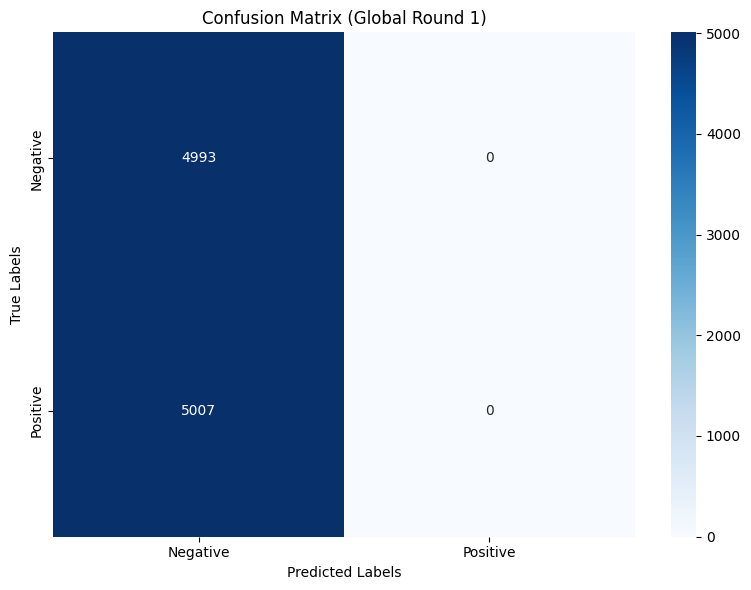


 | Global training round : 2/50 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.9321, Test accuracy: 4993/10000 (49.93%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.0


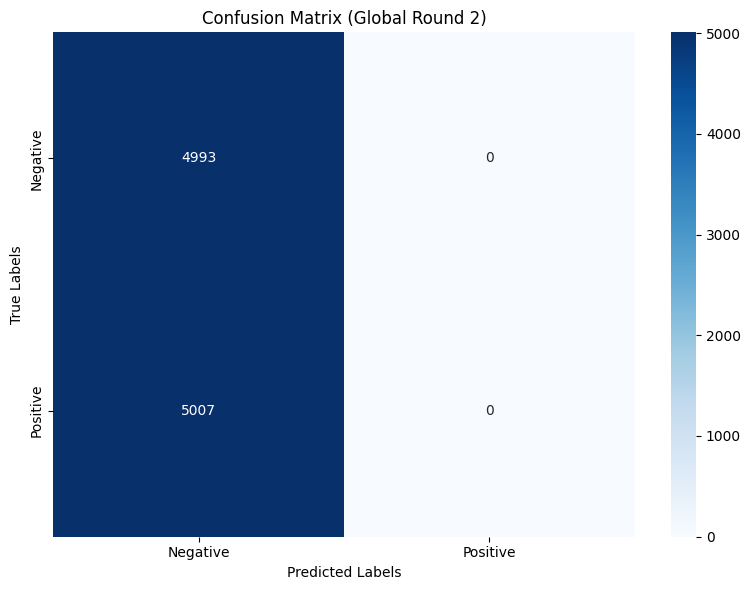


 | Global training round : 3/50 |

Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.0616, Test accuracy: 4993/10000 (49.93%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.0


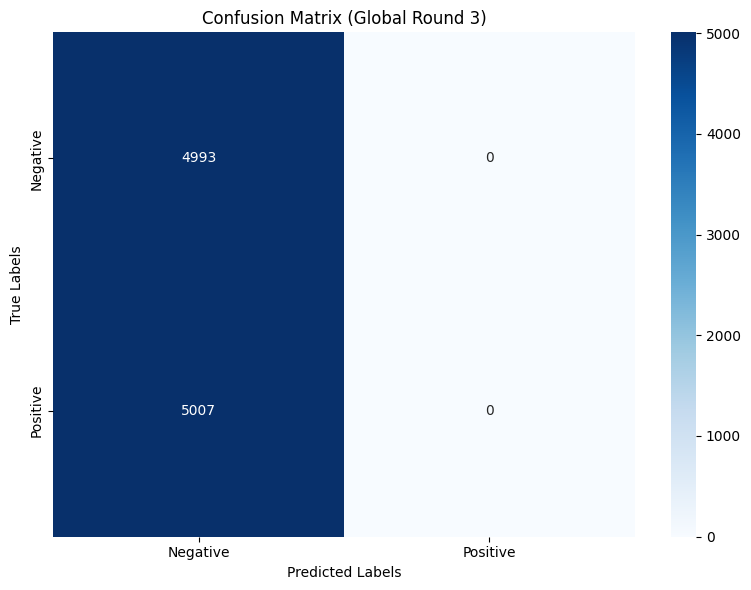


 | Global training round : 4/50 |

Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.8846, Test accuracy: 4993/10000 (49.93%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.0


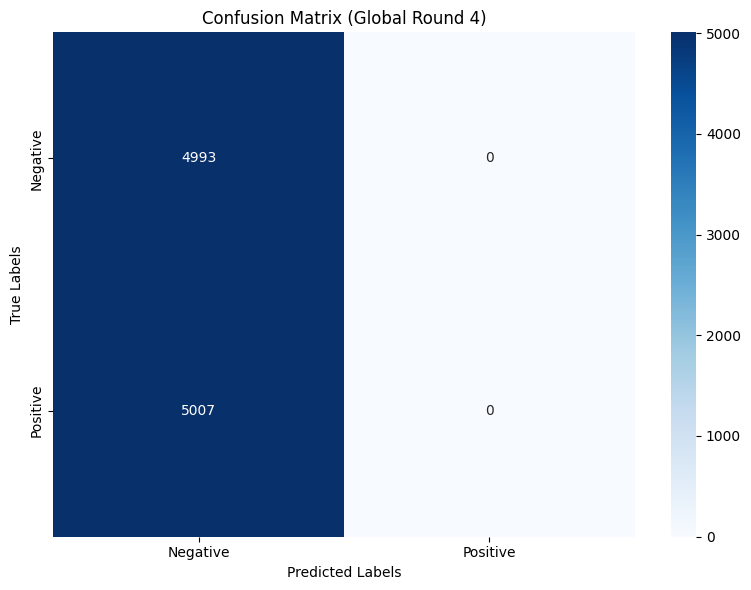


 | Global training round : 5/50 |

Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.5386, Test accuracy: 4993/10000 (49.93%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.0


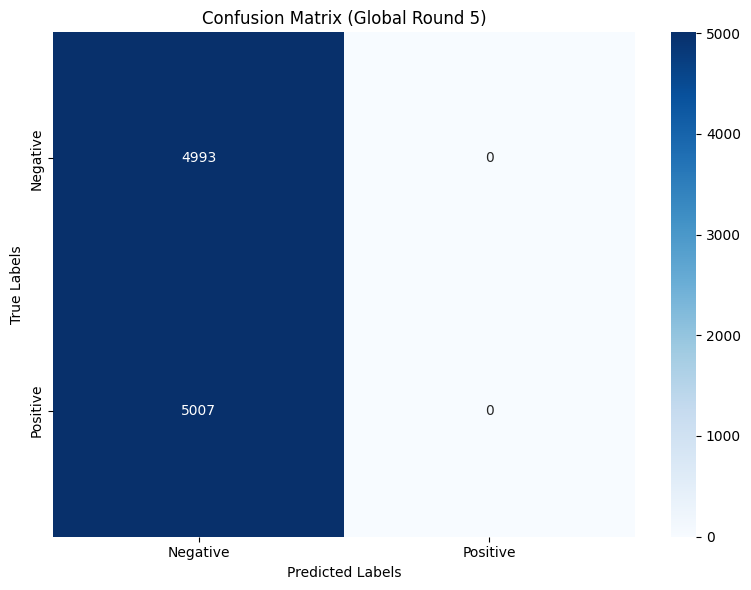


 | Global training round : 6/50 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.8715, Test accuracy: 4993/10000 (49.93%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.0


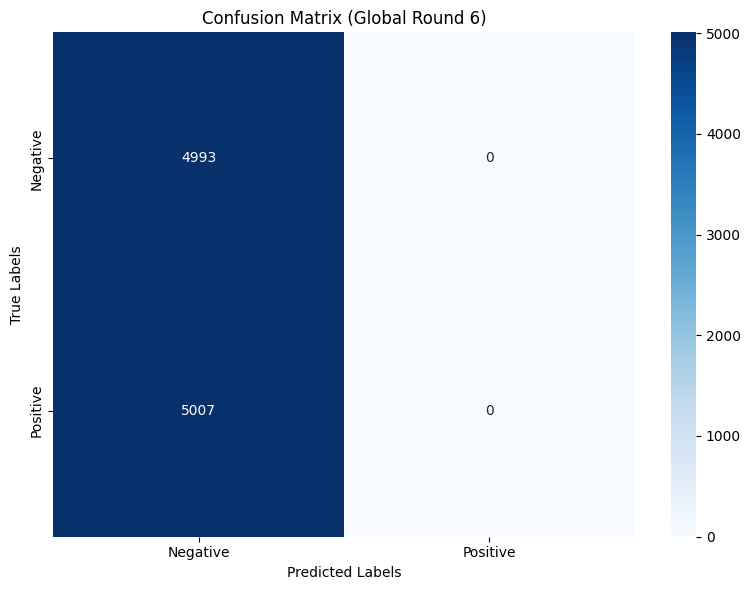


 | Global training round : 7/50 |

Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 2.4378, Test accuracy: 4994/10000 (49.94%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.0


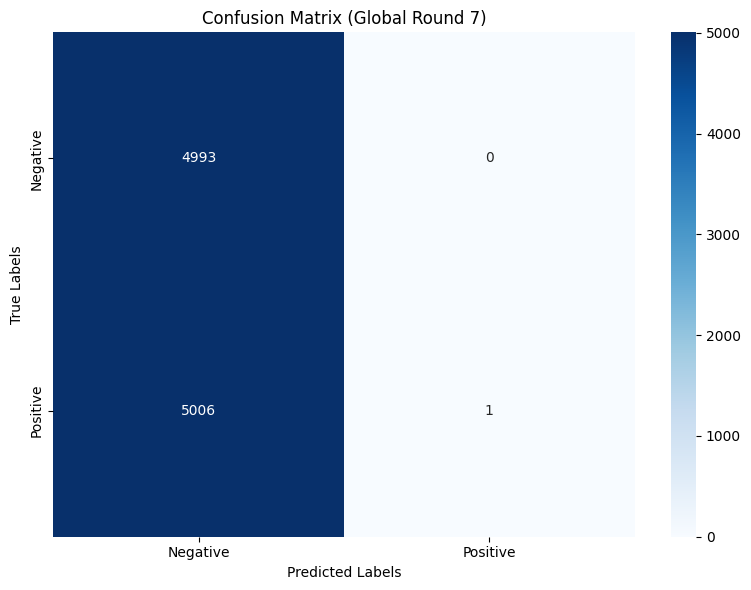


 | Global training round : 8/50 |

Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.8498, Test accuracy: 5042/10000 (50.42%)

Class      - Accuracy
Negative   - 100.0
Positive   - 1.0


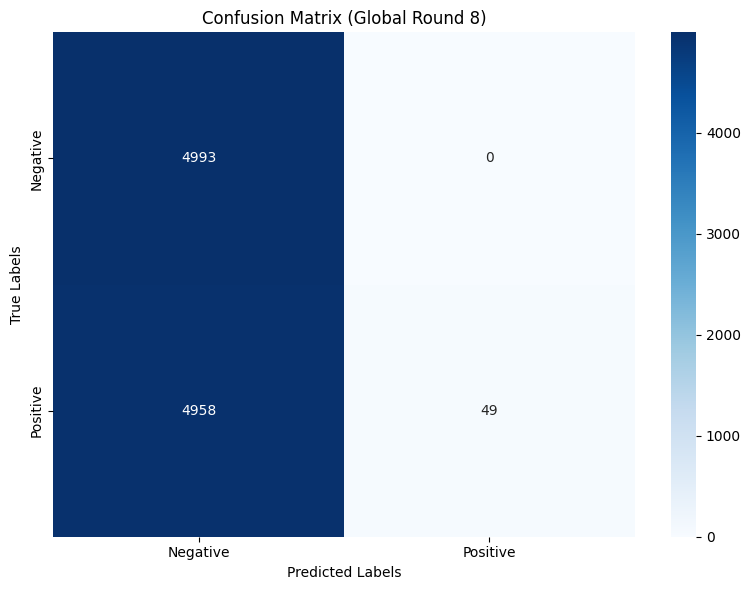


 | Global training round : 9/50 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 3.2629, Test accuracy: 4996/10000 (49.96%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.1


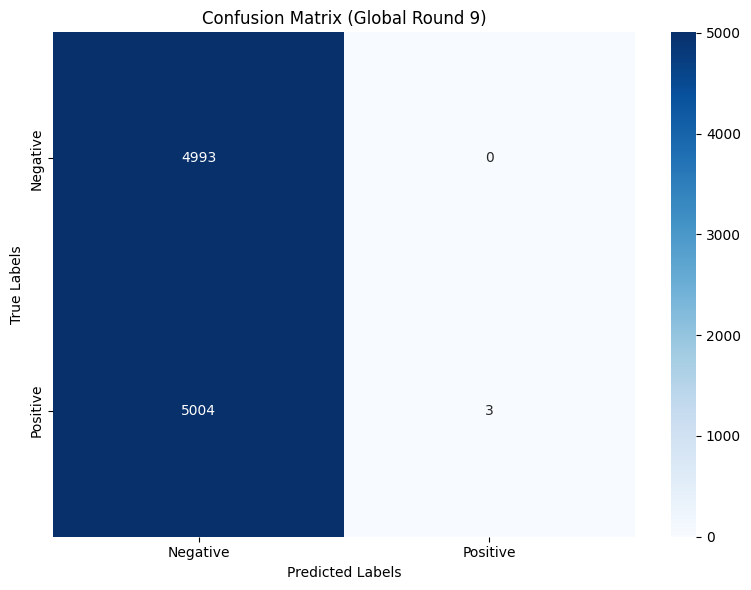


 | Global training round : 10/50 |

Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.8548, Test accuracy: 5107/10000 (51.07%)

Class      - Accuracy
Negative   - 100.0
Positive   - 2.3


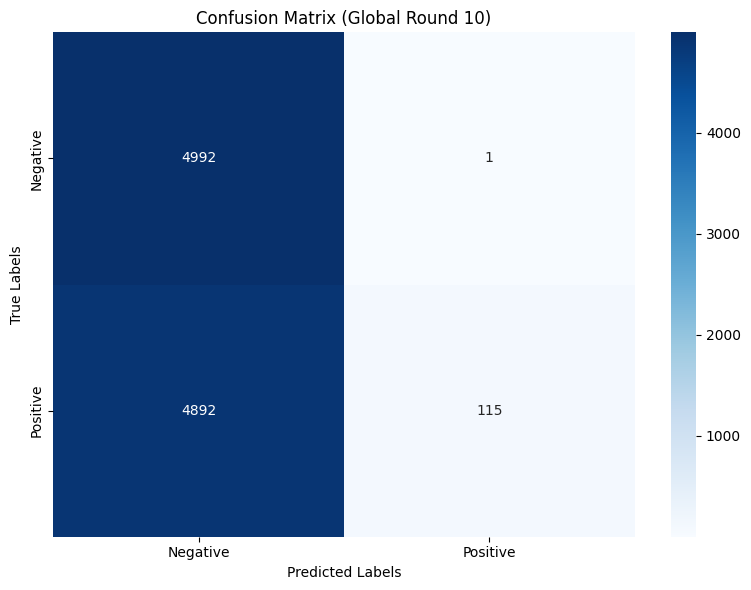


 | Global training round : 11/50 |

Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 2.7459, Test accuracy: 4999/10000 (49.99%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.1


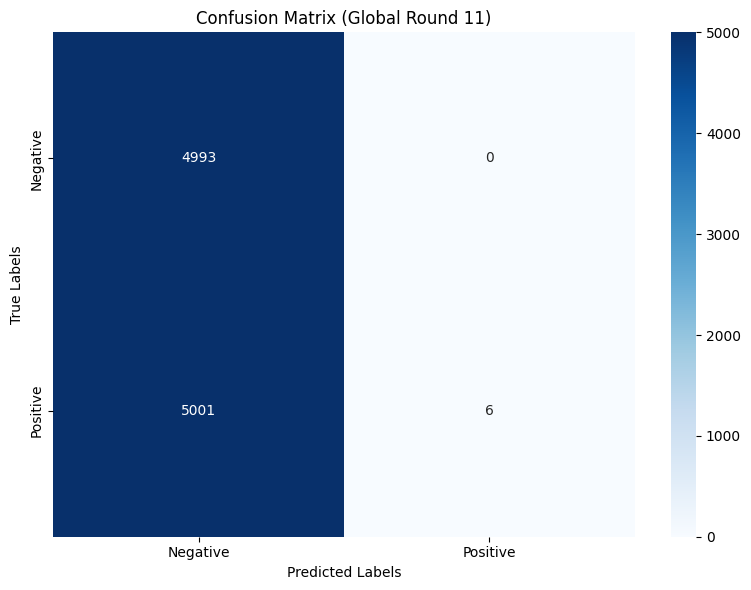


 | Global training round : 12/50 |

Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.8361, Test accuracy: 5179/10000 (51.79%)

Class      - Accuracy
Negative   - 100.0
Positive   - 3.7


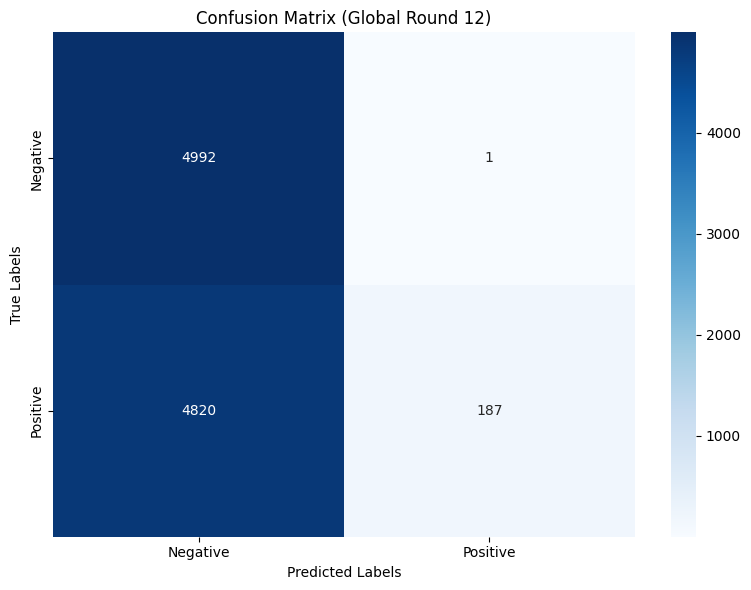


 | Global training round : 13/50 |

Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 3.0723, Test accuracy: 5001/10000 (50.01%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.2


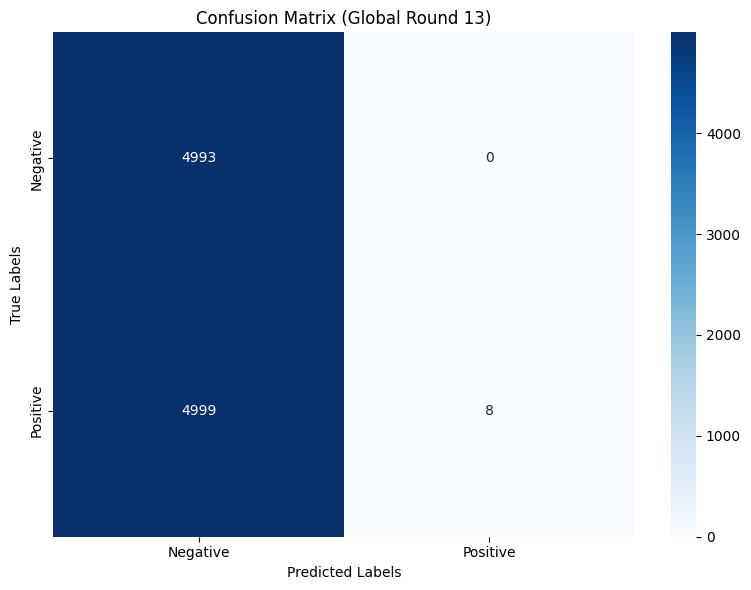


 | Global training round : 14/50 |

Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.8368, Test accuracy: 5287/10000 (52.87%)

Class      - Accuracy
Negative   - 100.0
Positive   - 5.9


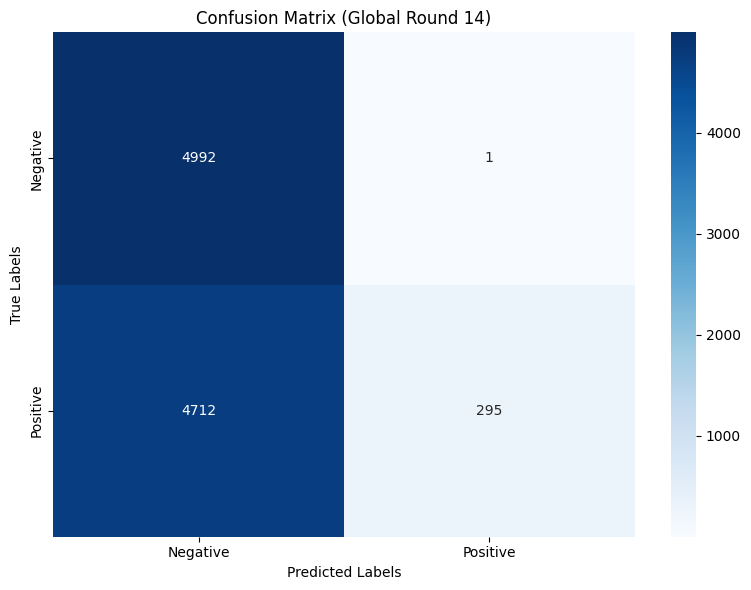


 | Global training round : 15/50 |

Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 3.1891, Test accuracy: 5001/10000 (50.01%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.2


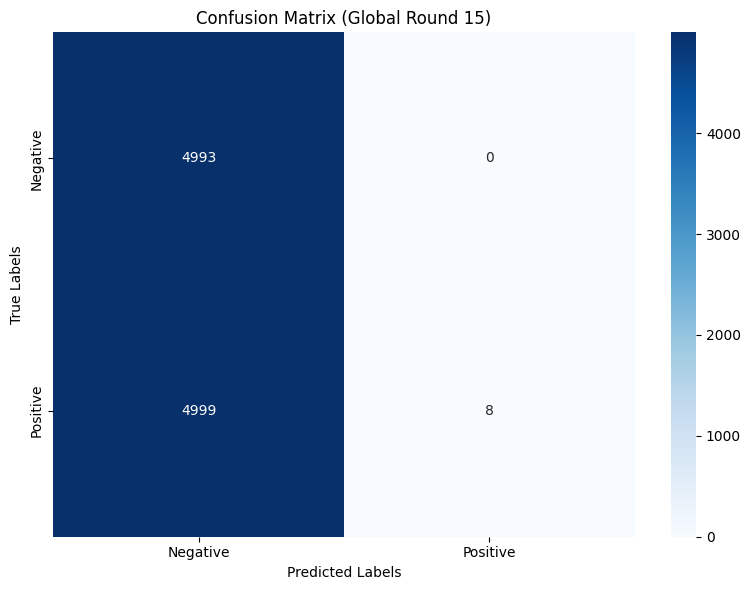


 | Global training round : 16/50 |

Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.9008, Test accuracy: 5271/10000 (52.71%)

Class      - Accuracy
Negative   - 100.0
Positive   - 5.6


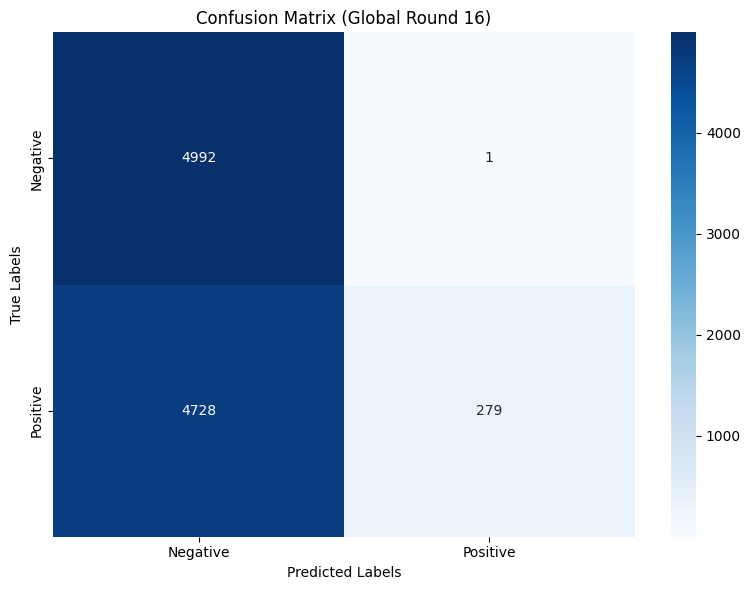


 | Global training round : 17/50 |

Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 2.4434, Test accuracy: 5040/10000 (50.40%)

Class      - Accuracy
Negative   - 100.0
Positive   - 1.0


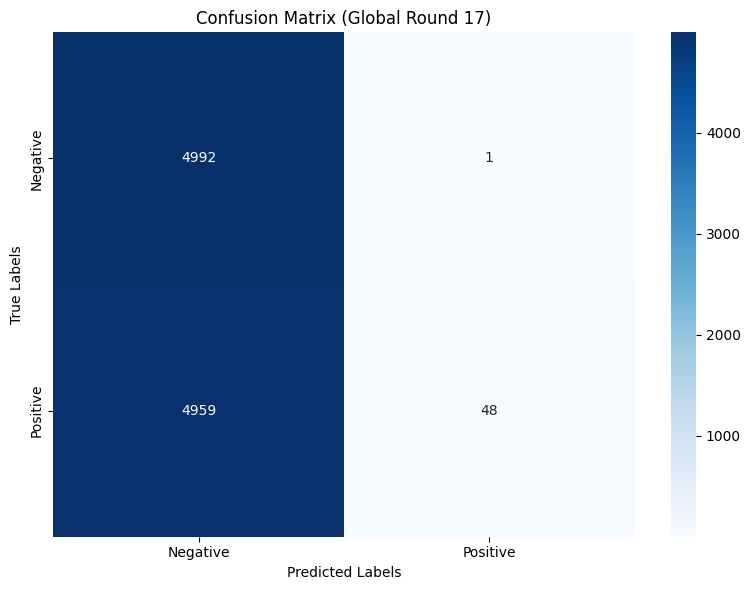


 | Global training round : 18/50 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.0507, Test accuracy: 5224/10000 (52.24%)

Class      - Accuracy
Negative   - 100.0
Positive   - 4.6


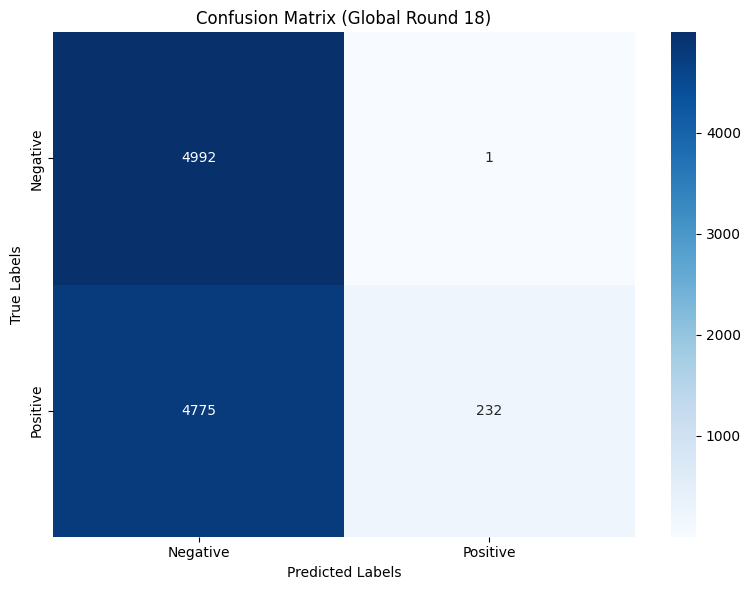


 | Global training round : 19/50 |

Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.7508, Test accuracy: 5056/10000 (50.56%)

Class      - Accuracy
Negative   - 100.0
Positive   - 1.3


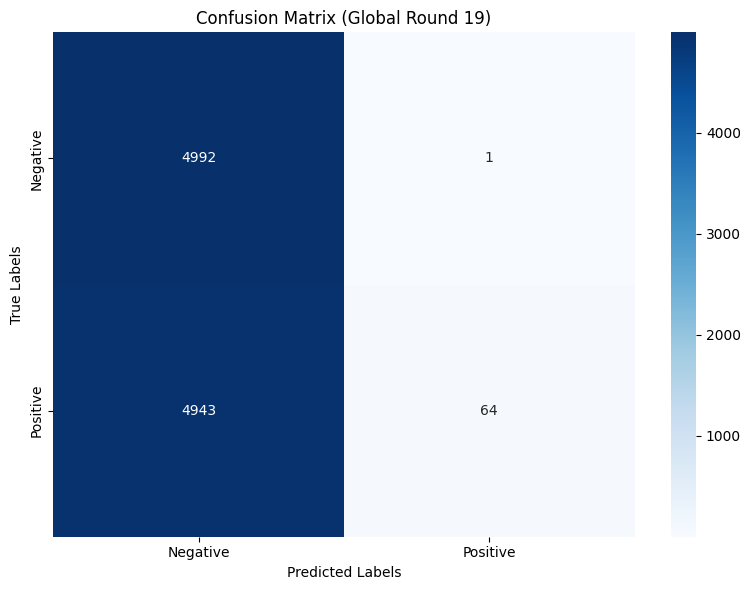


 | Global training round : 20/50 |

Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.1330, Test accuracy: 5213/10000 (52.13%)

Class      - Accuracy
Negative   - 100.0
Positive   - 4.4


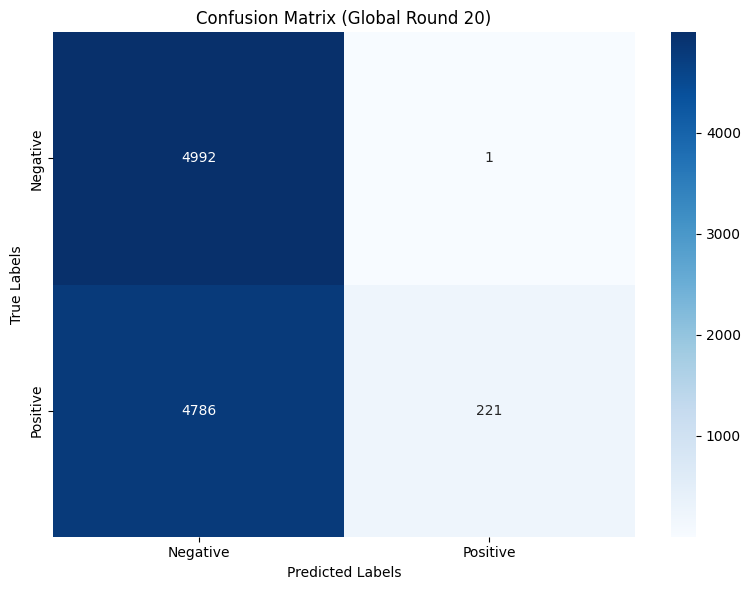


 | Global training round : 21/50 |

Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.6497, Test accuracy: 5067/10000 (50.67%)

Class      - Accuracy
Negative   - 100.0
Positive   - 1.5


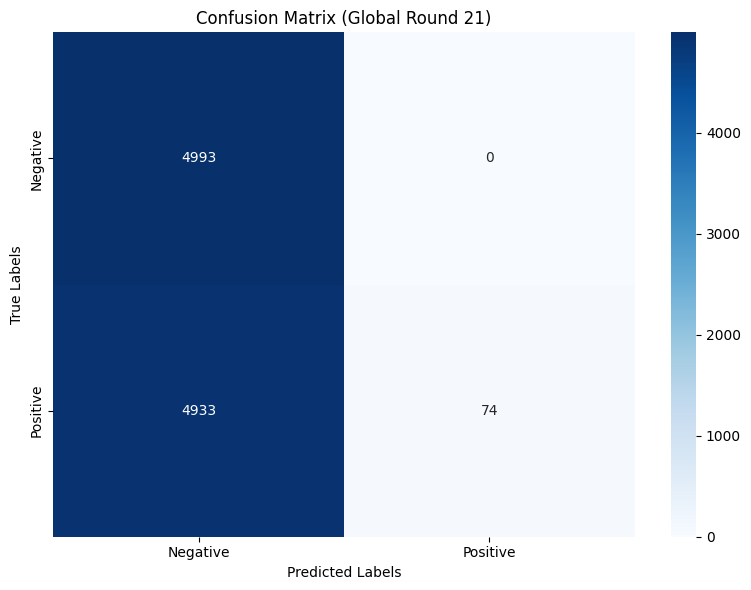


 | Global training round : 22/50 |

Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.1805, Test accuracy: 5239/10000 (52.39%)

Class      - Accuracy
Negative   - 100.0
Positive   - 4.9


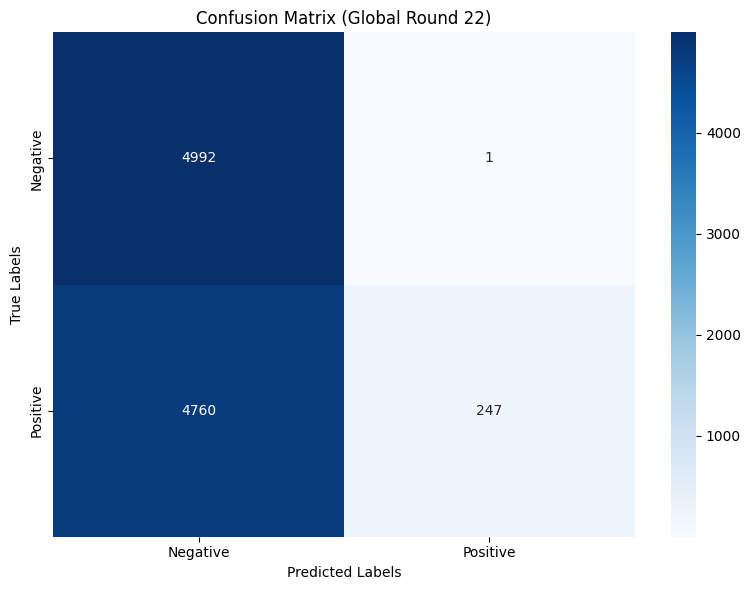


 | Global training round : 23/50 |

Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.4861, Test accuracy: 5130/10000 (51.30%)

Class      - Accuracy
Negative   - 100.0
Positive   - 2.8


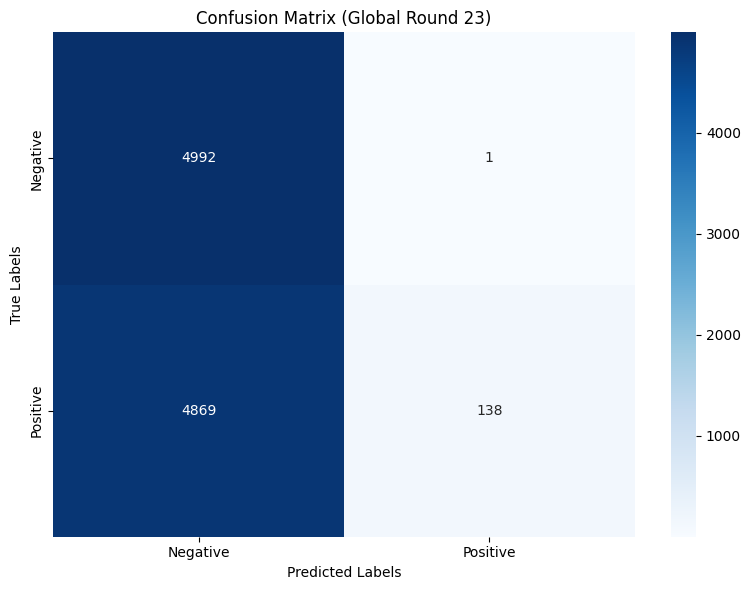


 | Global training round : 24/50 |

Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.1921, Test accuracy: 5226/10000 (52.26%)

Class      - Accuracy
Negative   - 100.0
Positive   - 4.7


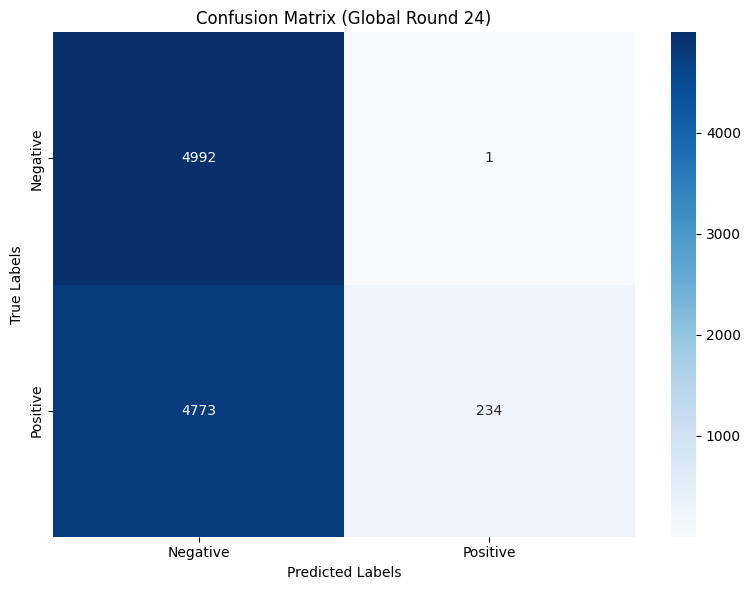


 | Global training round : 25/50 |

Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.4625, Test accuracy: 5122/10000 (51.22%)

Class      - Accuracy
Negative   - 100.0
Positive   - 2.6


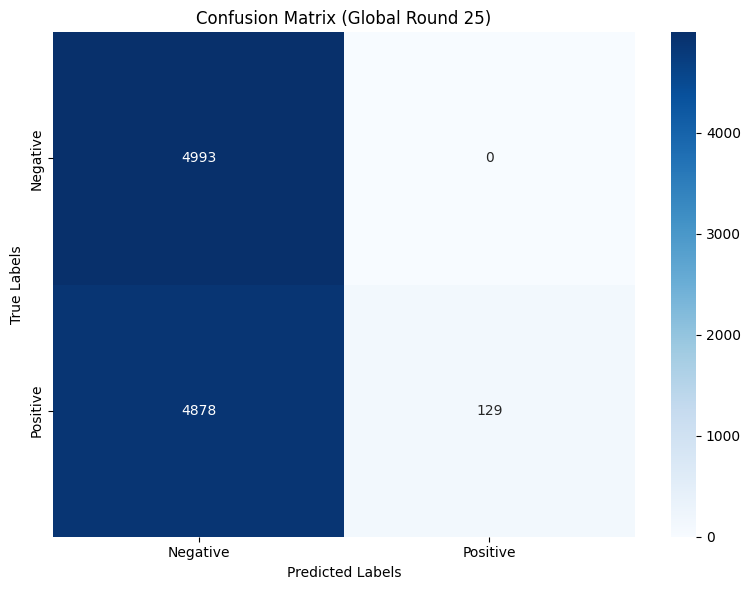


 | Global training round : 26/50 |

Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.2453, Test accuracy: 5224/10000 (52.24%)

Class      - Accuracy
Negative   - 100.0
Positive   - 4.6


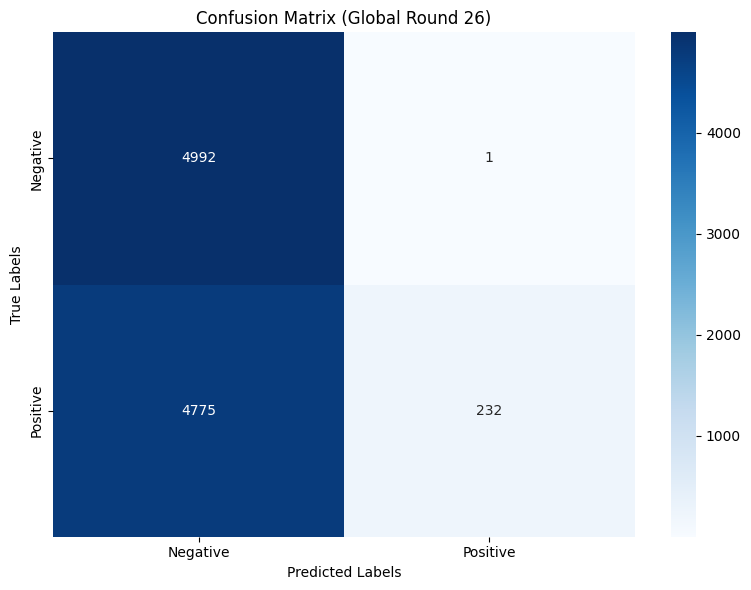


 | Global training round : 27/50 |

Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.5161, Test accuracy: 5098/10000 (50.98%)

Class      - Accuracy
Negative   - 100.0
Positive   - 2.1


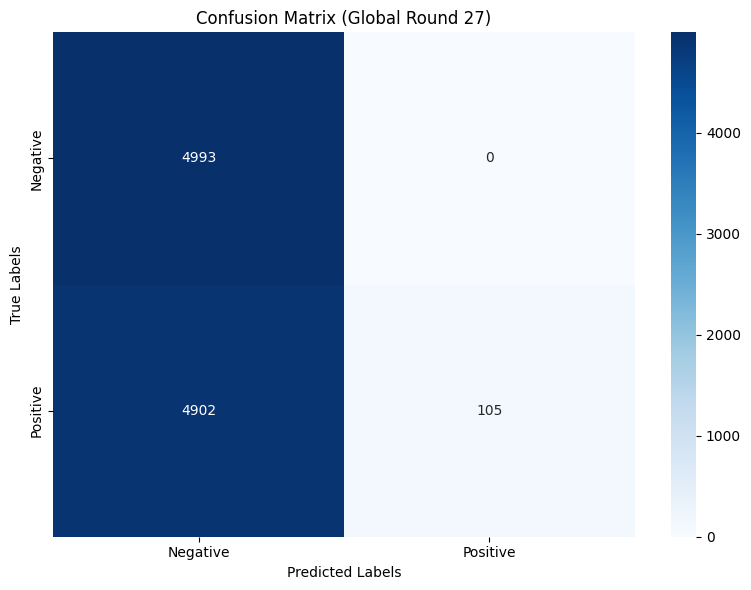


 | Global training round : 28/50 |

Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.2177, Test accuracy: 5283/10000 (52.83%)

Class      - Accuracy
Negative   - 100.0
Positive   - 5.8


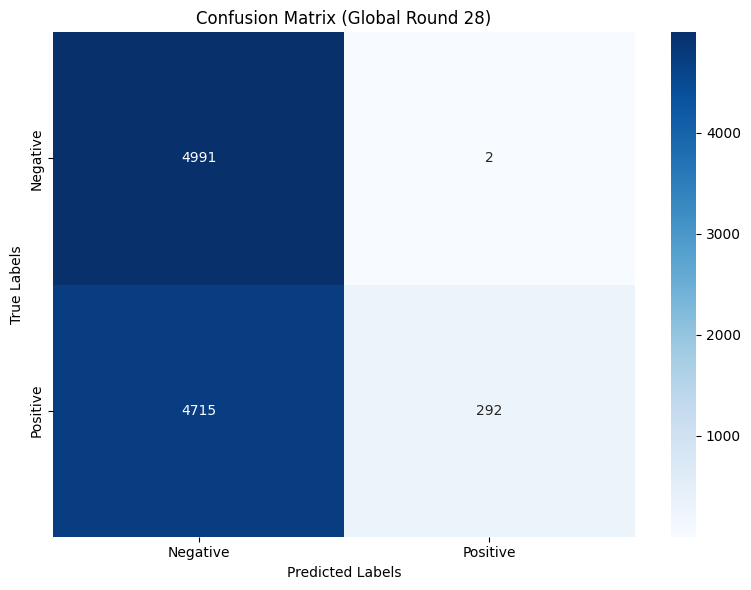


 | Global training round : 29/50 |

Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.3572, Test accuracy: 5198/10000 (51.98%)

Class      - Accuracy
Negative   - 100.0
Positive   - 4.1


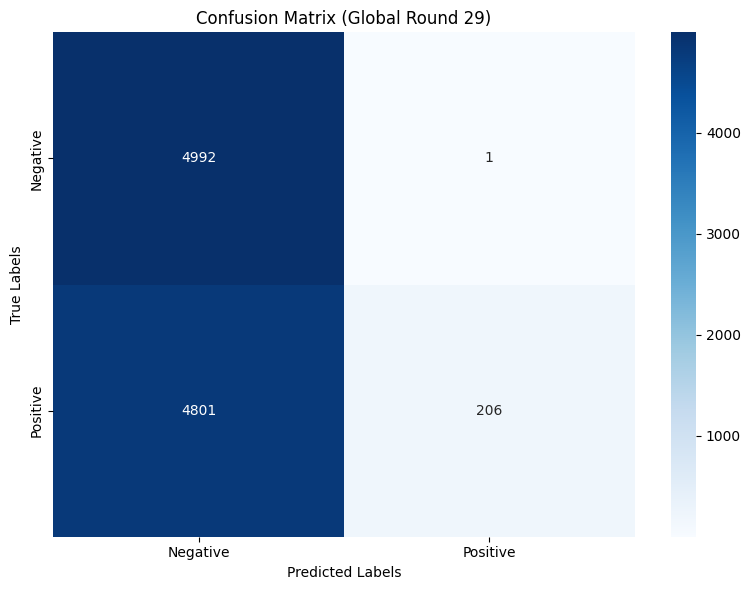


 | Global training round : 30/50 |

Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.2042, Test accuracy: 5314/10000 (53.14%)

Class      - Accuracy
Negative   - 100.0
Positive   - 6.5


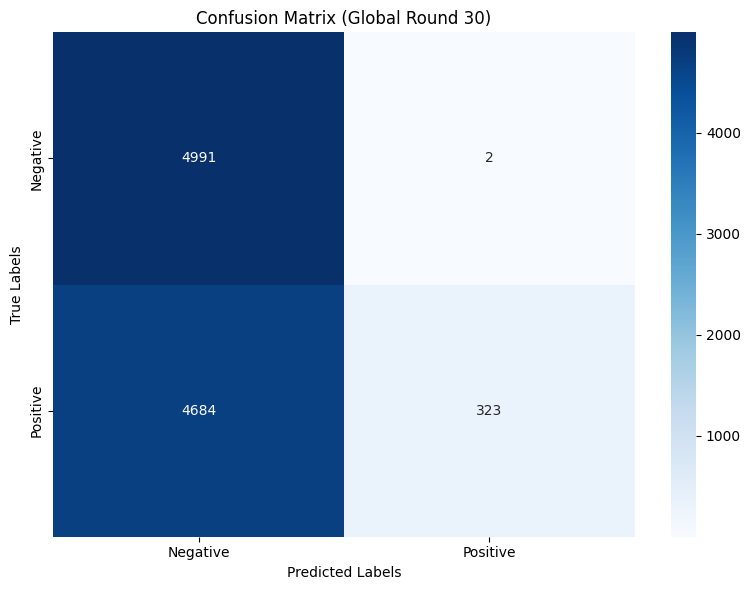


 | Global training round : 31/50 |

Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.3593, Test accuracy: 5219/10000 (52.19%)

Class      - Accuracy
Negative   - 100.0
Positive   - 4.5


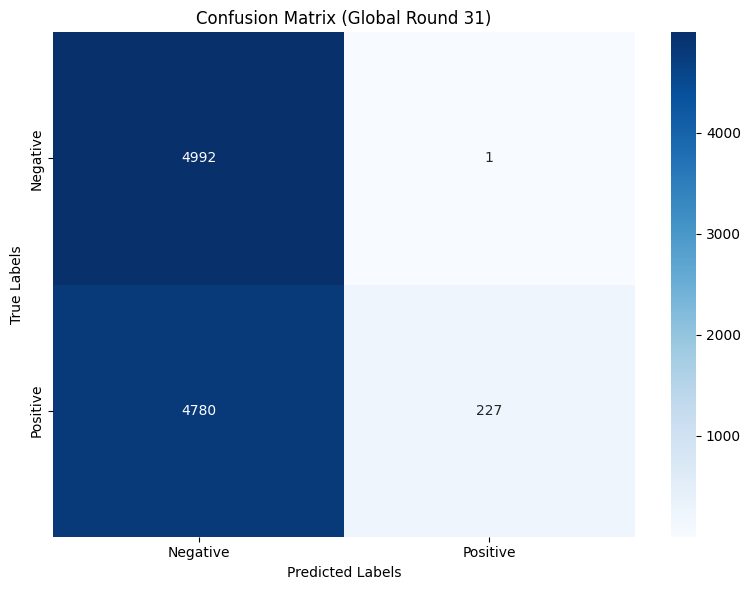


 | Global training round : 32/50 |

Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.2247, Test accuracy: 5344/10000 (53.44%)

Class      - Accuracy
Negative   - 100.0
Positive   - 7.1


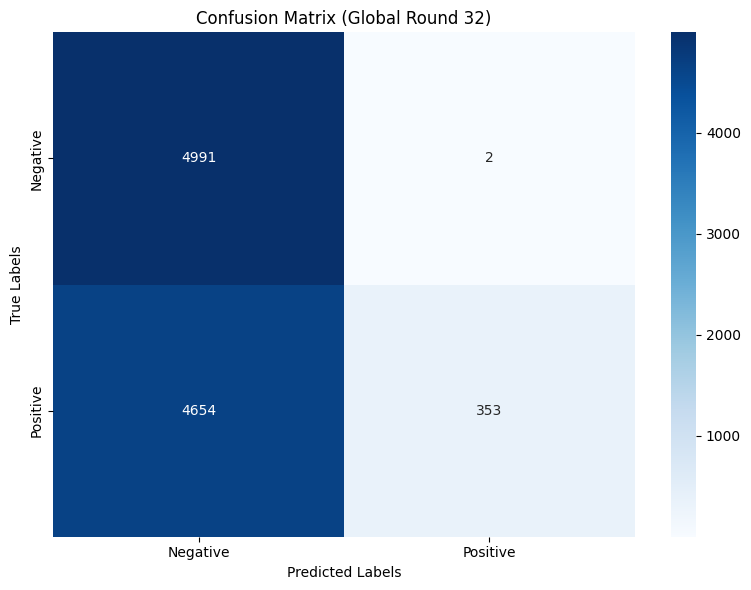


 | Global training round : 33/50 |

Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.2625, Test accuracy: 5336/10000 (53.36%)

Class      - Accuracy
Negative   - 100.0
Positive   - 6.9


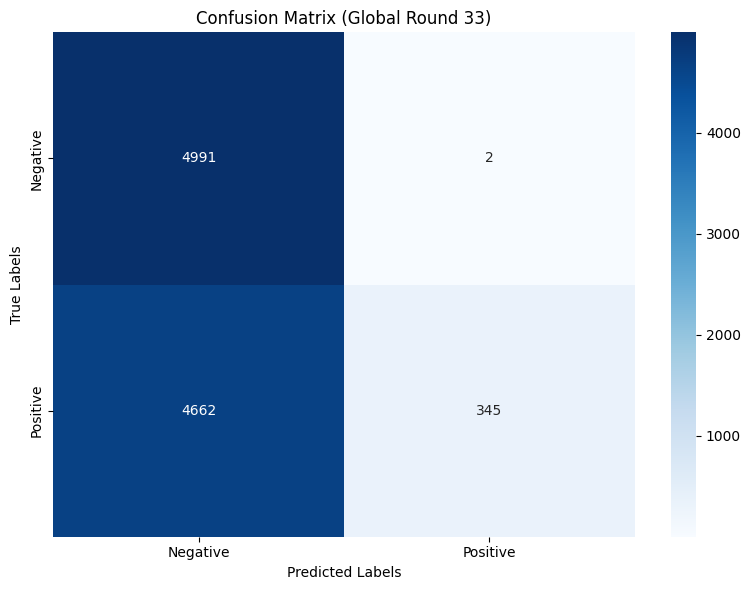


 | Global training round : 34/50 |

Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.2233, Test accuracy: 5319/10000 (53.19%)

Class      - Accuracy
Negative   - 100.0
Positive   - 6.6


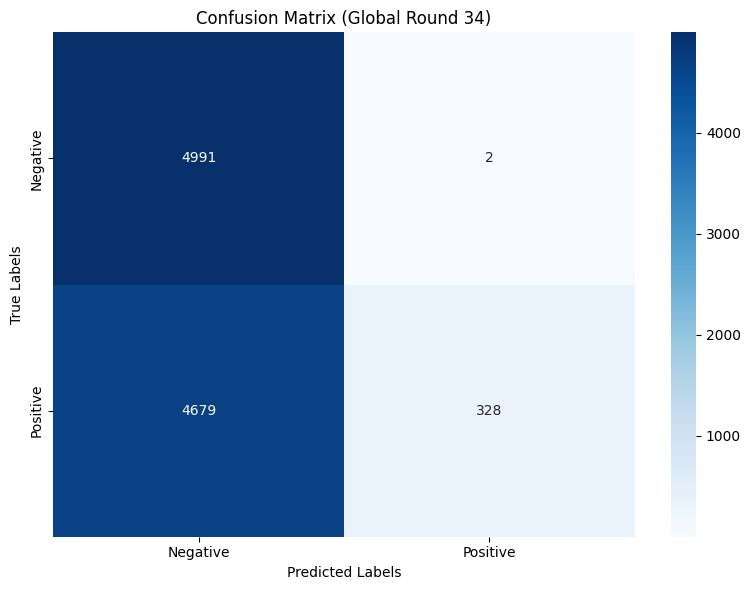


 | Global training round : 35/50 |

Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.2583, Test accuracy: 5364/10000 (53.64%)

Class      - Accuracy
Negative   - 99.9
Positive   - 7.5


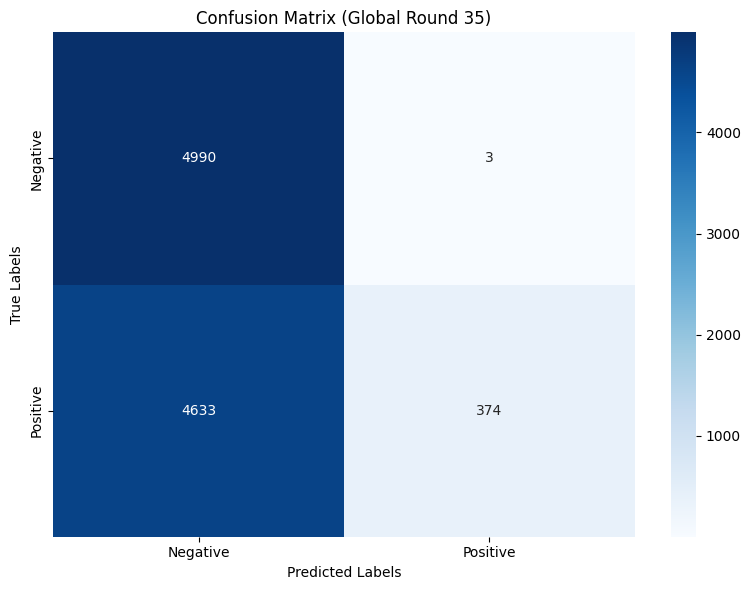


 | Global training round : 36/50 |

Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.1939, Test accuracy: 5379/10000 (53.79%)

Class      - Accuracy
Negative   - 100.0
Positive   - 7.7


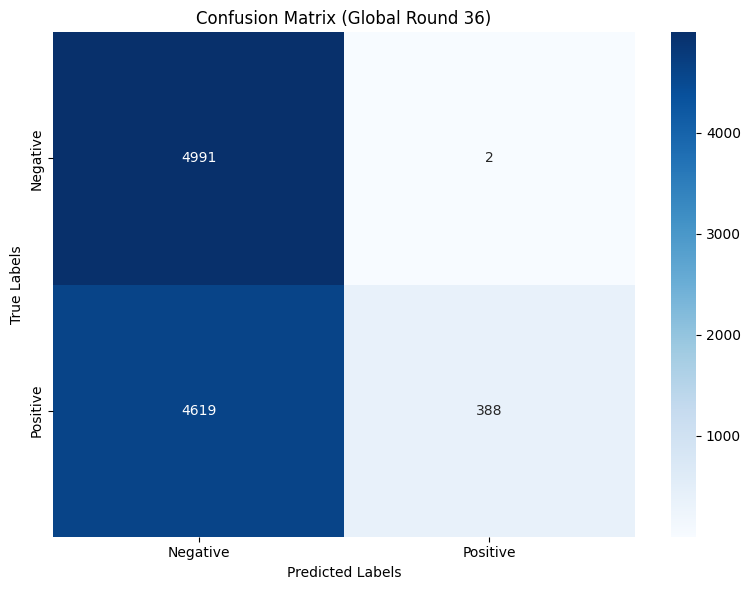


 | Global training round : 37/50 |

Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.3009, Test accuracy: 5319/10000 (53.19%)

Class      - Accuracy
Negative   - 100.0
Positive   - 6.6


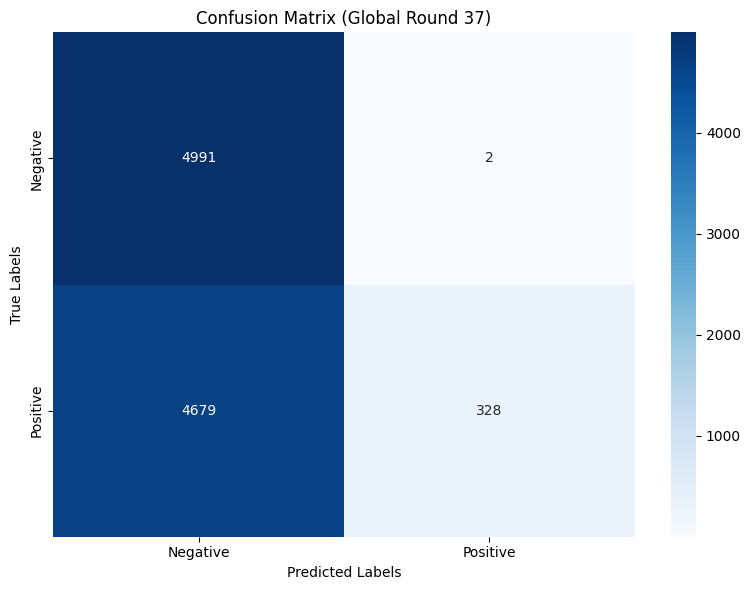


 | Global training round : 38/50 |

Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.1678, Test accuracy: 5494/10000 (54.94%)

Class      - Accuracy
Negative   - 99.9
Positive   - 10.1


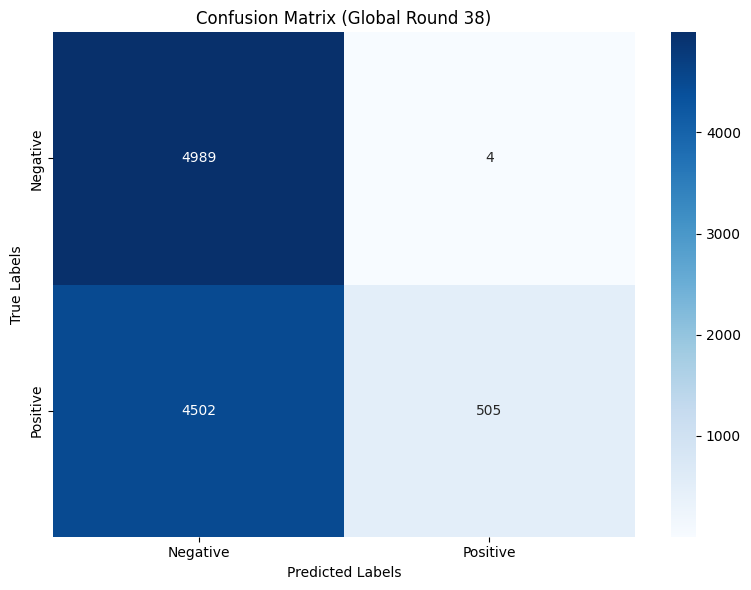


 | Global training round : 39/50 |

Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.2684, Test accuracy: 5356/10000 (53.56%)

Class      - Accuracy
Negative   - 99.9
Positive   - 7.3


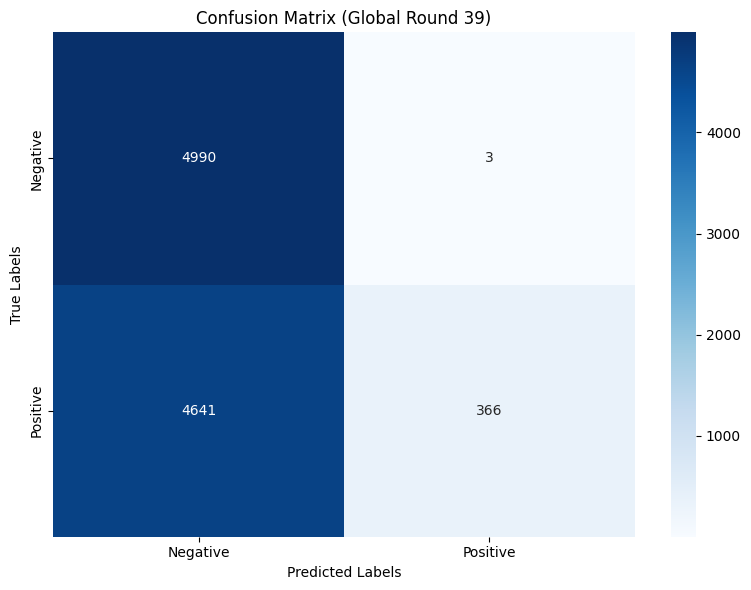


 | Global training round : 40/50 |

Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.2966, Test accuracy: 5326/10000 (53.26%)

Class      - Accuracy
Negative   - 100.0
Positive   - 6.7


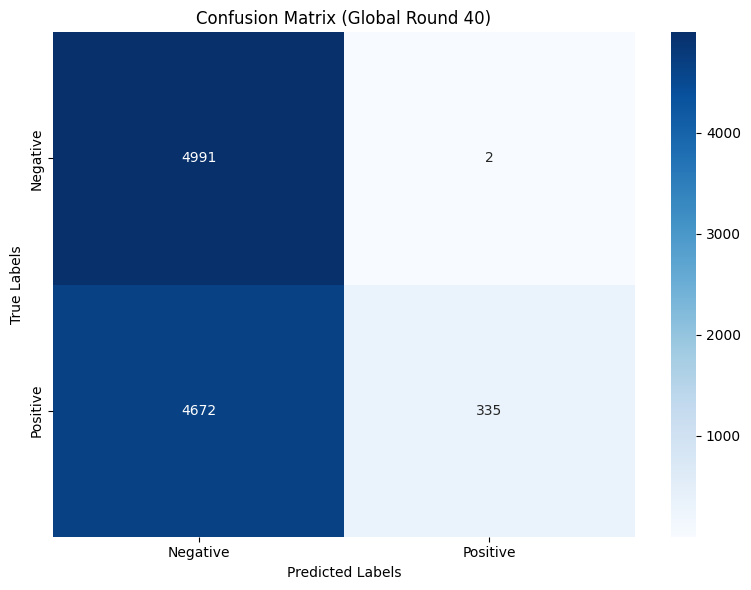


 | Global training round : 41/50 |

Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.0750, Test accuracy: 5578/10000 (55.78%)

Class      - Accuracy
Negative   - 99.9
Positive   - 11.8


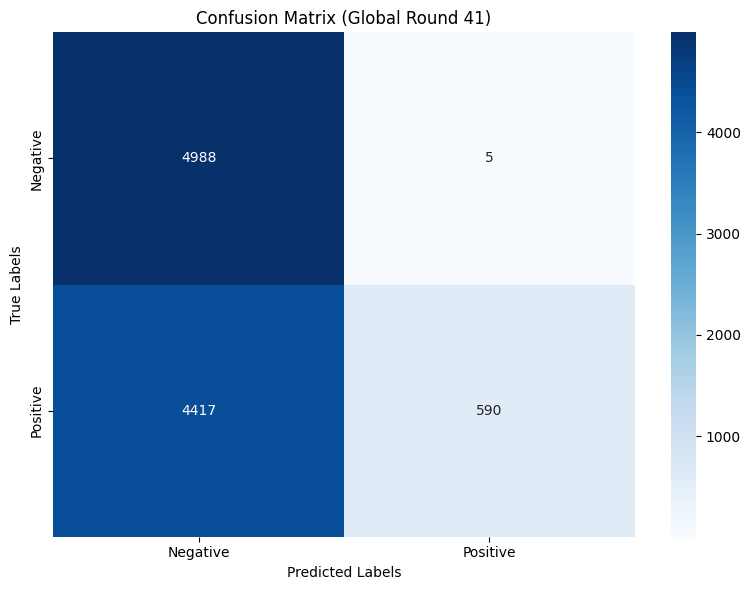


 | Global training round : 42/50 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.3190, Test accuracy: 5316/10000 (53.16%)

Class      - Accuracy
Negative   - 100.0
Positive   - 6.5


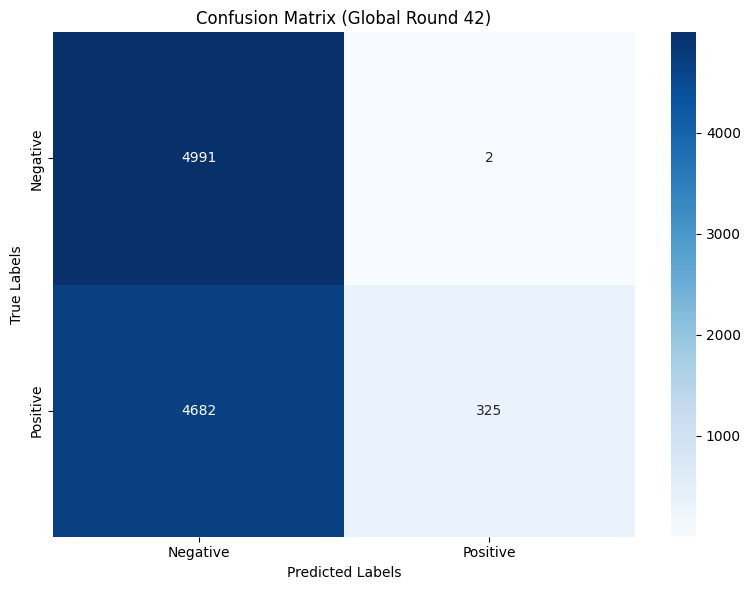


 | Global training round : 43/50 |

Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.1026, Test accuracy: 5598/10000 (55.98%)

Class      - Accuracy
Negative   - 99.9
Positive   - 12.2


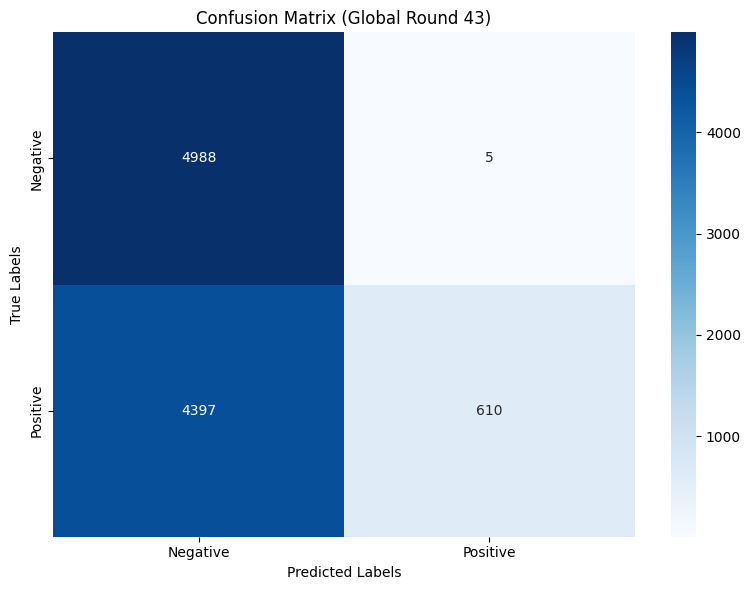


 | Global training round : 44/50 |

Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.2268, Test accuracy: 5457/10000 (54.57%)

Class      - Accuracy
Negative   - 99.9
Positive   - 9.3


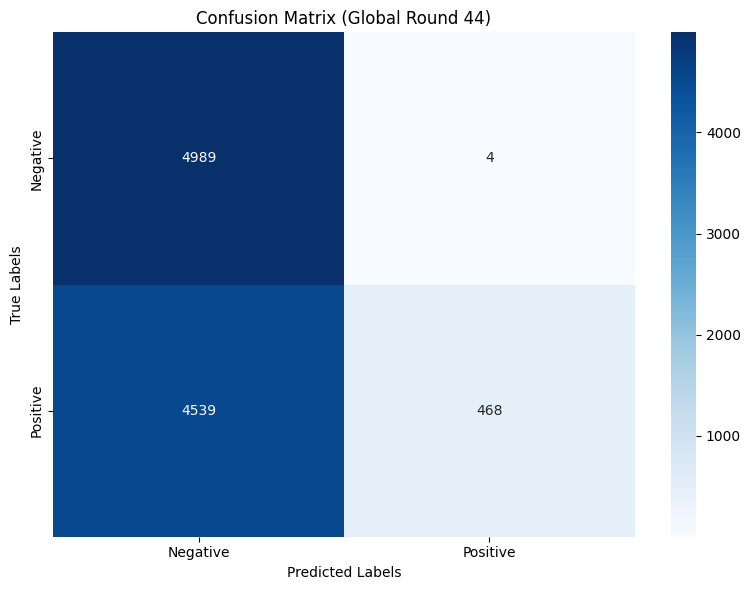


 | Global training round : 45/50 |

Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.1298, Test accuracy: 5531/10000 (55.31%)

Class      - Accuracy
Negative   - 99.9
Positive   - 10.8


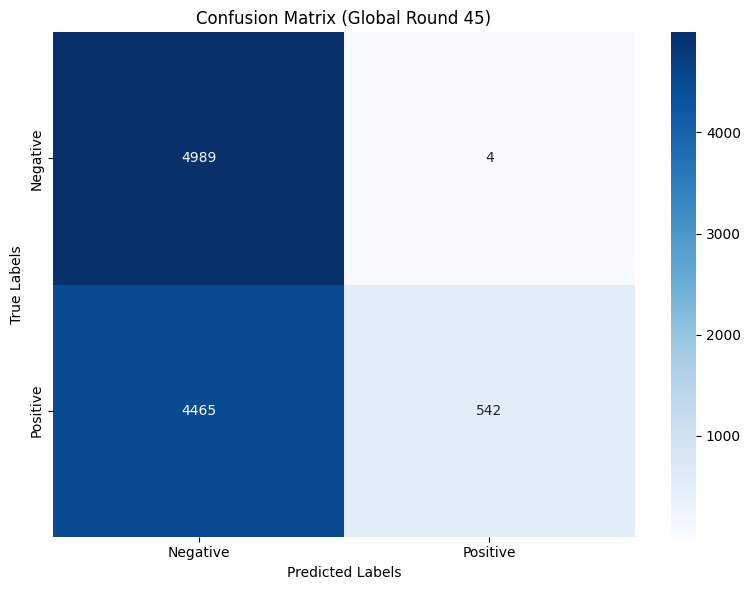


 | Global training round : 46/50 |

Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.0501, Test accuracy: 5668/10000 (56.68%)

Class      - Accuracy
Negative   - 99.9
Positive   - 13.6


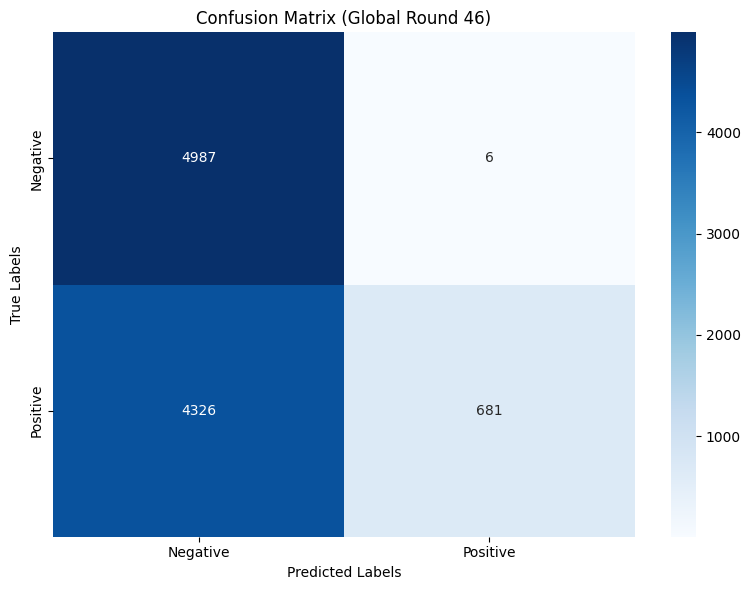


 | Global training round : 47/50 |

Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.3382, Test accuracy: 5438/10000 (54.38%)

Class      - Accuracy
Negative   - 100.0
Positive   - 8.9


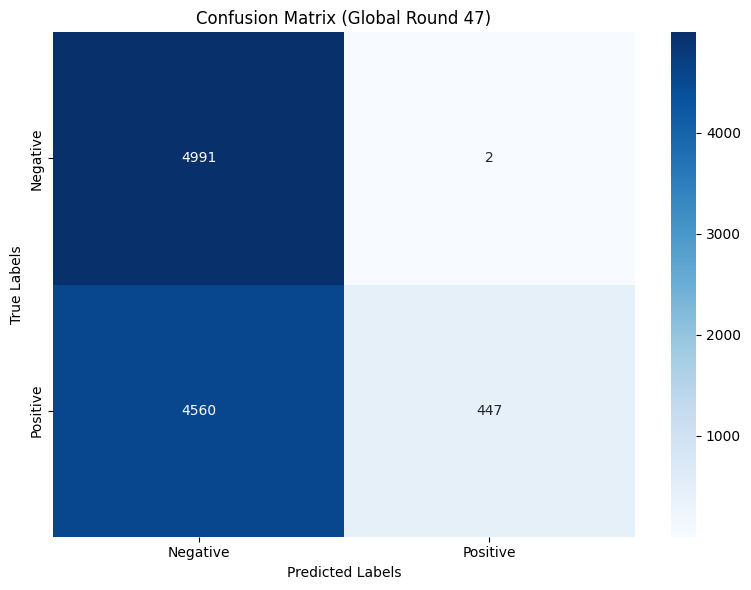


 | Global training round : 48/50 |

Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.1330, Test accuracy: 5609/10000 (56.09%)

Class      - Accuracy
Negative   - 99.9
Positive   - 12.4


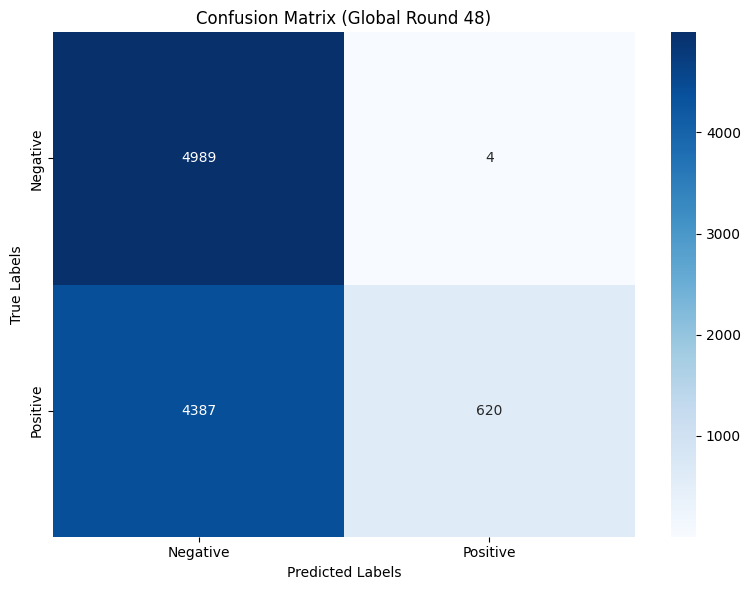


 | Global training round : 49/50 |

Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.1548, Test accuracy: 5536/10000 (55.36%)

Class      - Accuracy
Negative   - 99.9
Positive   - 10.9


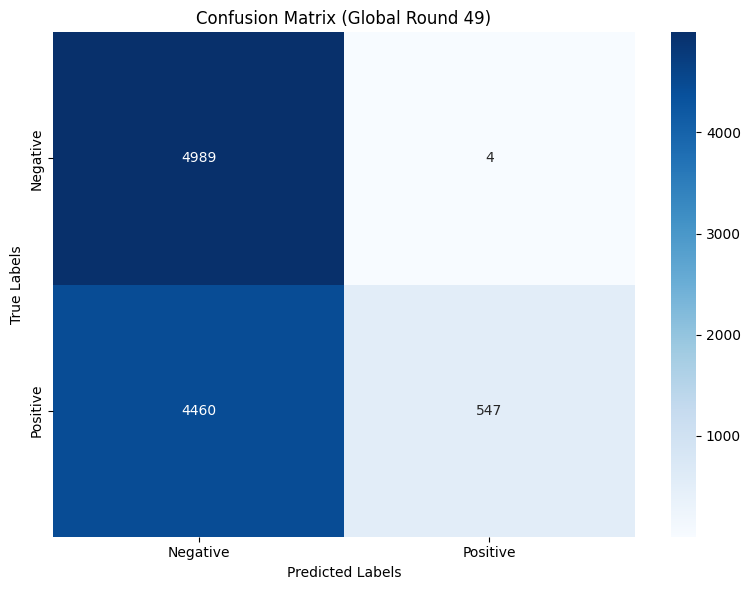


 | Global training round : 50/50 |

Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.1369, Test accuracy: 5529/10000 (55.29%)

Class      - Accuracy
Negative   - 99.9
Positive   - 10.8
Last 10 updates results

Average test loss: 1.1242, Test accuracy: 5563/10000 (55.63%)

***********************************************************************************
Class      - Accuracy
Negative   - 99.9
Positive   - 11.

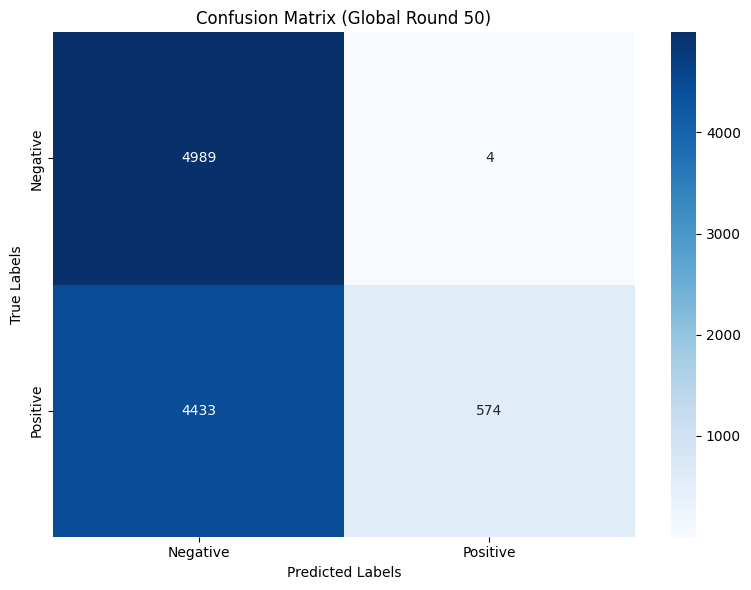

Global accuracies:  [np.float64(49.93), np.float64(49.93), np.float64(49.93), np.float64(49.93), np.float64(49.93), np.float64(49.93), np.float64(49.94), np.float64(50.42), np.float64(49.96), np.float64(51.07), np.float64(49.99), np.float64(51.79), np.float64(50.01), np.float64(52.87), np.float64(50.01), np.float64(52.71), np.float64(50.4), np.float64(52.24), np.float64(50.56), np.float64(52.13), np.float64(50.67), np.float64(52.39), np.float64(51.3), np.float64(52.26), np.float64(51.22), np.float64(52.24), np.float64(50.98), np.float64(52.83), np.float64(51.98), np.float64(53.14), np.float64(52.19), np.float64(53.44), np.float64(53.36), np.float64(53.19), np.float64(53.64), np.float64(53.79), np.float64(53.19), np.float64(54.94), np.float64(53.56), np.float64(53.26), np.float64(55.78), np.float64(53.16), np.float64(55.98), np.float64(54.57), np.float64(55.31), np.float64(56.68), np.float64(54.38), np.float64(56.09), np.float64(55.36), np.float64(55.29), np.float64(55.63)]
Class 1 accu

In [ ]:
RULE = 'robutslfd'
ATTACK_TYPE='label_flipping'
MALICIOUS_BEHAVIOR_RATE = 1
for atr in [0.4]:
    run_exp(dataset_name = DATASET_NAME, model_name = MODEL_NAME, dd_type = DD_TYPE, num_peers = NUM_PEERS,
            frac_peers = FRAC_PEERS, seed = SEED, test_batch_size = TEST_BATCH_SIZE,
                criterion = CRITERION, global_rounds = GLOBAL_ROUNDS, local_epochs = LOCAL_EPOCHS, local_bs = LOCAL_BS,
                    local_lr = LOCAL_LR, local_momentum = LOCAL_MOMENTUM, labels_dict = LABELS_DICT, device = DEVICE,
                attackers_ratio = atr, attack_type=ATTACK_TYPE,
                    malicious_behavior_rate = MALICIOUS_BEHAVIOR_RATE, rule = RULE,
                source_class = SOURCE_CLASS, target_class = TARGET_CLASS,
                class_per_peer = CLASS_PER_PEER, samples_per_class = SAMPLES_PER_CLASS,
                rate_unbalance = RATE_UNBALANCE, alpha = ALPHA, resume = False)

IMDB, IID, 10% attacker

In [ ]:
#=============================== Defining global variables ========================#
DATASET_NAME = "IMDB"
MODEL_NAME = "BiLSTM"
DD_TYPE = 'IID'
ALPHA = 1
NUM_PEERS = 20 # "number of peers: K"
FRAC_PEERS = 1 #'the fraction of peers: C to bel selected in each round'
SEED = 7 #fixed seed
random.seed(SEED)
CRITERION = nn.BCEWithLogitsLoss()
GLOBAL_ROUNDS = 20 #"number of rounds of federated model training"
LOCAL_EPOCHS = 1 #"the number of local epochs: E for each peer"
TEST_BATCH_SIZE = 100
LOCAL_BS = 32 #"local batch size: B for each peer"
LOCAL_LR =  0.001#local learning rate: lr for each peer
LOCAL_MOMENTUM = 0.9 #local momentum for each peer
NUM_CLASSES = 10 # number of classes in an experiment

LABELS_DICT = {'Negative':0,
               'Positive':1}

#select the device to work with cpu or gpu
if torch.cuda.is_available():
    DEVICE = "cuda"
else:
    DEVICE = "cpu"
DEVICE = torch.device(DEVICE)
print(DEVICE)
SOURCE_CLASS = 1 # the source class positive
TARGET_CLASS = 0 # the target class negative

CLASS_PER_PEER = 1
SAMPLES_PER_CLASS = 582
RATE_UNBALANCE = 1

cuda



--> Label FLIP experiment on our algo...
--> Loading of IMDB dataset
--> Dataset has been loaded!
--> Creating BiLSTM model.....
--> Model has been created!
--> Distributing training data among peers
--> Training data have been distributed among peers
--> Creating peets instances
Data set: IMDB
Data distribution: IID
Aggregation rule: robutslfd
Attack Type: label_flipping
Attackers Ratio: 10.0 %
Malicious Behavior Rate: 100 %

===>Simulation started...

====>Global model training started...



  0%|          | 0/20 [00:00<?, ?it/s]


 | Global training round : 1/20 |

Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.6792, Test accuracy: 4993/10000 (49.93%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.0


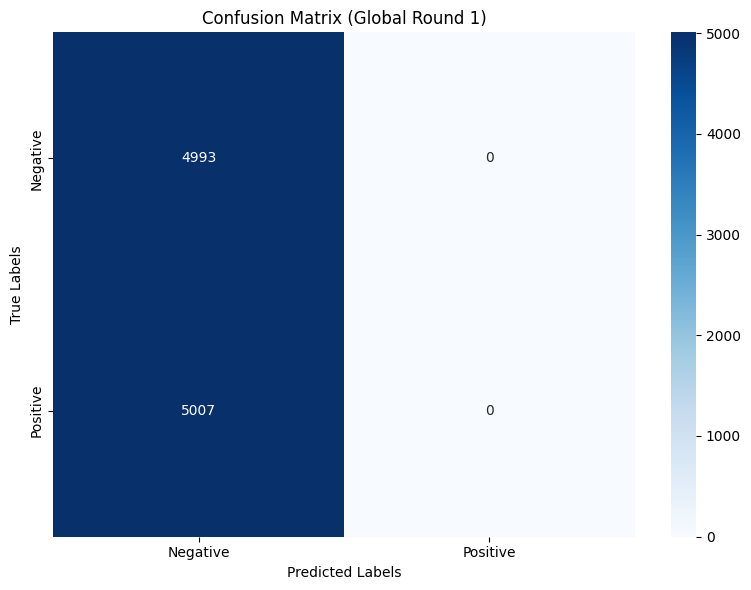


 | Global training round : 2/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.6874, Test accuracy: 5032/10000 (50.32%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.8


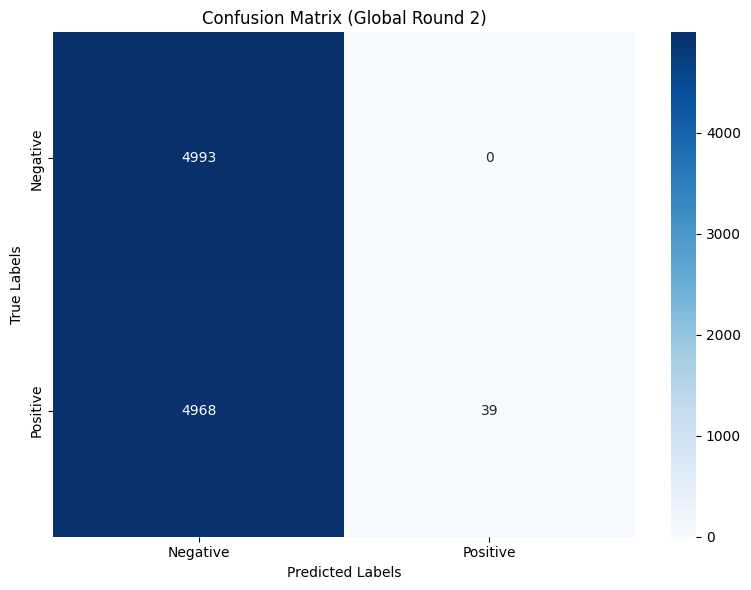


 | Global training round : 3/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.6226, Test accuracy: 5729/10000 (57.29%)

Class      - Accuracy
Negative   - 98.7
Positive   - 16.0


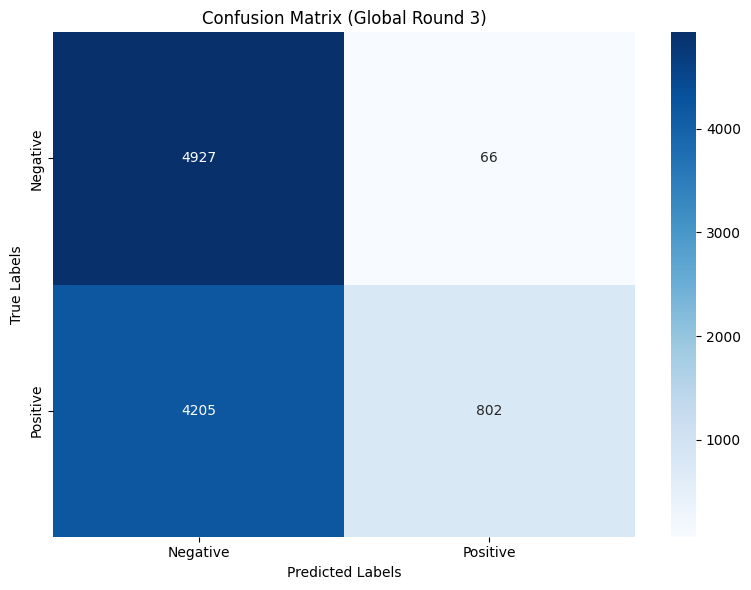


 | Global training round : 4/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.5952, Test accuracy: 6239/10000 (62.39%)

Class      - Accuracy
Negative   - 97.3
Positive   - 27.6


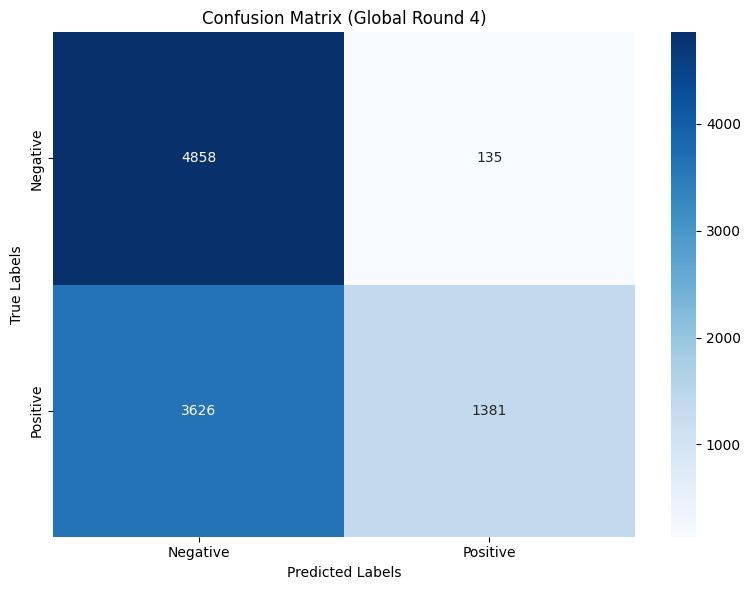


 | Global training round : 5/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.5486, Test accuracy: 6516/10000 (65.16%)

Class      - Accuracy
Negative   - 97.0
Positive   - 33.4


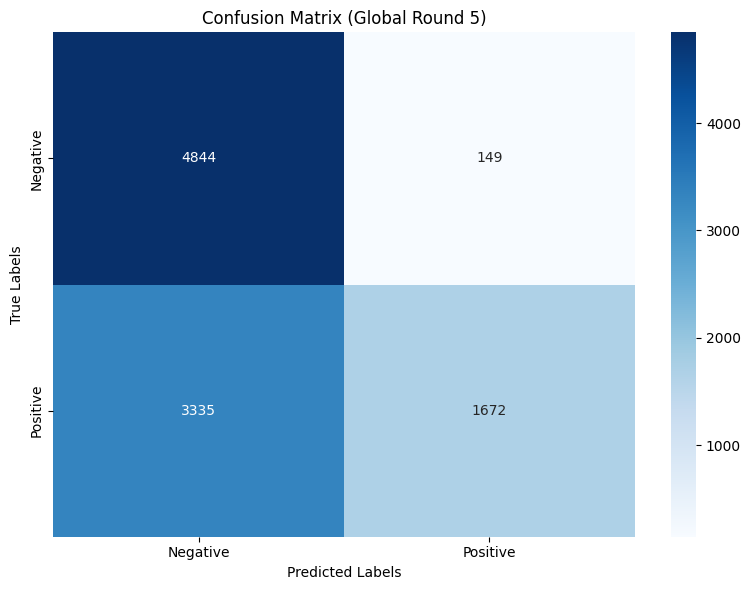


 | Global training round : 6/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.6001, Test accuracy: 6276/10000 (62.76%)

Class      - Accuracy
Negative   - 98.1
Positive   - 27.5


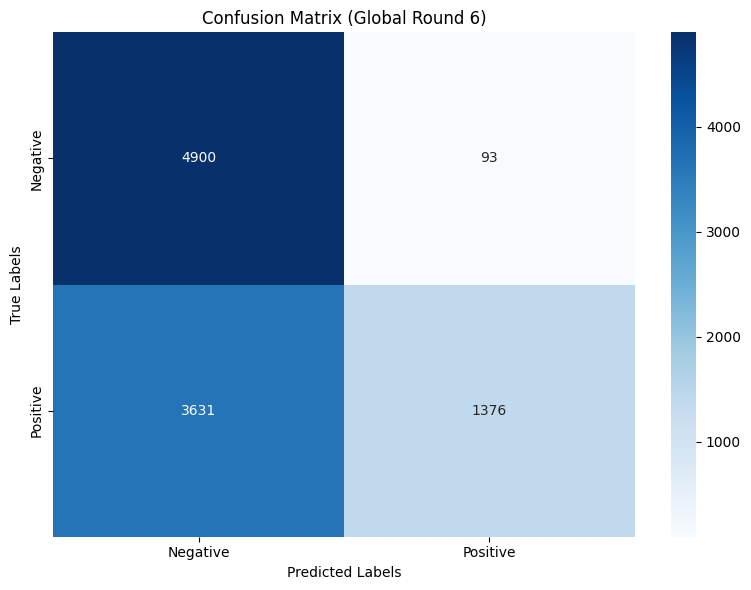


 | Global training round : 7/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.5490, Test accuracy: 6668/10000 (66.68%)

Class      - Accuracy
Negative   - 97.5
Positive   - 36.0


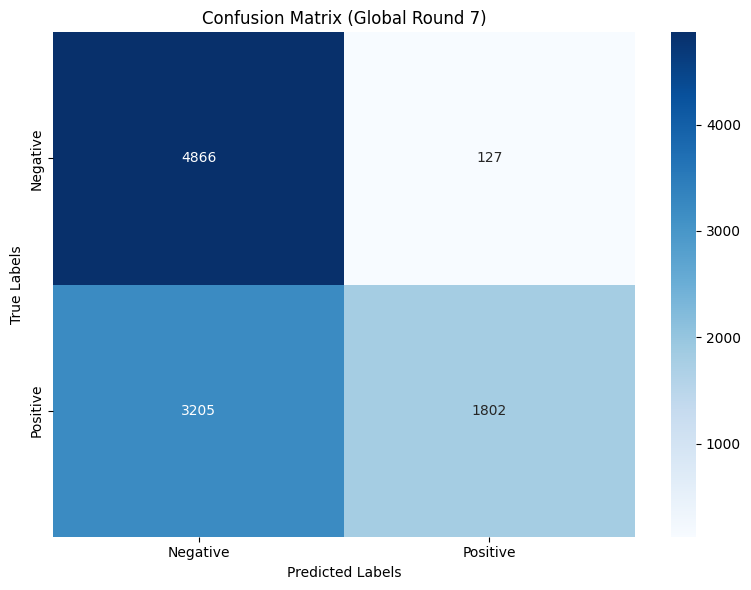


 | Global training round : 8/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.5499, Test accuracy: 6777/10000 (67.77%)

Class      - Accuracy
Negative   - 97.4
Positive   - 38.2


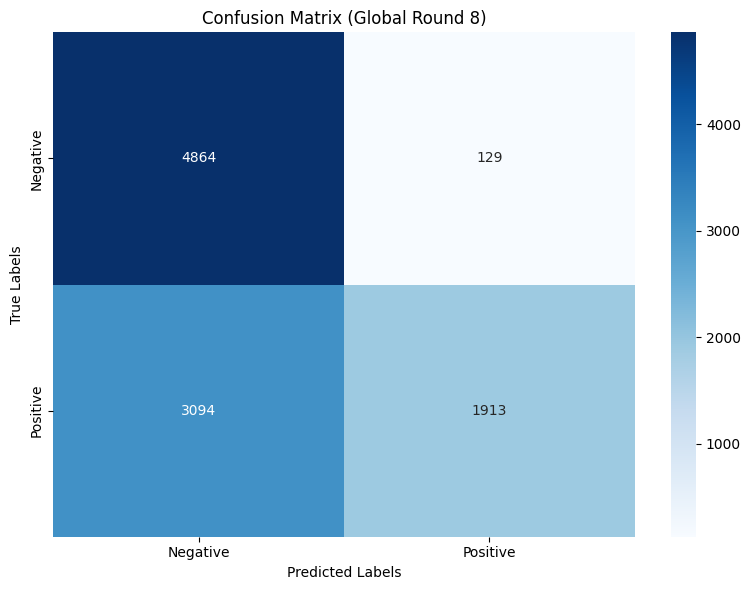


 | Global training round : 9/20 |

Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.5005, Test accuracy: 7048/10000 (70.48%)

Class      - Accuracy
Negative   - 96.8
Positive   - 44.2


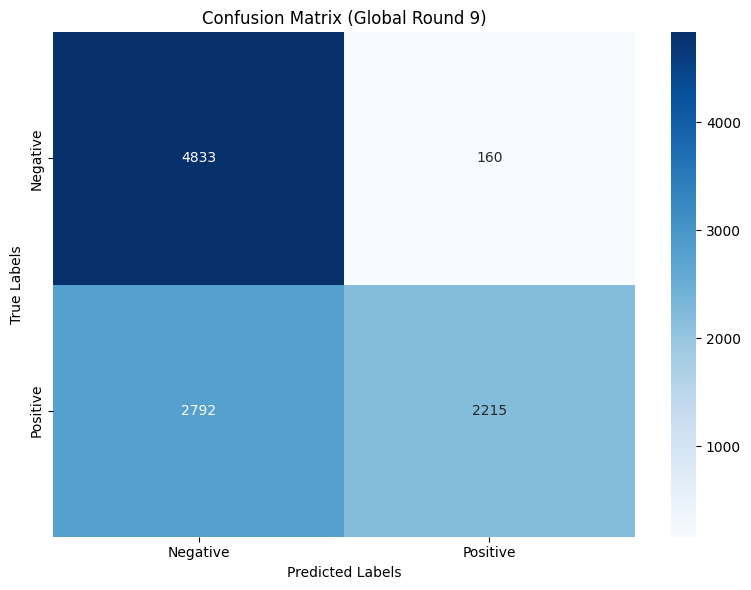


 | Global training round : 10/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.5103, Test accuracy: 7014/10000 (70.14%)

Class      - Accuracy
Negative   - 97.4
Positive   - 42.9


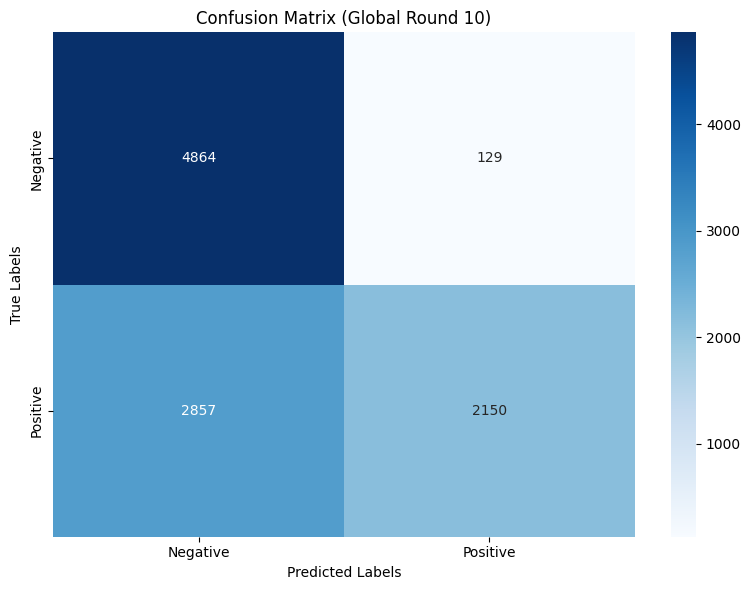


 | Global training round : 11/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.5147, Test accuracy: 6961/10000 (69.61%)

Class      - Accuracy
Negative   - 97.6
Positive   - 41.7


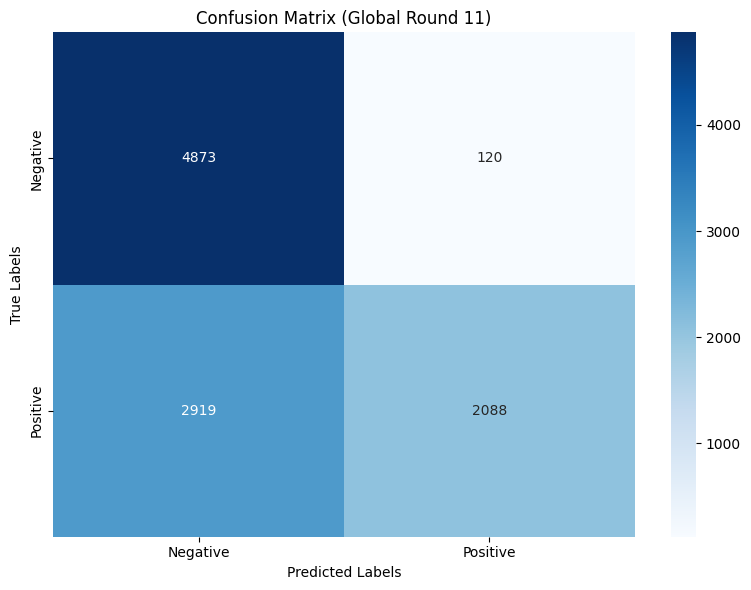


 | Global training round : 12/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.4895, Test accuracy: 7118/10000 (71.18%)

Class      - Accuracy
Negative   - 97.5
Positive   - 44.9


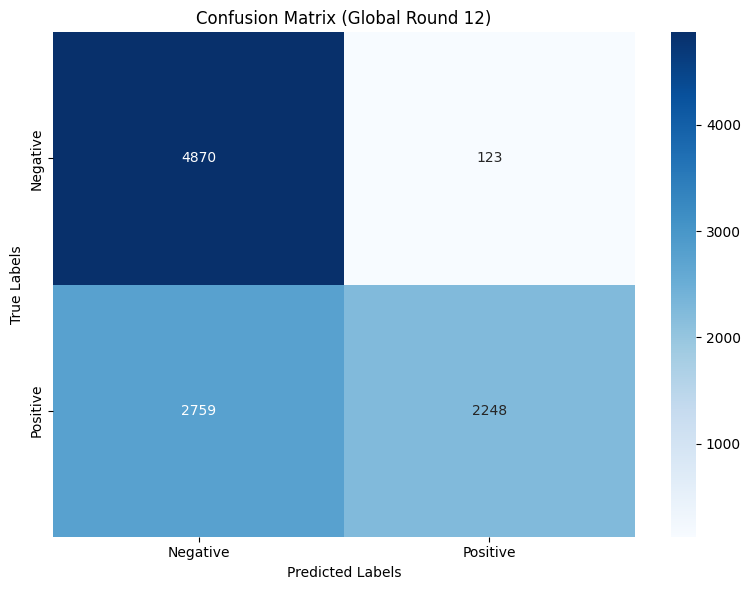


 | Global training round : 13/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.4995, Test accuracy: 7128/10000 (71.28%)

Class      - Accuracy
Negative   - 97.6
Positive   - 45.1


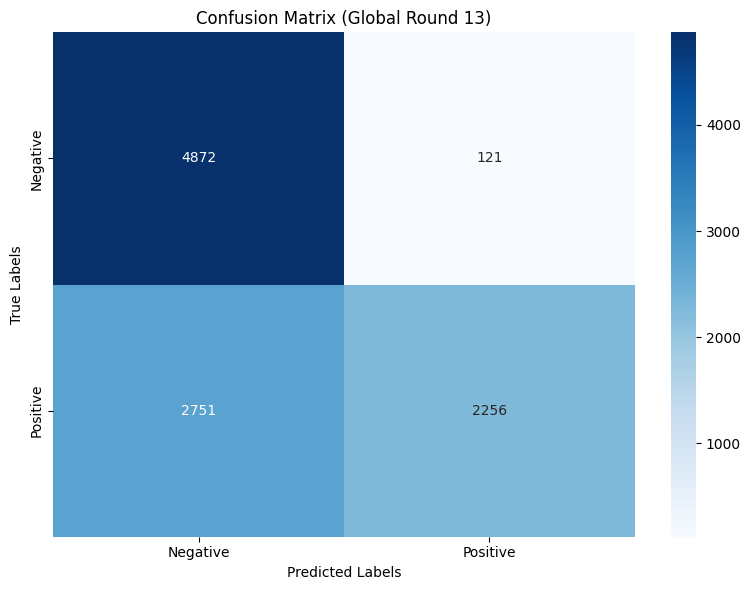


 | Global training round : 14/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.4804, Test accuracy: 7355/10000 (73.55%)

Class      - Accuracy
Negative   - 97.2
Positive   - 50.0


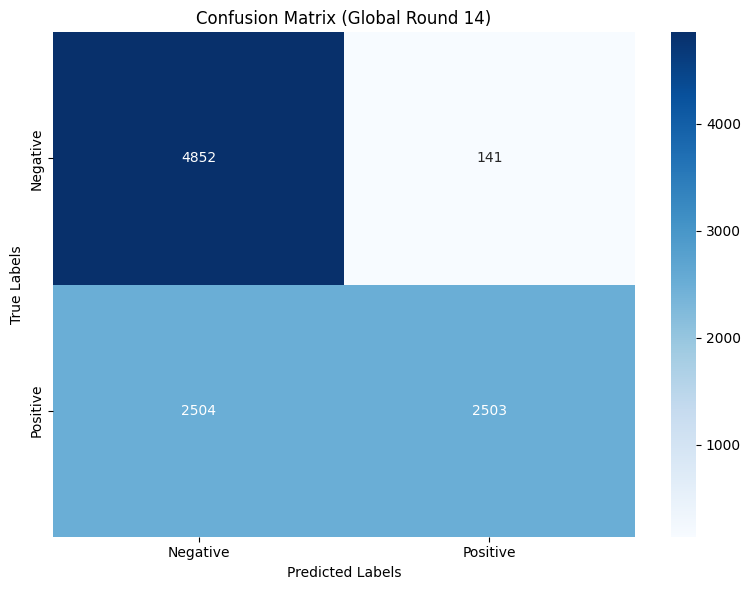


 | Global training round : 15/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.4667, Test accuracy: 7408/10000 (74.08%)

Class      - Accuracy
Negative   - 97.3
Positive   - 50.9


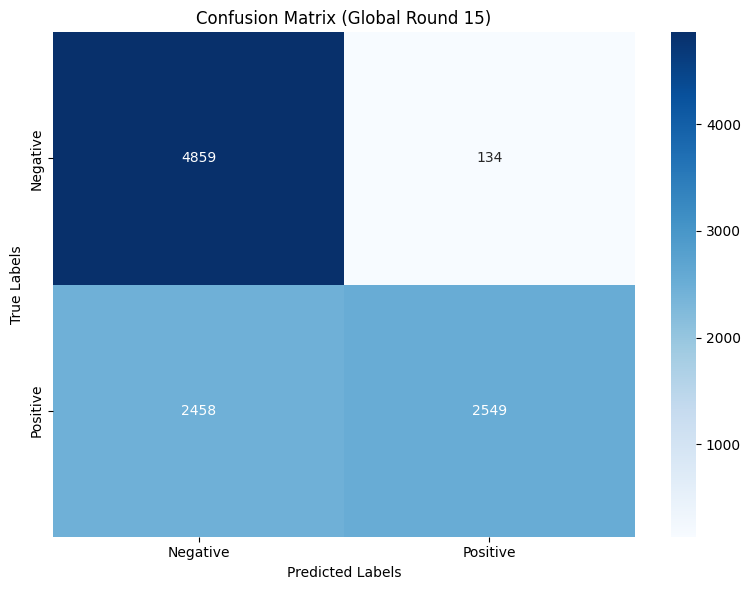


 | Global training round : 16/20 |

Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.4700, Test accuracy: 7355/10000 (73.55%)

Class      - Accuracy
Negative   - 97.5
Positive   - 49.7


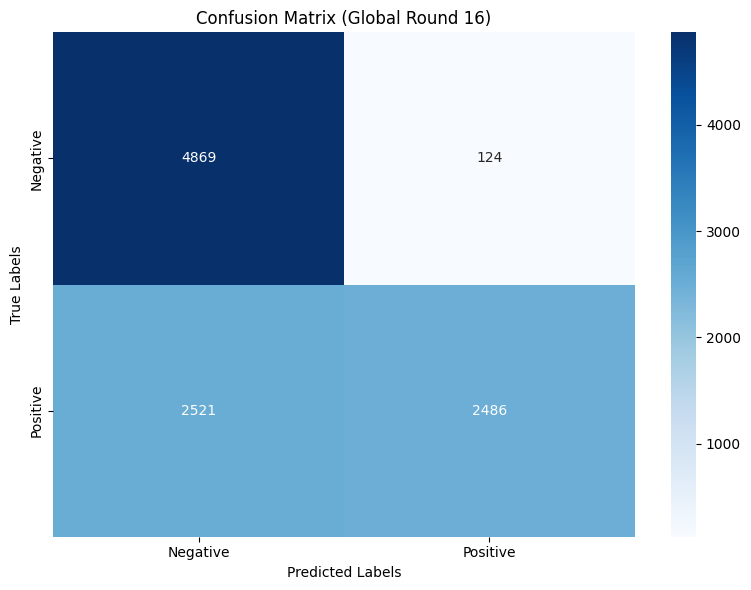


 | Global training round : 17/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.4586, Test accuracy: 7463/10000 (74.63%)

Class      - Accuracy
Negative   - 97.4
Positive   - 51.9


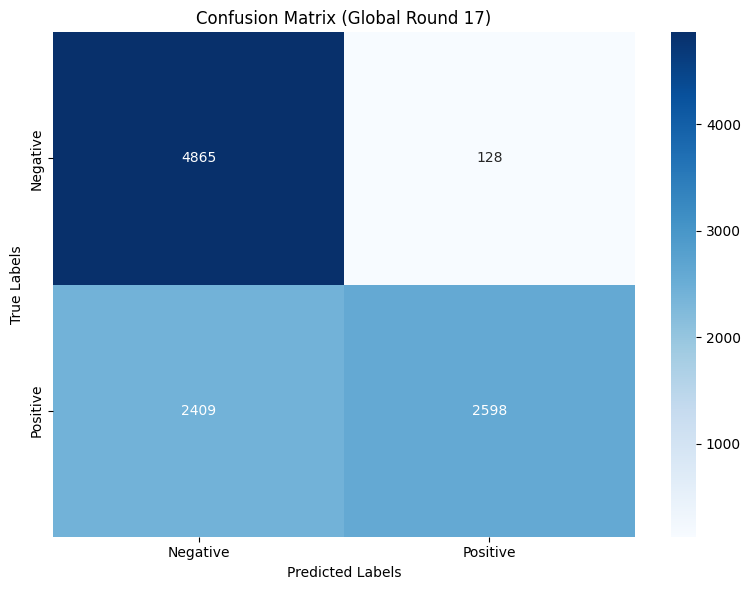


 | Global training round : 18/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.4689, Test accuracy: 7421/10000 (74.21%)

Class      - Accuracy
Negative   - 97.6
Positive   - 50.9


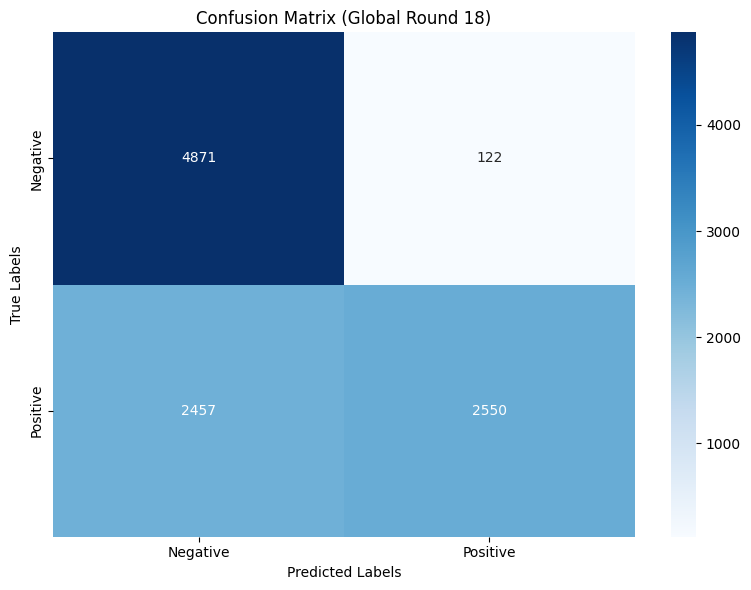


 | Global training round : 19/20 |

Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.4385, Test accuracy: 7580/10000 (75.80%)

Class      - Accuracy
Negative   - 97.4
Positive   - 54.3


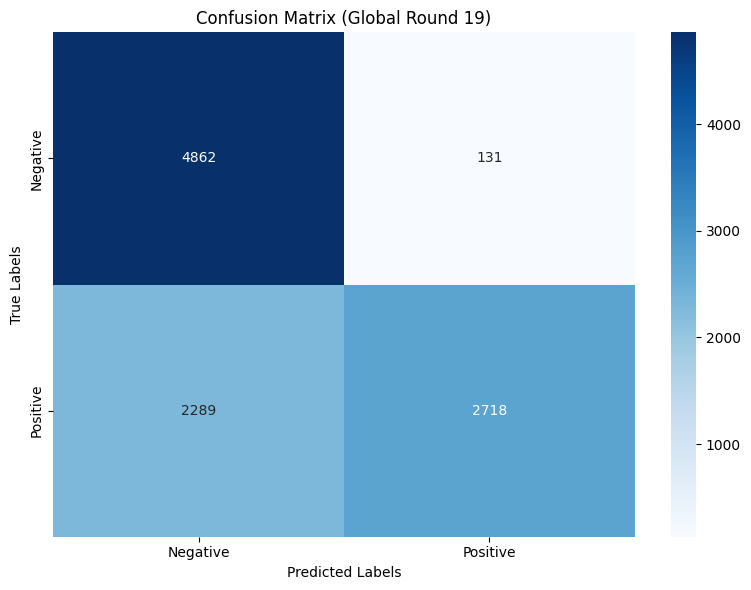


 | Global training round : 20/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.4425, Test accuracy: 7642/10000 (76.42%)

Class      - Accuracy
Negative   - 97.3
Positive   - 55.6
Last 10 updates results

Average test loss: 0.4712, Test accuracy: 7343/10000 (73.43%)

***********************************************************************************
Class      - Accuracy
Negative   - 97.5
Positive   - 49.4


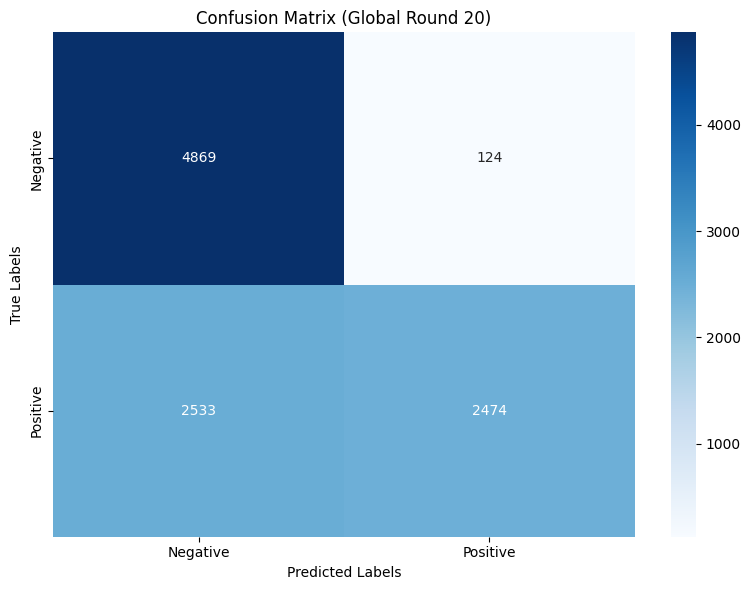

Global accuracies:  [np.float64(49.93), np.float64(50.32), np.float64(57.29), np.float64(62.39), np.float64(65.16), np.float64(62.76), np.float64(66.68), np.float64(67.77), np.float64(70.48), np.float64(70.14), np.float64(69.61), np.float64(71.18), np.float64(71.28), np.float64(73.55), np.float64(74.08), np.float64(73.55), np.float64(74.63), np.float64(74.21), np.float64(75.8), np.float64(76.42), np.float64(73.43)]
Class 1 accuracies:  [np.float64(0.0), np.float64(0.78), np.float64(16.02), np.float64(27.58), np.float64(33.39), np.float64(27.48), np.float64(35.99), np.float64(38.21), np.float64(44.24), np.float64(42.94), np.float64(41.7), np.float64(44.9), np.float64(45.06), np.float64(49.99), np.float64(50.91), np.float64(49.65), np.float64(51.89), np.float64(50.93), np.float64(54.28), np.float64(55.56), np.float64(49.41)]
Test loss: [np.float64(0.6792), np.float64(0.6874), np.float64(0.6226), np.float64(0.5952), np.float64(0.5486), np.float64(0.6001), np.float64(0.549), np.float64(0.5

In [ ]:
RULE = 'robutslfd'
ATTACK_TYPE='label_flipping'
MALICIOUS_BEHAVIOR_RATE = 1
for atr in [0.1]:
    run_exp(dataset_name = DATASET_NAME, model_name = MODEL_NAME, dd_type = DD_TYPE, num_peers = NUM_PEERS,
            frac_peers = FRAC_PEERS, seed = SEED, test_batch_size = TEST_BATCH_SIZE,
                criterion = CRITERION, global_rounds = GLOBAL_ROUNDS, local_epochs = LOCAL_EPOCHS, local_bs = LOCAL_BS,
                    local_lr = LOCAL_LR, local_momentum = LOCAL_MOMENTUM, labels_dict = LABELS_DICT, device = DEVICE,
                attackers_ratio = atr, attack_type=ATTACK_TYPE,
                    malicious_behavior_rate = MALICIOUS_BEHAVIOR_RATE, rule = RULE,
                source_class = SOURCE_CLASS, target_class = TARGET_CLASS,
                class_per_peer = CLASS_PER_PEER, samples_per_class = SAMPLES_PER_CLASS,
                rate_unbalance = RATE_UNBALANCE, alpha = ALPHA, resume = False)


--> Label FLIP experiment on our algo...
--> Loading of IMDB dataset
--> Dataset has been loaded!
--> Creating BiLSTM model.....
--> Model has been created!
--> Distributing training data among peers
--> Training data have been distributed among peers
--> Creating peets instances
Data set: IMDB
Data distribution: IID
Aggregation rule: robutslfd
Attack Type: label_flipping
Attackers Ratio: 20.0 %
Malicious Behavior Rate: 100 %

===>Simulation started...

====>Global model training started...



  0%|          | 0/20 [00:00<?, ?it/s]


 | Global training round : 1/20 |

Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.7509, Test accuracy: 4993/10000 (49.93%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.0


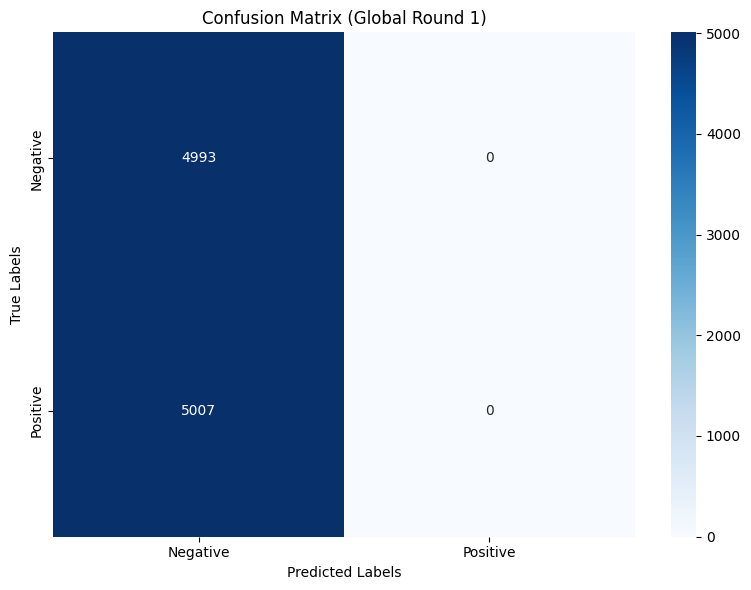


 | Global training round : 2/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.7762, Test accuracy: 4993/10000 (49.93%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.0


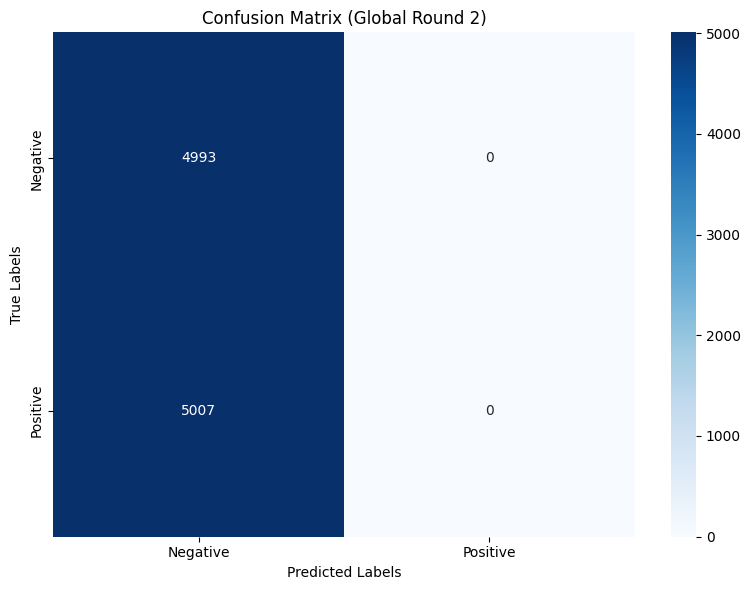


 | Global training round : 3/20 |

Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.1139, Test accuracy: 5015/10000 (50.15%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.4


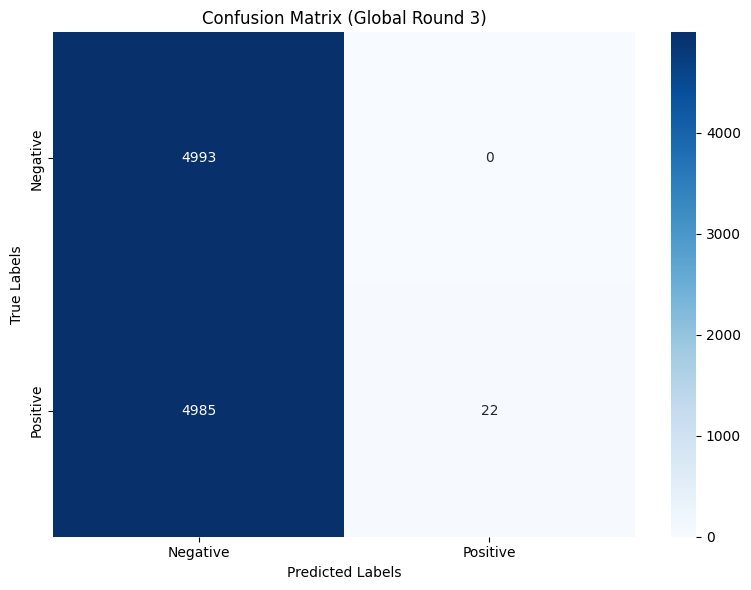


 | Global training round : 4/20 |

Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.6498, Test accuracy: 5356/10000 (53.56%)

Class      - Accuracy
Negative   - 99.7
Positive   - 7.5


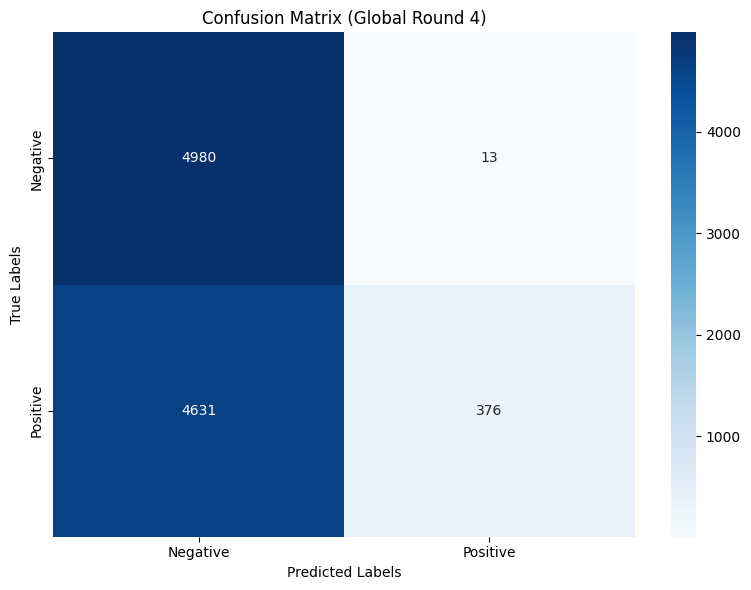


 | Global training round : 5/20 |

Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.0302, Test accuracy: 5191/10000 (51.91%)

Class      - Accuracy
Negative   - 99.9
Positive   - 4.1


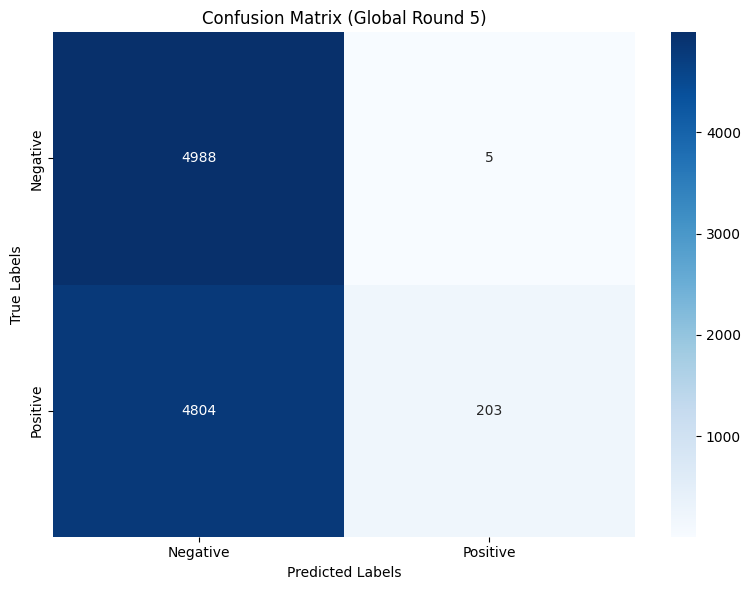


 | Global training round : 6/20 |

Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.7580, Test accuracy: 5501/10000 (55.01%)

Class      - Accuracy
Negative   - 99.7
Positive   - 10.4


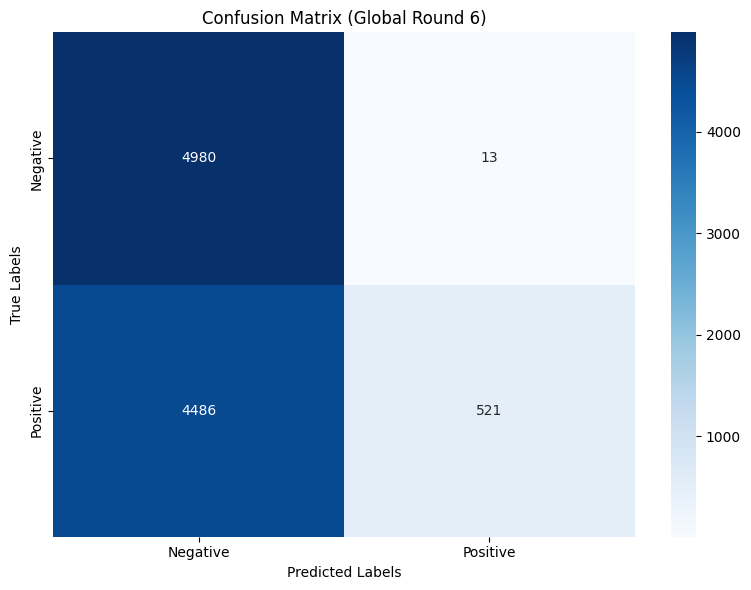


 | Global training round : 7/20 |

Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.8790, Test accuracy: 5445/10000 (54.45%)

Class      - Accuracy
Negative   - 99.8
Positive   - 9.2


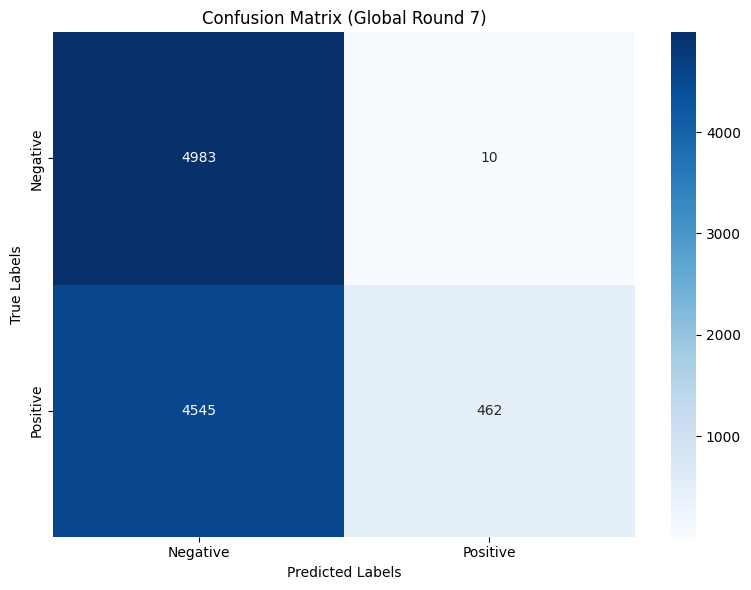


 | Global training round : 8/20 |

Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.8745, Test accuracy: 5577/10000 (55.77%)

Class      - Accuracy
Negative   - 99.7
Positive   - 11.9


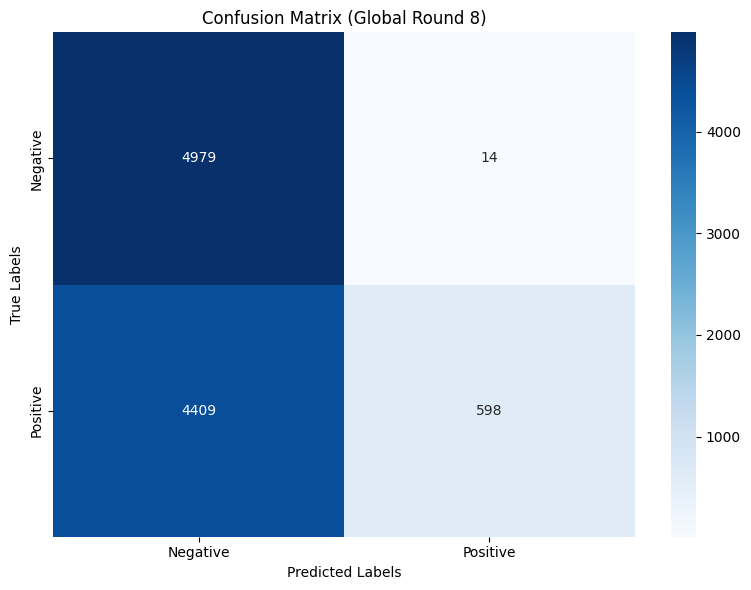


 | Global training round : 9/20 |

Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.8736, Test accuracy: 5657/10000 (56.57%)

Class      - Accuracy
Negative   - 99.7
Positive   - 13.5


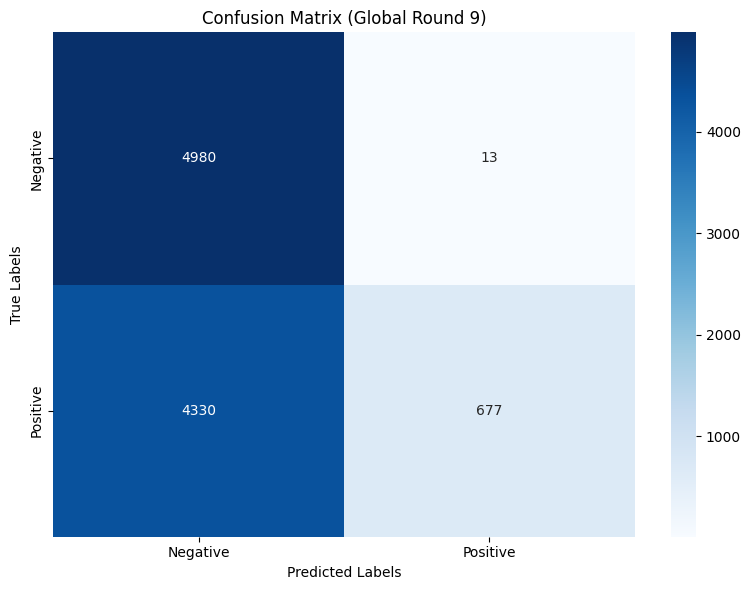


 | Global training round : 10/20 |

Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.8480, Test accuracy: 5733/10000 (57.33%)

Class      - Accuracy
Negative   - 99.7
Positive   - 15.1


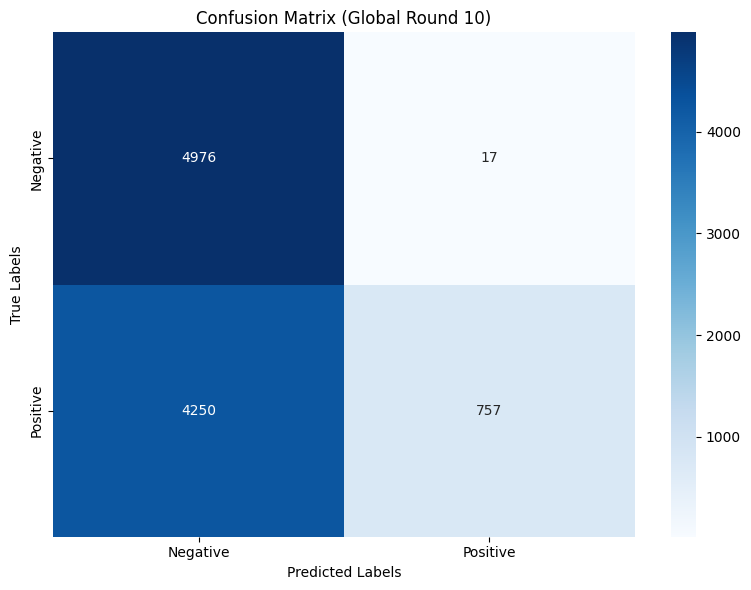


 | Global training round : 11/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.8068, Test accuracy: 5932/10000 (59.32%)

Class      - Accuracy
Negative   - 99.4
Positive   - 19.3


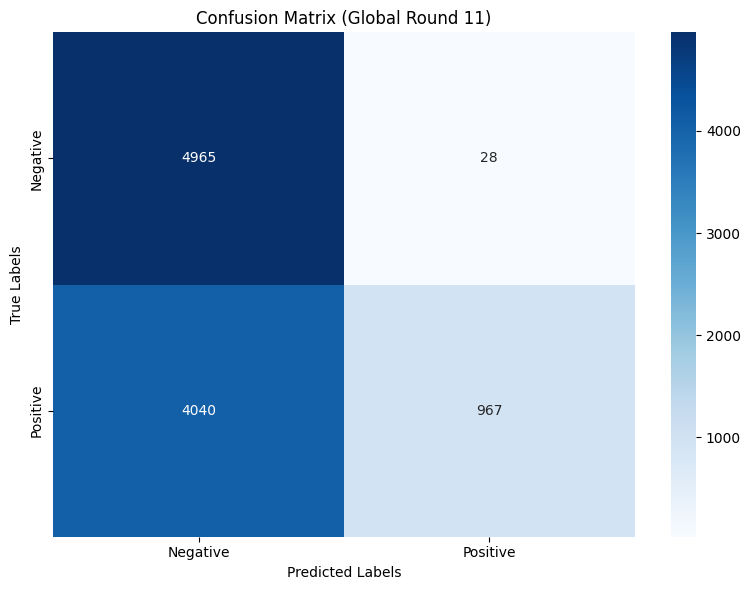


 | Global training round : 12/20 |

Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.7569, Test accuracy: 5953/10000 (59.53%)

Class      - Accuracy
Negative   - 99.5
Positive   - 19.7


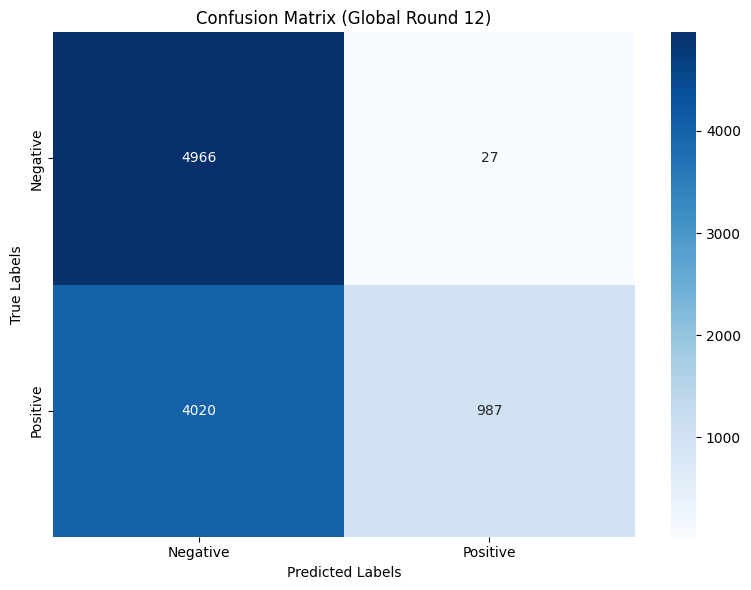


 | Global training round : 13/20 |

Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.7512, Test accuracy: 6118/10000 (61.18%)

Class      - Accuracy
Negative   - 99.3
Positive   - 23.2


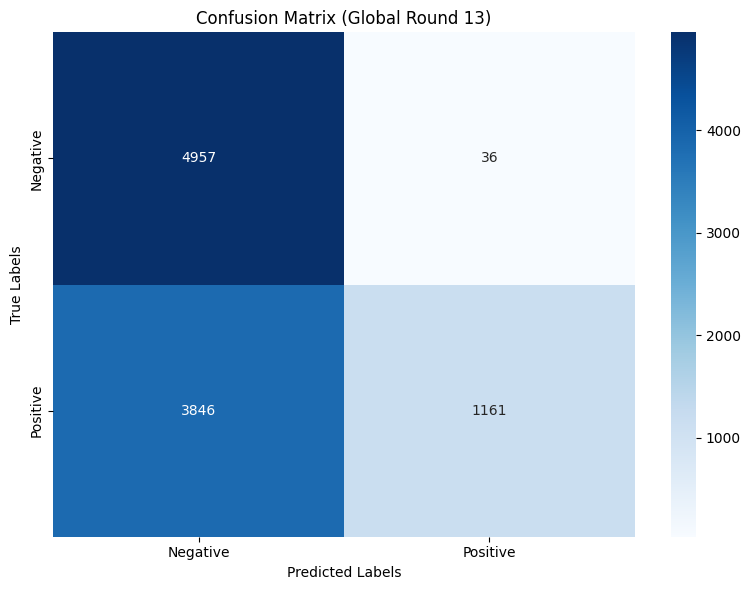


 | Global training round : 14/20 |

Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.7723, Test accuracy: 6081/10000 (60.81%)

Class      - Accuracy
Negative   - 99.4
Positive   - 22.3


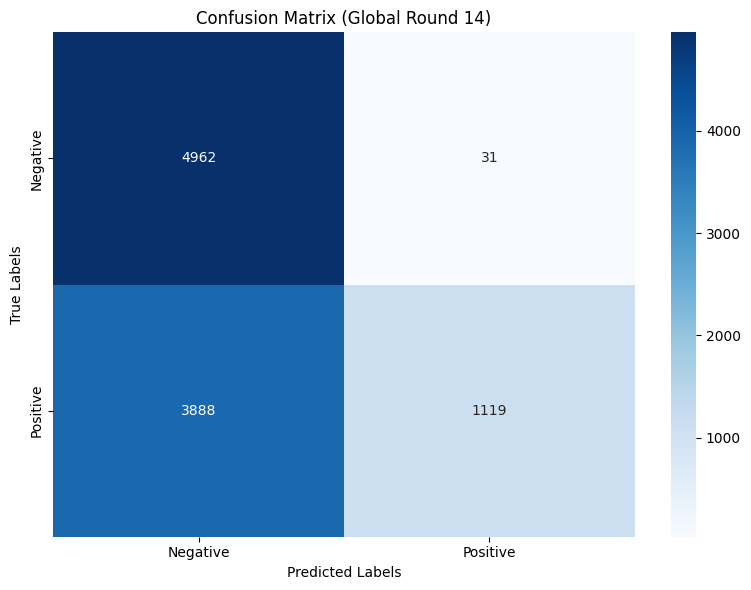


 | Global training round : 15/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.7913, Test accuracy: 6076/10000 (60.76%)

Class      - Accuracy
Negative   - 99.4
Positive   - 22.2


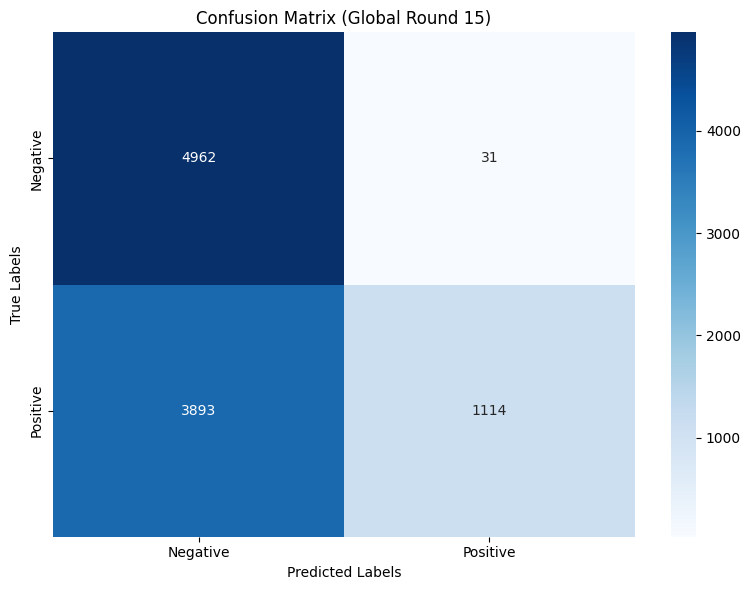


 | Global training round : 16/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.7698, Test accuracy: 6191/10000 (61.91%)

Class      - Accuracy
Negative   - 99.4
Positive   - 24.6


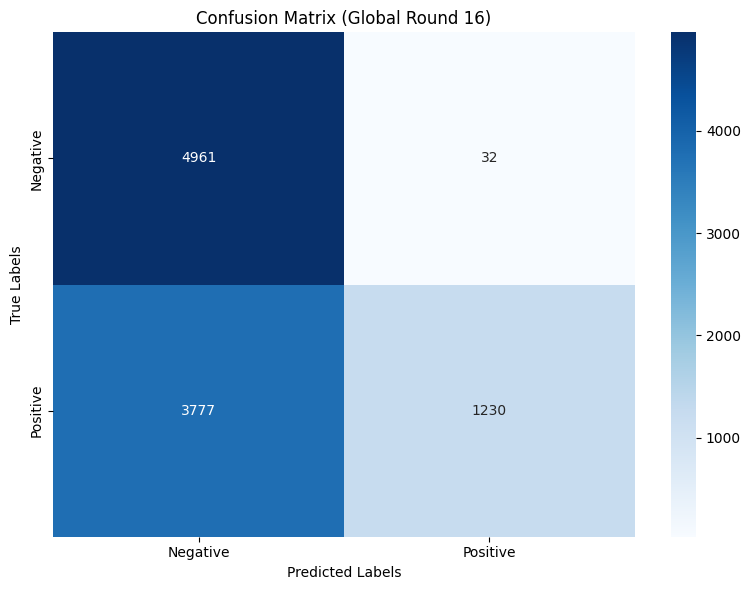


 | Global training round : 17/20 |

Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.7143, Test accuracy: 6402/10000 (64.02%)

Class      - Accuracy
Negative   - 99.2
Positive   - 28.9


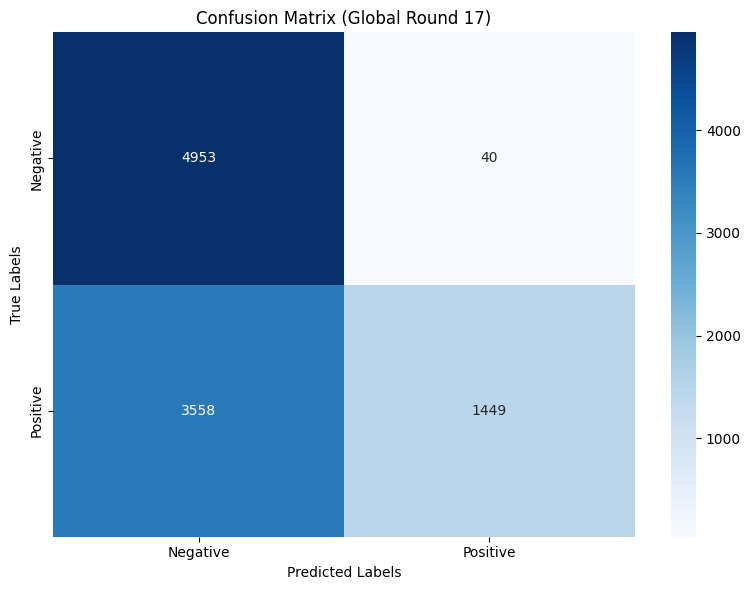


 | Global training round : 18/20 |

Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.7609, Test accuracy: 6349/10000 (63.49%)

Class      - Accuracy
Negative   - 99.3
Positive   - 27.8


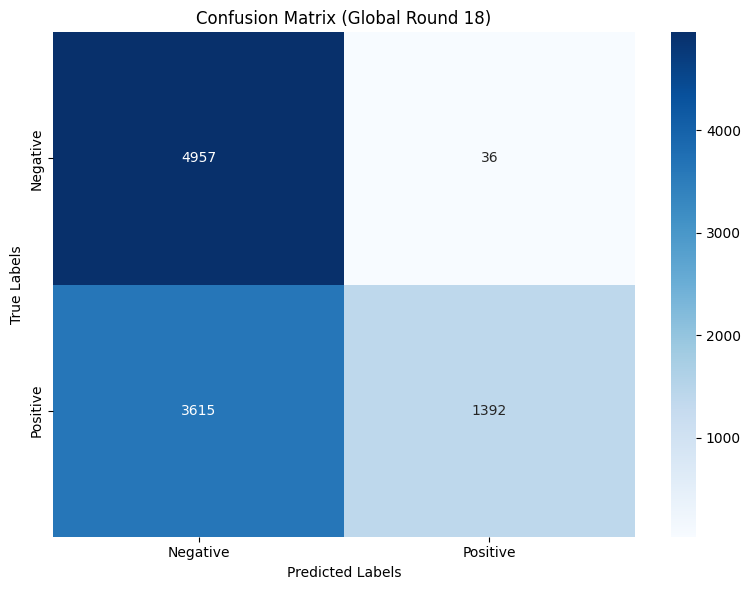


 | Global training round : 19/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.7301, Test accuracy: 6405/10000 (64.05%)

Class      - Accuracy
Negative   - 99.3
Positive   - 28.9


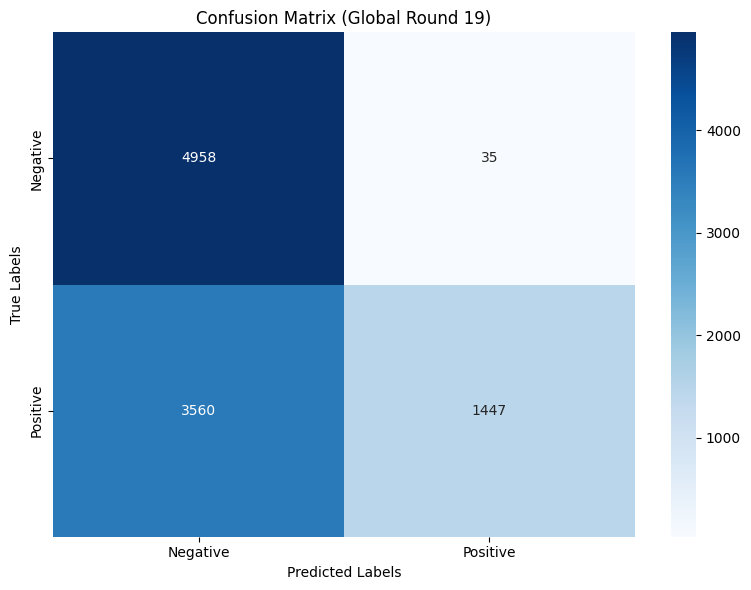


 | Global training round : 20/20 |

Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.7636, Test accuracy: 6339/10000 (63.39%)

Class      - Accuracy
Negative   - 99.4
Positive   - 27.5
Last 10 updates results

Average test loss: 0.7584, Test accuracy: 6172/10000 (61.72%)

***********************************************************************************
Class      - Accuracy
Negative   - 99.4
Positive   - 24.2


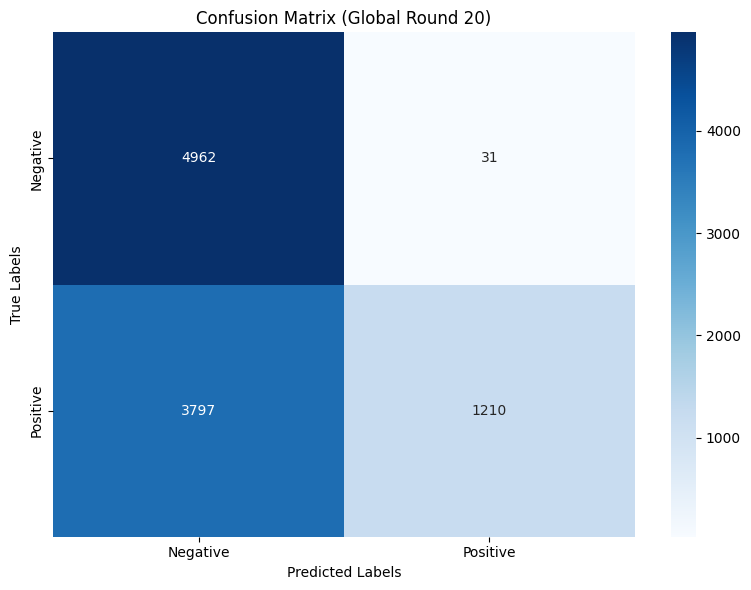

Global accuracies:  [np.float64(49.93), np.float64(49.93), np.float64(50.15), np.float64(53.56), np.float64(51.91), np.float64(55.01), np.float64(54.45), np.float64(55.77), np.float64(56.57), np.float64(57.33), np.float64(59.32), np.float64(59.53), np.float64(61.18), np.float64(60.81), np.float64(60.76), np.float64(61.91), np.float64(64.02), np.float64(63.49), np.float64(64.05), np.float64(63.39), np.float64(61.72)]
Class 1 accuracies:  [np.float64(0.0), np.float64(0.0), np.float64(0.44), np.float64(7.51), np.float64(4.05), np.float64(10.41), np.float64(9.23), np.float64(11.94), np.float64(13.52), np.float64(15.12), np.float64(19.31), np.float64(19.71), np.float64(23.19), np.float64(22.35), np.float64(22.25), np.float64(24.57), np.float64(28.94), np.float64(27.8), np.float64(28.9), np.float64(27.5), np.float64(24.17)]
Test loss: [np.float64(0.7509), np.float64(0.7762), np.float64(1.1139), np.float64(0.6498), np.float64(1.0302), np.float64(0.758), np.float64(0.879), np.float64(0.8745), 

In [ ]:
RULE = 'robutslfd'
ATTACK_TYPE='label_flipping'
MALICIOUS_BEHAVIOR_RATE = 1
for atr in [0.2]:
    run_exp(dataset_name = DATASET_NAME, model_name = MODEL_NAME, dd_type = DD_TYPE, num_peers = NUM_PEERS,
            frac_peers = FRAC_PEERS, seed = SEED, test_batch_size = TEST_BATCH_SIZE,
                criterion = CRITERION, global_rounds = GLOBAL_ROUNDS, local_epochs = LOCAL_EPOCHS, local_bs = LOCAL_BS,
                    local_lr = LOCAL_LR, local_momentum = LOCAL_MOMENTUM, labels_dict = LABELS_DICT, device = DEVICE,
                attackers_ratio = atr, attack_type=ATTACK_TYPE,
                    malicious_behavior_rate = MALICIOUS_BEHAVIOR_RATE, rule = RULE,
                source_class = SOURCE_CLASS, target_class = TARGET_CLASS,
                class_per_peer = CLASS_PER_PEER, samples_per_class = SAMPLES_PER_CLASS,
                rate_unbalance = RATE_UNBALANCE, alpha = ALPHA, resume = False)

IMDB, IDD, 30% attacker

In [ ]:
#=============================== Defining global variables ========================#
DATASET_NAME = "IMDB"
MODEL_NAME = "BiLSTM"
DD_TYPE = 'IID'
ALPHA = 1
NUM_PEERS = 20 # "number of peers: K"
FRAC_PEERS = 1 #'the fraction of peers: C to bel selected in each round'
SEED = 7 #fixed seed
random.seed(SEED)
CRITERION = nn.BCEWithLogitsLoss()
GLOBAL_ROUNDS = 20 #"number of rounds of federated model training"
LOCAL_EPOCHS = 1 #"the number of local epochs: E for each peer"
TEST_BATCH_SIZE = 100
LOCAL_BS = 32 #"local batch size: B for each peer"
LOCAL_LR =  0.001#local learning rate: lr for each peer
LOCAL_MOMENTUM = 0.9 #local momentum for each peer
NUM_CLASSES = 10 # number of classes in an experiment

LABELS_DICT = {'Negative':0,
               'Positive':1}

#select the device to work with cpu or gpu
if torch.cuda.is_available():
    DEVICE = "cuda"
else:
    DEVICE = "cpu"
DEVICE = torch.device(DEVICE)
print(DEVICE)
SOURCE_CLASS = 1 # the source class positive
TARGET_CLASS = 0 # the target class negative

CLASS_PER_PEER = 1
SAMPLES_PER_CLASS = 582
RATE_UNBALANCE = 1

cuda



--> Label FLIP experiment on our algo...
--> Loading of IMDB dataset
--> Dataset has been loaded!
--> Creating BiLSTM model.....
--> Model has been created!
--> Distributing training data among peers
--> Training data have been distributed among peers
--> Creating peets instances
Data set: IMDB
Data distribution: IID
Aggregation rule: robutslfd
Attack Type: label_flipping
Attackers Ratio: 30.0 %
Malicious Behavior Rate: 100 %

===>Simulation started...

====>Global model training started...



  0%|          | 0/20 [00:00<?, ?it/s]


 | Global training round : 1/20 |

Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.9005, Test accuracy: 4993/10000 (49.93%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.0


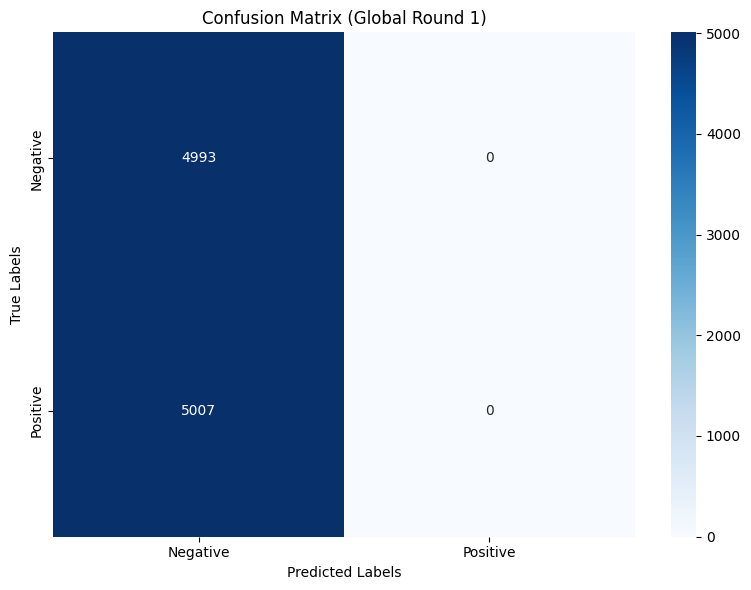


 | Global training round : 2/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.8288, Test accuracy: 4993/10000 (49.93%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.0


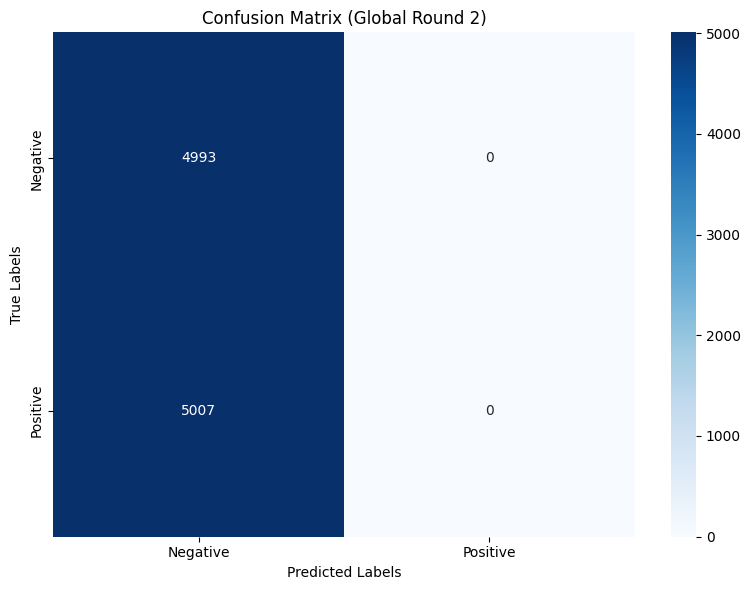


 | Global training round : 3/20 |

Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.9658, Test accuracy: 4993/10000 (49.93%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.0


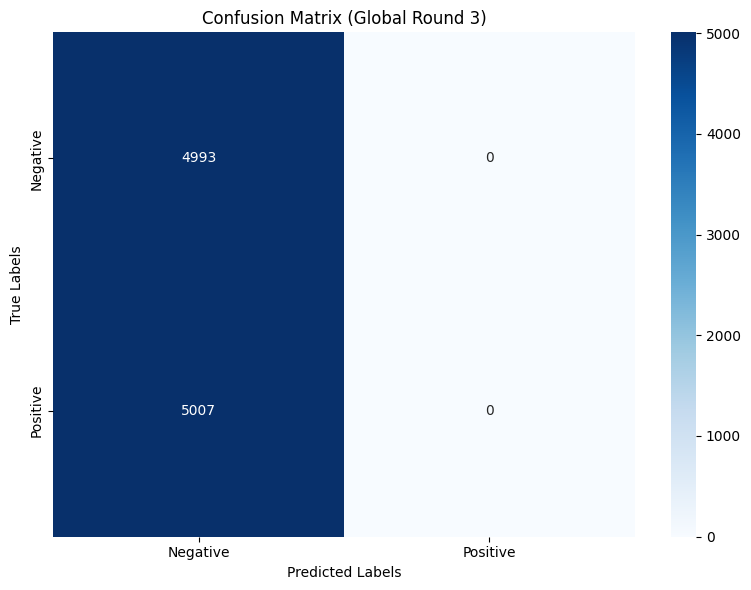


 | Global training round : 4/20 |

Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.8372, Test accuracy: 4993/10000 (49.93%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.0


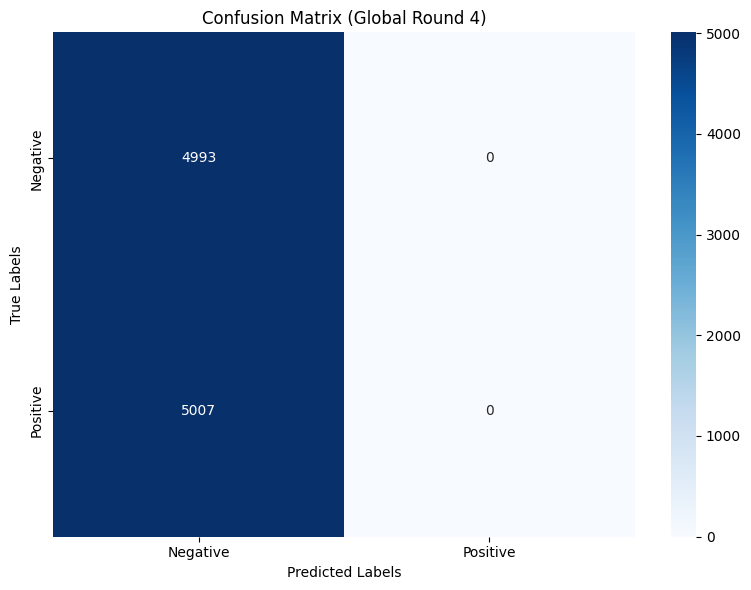


 | Global training round : 5/20 |

Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.5321, Test accuracy: 5004/10000 (50.04%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.2


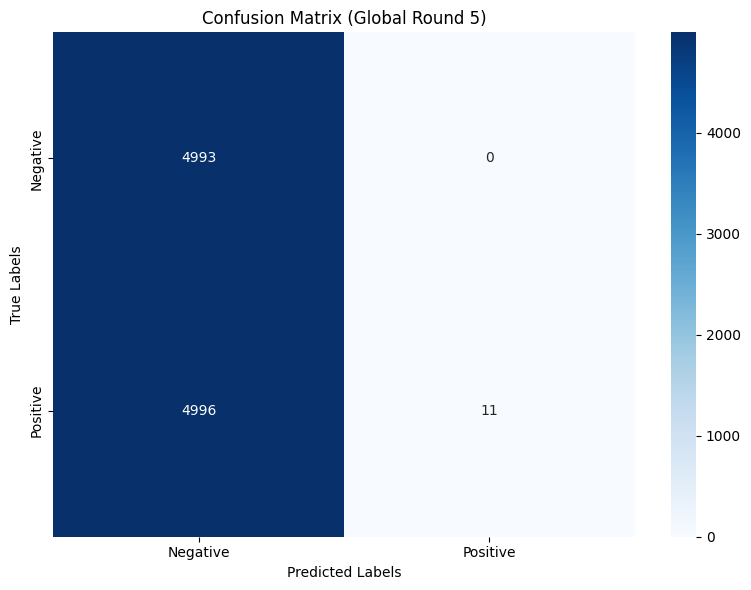


 | Global training round : 6/20 |

Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.7487, Test accuracy: 5145/10000 (51.45%)

Class      - Accuracy
Negative   - 100.0
Positive   - 3.1


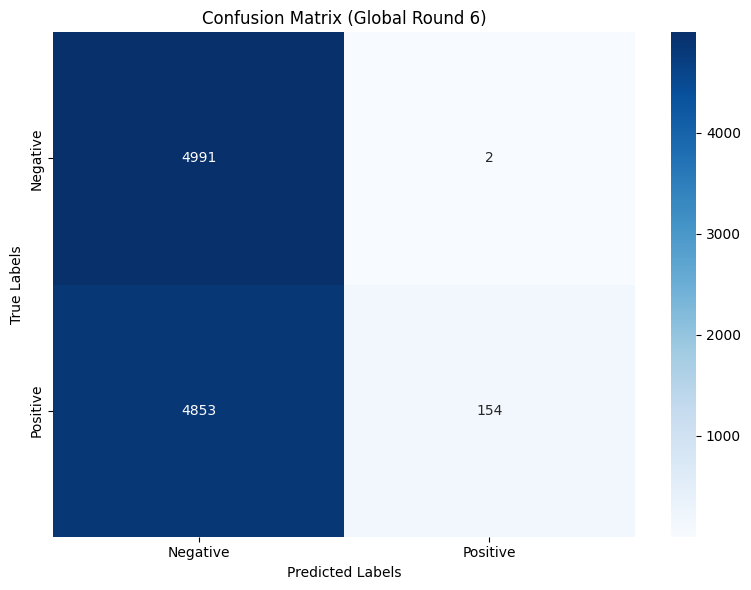


 | Global training round : 7/20 |

Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.8547, Test accuracy: 5024/10000 (50.24%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.6


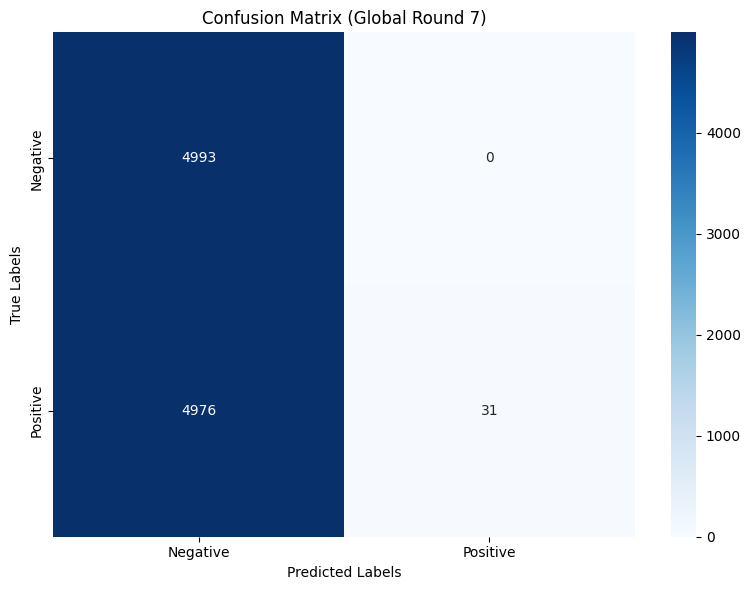


 | Global training round : 8/20 |

Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.7718, Test accuracy: 5274/10000 (52.74%)

Class      - Accuracy
Negative   - 99.9
Positive   - 5.7


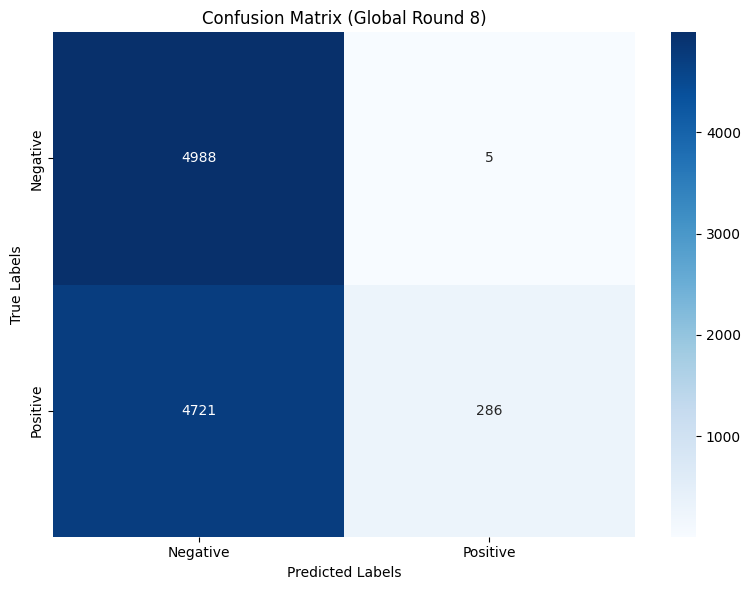


 | Global training round : 9/20 |

Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.8125, Test accuracy: 5059/10000 (50.59%)

Class      - Accuracy
Negative   - 100.0
Positive   - 1.3


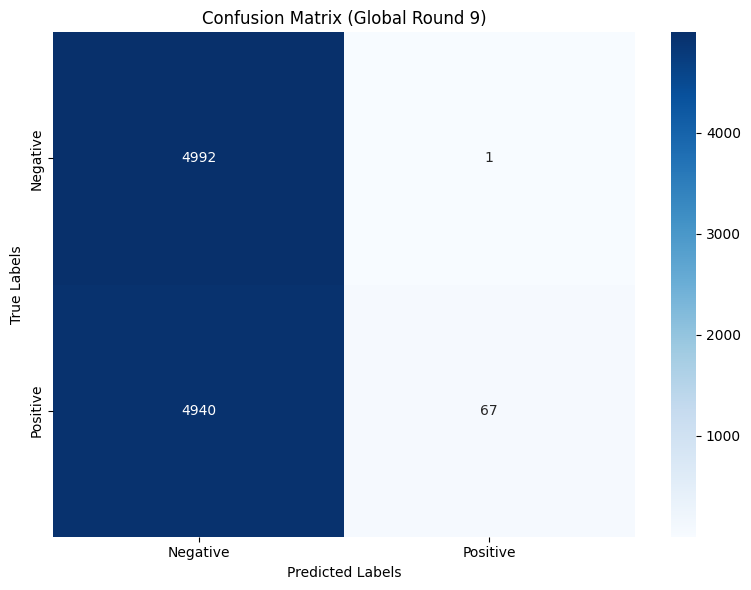


 | Global training round : 10/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.7602, Test accuracy: 5392/10000 (53.92%)

Class      - Accuracy
Negative   - 99.9
Positive   - 8.1


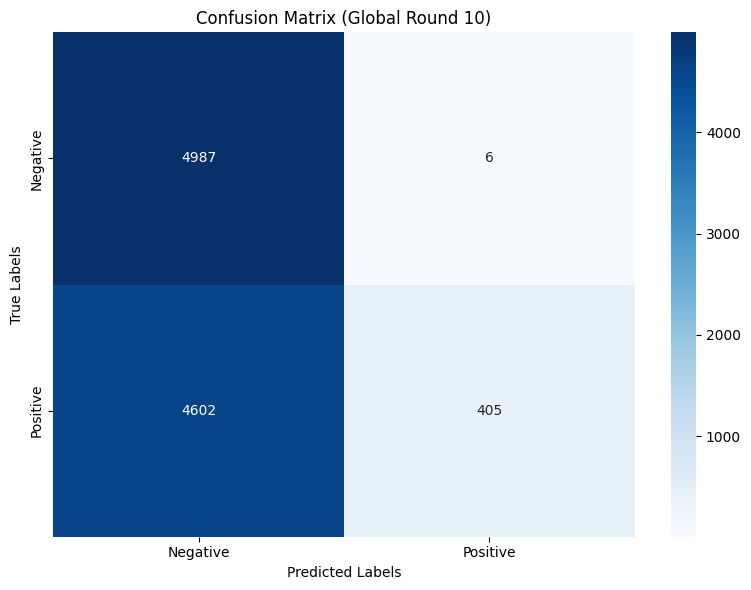


 | Global training round : 11/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.5141, Test accuracy: 5050/10000 (50.50%)

Class      - Accuracy
Negative   - 100.0
Positive   - 1.2


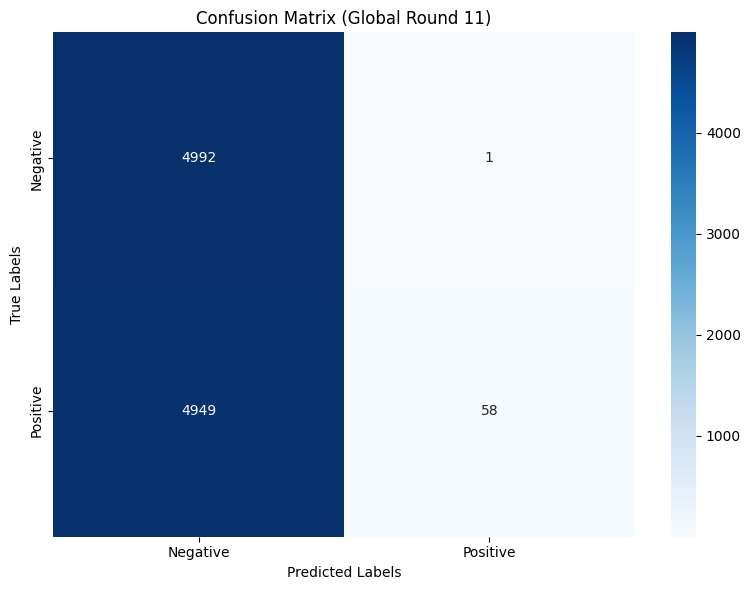


 | Global training round : 12/20 |

Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.8208, Test accuracy: 5447/10000 (54.47%)

Class      - Accuracy
Negative   - 99.9
Positive   - 9.2


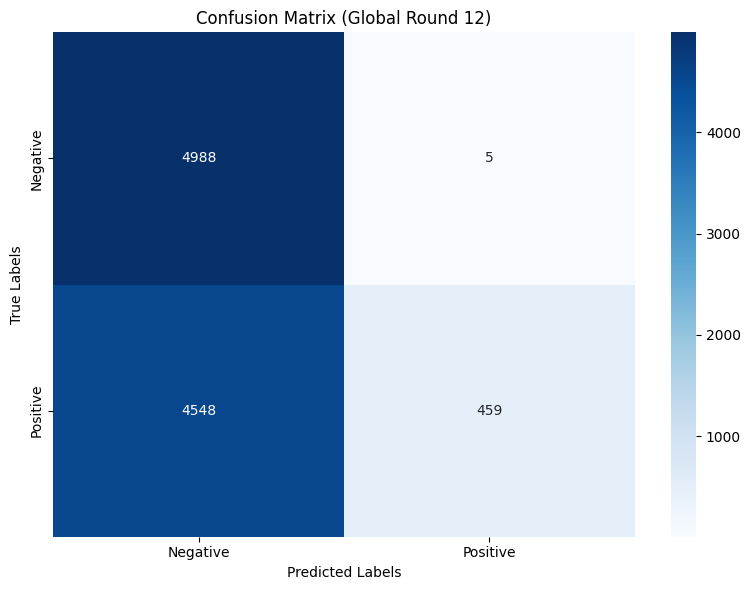


 | Global training round : 13/20 |

Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.4396, Test accuracy: 5177/10000 (51.77%)

Class      - Accuracy
Negative   - 100.0
Positive   - 3.7


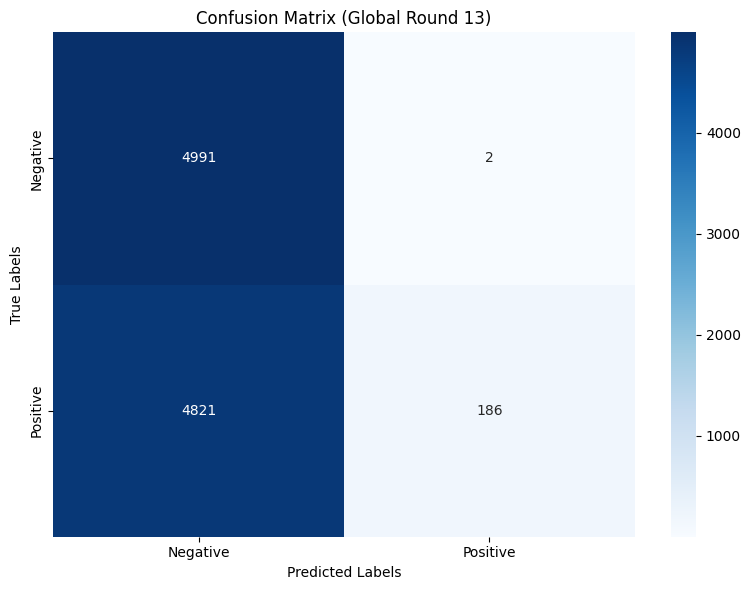


 | Global training round : 14/20 |

Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.8798, Test accuracy: 5478/10000 (54.78%)

Class      - Accuracy
Negative   - 99.9
Positive   - 9.8


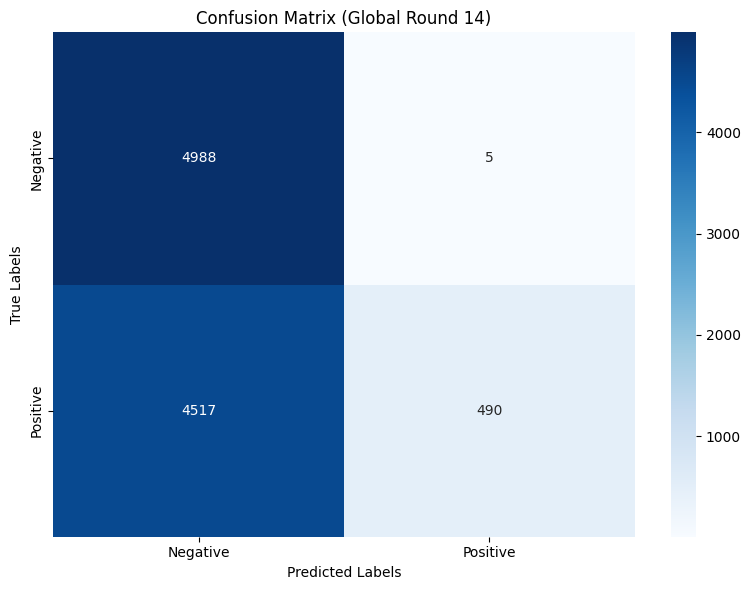


 | Global training round : 15/20 |

Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.3177, Test accuracy: 5248/10000 (52.48%)

Class      - Accuracy
Negative   - 100.0
Positive   - 5.1


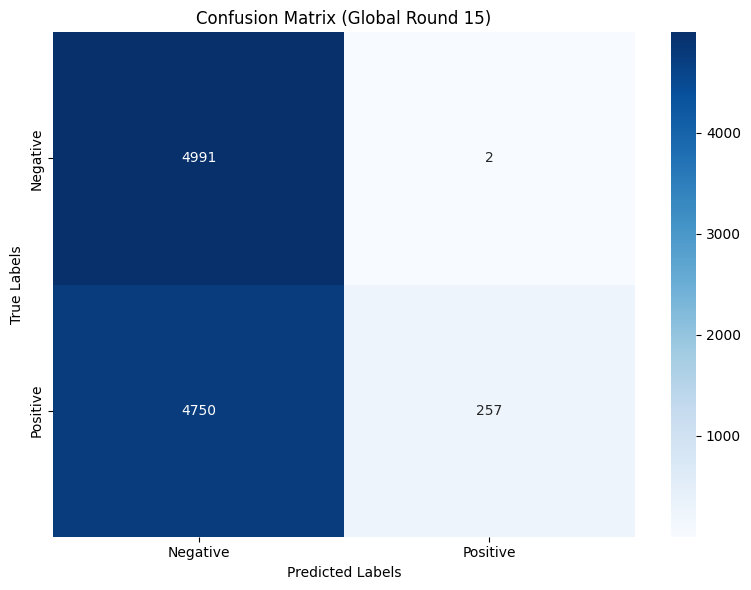


 | Global training round : 16/20 |

Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.9007, Test accuracy: 5557/10000 (55.57%)

Class      - Accuracy
Negative   - 99.9
Positive   - 11.4


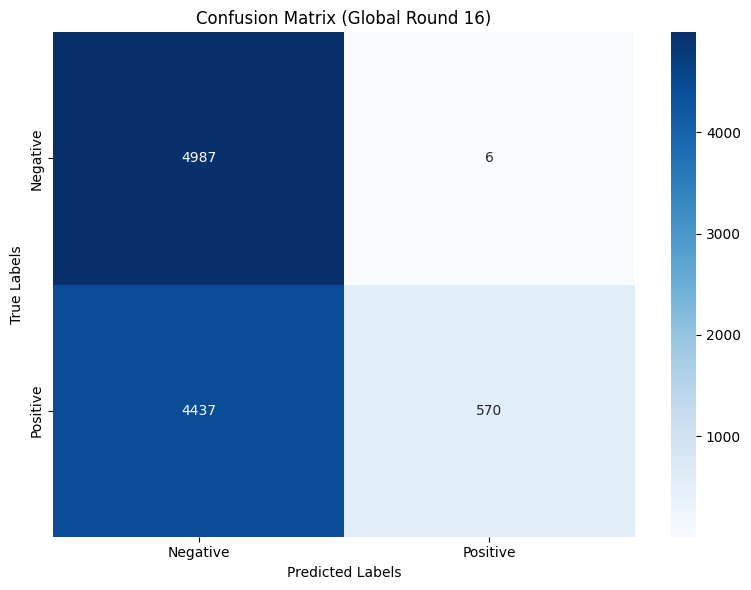


 | Global training round : 17/20 |

Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.2243, Test accuracy: 5351/10000 (53.51%)

Class      - Accuracy
Negative   - 100.0
Positive   - 7.2


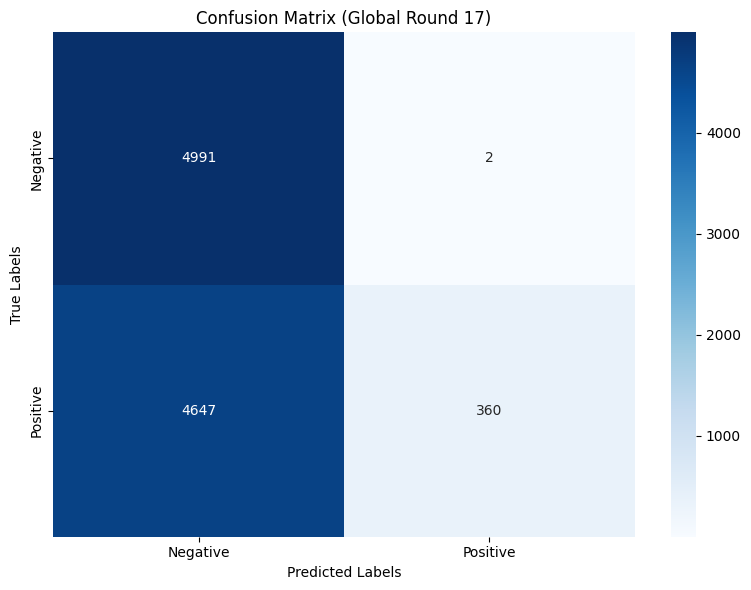


 | Global training round : 18/20 |

Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.9223, Test accuracy: 5638/10000 (56.38%)

Class      - Accuracy
Negative   - 99.9
Positive   - 13.0


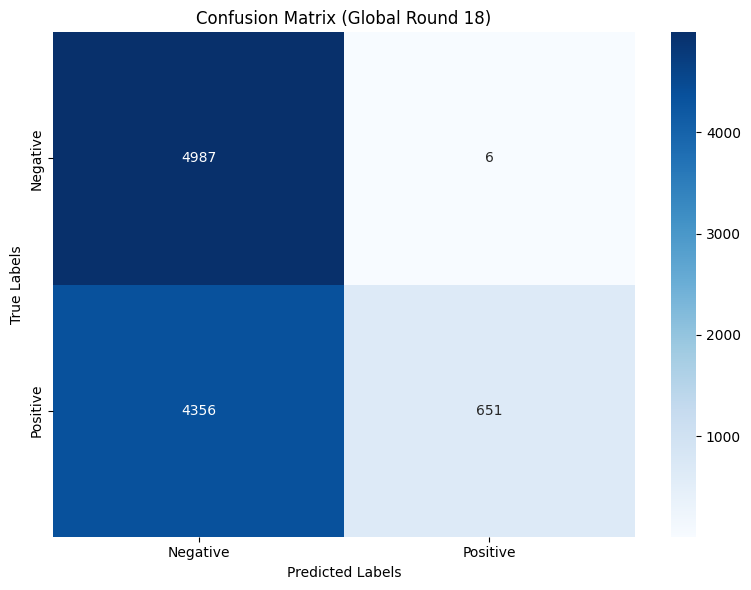


 | Global training round : 19/20 |

Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.1223, Test accuracy: 5432/10000 (54.32%)

Class      - Accuracy
Negative   - 99.9
Positive   - 8.8


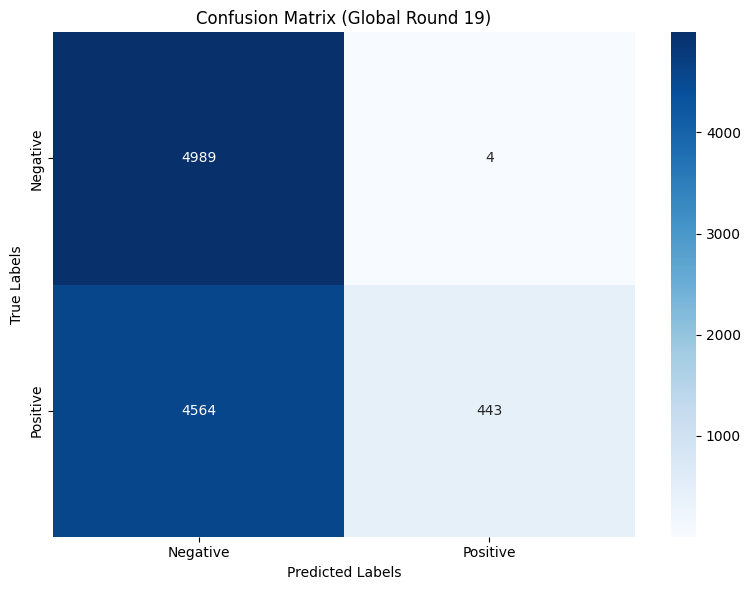


 | Global training round : 20/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 0.9537, Test accuracy: 5626/10000 (56.26%)

Class      - Accuracy
Negative   - 99.9
Positive   - 12.7
Last 10 updates results

Average test loss: 1.0498, Test accuracy: 5382/10000 (53.82%)

***********************************************************************************
Class      - Accuracy
Negative   - 100.0
Positive   - 7.8


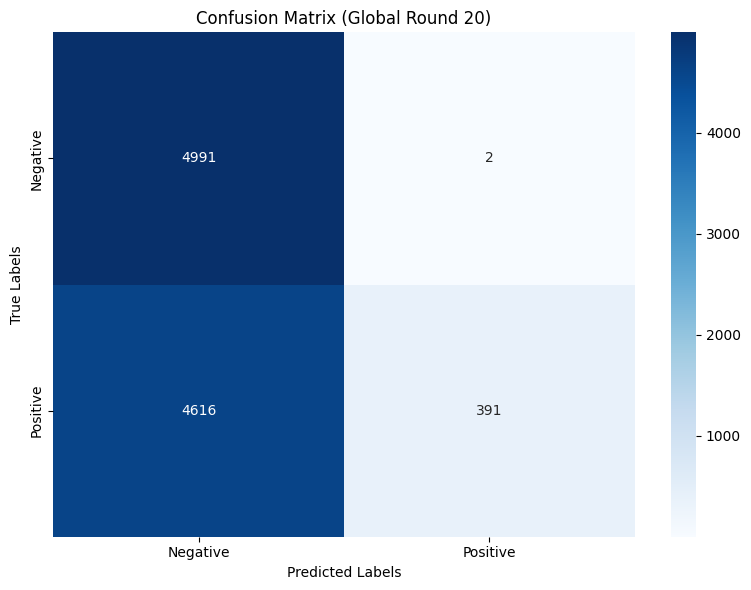

Global accuracies:  [np.float64(49.93), np.float64(49.93), np.float64(49.93), np.float64(49.93), np.float64(50.04), np.float64(51.45), np.float64(50.24), np.float64(52.74), np.float64(50.59), np.float64(53.92), np.float64(50.5), np.float64(54.47), np.float64(51.77), np.float64(54.78), np.float64(52.48), np.float64(55.57), np.float64(53.51), np.float64(56.38), np.float64(54.32), np.float64(56.26), np.float64(53.82)]
Class 1 accuracies:  [np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.22), np.float64(3.08), np.float64(0.62), np.float64(5.71), np.float64(1.34), np.float64(8.09), np.float64(1.16), np.float64(9.17), np.float64(3.71), np.float64(9.79), np.float64(5.13), np.float64(11.38), np.float64(7.19), np.float64(13.0), np.float64(8.85), np.float64(12.74), np.float64(7.81)]
Test loss: [np.float64(0.9005), np.float64(0.8288), np.float64(0.9658), np.float64(0.8372), np.float64(1.5321), np.float64(0.7487), np.float64(1.8547), np.float64(0.7718), np.float64(

In [ ]:
RULE = 'robutslfd'
ATTACK_TYPE='label_flipping'
MALICIOUS_BEHAVIOR_RATE = 1
for atr in [0.3]:
    run_exp(dataset_name = DATASET_NAME, model_name = MODEL_NAME, dd_type = DD_TYPE, num_peers = NUM_PEERS,
            frac_peers = FRAC_PEERS, seed = SEED, test_batch_size = TEST_BATCH_SIZE,
                criterion = CRITERION, global_rounds = GLOBAL_ROUNDS, local_epochs = LOCAL_EPOCHS, local_bs = LOCAL_BS,
                    local_lr = LOCAL_LR, local_momentum = LOCAL_MOMENTUM, labels_dict = LABELS_DICT, device = DEVICE,
                attackers_ratio = atr, attack_type=ATTACK_TYPE,
                    malicious_behavior_rate = MALICIOUS_BEHAVIOR_RATE, rule = RULE,
                source_class = SOURCE_CLASS, target_class = TARGET_CLASS,
                class_per_peer = CLASS_PER_PEER, samples_per_class = SAMPLES_PER_CLASS,
                rate_unbalance = RATE_UNBALANCE, alpha = ALPHA, resume = False)

IMDB, NON-IDD, 40% attacker

In [ ]:
#=============================== Defining global variables ========================#
DATASET_NAME = "IMDB"
MODEL_NAME = "BiLSTM"
DD_TYPE = 'NON_IID'
ALPHA = 1
NUM_PEERS = 20 # "number of peers: K"
FRAC_PEERS = 1 #'the fraction of peers: C to bel selected in each round'
SEED = 7 #fixed seed
random.seed(SEED)
CRITERION = nn.BCEWithLogitsLoss()
GLOBAL_ROUNDS = 20 #"number of rounds of federated model training"
LOCAL_EPOCHS = 1 #"the number of local epochs: E for each peer"
TEST_BATCH_SIZE = 100
LOCAL_BS = 32 #"local batch size: B for each peer"
LOCAL_LR =  0.001#local learning rate: lr for each peer
LOCAL_MOMENTUM = 0.9 #local momentum for each peer
NUM_CLASSES = 10 # number of classes in an experiment

LABELS_DICT = {'Negative':0,
               'Positive':1}

#select the device to work with cpu or gpu
if torch.cuda.is_available():
    DEVICE = "cuda"
else:
    DEVICE = "cpu"
DEVICE = torch.device(DEVICE)
print(DEVICE)
SOURCE_CLASS = 1 # the source class positive
TARGET_CLASS = 0 # the target class negative

CLASS_PER_PEER = 1
SAMPLES_PER_CLASS = 582
RATE_UNBALANCE = 1

cuda



--> Label FLIP experiment on our algo...
--> Loading of IMDB dataset
--> Dataset has been loaded!
--> Creating BiLSTM model.....
--> Model has been created!
--> Distributing training data among peers
--> Training data have been distributed among peers
--> Creating peets instances
Data set: IMDB
Data distribution: NON_IID
Aggregation rule: robutslfd
Attack Type: label_flipping
Attackers Ratio: 40.0 %
Malicious Behavior Rate: 100 %

===>Simulation started...

====>Global model training started...



  0%|          | 0/20 [00:00<?, ?it/s]


 | Global training round : 1/20 |

Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.0923, Test accuracy: 4993/10000 (49.93%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.0


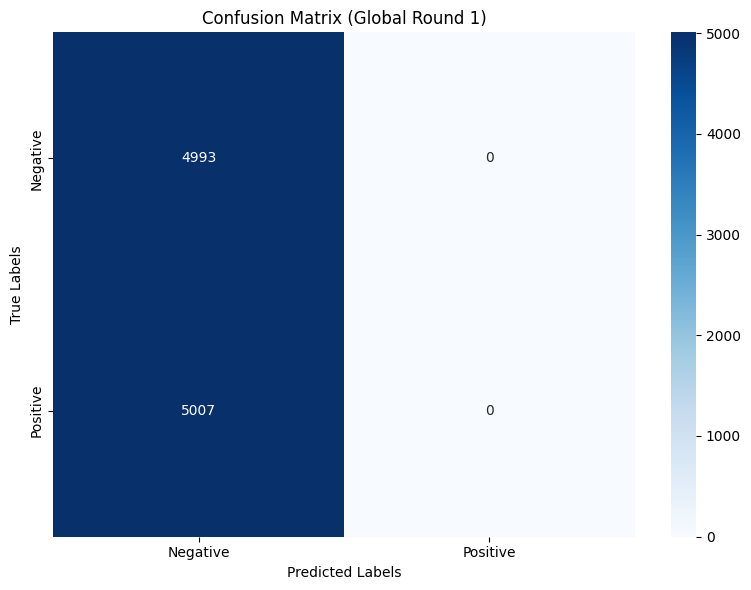


 | Global training round : 2/20 |

Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.1551, Test accuracy: 4993/10000 (49.93%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.0


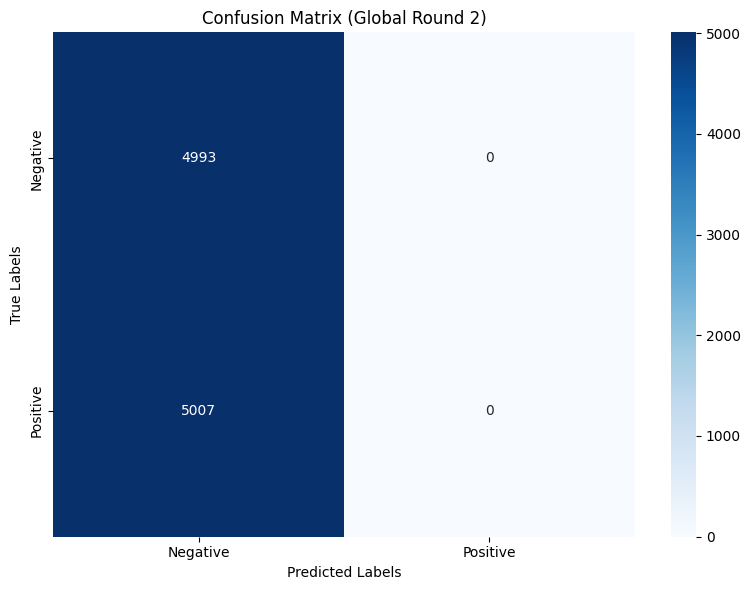


 | Global training round : 3/20 |

Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.0839, Test accuracy: 4993/10000 (49.93%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.0


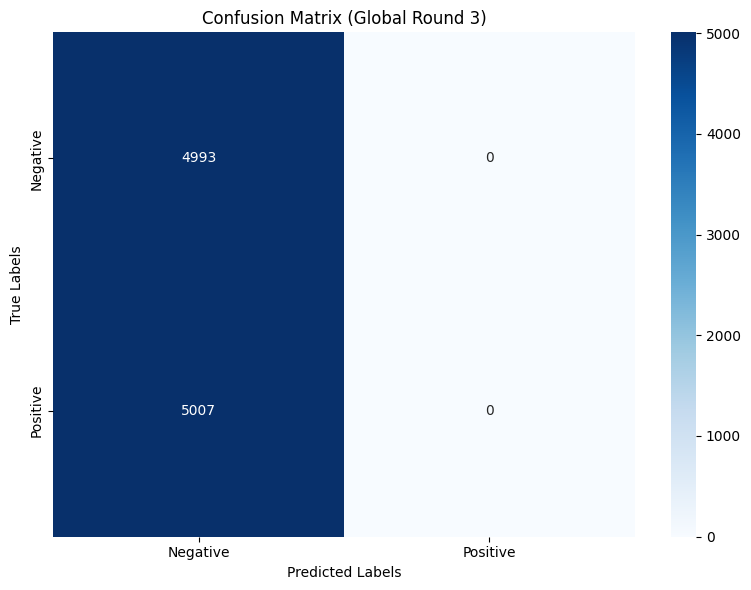


 | Global training round : 4/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.0509, Test accuracy: 4993/10000 (49.93%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.0


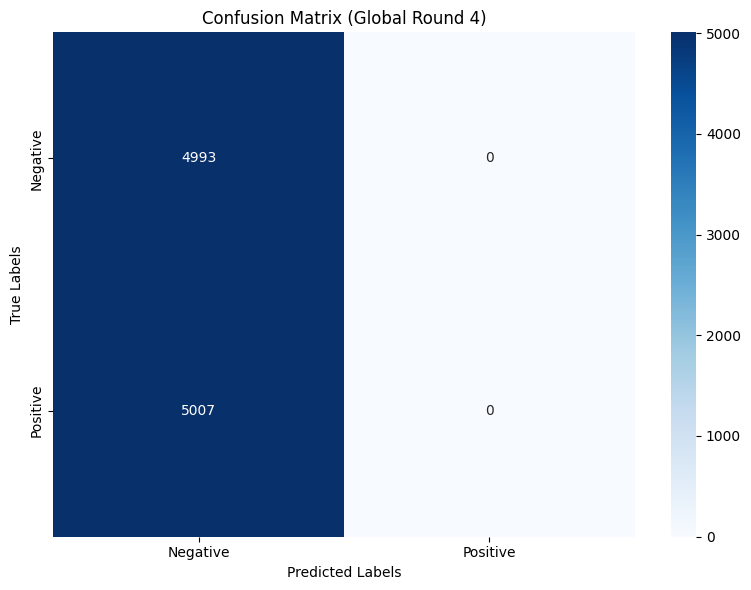


 | Global training round : 5/20 |

Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.2075, Test accuracy: 4993/10000 (49.93%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.0


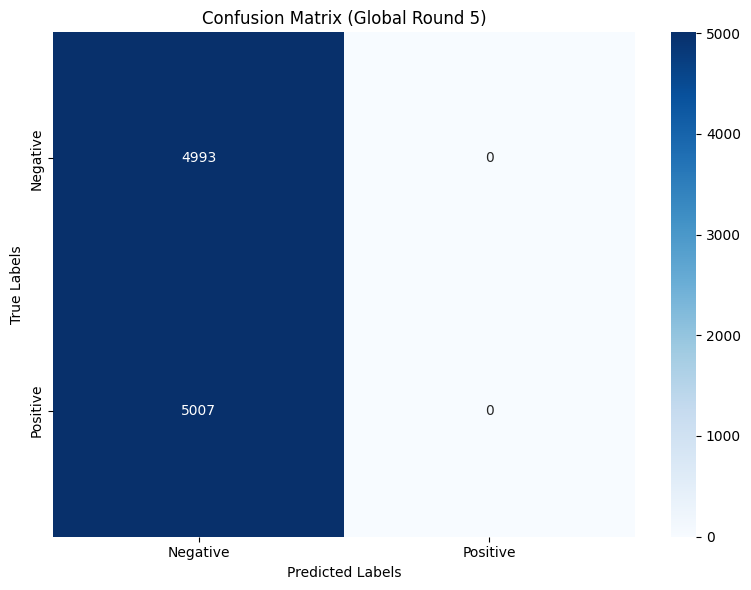


 | Global training round : 6/20 |

Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.0472, Test accuracy: 4993/10000 (49.93%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.0


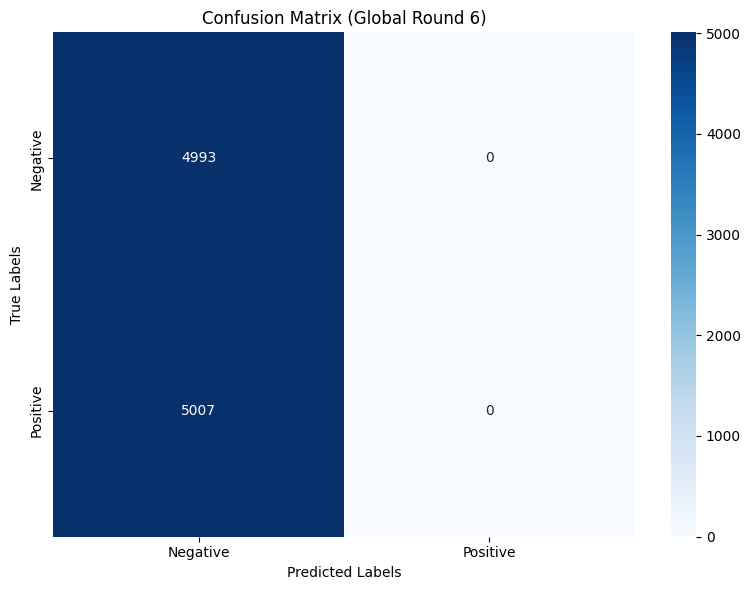


 | Global training round : 7/20 |

Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.4873, Test accuracy: 4996/10000 (49.96%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.1


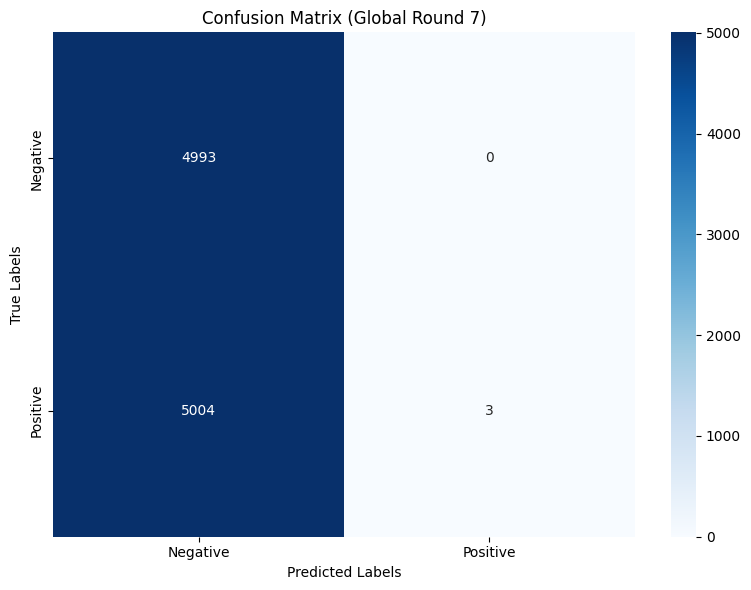


 | Global training round : 8/20 |

Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.0939, Test accuracy: 5002/10000 (50.02%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.2


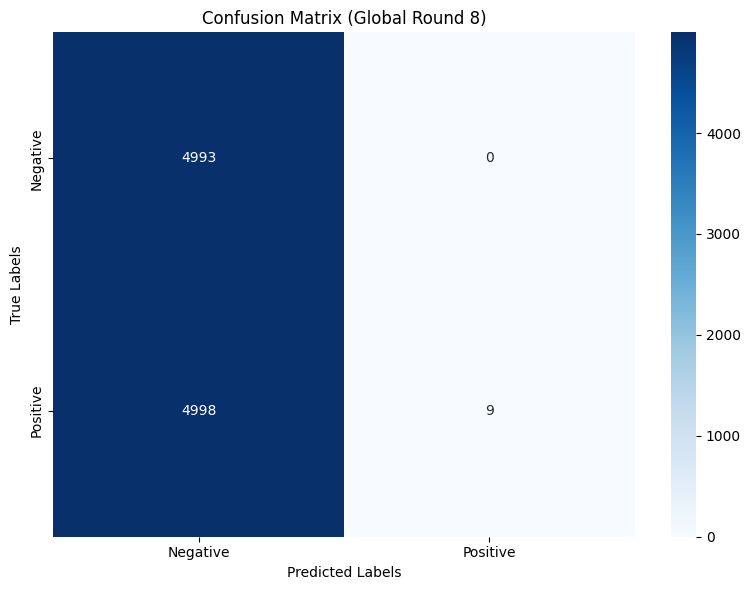


 | Global training round : 9/20 |

Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.6727, Test accuracy: 4998/10000 (49.98%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.1


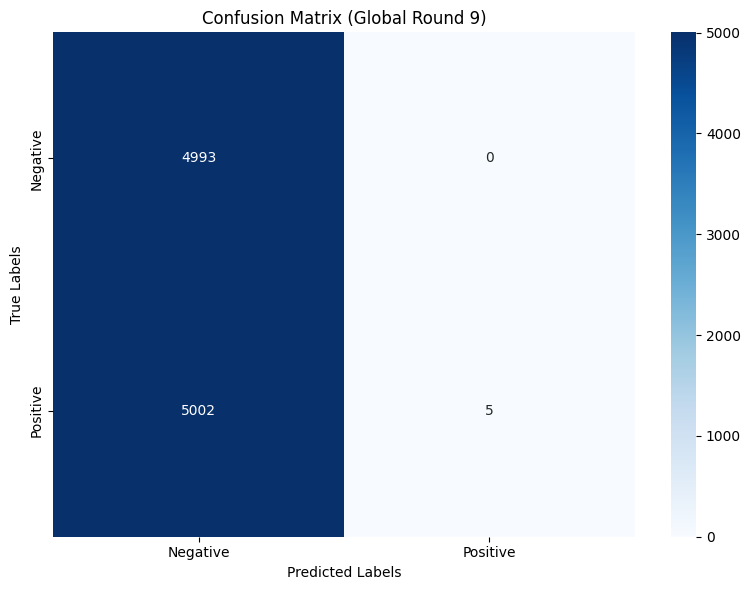


 | Global training round : 10/20 |

Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.1026, Test accuracy: 5055/10000 (50.55%)

Class      - Accuracy
Negative   - 100.0
Positive   - 1.3


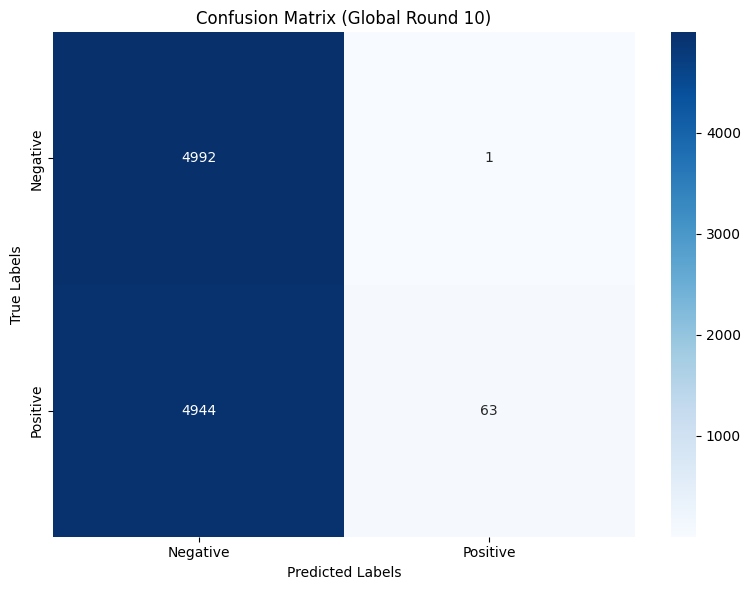


 | Global training round : 11/20 |

Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 2.1785, Test accuracy: 5000/10000 (50.00%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.1


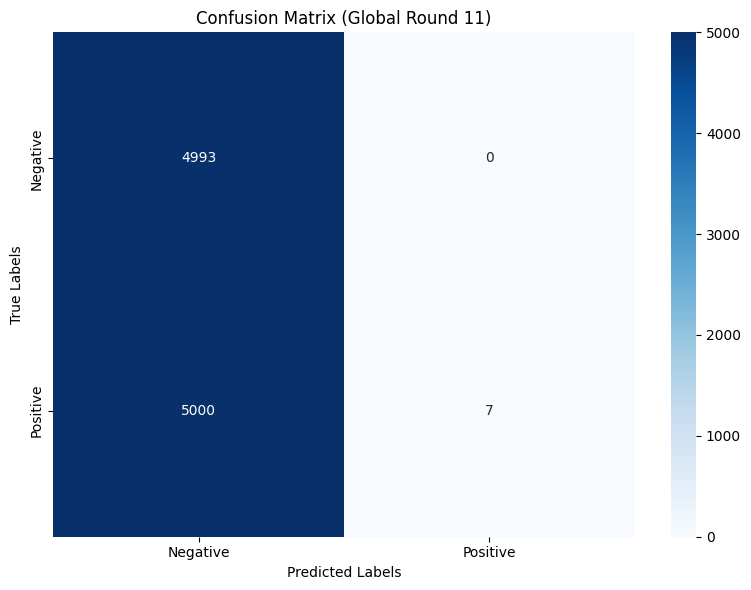


 | Global training round : 12/20 |

Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.1882, Test accuracy: 5038/10000 (50.38%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.9


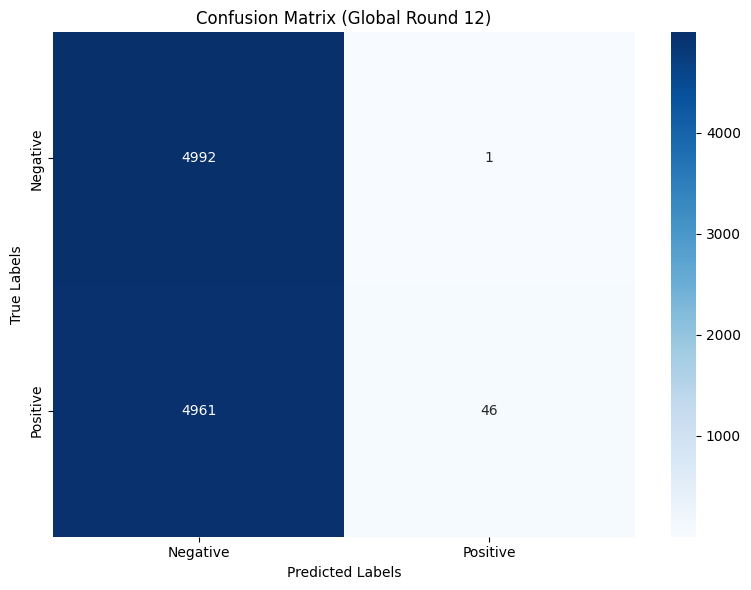


 | Global training round : 13/20 |

Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.5498, Test accuracy: 5030/10000 (50.30%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.8


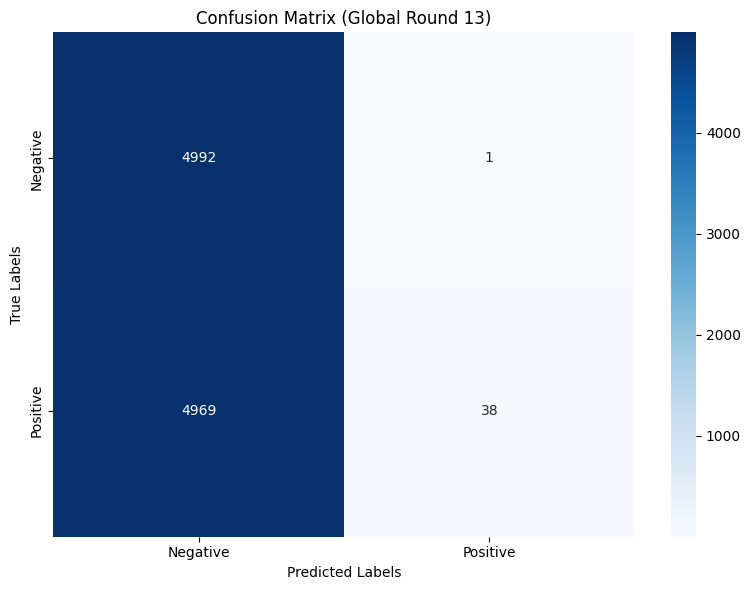


 | Global training round : 14/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.2890, Test accuracy: 5081/10000 (50.81%)

Class      - Accuracy
Negative   - 100.0
Positive   - 1.8


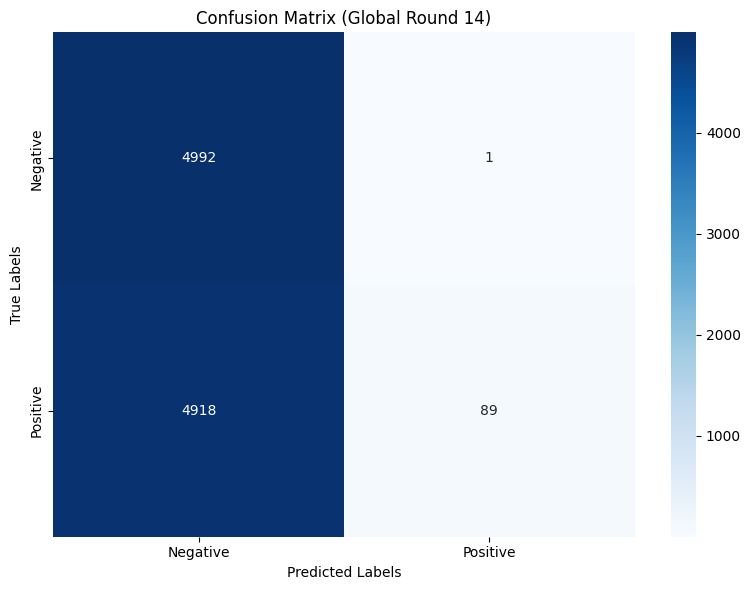


 | Global training round : 15/20 |

Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.7965, Test accuracy: 5023/10000 (50.23%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.6


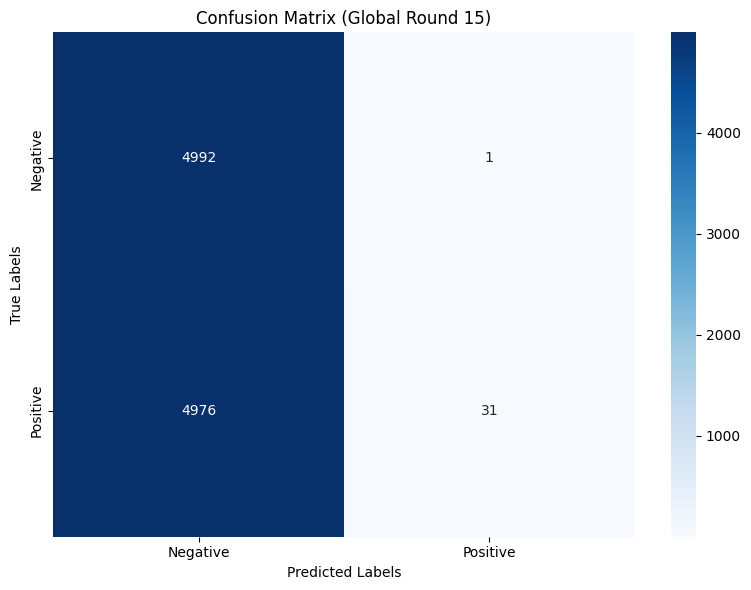


 | Global training round : 16/20 |

Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.1941, Test accuracy: 5134/10000 (51.34%)

Class      - Accuracy
Negative   - 100.0
Positive   - 2.8


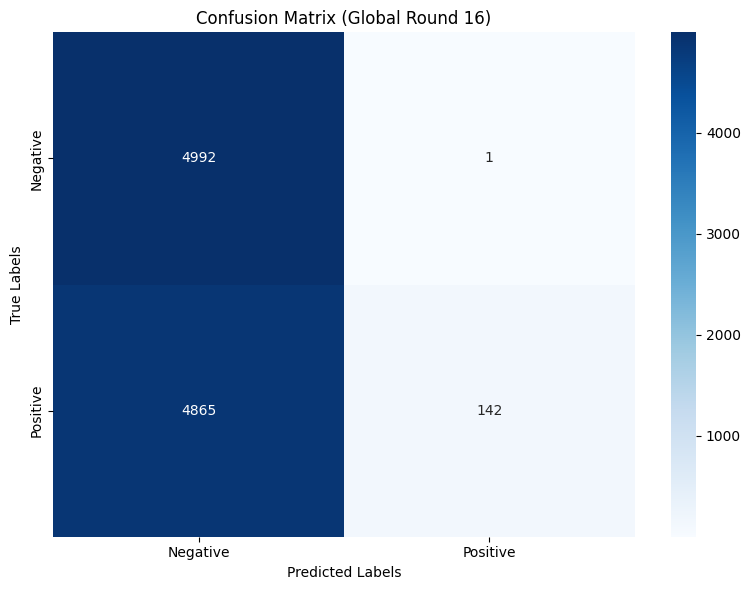


 | Global training round : 17/20 |

Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.8757, Test accuracy: 5023/10000 (50.23%)

Class      - Accuracy
Negative   - 100.0
Positive   - 0.6


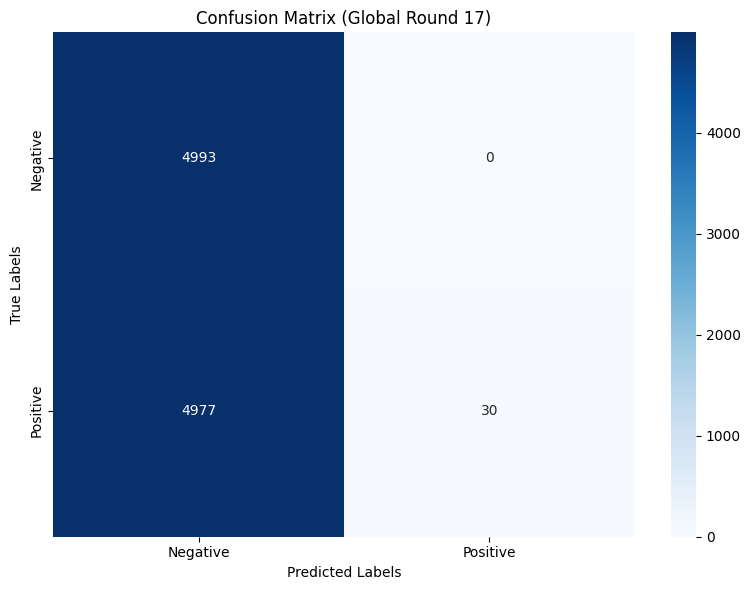


 | Global training round : 18/20 |

Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.4182, Test accuracy: 5097/10000 (50.97%)

Class      - Accuracy
Negative   - 100.0
Positive   - 2.1


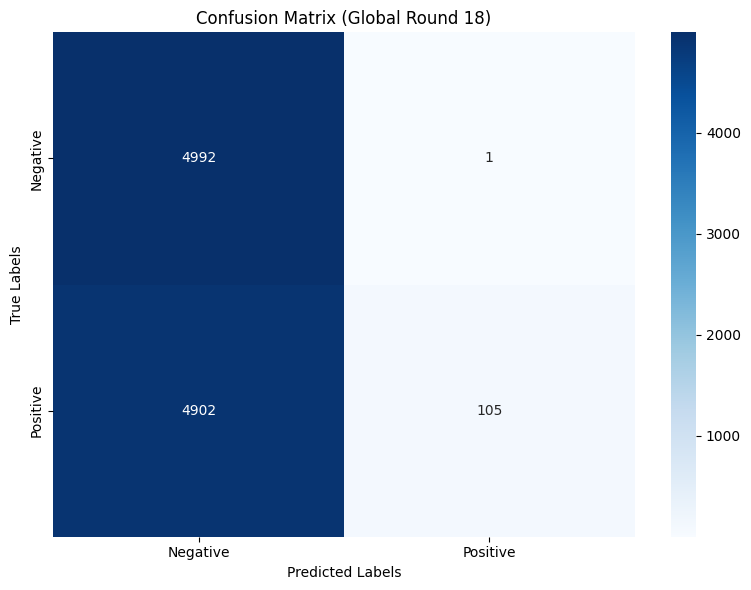


 | Global training round : 19/20 |

Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 20 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.5700, Test accuracy: 5052/10000 (50.52%)

Class      - Accuracy
Negative   - 100.0
Positive   - 1.2


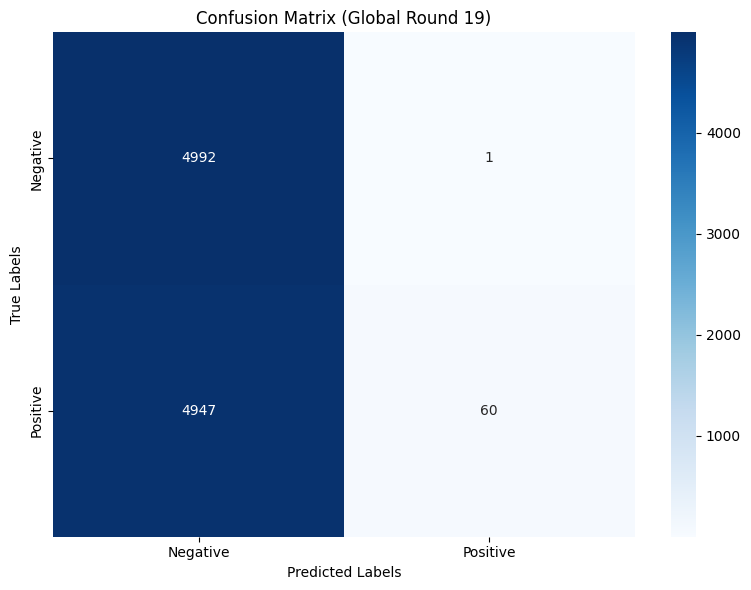


 | Global training round : 20/20 |

Label flipping attack launched by Peer 20 to flip class  1  to class  0
Label flipping attack launched by Peer 16 to flip class  1  to class  0
Label flipping attack launched by Peer 8 to flip class  1  to class  0
Label flipping attack launched by Peer 7 to flip class  1  to class  0
Label flipping attack launched by Peer 17 to flip class  1  to class  0
Label flipping attack launched by Peer 13 to flip class  1  to class  0
Label flipping attack launched by Peer 2 to flip class  1  to class  0
Label flipping attack launched by Peer 3 to flip class  1  to class  0
 our aggregation
inside robust aggregate

Average test loss: 1.4627, Test accuracy: 5070/10000 (50.70%)

Class      - Accuracy
Negative   - 100.0
Positive   - 1.6
Last 10 updates results

Average test loss: 1.4811, Test accuracy: 5042/10000 (50.42%)

***********************************************************************************
Class      - Accuracy
Negative   - 100.0
Positive   - 1.

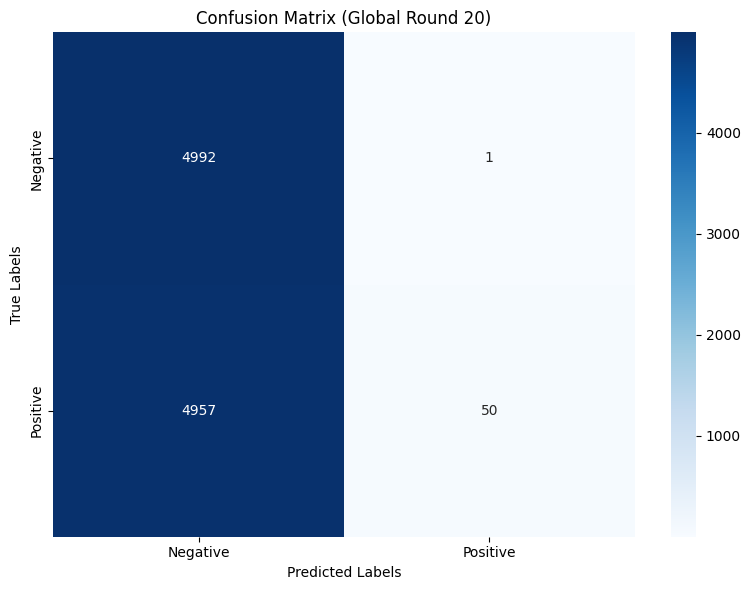

Global accuracies:  [np.float64(49.93), np.float64(49.93), np.float64(49.93), np.float64(49.93), np.float64(49.93), np.float64(49.93), np.float64(49.96), np.float64(50.02), np.float64(49.98), np.float64(50.55), np.float64(50.0), np.float64(50.38), np.float64(50.3), np.float64(50.81), np.float64(50.23), np.float64(51.34), np.float64(50.23), np.float64(50.97), np.float64(50.52), np.float64(50.7), np.float64(50.42)]
Class 1 accuracies:  [np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.06), np.float64(0.18), np.float64(0.1), np.float64(1.26), np.float64(0.14), np.float64(0.92), np.float64(0.76), np.float64(1.78), np.float64(0.62), np.float64(2.84), np.float64(0.6), np.float64(2.1), np.float64(1.2), np.float64(1.56), np.float64(1.0)]
Test loss: [np.float64(1.0923), np.float64(1.1551), np.float64(1.0839), np.float64(1.0509), np.float64(1.2075), np.float64(1.0472), np.float64(1.4873), np.float64(1.0939), np.float64(1.6727), np

In [ ]:
RULE = 'robutslfd'
ATTACK_TYPE='label_flipping'
MALICIOUS_BEHAVIOR_RATE = 1
for atr in [0.4]:
    run_exp(dataset_name = DATASET_NAME, model_name = MODEL_NAME, dd_type = DD_TYPE, num_peers = NUM_PEERS,
            frac_peers = FRAC_PEERS, seed = SEED, test_batch_size = TEST_BATCH_SIZE,
                criterion = CRITERION, global_rounds = GLOBAL_ROUNDS, local_epochs = LOCAL_EPOCHS, local_bs = LOCAL_BS,
                    local_lr = LOCAL_LR, local_momentum = LOCAL_MOMENTUM, labels_dict = LABELS_DICT, device = DEVICE,
                attackers_ratio = atr, attack_type=ATTACK_TYPE,
                    malicious_behavior_rate = MALICIOUS_BEHAVIOR_RATE, rule = RULE,
                source_class = SOURCE_CLASS, target_class = TARGET_CLASS,
                class_per_peer = CLASS_PER_PEER, samples_per_class = SAMPLES_PER_CLASS,
                rate_unbalance = RATE_UNBALANCE, alpha = ALPHA, resume = False)

GTSRB Dataset

MNIST, 40% attacker, 20 rounds, EXTREME_NON_IID, FedAvg

In [ ]:

#=============================== Defining global variables ========================#
DATASET_NAME = "MNIST"
MODEL_NAME = "CNNMNIST"
DD_TYPE = 'EXTREME_NON_IID'
ALPHA = 1
NUM_PEERS = 20 # "number of peers: K"
FRAC_PEERS = 1 #'the fraction of peers: C to bel selected in each round'
SEED = 7 #fixed seed
random.seed(SEED)
CRITERION = nn.CrossEntropyLoss()
GLOBAL_ROUNDS = 20 #"number of rounds of federated model training"
LOCAL_EPOCHS = 3 #"the number of local epochs: E for each peer"
TEST_BATCH_SIZE = 1000
LOCAL_BS = 64 #"local batch size: B for each peer"
LOCAL_LR =  0.01#local learning rate: lr for each peer
LOCAL_MOMENTUM = 0.9 #local momentum for each peer
NUM_CLASSES = 10 # number of classes in an experiment
LABELS_DICT = {'Zero':0,
               'One':1,
               'Two':2,
               'Three':3,
               'Four':4,
               'Five':5,
               'Six':6,
               'Seven':7,
               'Eight':8,
               'Nine':9}

#select the device to work with cpu or gpu
if torch.cuda.is_available():
    DEVICE = "cuda"
else:
    DEVICE = "cpu"
DEVICE = torch.device(DEVICE)
print(DEVICE)
SOURCE_CLASS = 7 # the source class
TARGET_CLASS = 1 # the target class

CLASS_PER_PEER = 1
SAMPLES_PER_CLASS = 582
RATE_UNBALANCE = 1

cuda



--> Label FLIP experiment on our algo...
--> Loading of MNIST dataset
--> Dataset has been loaded!
--> Creating CNNMNIST model.....
--> Model has been created!
--> Distributing training data among peers
--> Training data have been distributed among peers
--> Creating peets instances
Data set: MNIST
Data distribution: EXTREME_NON_IID
Aggregation rule: fedavg
Attack Type: label_flipping
Attackers Ratio: 0 %
Malicious Behavior Rate: 100 %

===>Simulation started...

====>Global model training started...



  0%|          | 0/20 [00:00<?, ?it/s]


 | Global training round : 1/20 |


Average test loss: 28.4082, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


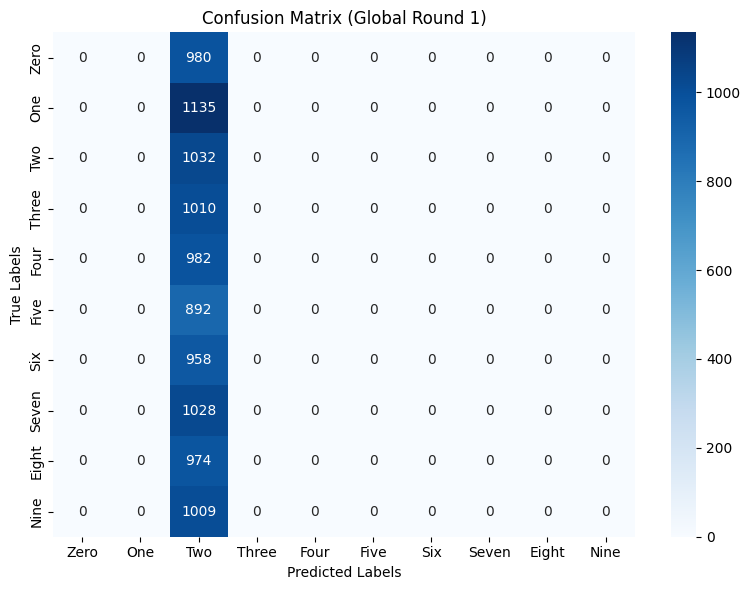


 | Global training round : 2/20 |


Average test loss: 4.6226, Test accuracy: 958/10000 (9.58%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 100.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


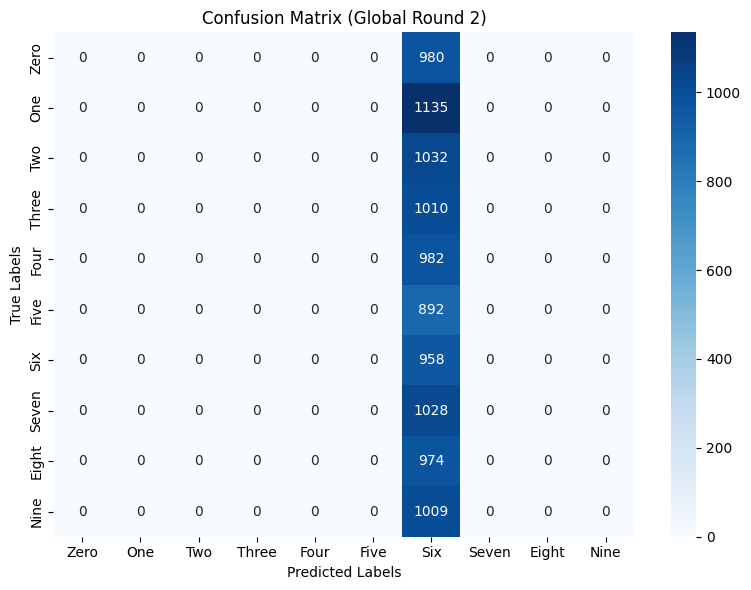


 | Global training round : 3/20 |


Average test loss: 2.3625, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


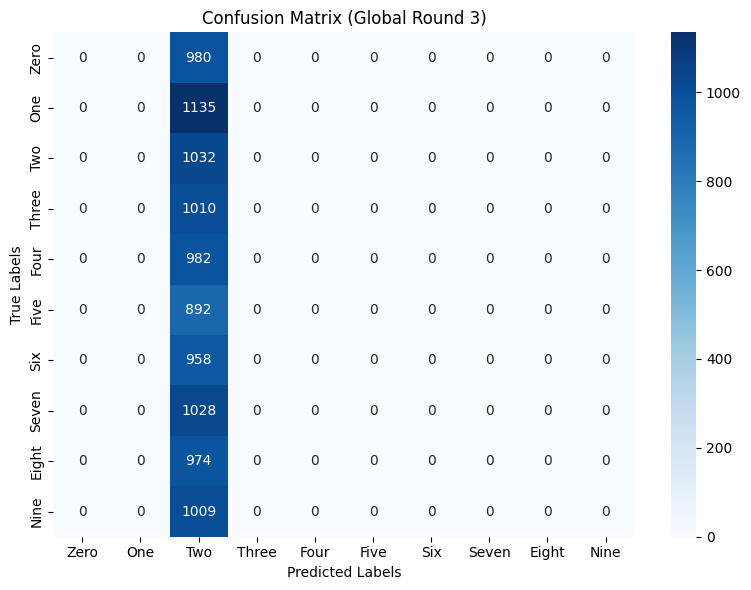


 | Global training round : 4/20 |


Average test loss: 5.4022, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


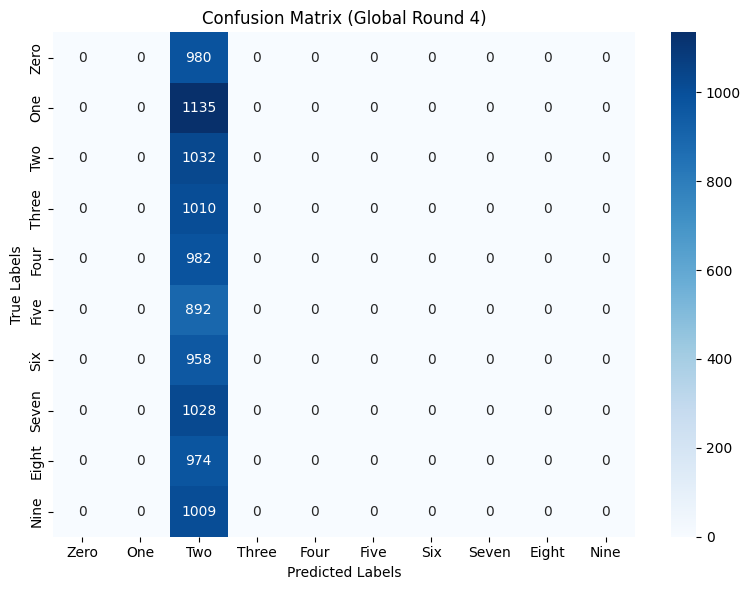


 | Global training round : 5/20 |


Average test loss: 3.8838, Test accuracy: 974/10000 (9.74%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 100.0
Nine       - 0.0


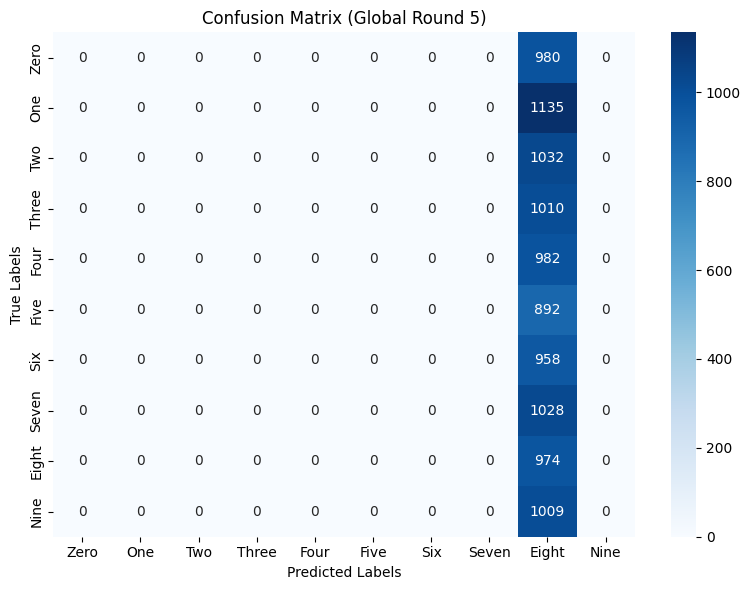


 | Global training round : 6/20 |


Average test loss: 7.9230, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


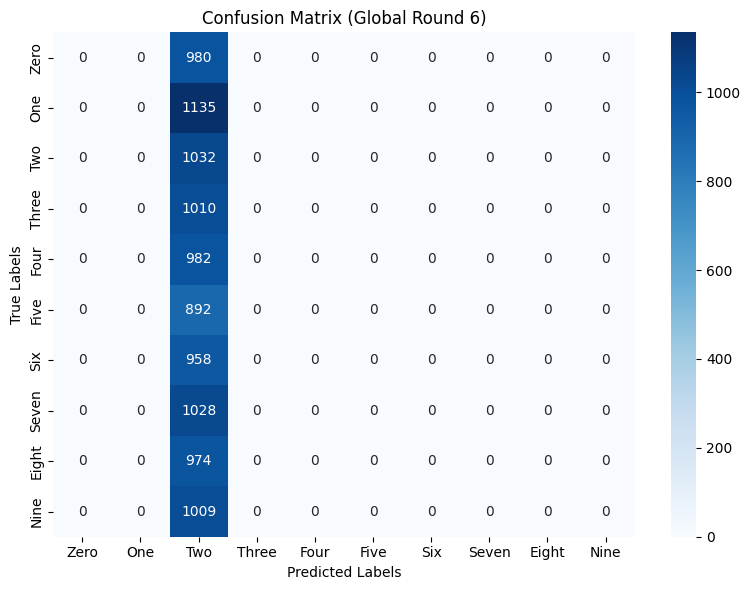


 | Global training round : 7/20 |


Average test loss: 2.4820, Test accuracy: 1135/10000 (11.35%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


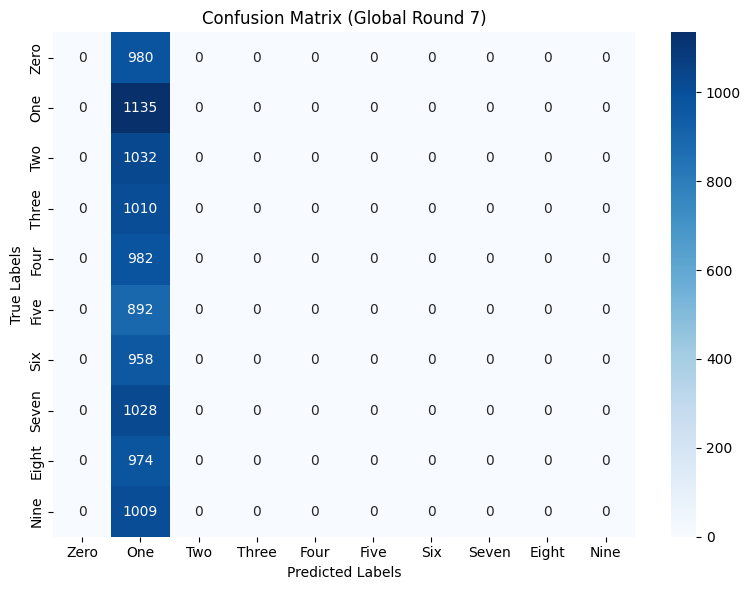


 | Global training round : 8/20 |


Average test loss: 3.2004, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


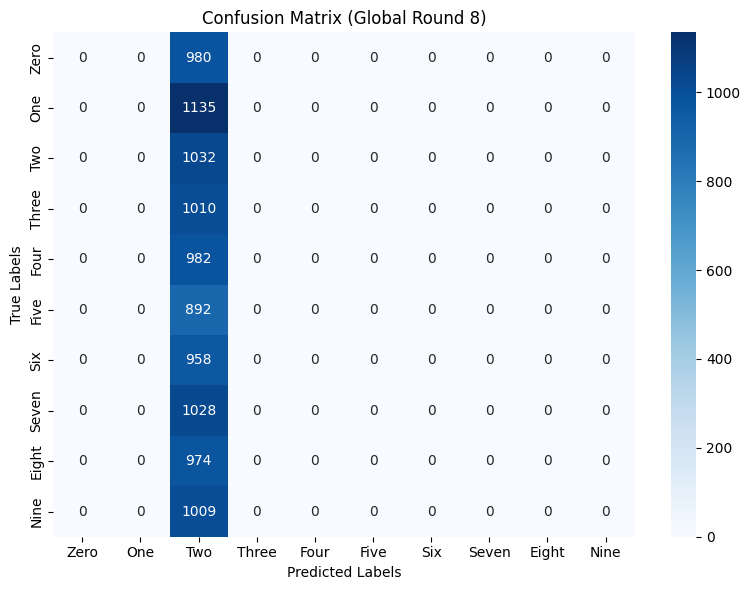


 | Global training round : 9/20 |


Average test loss: 4.0733, Test accuracy: 1203/10000 (12.03%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 6.6
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


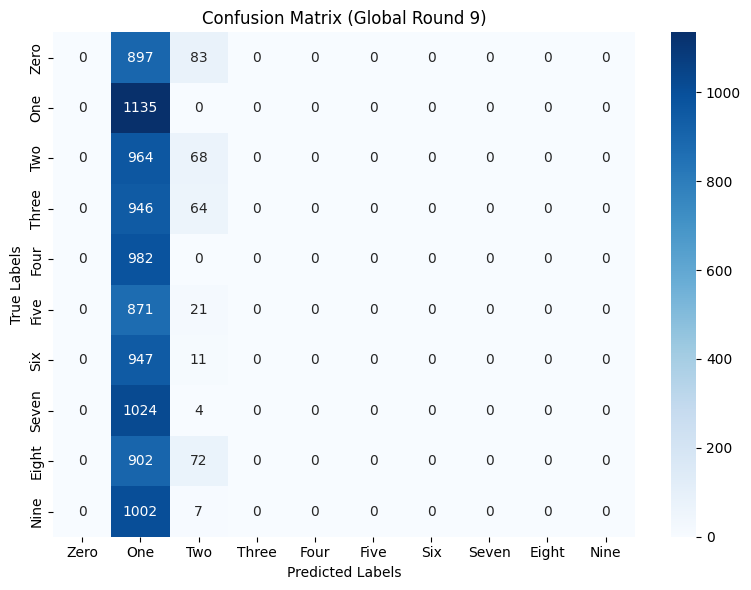


 | Global training round : 10/20 |


Average test loss: 6.4064, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


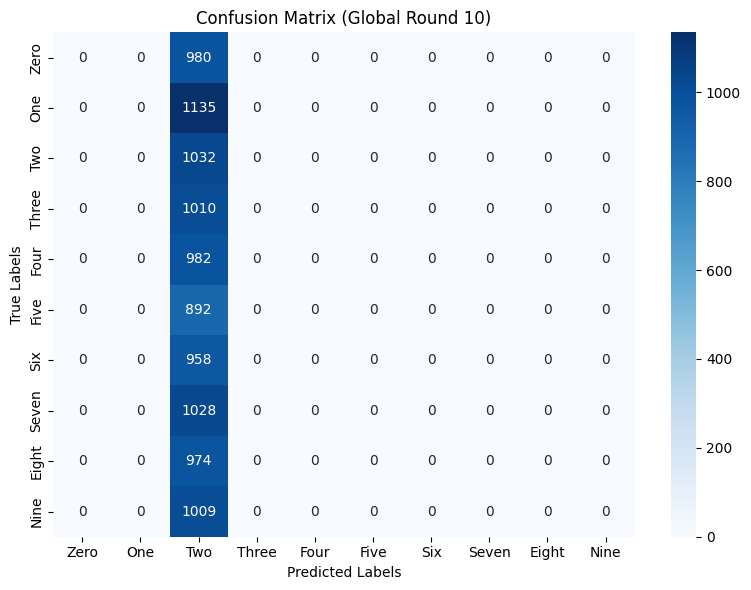


 | Global training round : 11/20 |


Average test loss: 3.8578, Test accuracy: 1139/10000 (11.39%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.4


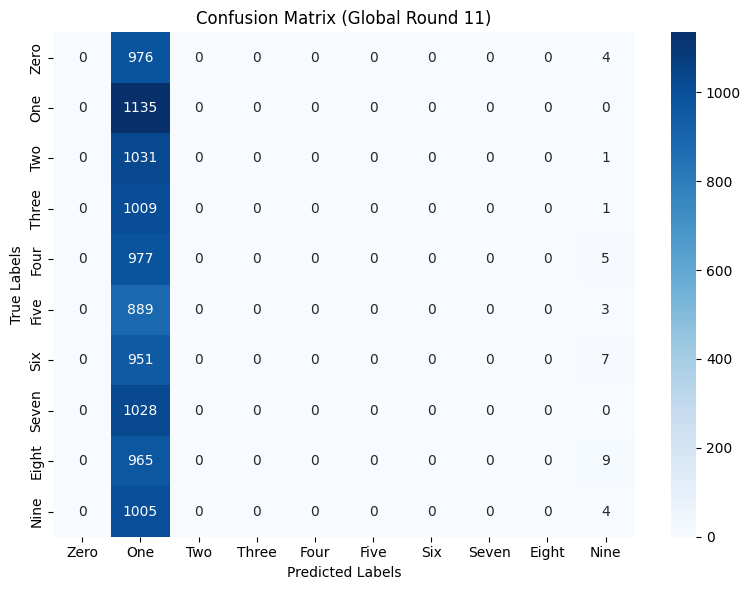


 | Global training round : 12/20 |


Average test loss: 3.1572, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


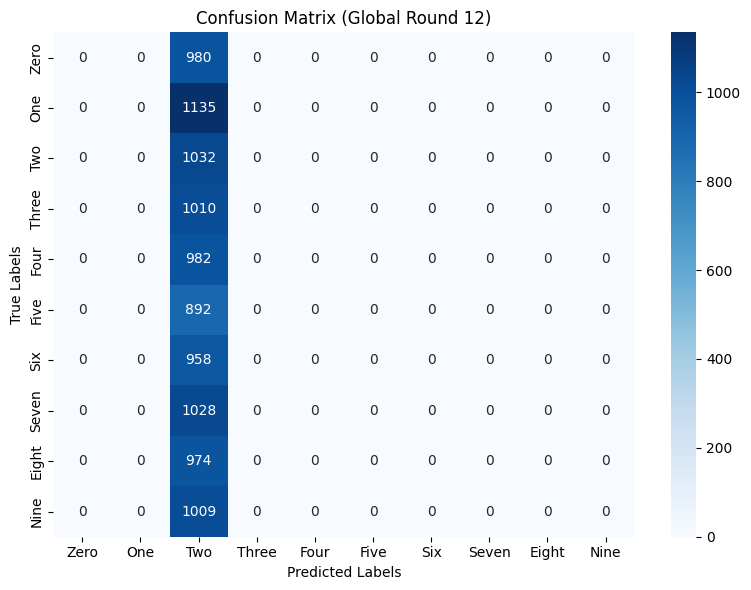


 | Global training round : 13/20 |


Average test loss: 3.6233, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


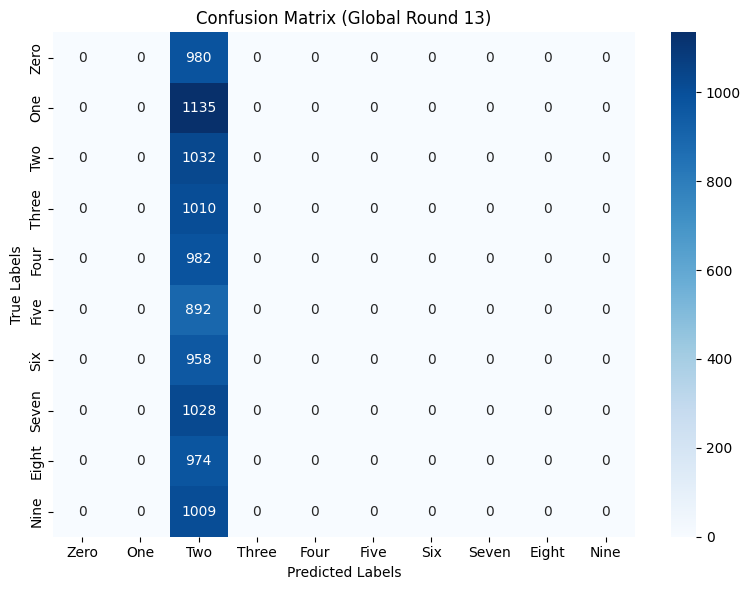


 | Global training round : 14/20 |


Average test loss: 4.0513, Test accuracy: 1176/10000 (11.76%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 4.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


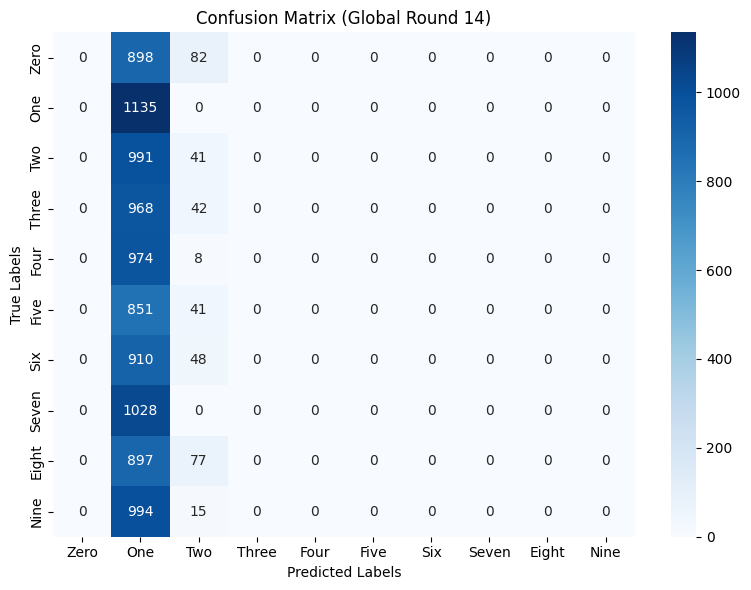


 | Global training round : 15/20 |


Average test loss: 9.5931, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


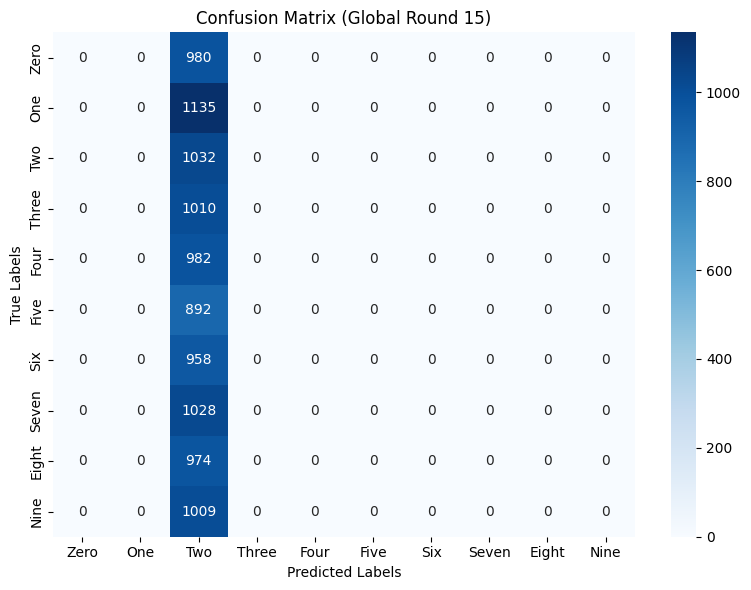


 | Global training round : 16/20 |


Average test loss: 2.7687, Test accuracy: 1908/10000 (19.08%)

Class      - Accuracy
Zero       - 0.0
One        - 2.7
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 72.5
Seven      - 0.0
Eight      - 35.7
Nine       - 82.7


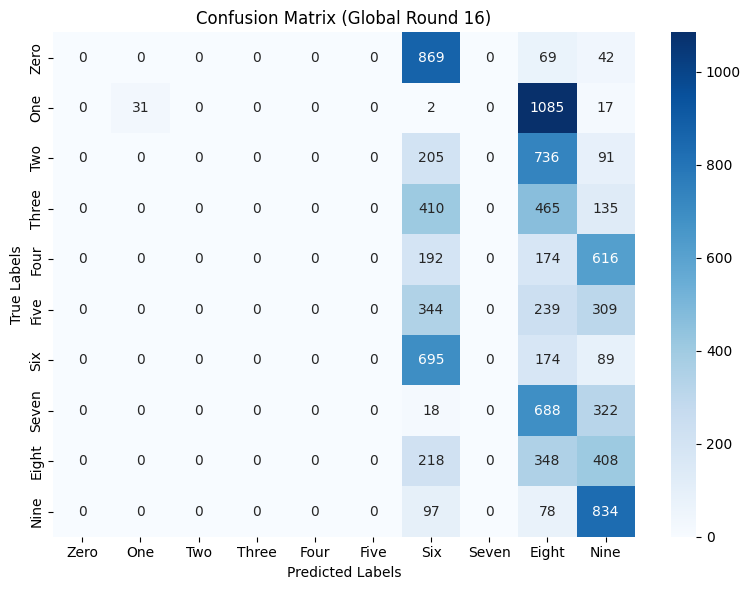


 | Global training round : 17/20 |


Average test loss: 2.8594, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


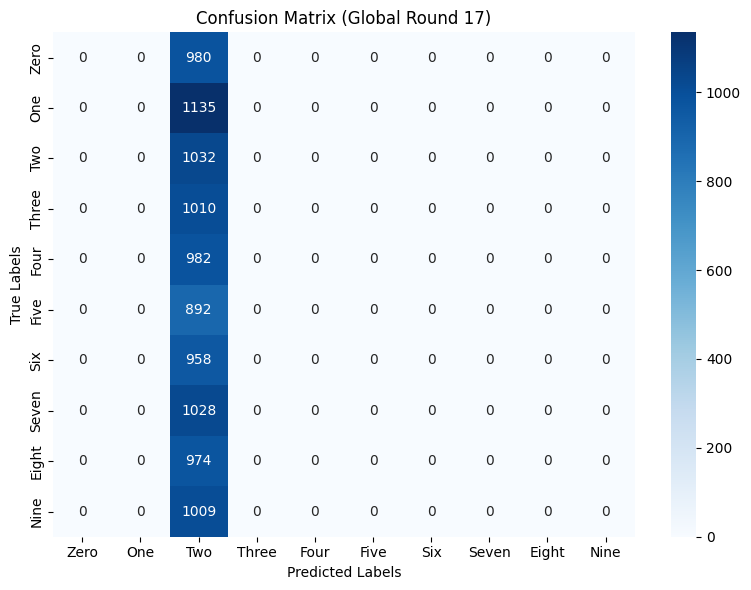


 | Global training round : 18/20 |


Average test loss: 7.9285, Test accuracy: 1860/10000 (18.60%)

Class      - Accuracy
Zero       - 0.0
One        - 73.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


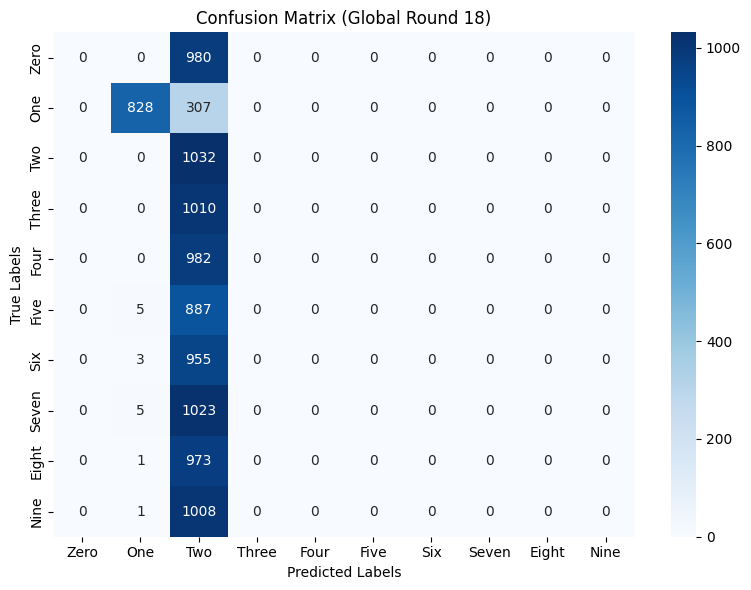


 | Global training round : 19/20 |


Average test loss: 5.6156, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


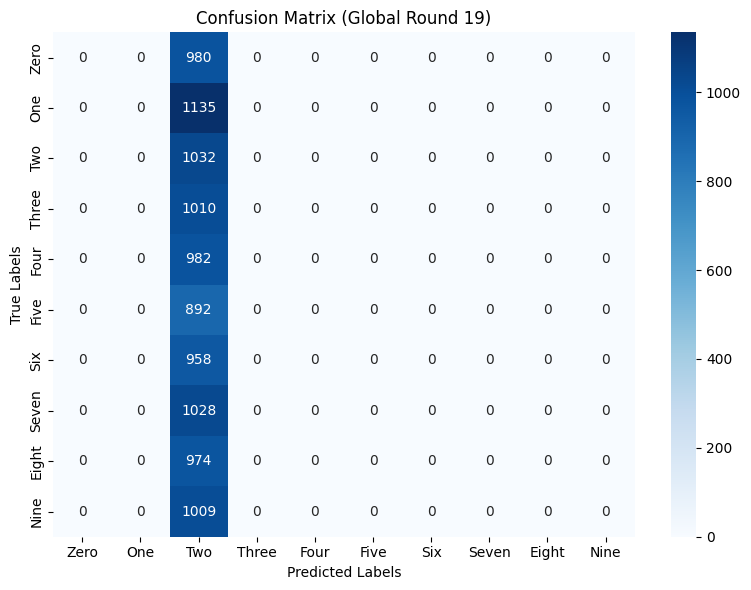


 | Global training round : 20/20 |


Average test loss: 3.7239, Test accuracy: 1814/10000 (18.14%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 0.3
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 42.3
Seven      - 9.2
Eight      - 0.0
Nine       - 17.4
Last 10 updates results

Average test loss: 3.1291, Test accuracy: 1032/10000 (10.32%)

***********************************************************************************
Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


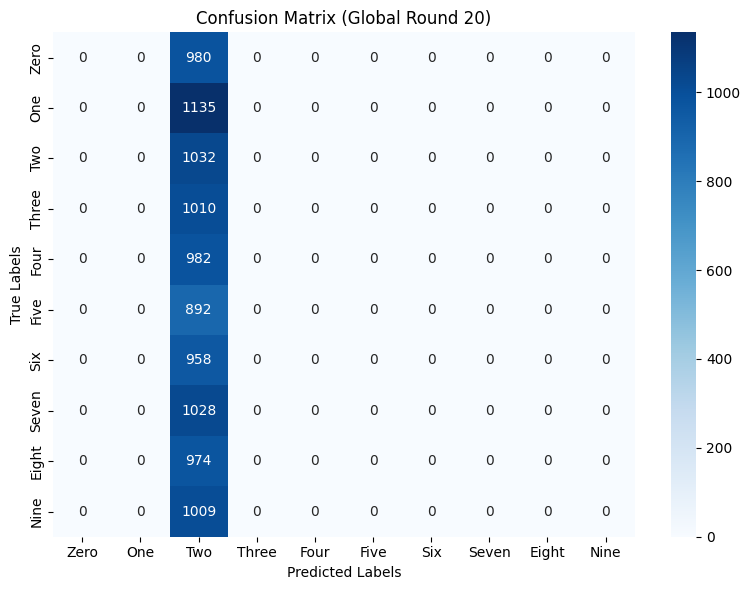

Global accuracies:  [np.float64(10.32), np.float64(9.58), np.float64(10.32), np.float64(10.32), np.float64(9.74), np.float64(10.32), np.float64(11.35), np.float64(10.32), np.float64(12.03), np.float64(10.32), np.float64(11.39), np.float64(10.32), np.float64(10.32), np.float64(11.76), np.float64(10.32), np.float64(19.08), np.float64(10.32), np.float64(18.6), np.float64(10.32), np.float64(18.14), np.float64(10.32)]
Class 7 accuracies:  [np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(9.24), np.float64(0.0)]
Test loss: [np.float64(28.4082), np.float64(4.6226), np.float64(2.3625), np.float64(5.4022), np.float64(3.8838), np.float64(7.923), np.float64(2.482), np.float64(3.2004), np.float64(4.0733), np.float64(6

  0%|          | 0/20 [00:00<?, ?it/s]


 | Global training round : 1/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 28.0620, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


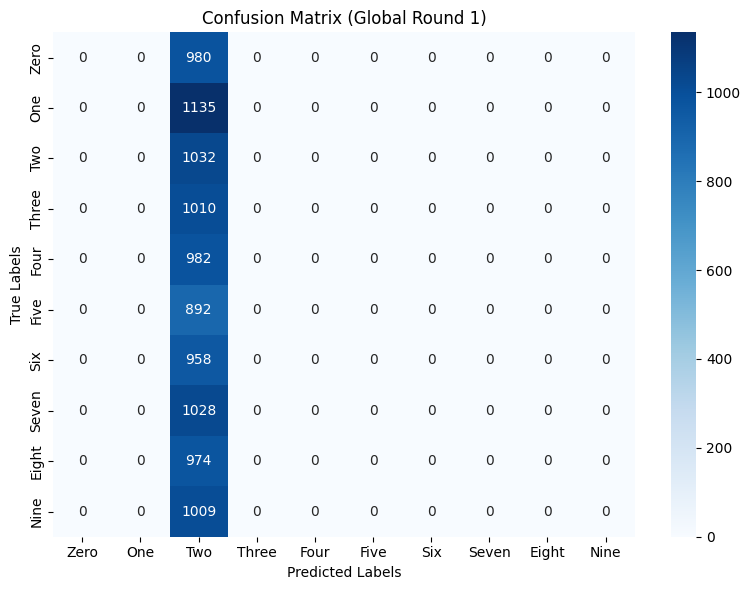


 | Global training round : 2/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 4.4014, Test accuracy: 958/10000 (9.58%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 100.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


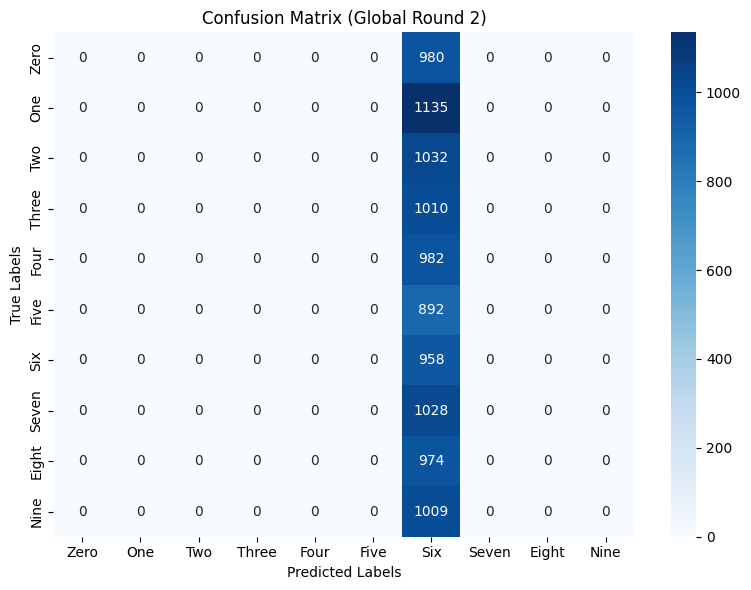


 | Global training round : 3/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 2.3581, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


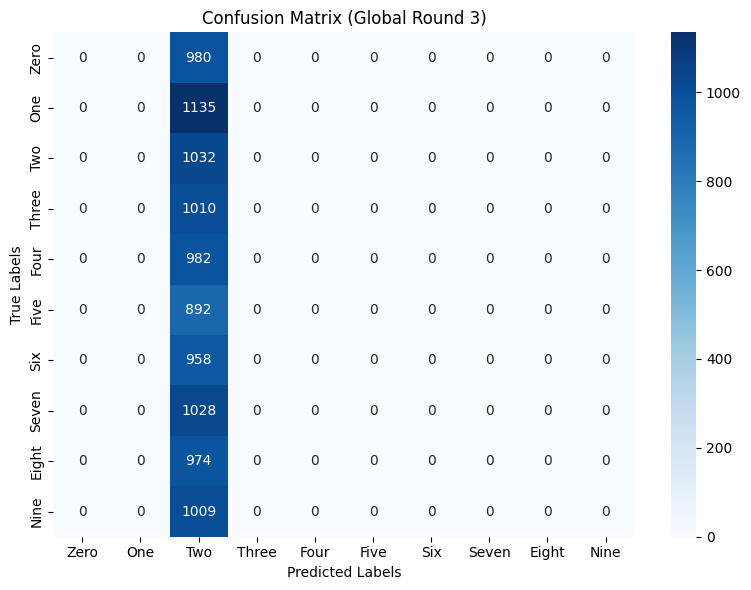


 | Global training round : 4/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 2.4964, Test accuracy: 1034/10000 (10.34%)

Class      - Accuracy
Zero       - 0.0
One        - 0.6
Two        - 99.5
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


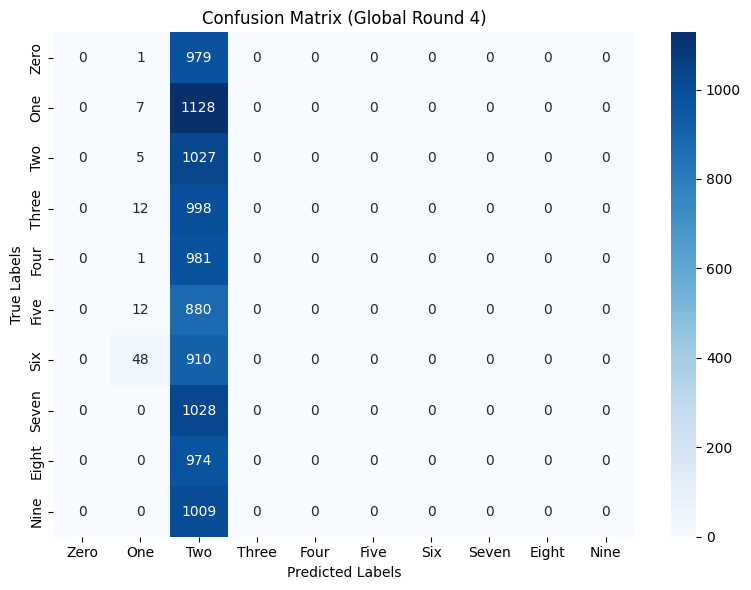


 | Global training round : 5/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 7.2290, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


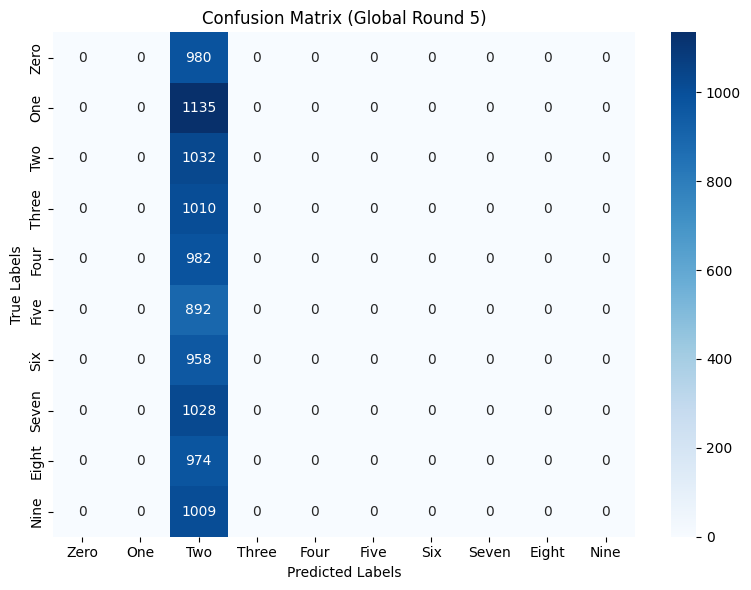


 | Global training round : 6/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 7.4873, Test accuracy: 1135/10000 (11.35%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


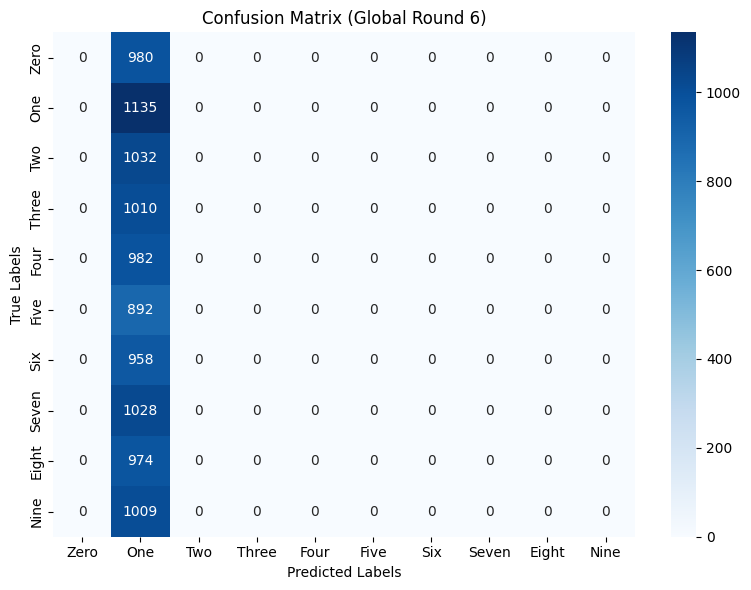


 | Global training round : 7/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 3.3341, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


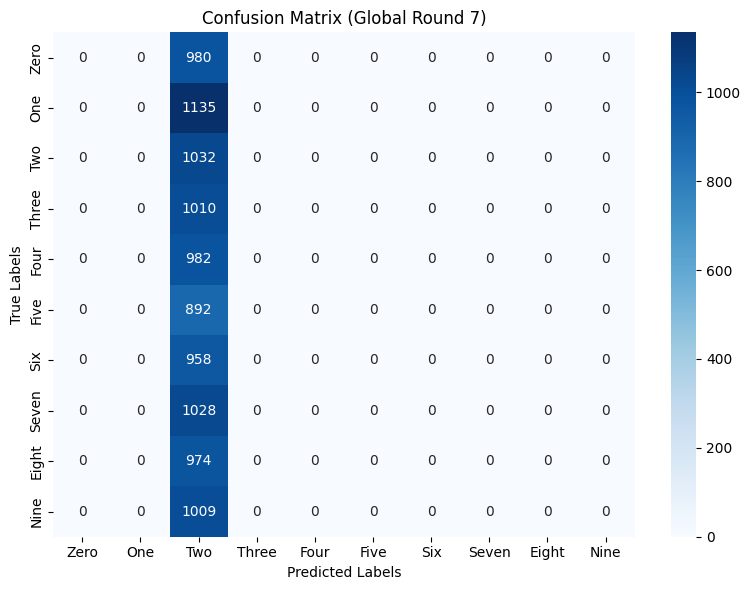


 | Global training round : 8/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 5.1775, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


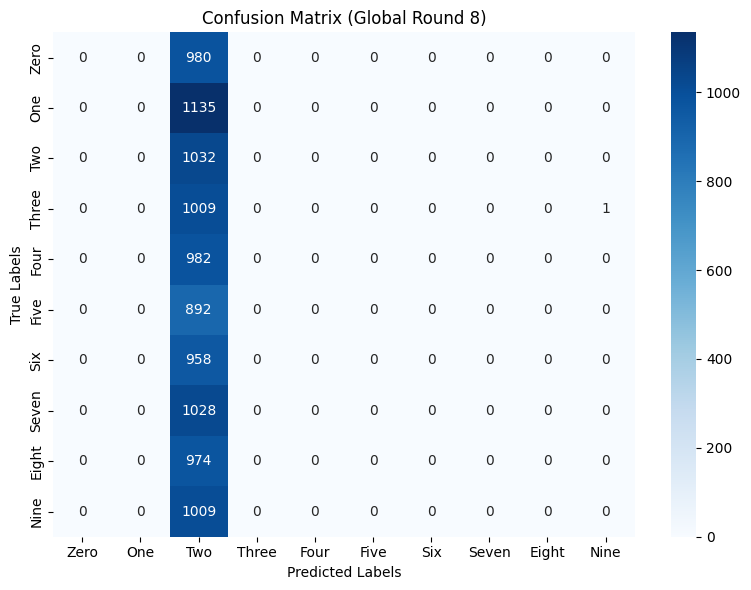


 | Global training round : 9/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 9.0959, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


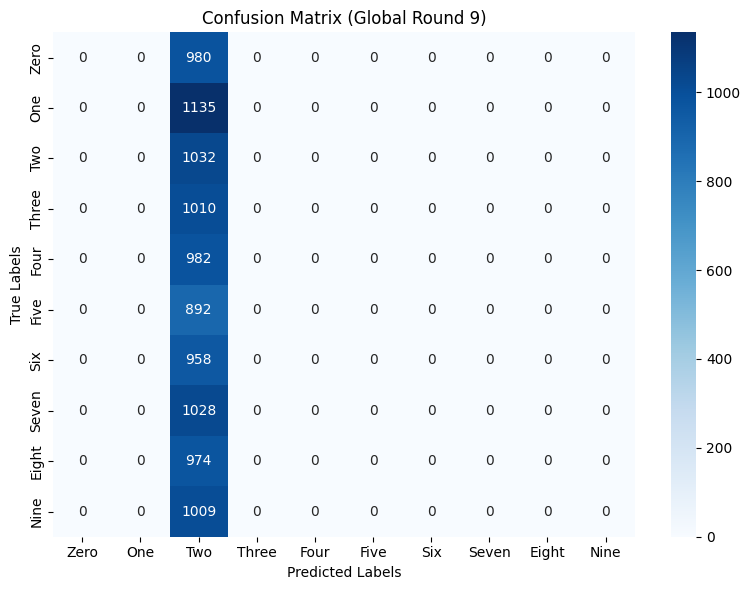


 | Global training round : 10/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 3.2274, Test accuracy: 1135/10000 (11.35%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


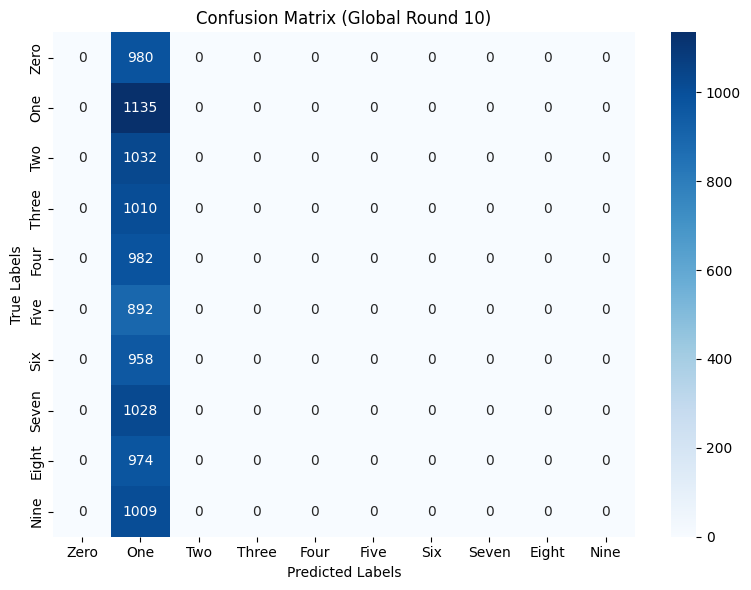


 | Global training round : 11/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 2.8804, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


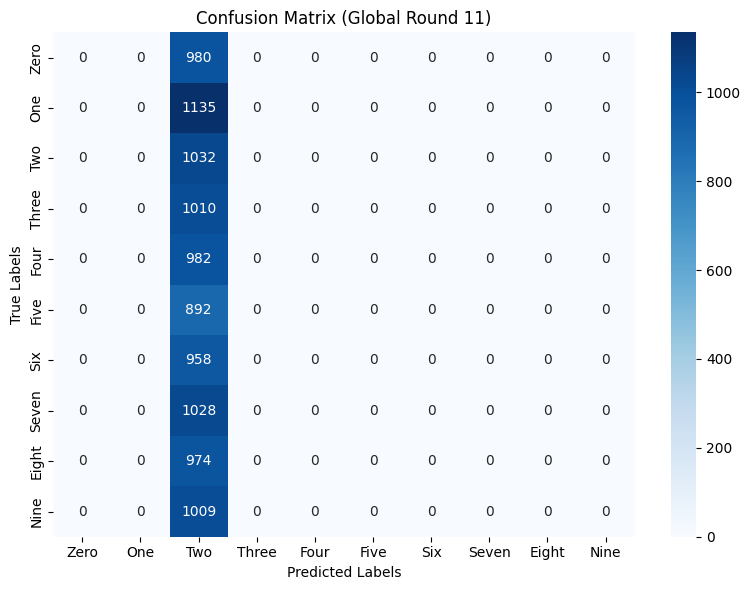


 | Global training round : 12/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 6.2745, Test accuracy: 1535/10000 (15.35%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 51.7
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 47.1
Nine       - 53.7


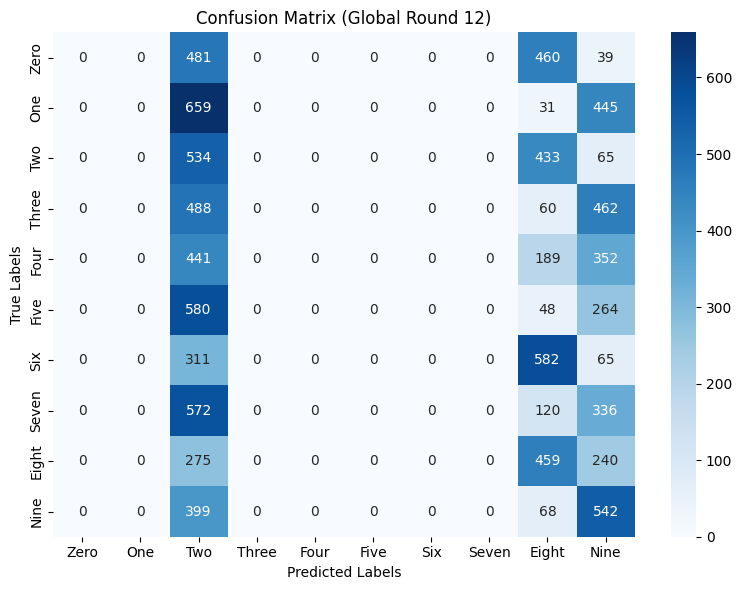


 | Global training round : 13/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 7.8732, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


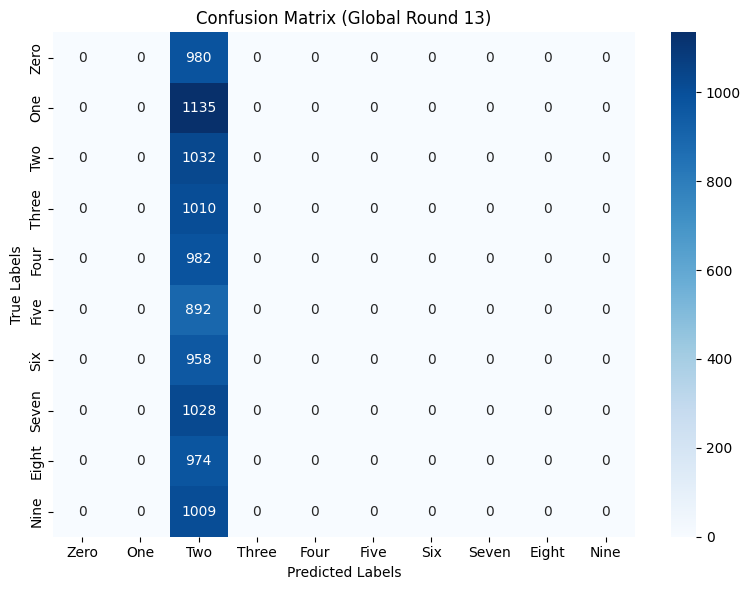


 | Global training round : 14/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 3.3067, Test accuracy: 1135/10000 (11.35%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


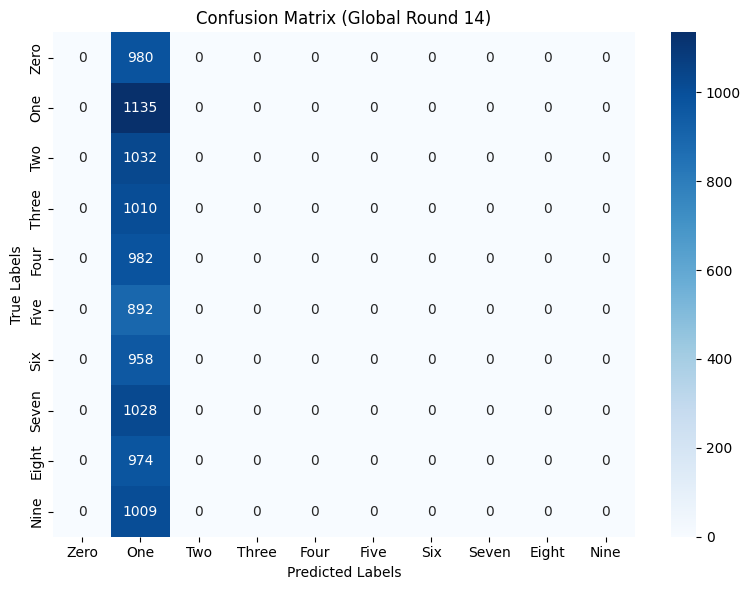


 | Global training round : 15/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 4.2279, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


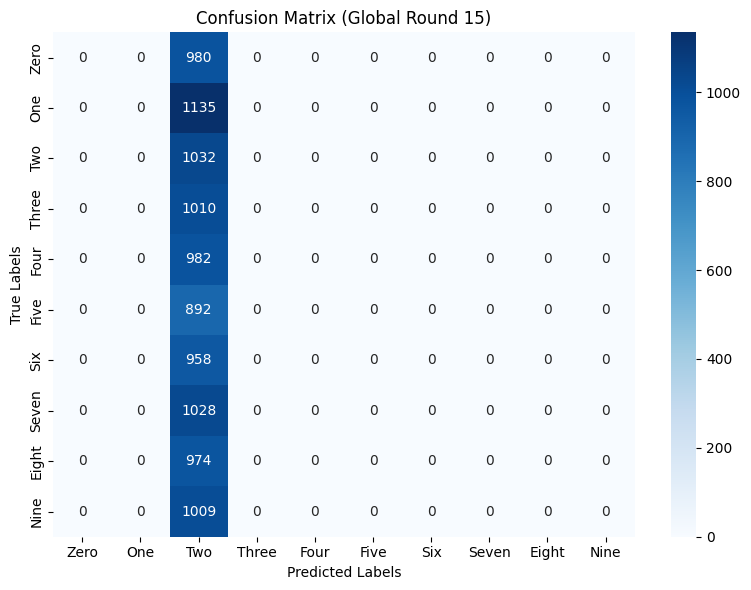


 | Global training round : 16/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 3.7127, Test accuracy: 2539/10000 (25.39%)

Class      - Accuracy
Zero       - 0.0
One        - 99.1
Two        - 48.8
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 40.0
Seven      - 0.0
Eight      - 0.0
Nine       - 52.2


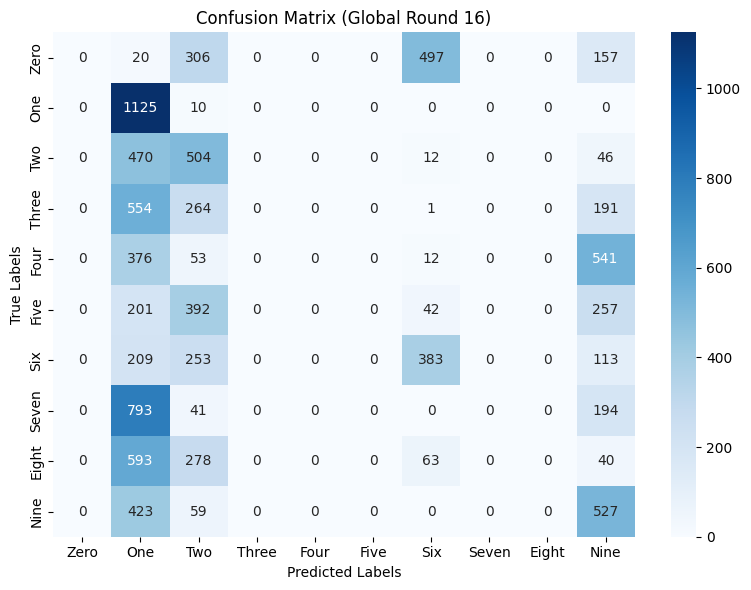


 | Global training round : 17/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 6.8023, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


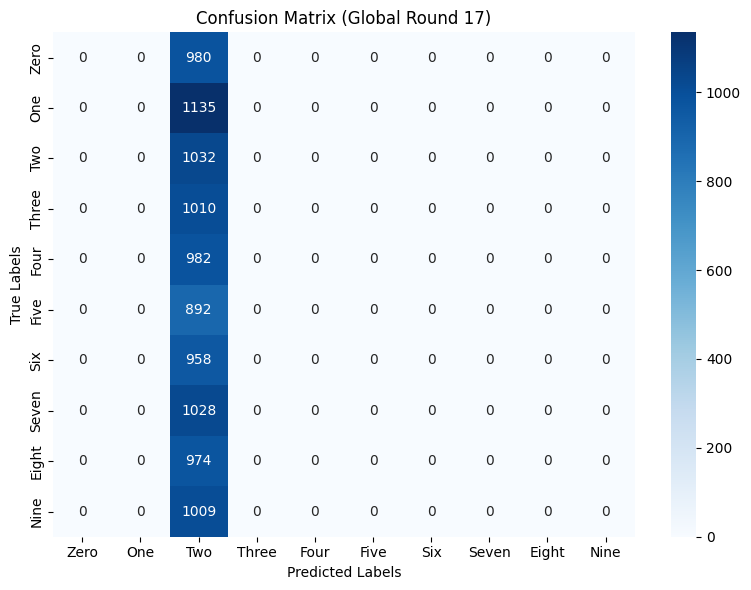


 | Global training round : 18/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 5.5441, Test accuracy: 1342/10000 (13.42%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 18.7
Seven      - 0.0
Eight      - 0.0
Nine       - 2.8


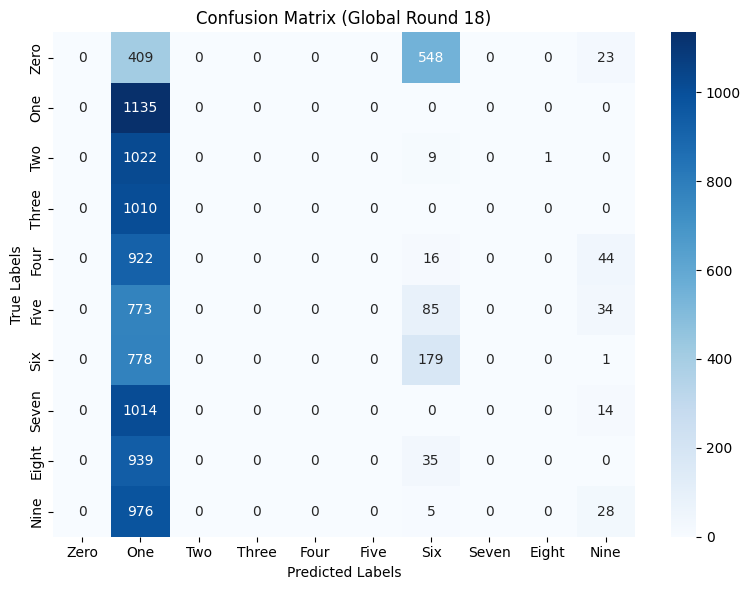


 | Global training round : 19/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 4.2103, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


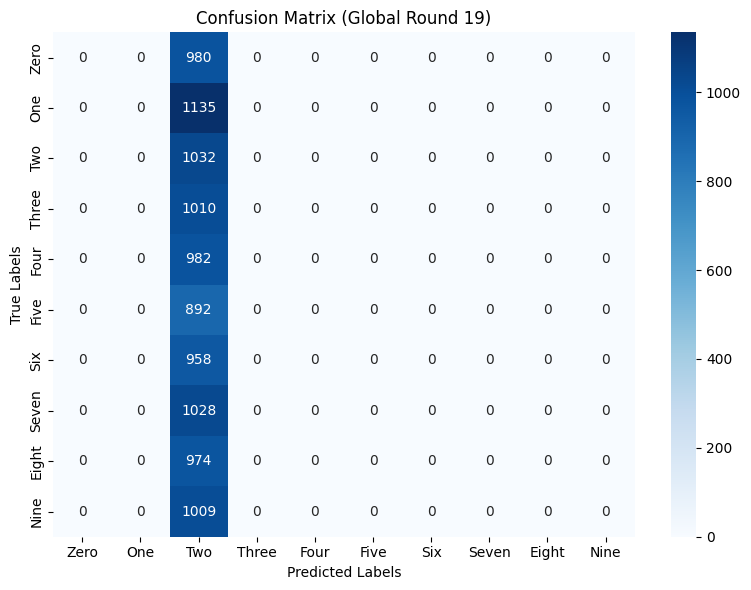


 | Global training round : 20/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 3.4009, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0
Last 10 updates results

Average test loss: 3.4073, Test accuracy: 1032/10000 (10.32%)

***********************************************************************************
Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


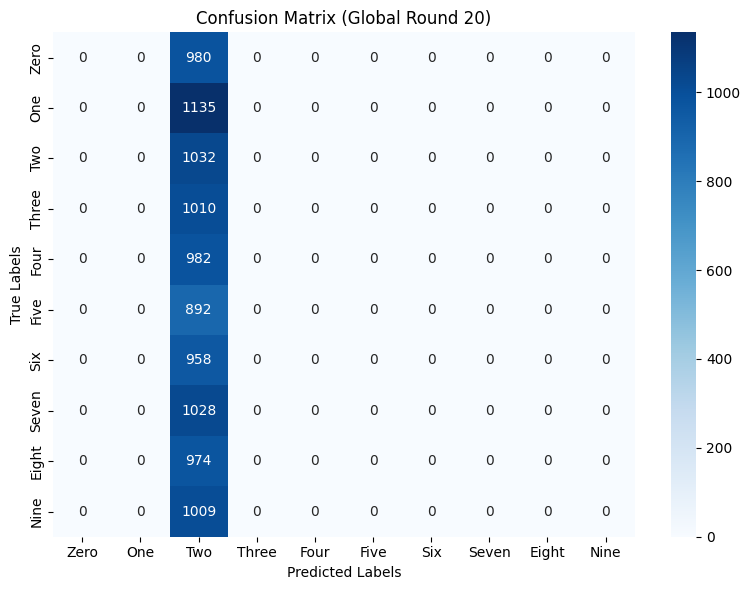

Global accuracies:  [np.float64(10.32), np.float64(9.58), np.float64(10.32), np.float64(10.34), np.float64(10.32), np.float64(11.35), np.float64(10.32), np.float64(10.32), np.float64(10.32), np.float64(11.35), np.float64(10.32), np.float64(15.35), np.float64(10.32), np.float64(11.35), np.float64(10.32), np.float64(25.39), np.float64(10.32), np.float64(13.42), np.float64(10.32), np.float64(10.32), np.float64(10.32)]
Class 7 accuracies:  [np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0)]
Test loss: [np.float64(28.062), np.float64(4.4014), np.float64(2.3581), np.float64(2.4964), np.float64(7.229), np.float64(7.4873), np.float64(3.3341), np.float64(5.1775), np.float64(9.0959), np.float64(

In [ ]:
# Baseline|: FedAvg-no attacks (FL)
RULE = 'fedavg'
ATTACK_TYPE='label_flipping'
MALICIOUS_BEHAVIOR_RATE = 1
for atr in [0, 0.4]:
    run_exp(dataset_name = DATASET_NAME, model_name = MODEL_NAME, dd_type = DD_TYPE, num_peers = NUM_PEERS,
            frac_peers = FRAC_PEERS, seed = SEED, test_batch_size = TEST_BATCH_SIZE,
                criterion = CRITERION, global_rounds = GLOBAL_ROUNDS, local_epochs = LOCAL_EPOCHS, local_bs = LOCAL_BS,
                 local_lr = LOCAL_LR, local_momentum = LOCAL_MOMENTUM, labels_dict = LABELS_DICT, device = DEVICE,
                attackers_ratio = atr, attack_type=ATTACK_TYPE,
                 malicious_behavior_rate = MALICIOUS_BEHAVIOR_RATE, rule = RULE,
                source_class = SOURCE_CLASS, target_class = TARGET_CLASS,
               class_per_peer = CLASS_PER_PEER, samples_per_class = SAMPLES_PER_CLASS,
               rate_unbalance = RATE_UNBALANCE, alpha = ALPHA, resume = False)


--> Label FLIP experiment on our algo...
--> Loading of MNIST dataset
--> Dataset has been loaded!
--> Creating CNNMNIST model.....
--> Model has been created!
--> Distributing training data among peers
--> Training data have been distributed among peers
--> Creating peets instances
Data set: MNIST
Data distribution: EXTREME_NON_IID
Aggregation rule: median
Attack Type: label_flipping
Attackers Ratio: 40.0 %
Malicious Behavior Rate: 100 %

===>Simulation started...

====>Global model training started...



  0%|          | 0/20 [00:00<?, ?it/s]


 | Global training round : 1/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 15.6254, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


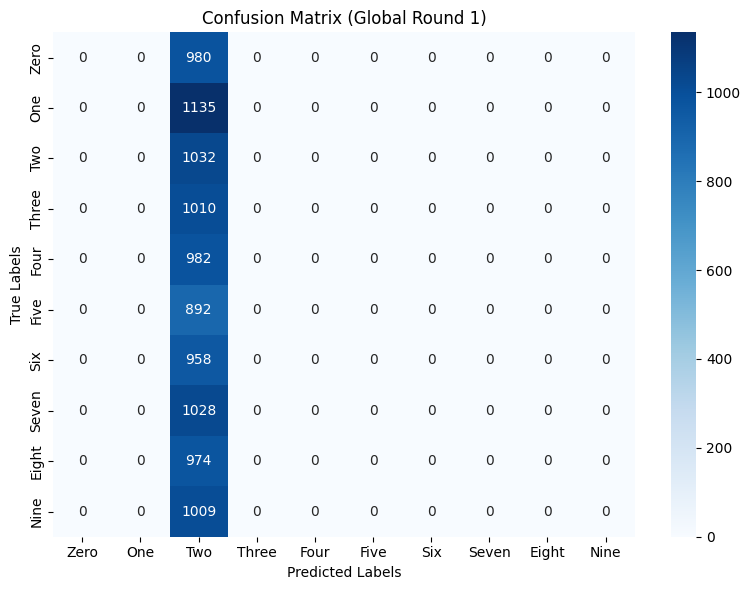


 | Global training round : 2/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 6.0486, Test accuracy: 1009/10000 (10.09%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 100.0


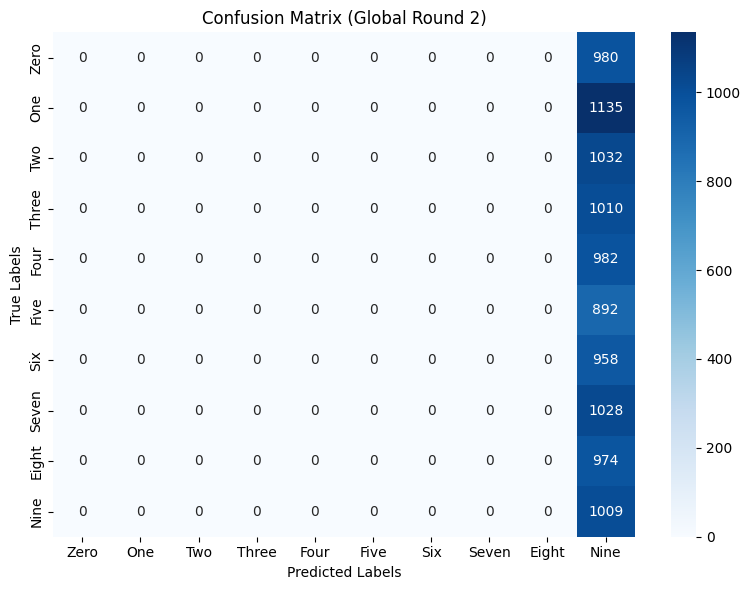


 | Global training round : 3/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 3.9273, Test accuracy: 951/10000 (9.51%)

Class      - Accuracy
Zero       - 0.0
One        - 12.0
Two        - 0.0
Three      - 0.0
Four       - 82.8
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.2
Nine       - 0.0


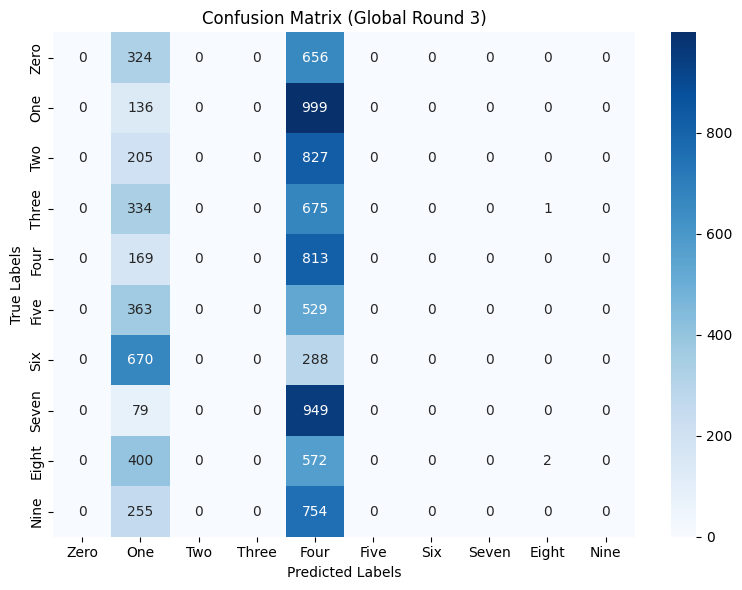


 | Global training round : 4/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 5.3029, Test accuracy: 1468/10000 (14.68%)

Class      - Accuracy
Zero       - 0.0
One        - 80.7
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 56.7
Nine       - 0.0


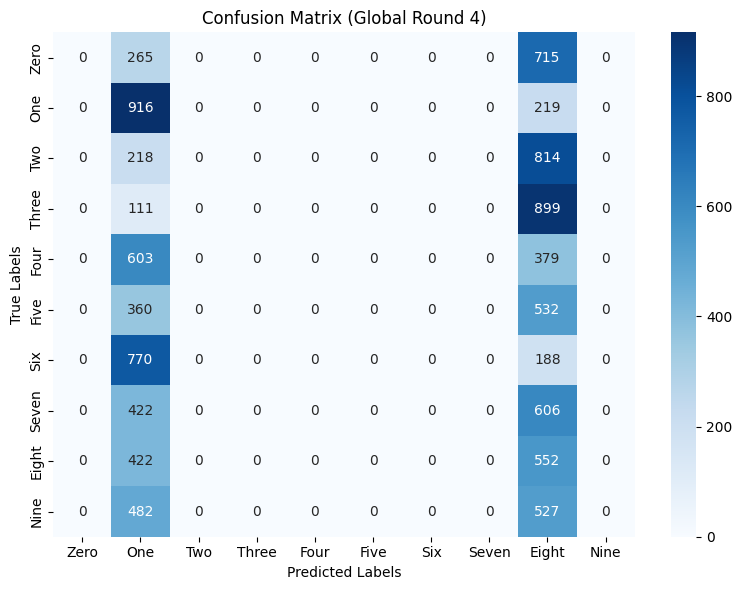


 | Global training round : 5/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 6.6089, Test accuracy: 1239/10000 (12.39%)

Class      - Accuracy
Zero       - 27.2
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 99.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


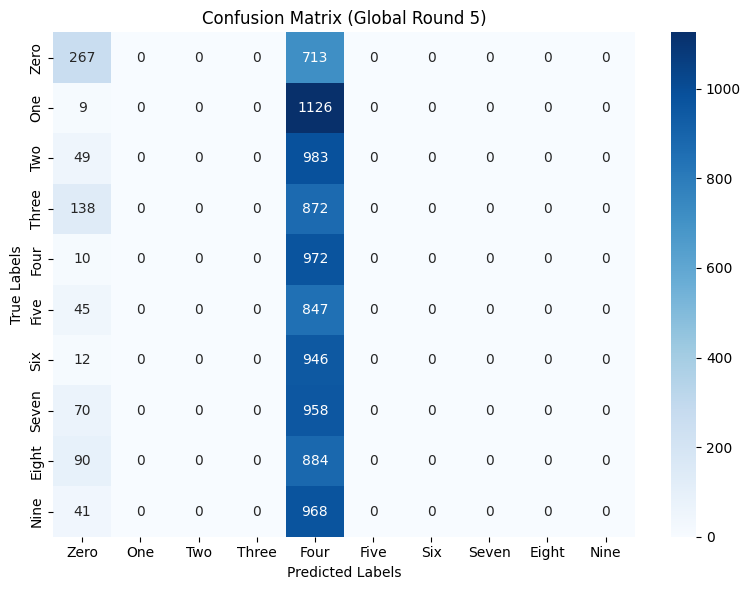


 | Global training round : 6/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 3.8801, Test accuracy: 962/10000 (9.62%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 100.0
Seven      - 0.0
Eight      - 0.4
Nine       - 0.0


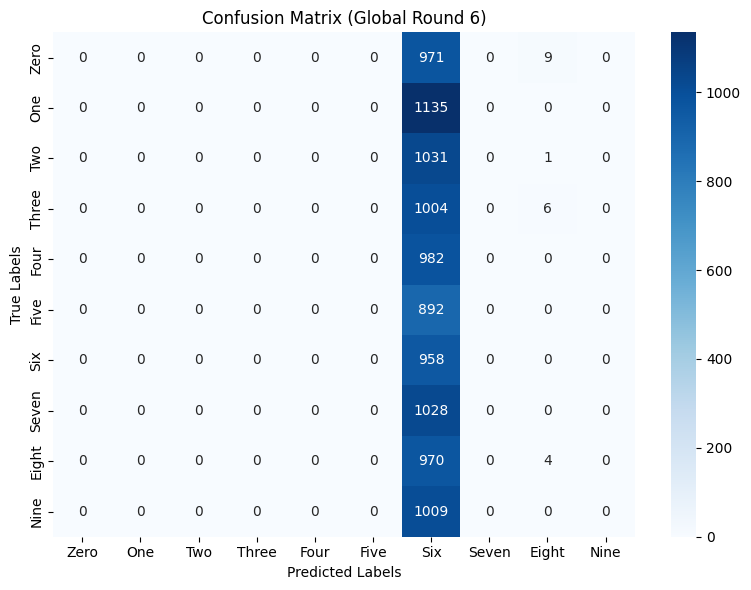


 | Global training round : 7/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 5.8783, Test accuracy: 1009/10000 (10.09%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 100.0


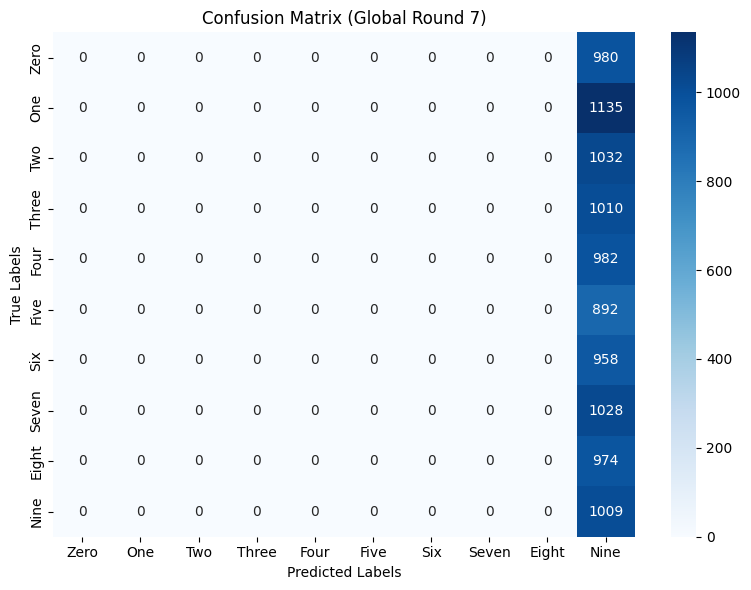


 | Global training round : 8/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 5.6751, Test accuracy: 1028/10000 (10.28%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 100.0
Eight      - 0.0
Nine       - 0.0


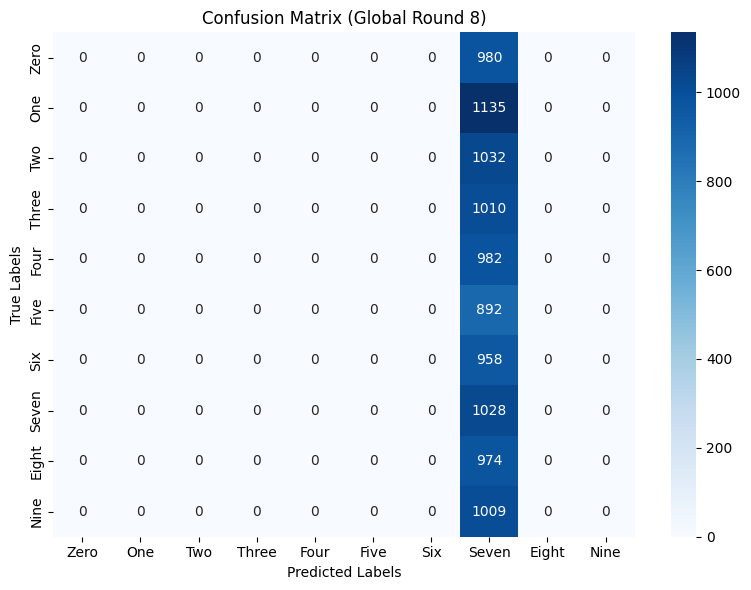


 | Global training round : 9/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 3.1766, Test accuracy: 1010/10000 (10.10%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 100.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


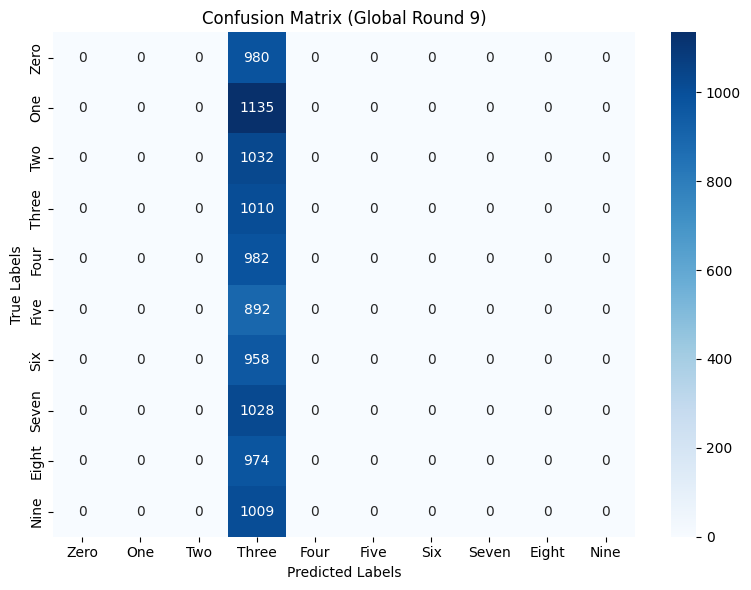


 | Global training round : 10/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 3.8050, Test accuracy: 892/10000 (8.92%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 100.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


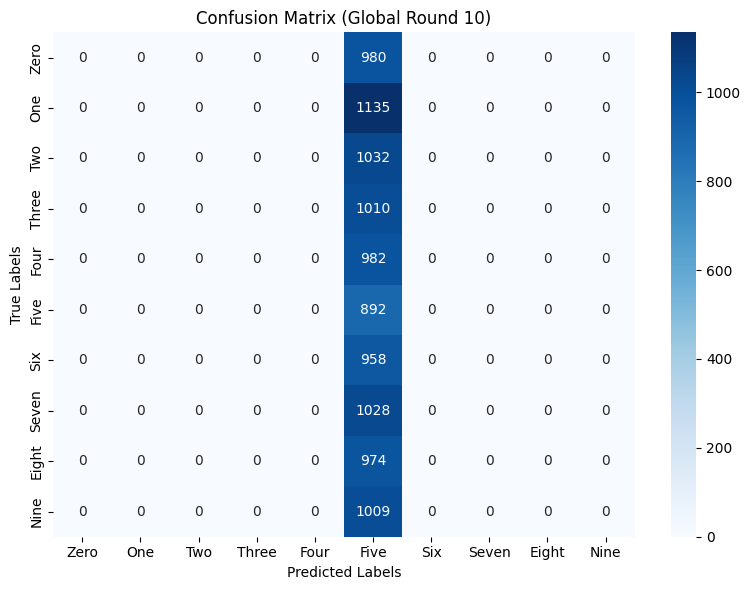


 | Global training round : 11/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 4.3780, Test accuracy: 983/10000 (9.83%)

Class      - Accuracy
Zero       - 100.0
One        - 0.0
Two        - 0.0
Three      - 0.3
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


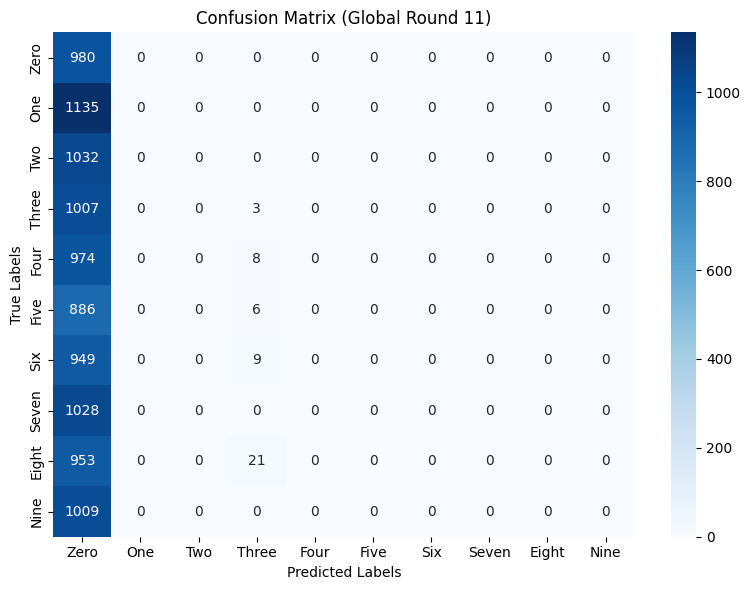


 | Global training round : 12/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 2.9885, Test accuracy: 1135/10000 (11.35%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


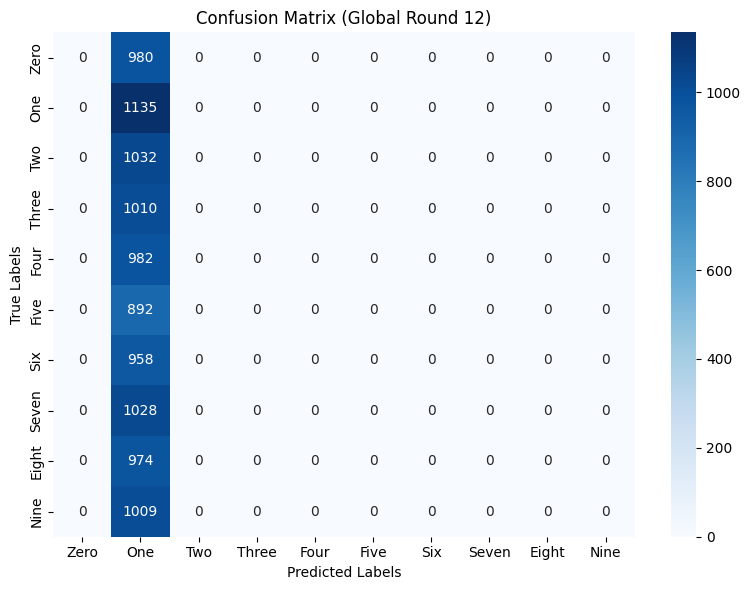


 | Global training round : 13/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 3.4367, Test accuracy: 958/10000 (9.58%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 100.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


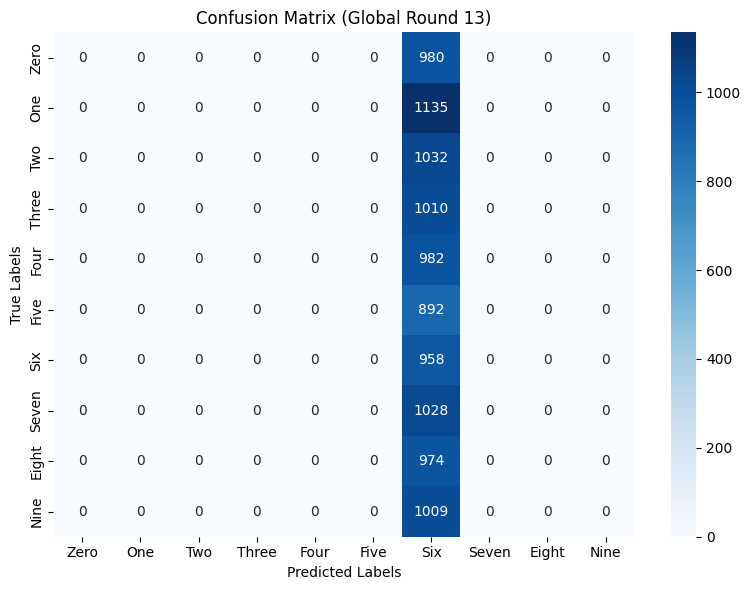


 | Global training round : 14/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 3.2707, Test accuracy: 1010/10000 (10.10%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 100.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


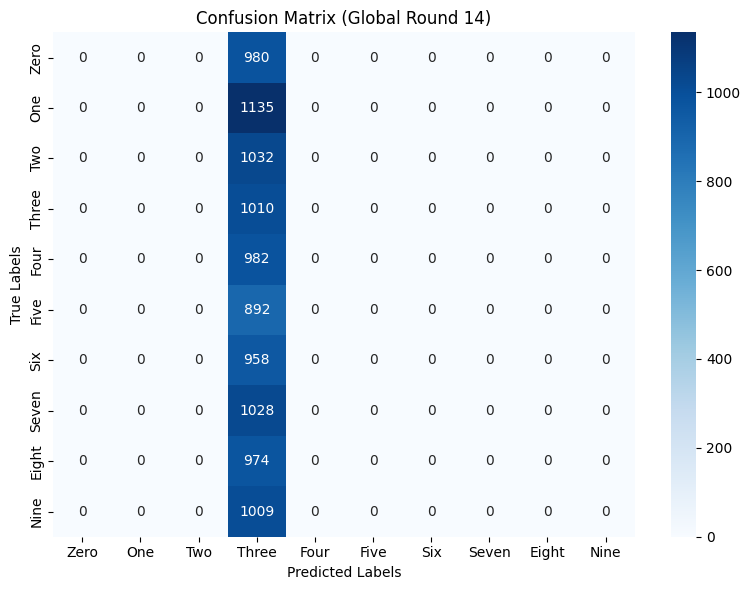


 | Global training round : 15/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 2.6023, Test accuracy: 1028/10000 (10.28%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 100.0
Eight      - 0.0
Nine       - 0.0


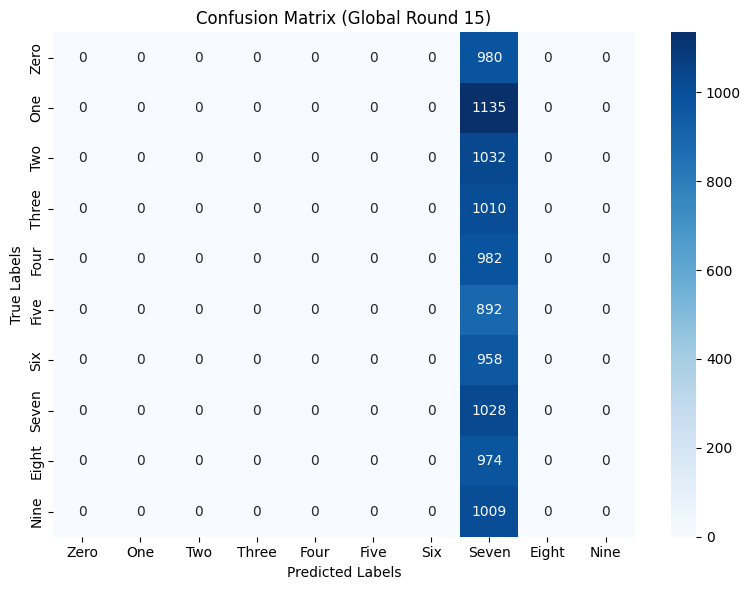


 | Global training round : 16/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 3.2199, Test accuracy: 1135/10000 (11.35%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


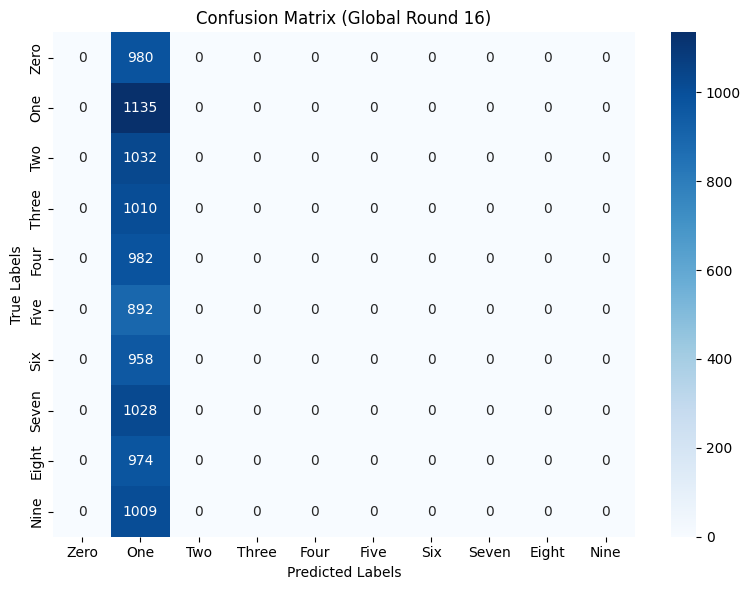


 | Global training round : 17/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 3.4024, Test accuracy: 892/10000 (8.92%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 100.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


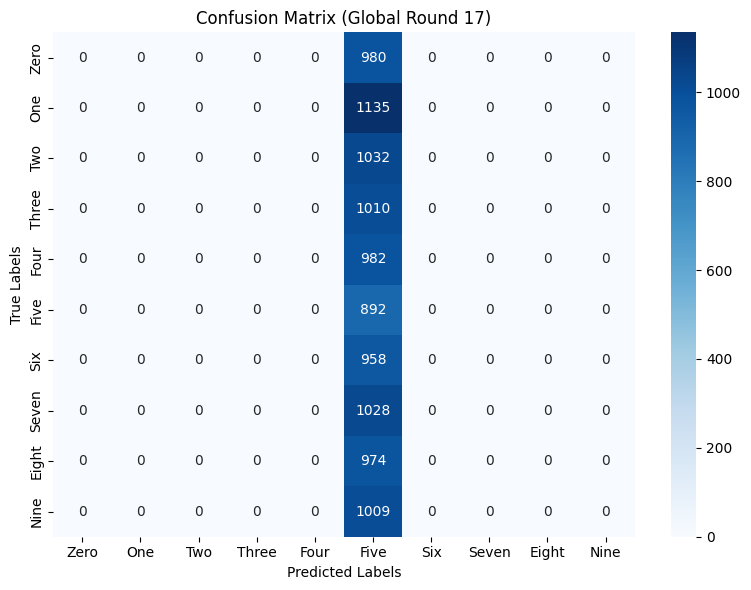


 | Global training round : 18/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 3.4597, Test accuracy: 974/10000 (9.74%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 100.0
Nine       - 0.0


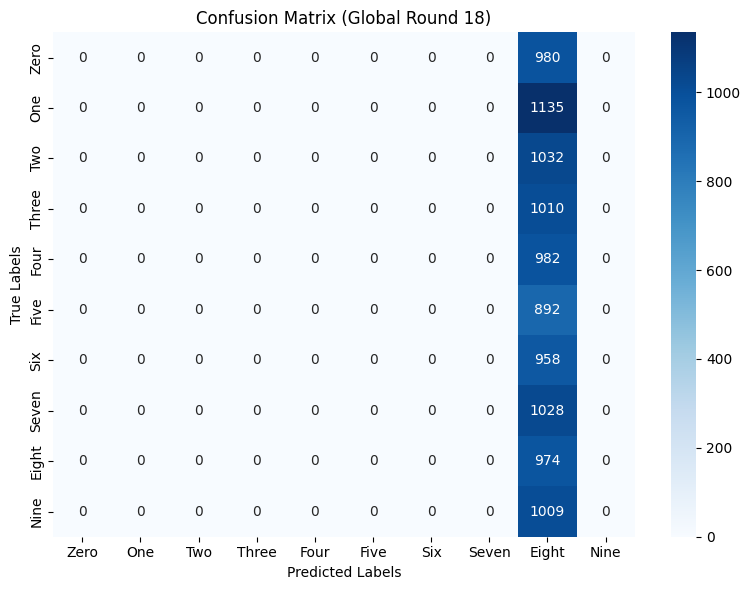


 | Global training round : 19/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 3.6581, Test accuracy: 1179/10000 (11.79%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 14.3
Eight      - 0.0
Nine       - 0.0


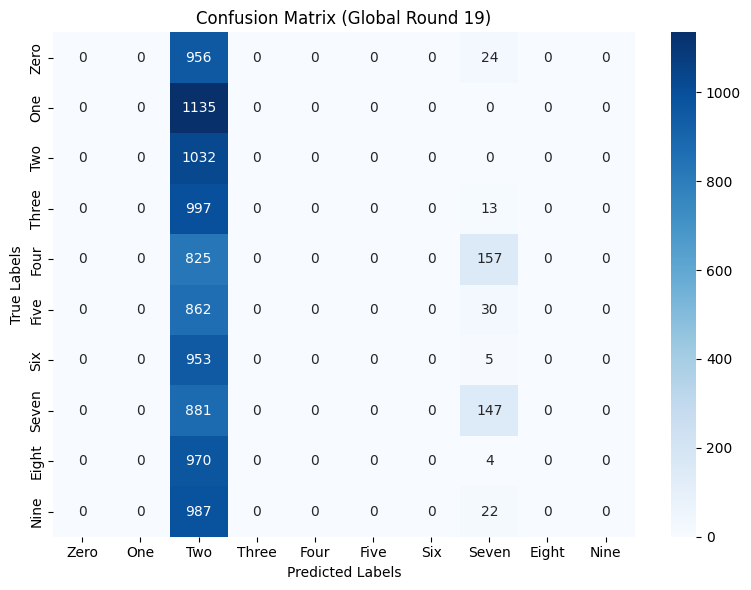


 | Global training round : 20/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 4.0910, Test accuracy: 846/10000 (8.46%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 86.2
Nine       - 0.6
Last 10 updates results

Average test loss: 2.6157, Test accuracy: 1135/10000 (11.35%)

***********************************************************************************
Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


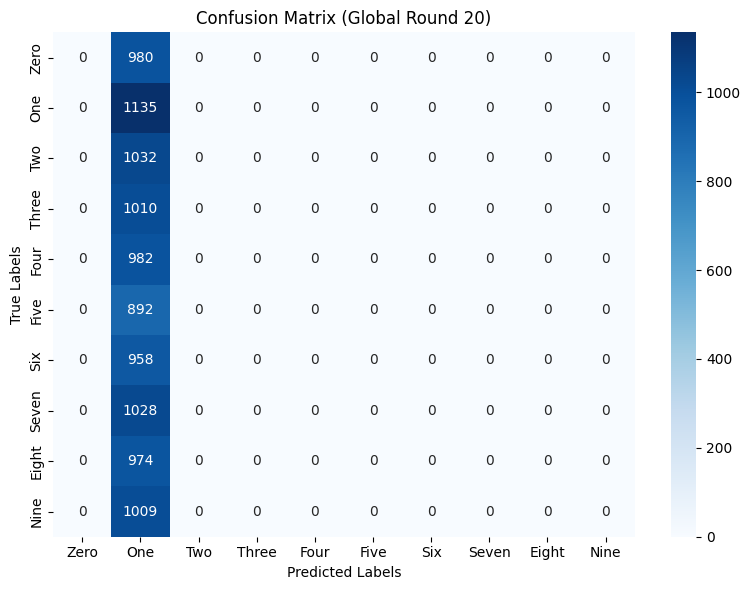

Global accuracies:  [np.float64(10.32), np.float64(10.09), np.float64(9.51), np.float64(14.68), np.float64(12.39), np.float64(9.62), np.float64(10.09), np.float64(10.28), np.float64(10.1), np.float64(8.92), np.float64(9.83), np.float64(11.35), np.float64(9.58), np.float64(10.1), np.float64(10.28), np.float64(11.35), np.float64(8.92), np.float64(9.74), np.float64(11.79), np.float64(8.46), np.float64(11.35)]
Class 7 accuracies:  [np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(100.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(100.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(14.3), np.float64(0.0), np.float64(0.0)]
Test loss: [np.float64(15.6254), np.float64(6.0486), np.float64(3.9273), np.float64(5.3029), np.float64(6.6089), np.float64(3.8801), np.float64(5.8783), np.float64(5.6751), np.float64(3.1766), np.float64(3.

In [ ]:
RULE = 'median'
ATTACK_TYPE='label_flipping'
MALICIOUS_BEHAVIOR_RATE = 1
for atr in [0.4]:
    run_exp(dataset_name = DATASET_NAME, model_name = MODEL_NAME, dd_type = DD_TYPE, num_peers = NUM_PEERS,
            frac_peers = FRAC_PEERS, seed = SEED, test_batch_size = TEST_BATCH_SIZE,
                criterion = CRITERION, global_rounds = GLOBAL_ROUNDS, local_epochs = LOCAL_EPOCHS, local_bs = LOCAL_BS,
                 local_lr = LOCAL_LR, local_momentum = LOCAL_MOMENTUM, labels_dict = LABELS_DICT, device = DEVICE,
                attackers_ratio = atr, attack_type=ATTACK_TYPE,
                 malicious_behavior_rate = MALICIOUS_BEHAVIOR_RATE, rule = RULE,
                source_class = SOURCE_CLASS, target_class = TARGET_CLASS,
               class_per_peer = CLASS_PER_PEER, samples_per_class = SAMPLES_PER_CLASS,
               rate_unbalance = RATE_UNBALANCE, alpha = ALPHA, resume = False)


--> Label FLIP experiment on our algo...
--> Loading of MNIST dataset
--> Dataset has been loaded!
--> Creating CNNMNIST model.....
--> Model has been created!
--> Distributing training data among peers
--> Training data have been distributed among peers
--> Creating peets instances
Data set: MNIST
Data distribution: EXTREME_NON_IID
Aggregation rule: tmean
Attack Type: label_flipping
Attackers Ratio: 40.0 %
Malicious Behavior Rate: 100 %

===>Simulation started...

====>Global model training started...



  0%|          | 0/20 [00:00<?, ?it/s]


 | Global training round : 1/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 27.3214, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


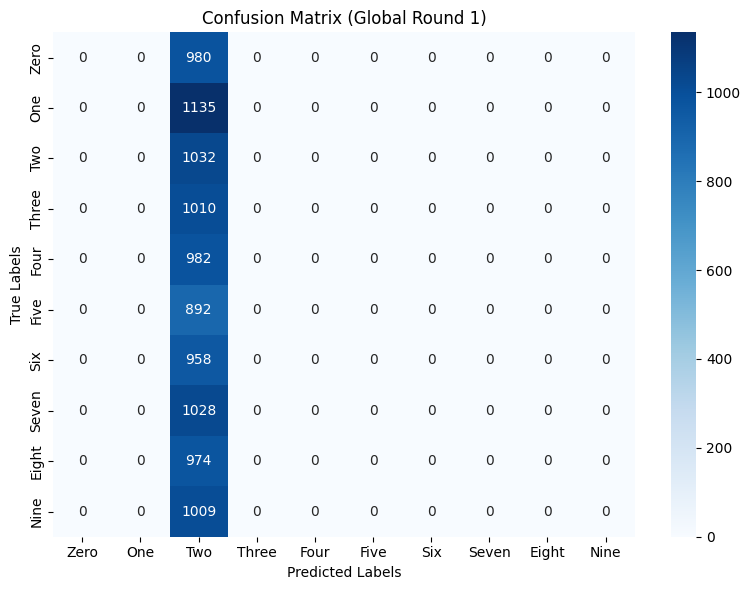


 | Global training round : 2/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 4.6158, Test accuracy: 1135/10000 (11.35%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


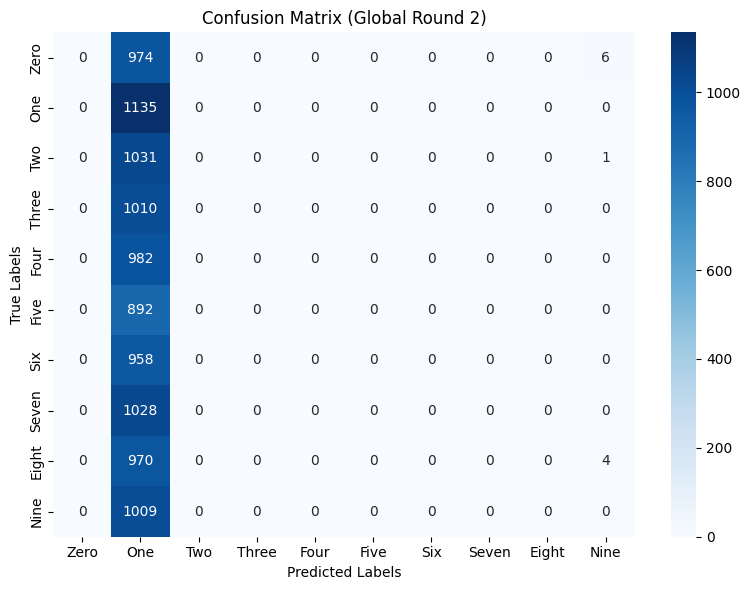


 | Global training round : 3/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 2.3159, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


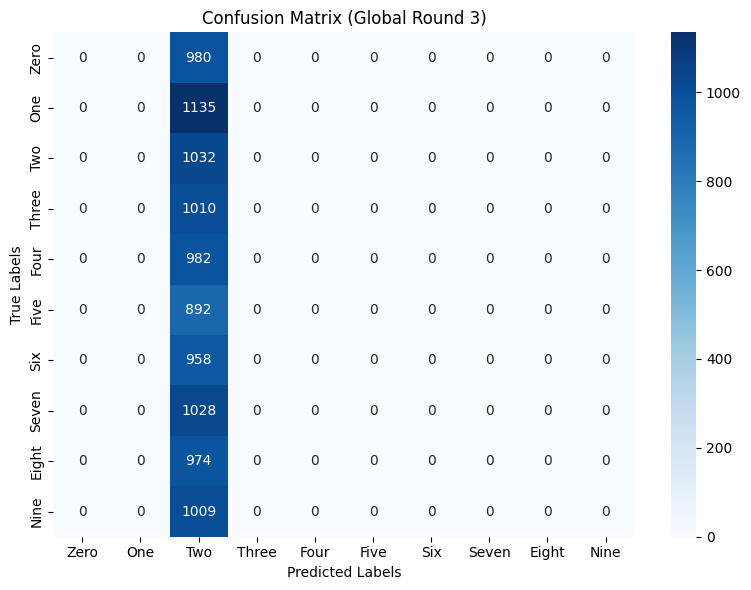


 | Global training round : 4/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 2.3421, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


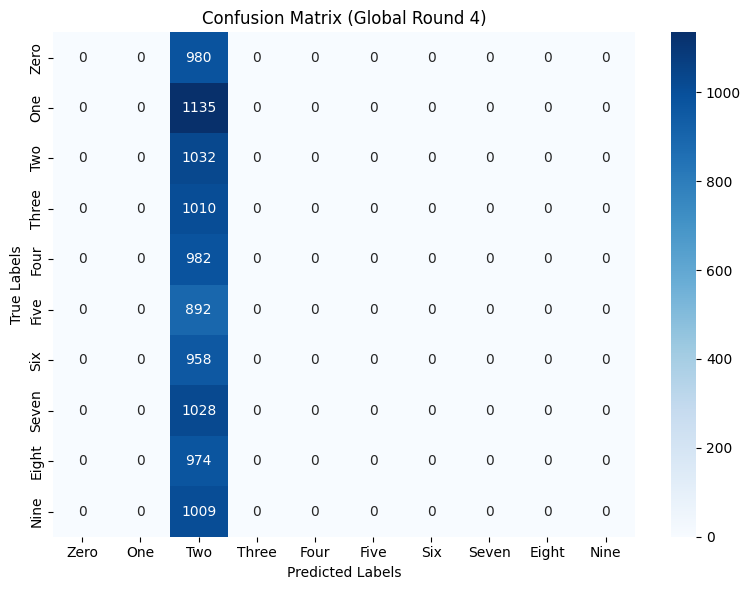


 | Global training round : 5/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 2.3205, Test accuracy: 1009/10000 (10.09%)

Class      - Accuracy
Zero       - 1.5
One        - 0.0
Two        - 96.3
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


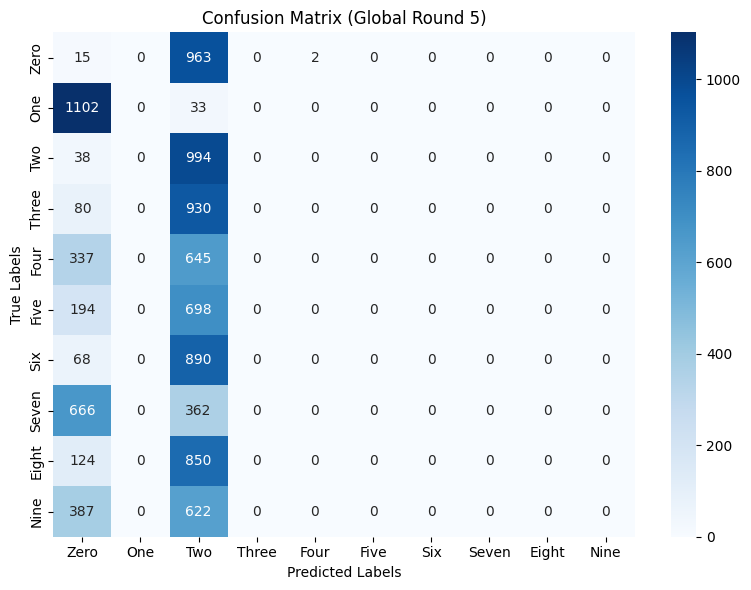


 | Global training round : 6/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 5.8391, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


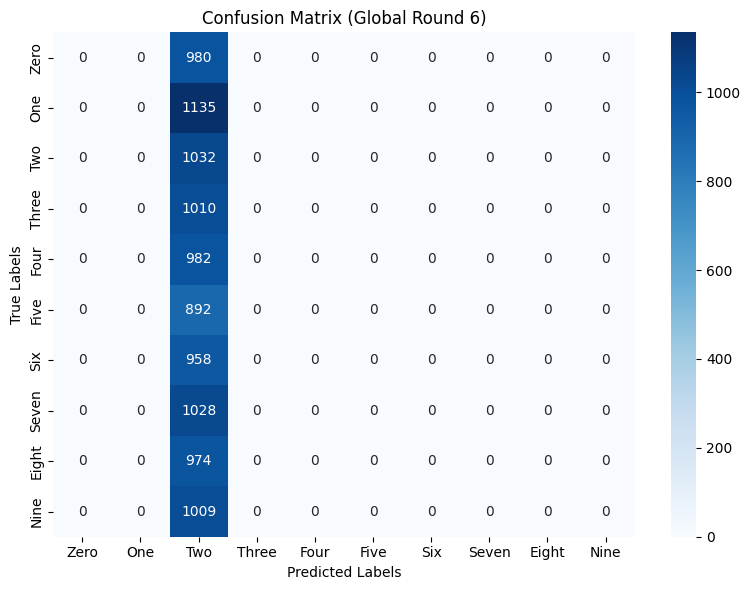


 | Global training round : 7/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 3.8693, Test accuracy: 1135/10000 (11.35%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


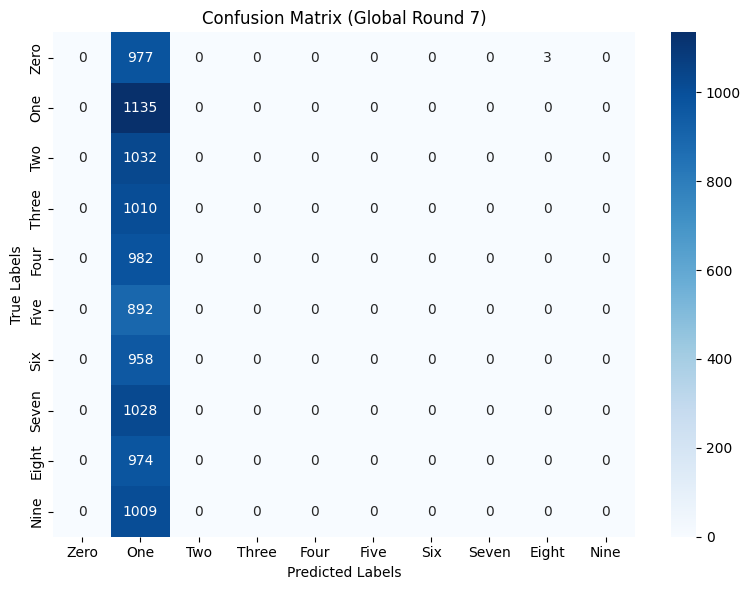


 | Global training round : 8/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 2.5583, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


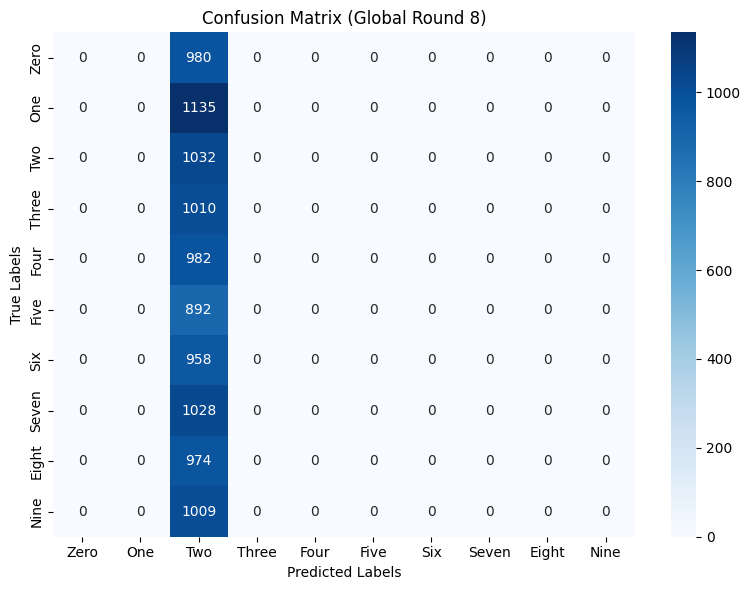


 | Global training round : 9/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 4.3155, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


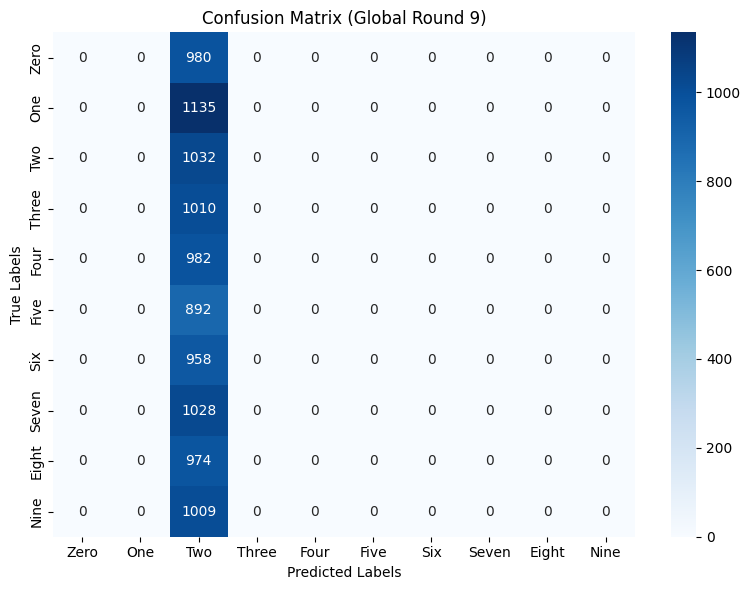


 | Global training round : 10/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 3.1064, Test accuracy: 992/10000 (9.92%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 98.1
Five       - 0.0
Six        - 0.0
Seven      - 2.8
Eight      - 0.0
Nine       - 0.0


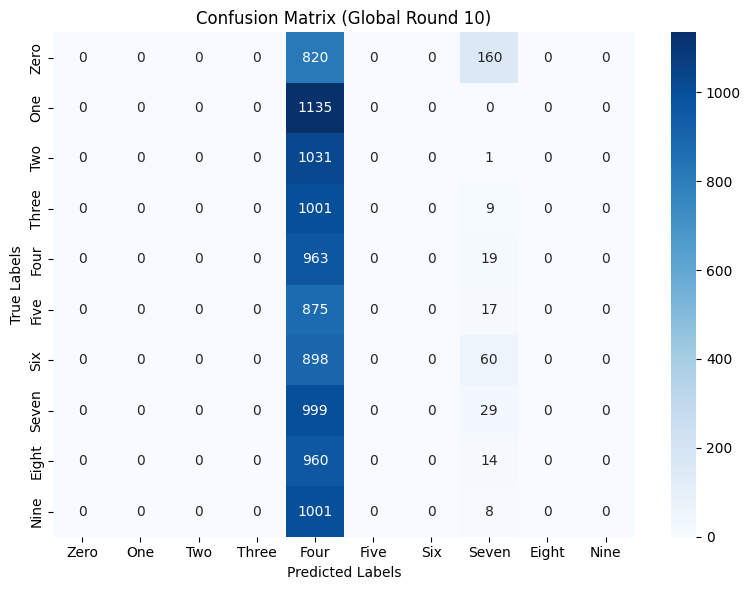


 | Global training round : 11/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 4.4326, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


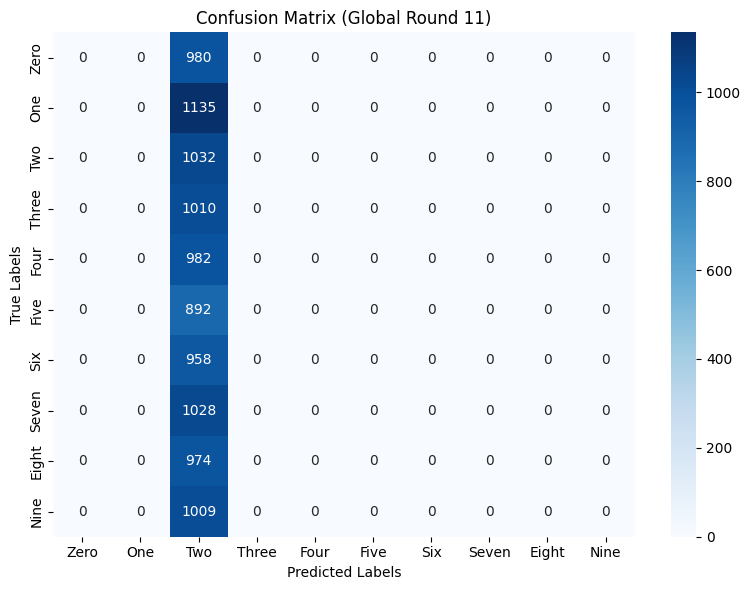


 | Global training round : 12/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 2.8843, Test accuracy: 1135/10000 (11.35%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


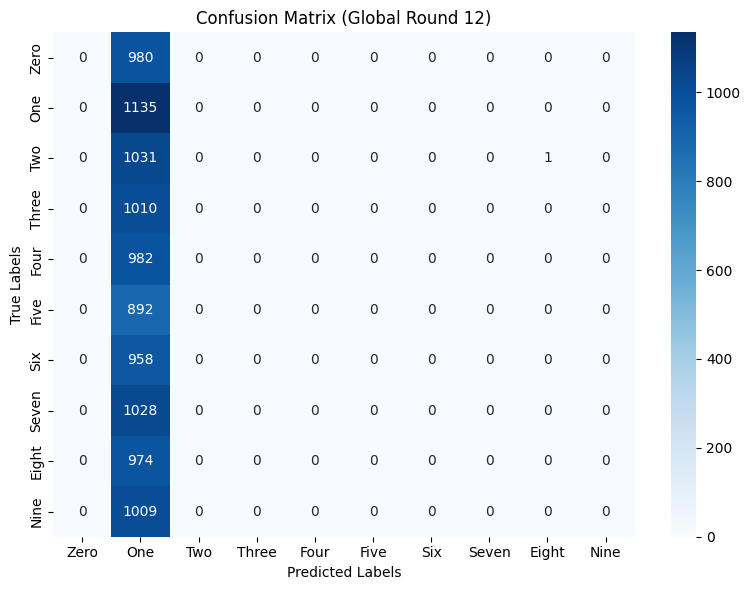


 | Global training round : 13/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 7.0409, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


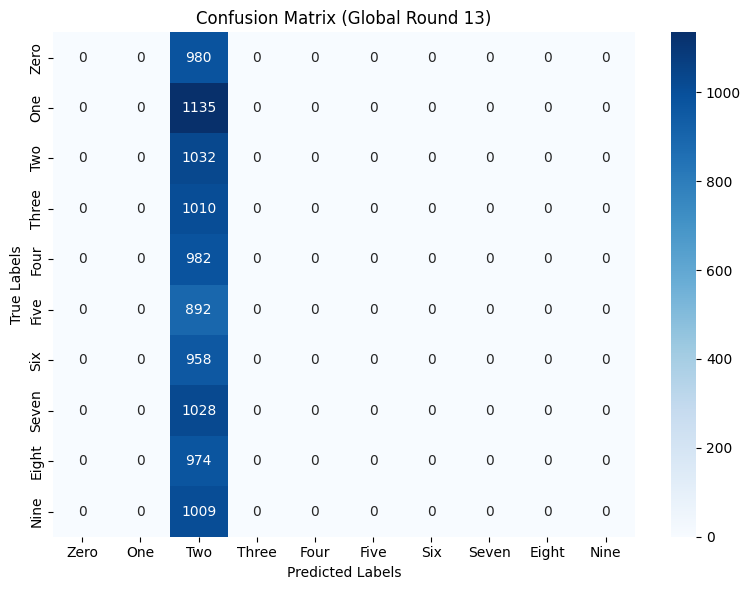


 | Global training round : 14/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 3.2347, Test accuracy: 978/10000 (9.78%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 82.9
Five       - 0.0
Six        - 13.2
Seven      - 0.0
Eight      - 0.0
Nine       - 3.8


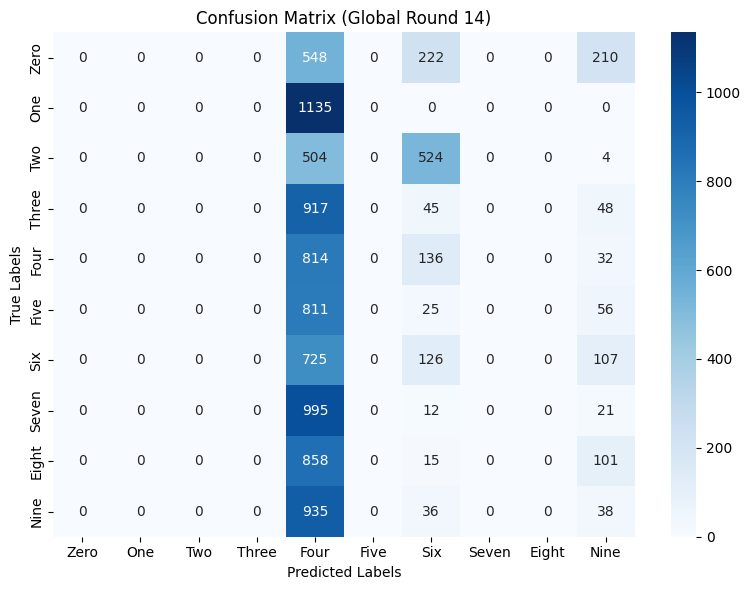


 | Global training round : 15/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 2.4875, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


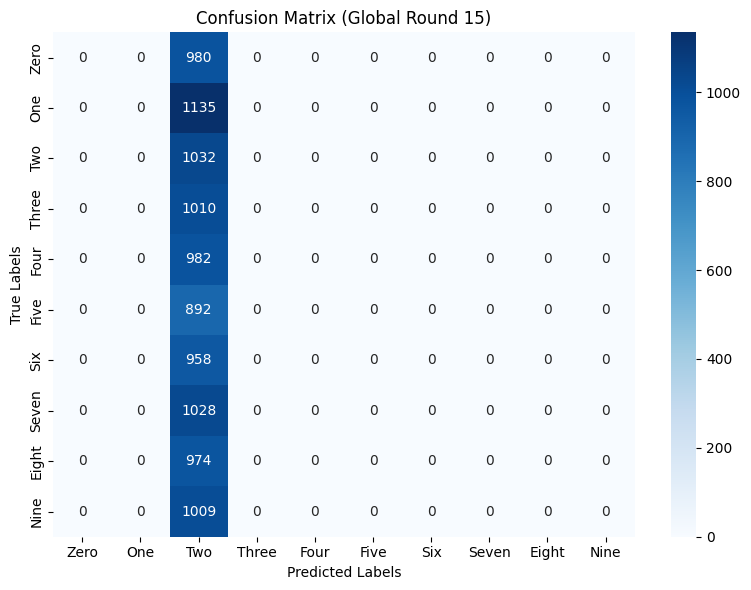


 | Global training round : 16/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 2.5116, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


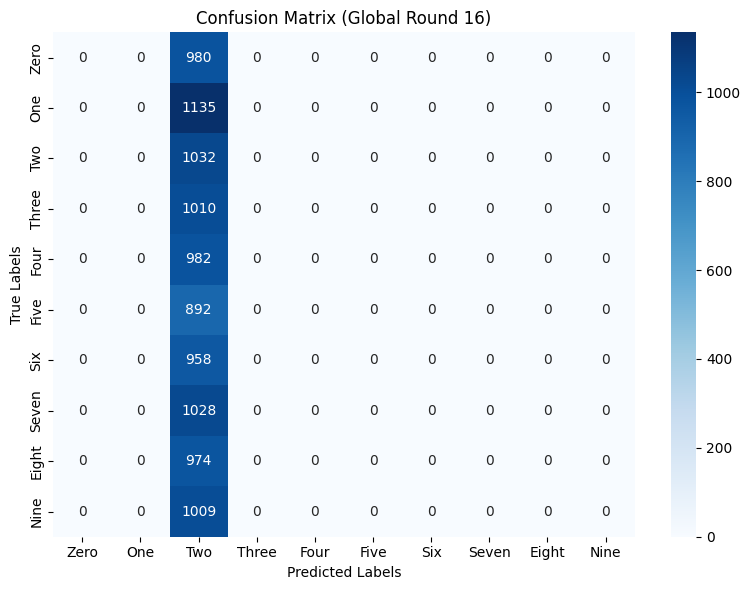


 | Global training round : 17/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 2.4408, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


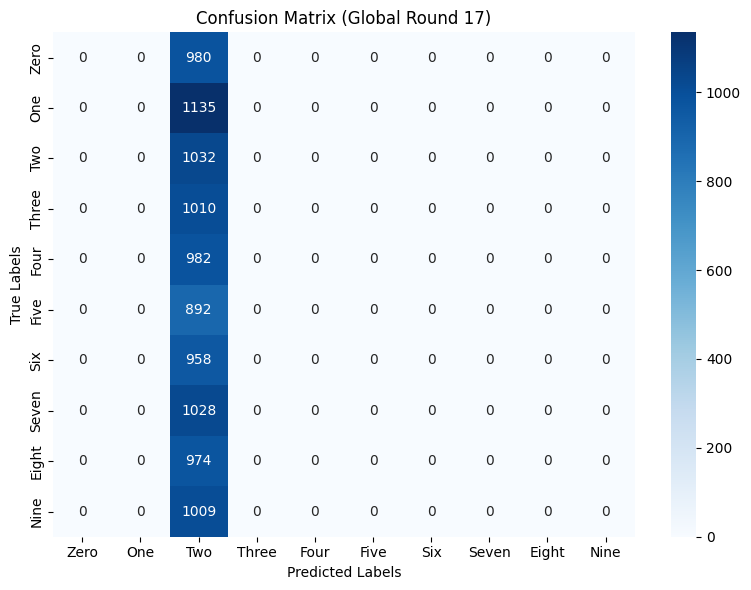


 | Global training round : 18/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 3.3668, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


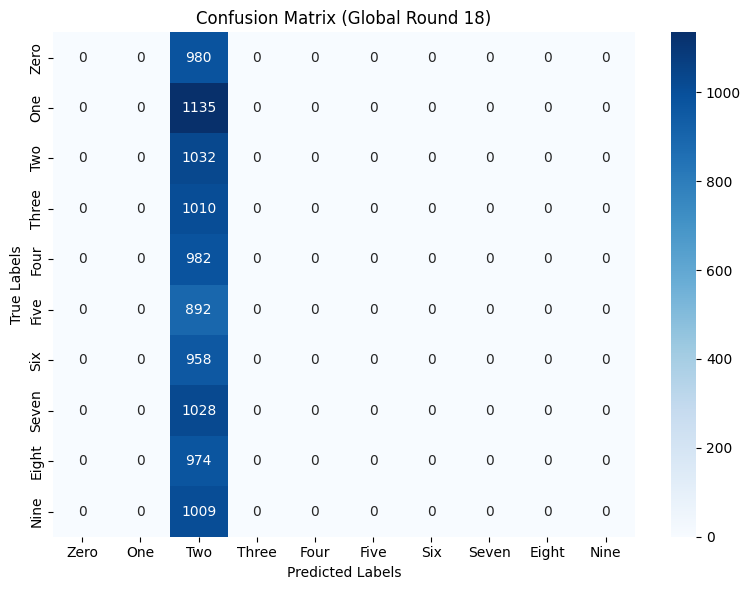


 | Global training round : 19/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 4.0307, Test accuracy: 1009/10000 (10.09%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 100.0


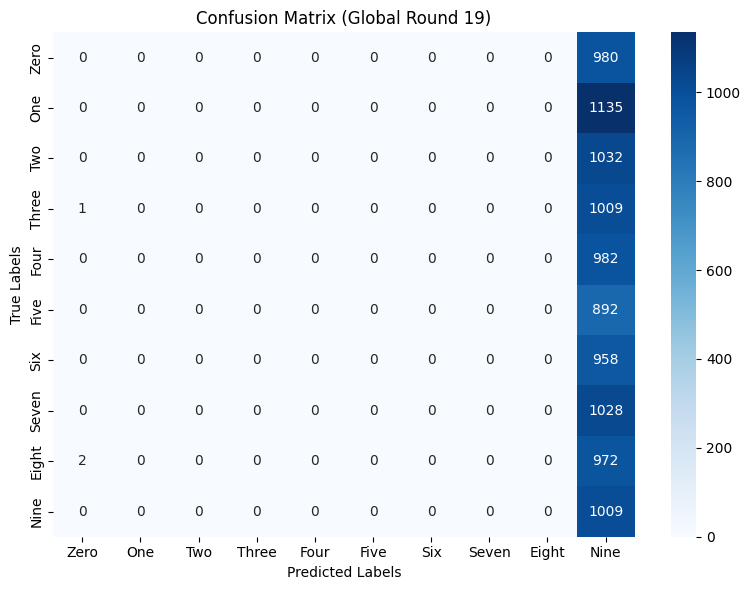


 | Global training round : 20/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 5.8152, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0
Last 10 updates results

Average test loss: 2.4286, Test accuracy: 1032/10000 (10.32%)

***********************************************************************************
Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


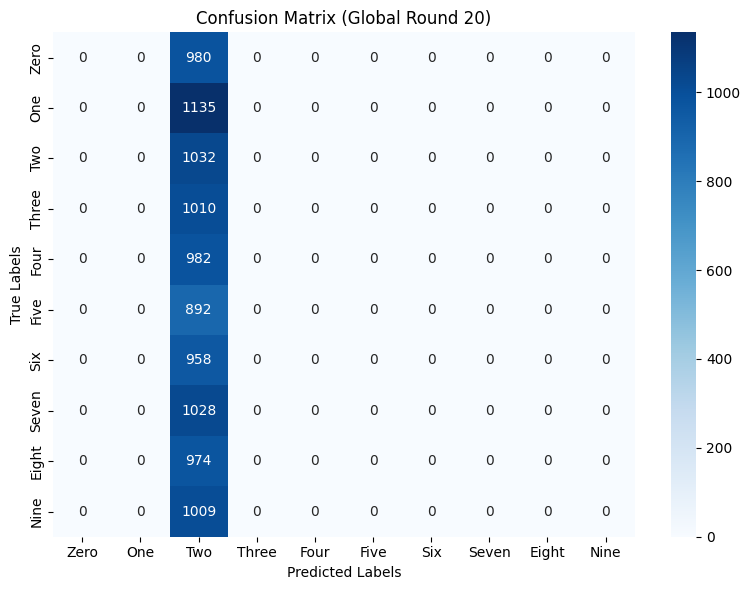

Global accuracies:  [np.float64(10.32), np.float64(11.35), np.float64(10.32), np.float64(10.32), np.float64(10.09), np.float64(10.32), np.float64(11.35), np.float64(10.32), np.float64(10.32), np.float64(9.92), np.float64(10.32), np.float64(11.35), np.float64(10.32), np.float64(9.78), np.float64(10.32), np.float64(10.32), np.float64(10.32), np.float64(10.32), np.float64(10.09), np.float64(10.32), np.float64(10.32)]
Class 7 accuracies:  [np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(2.82), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0)]
Test loss: [np.float64(27.3214), np.float64(4.6158), np.float64(2.3159), np.float64(2.3421), np.float64(2.3205), np.float64(5.8391), np.float64(3.8693), np.float64(2.5583), np.float64(4.3155), np.float6

In [ ]:
RULE = 'tmean'
ATTACK_TYPE='label_flipping'
MALICIOUS_BEHAVIOR_RATE = 1
for atr in [0.4]:
    run_exp(dataset_name = DATASET_NAME, model_name = MODEL_NAME, dd_type = DD_TYPE, num_peers = NUM_PEERS,
            frac_peers = FRAC_PEERS, seed = SEED, test_batch_size = TEST_BATCH_SIZE,
                criterion = CRITERION, global_rounds = GLOBAL_ROUNDS, local_epochs = LOCAL_EPOCHS, local_bs = LOCAL_BS,
                 local_lr = LOCAL_LR, local_momentum = LOCAL_MOMENTUM, labels_dict = LABELS_DICT, device = DEVICE,
                attackers_ratio = atr, attack_type=ATTACK_TYPE,
                 malicious_behavior_rate = MALICIOUS_BEHAVIOR_RATE, rule = RULE,
                source_class = SOURCE_CLASS, target_class = TARGET_CLASS,
               class_per_peer = CLASS_PER_PEER, samples_per_class = SAMPLES_PER_CLASS,
               rate_unbalance = RATE_UNBALANCE, alpha = ALPHA, resume = False)


--> Label FLIP experiment on our algo...
--> Loading of MNIST dataset
--> Dataset has been loaded!
--> Creating CNNMNIST model.....
--> Model has been created!
--> Distributing training data among peers
--> Training data have been distributed among peers
--> Creating peets instances
Data set: MNIST
Data distribution: EXTREME_NON_IID
Aggregation rule: mkrum
Attack Type: label_flipping
Attackers Ratio: 40.0 %
Malicious Behavior Rate: 100 %

===>Simulation started...

====>Global model training started...



  0%|          | 0/20 [00:00<?, ?it/s]


 | Global training round : 1/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 94.5846, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


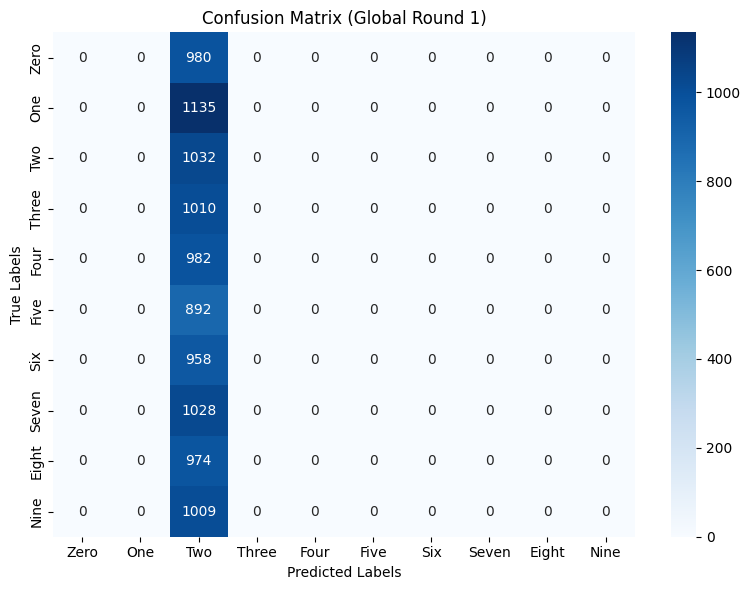


 | Global training round : 2/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 5.8596, Test accuracy: 1135/10000 (11.35%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


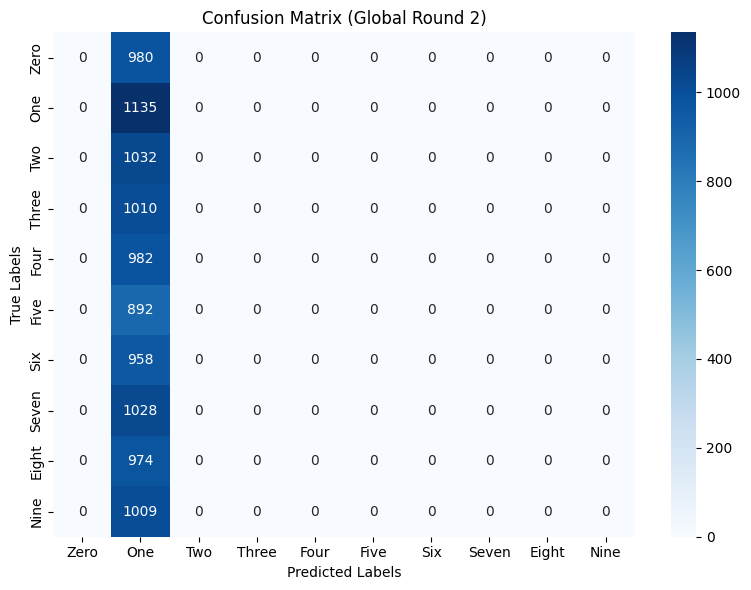


 | Global training round : 3/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 19.8078, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


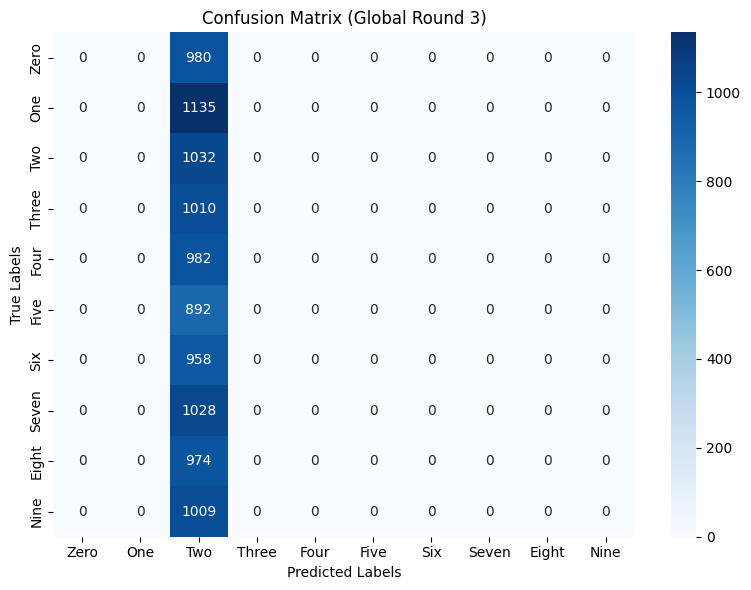


 | Global training round : 4/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 4.4498, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


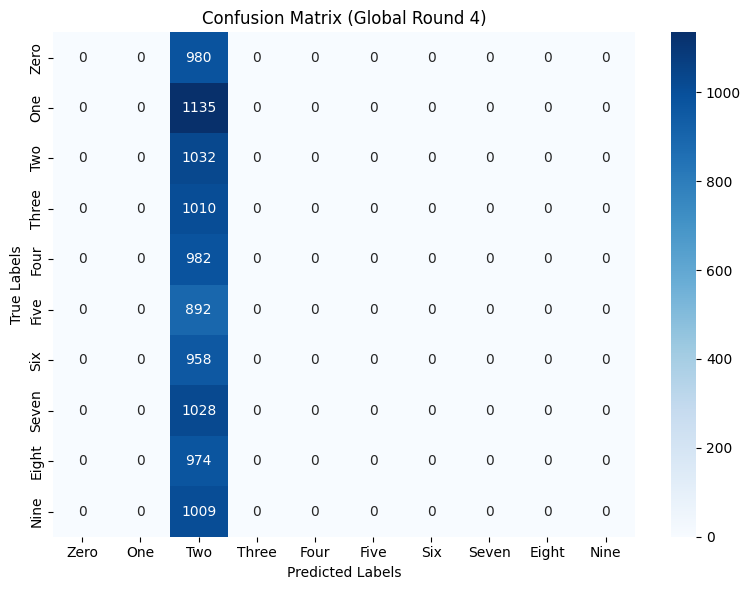


 | Global training round : 5/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 13.6246, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


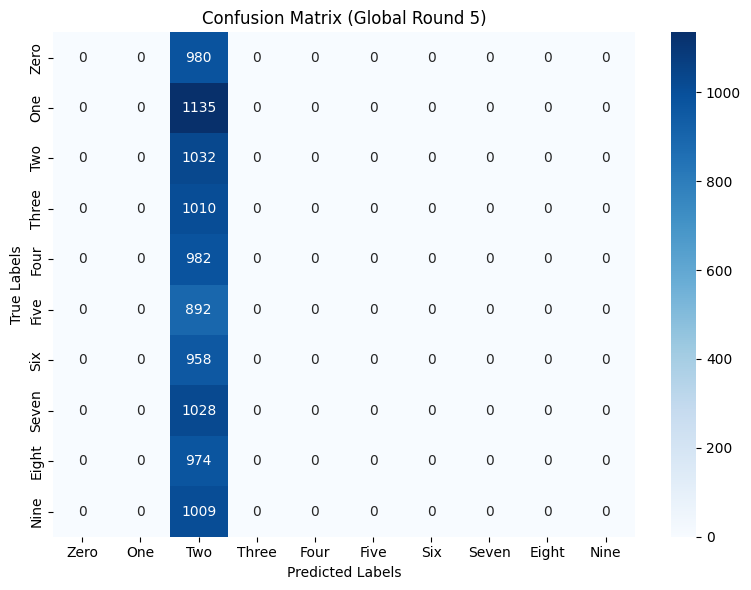


 | Global training round : 6/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 5.7897, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


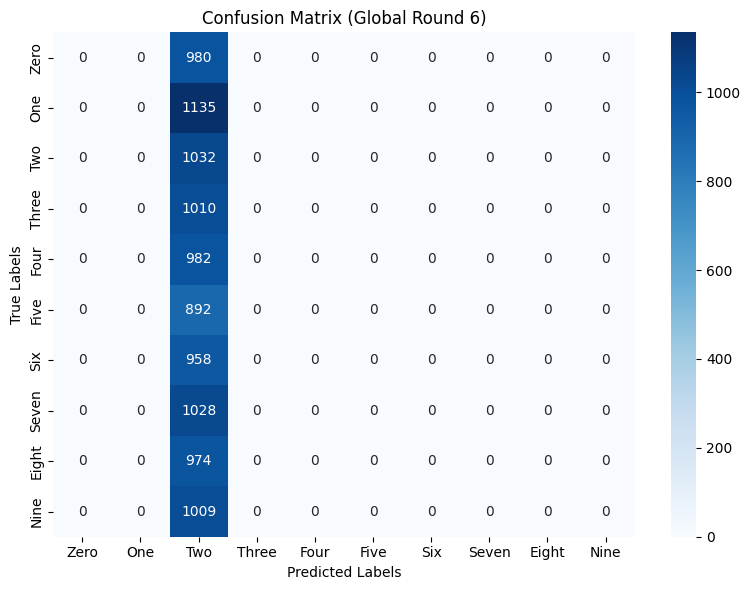


 | Global training round : 7/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 11.3137, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


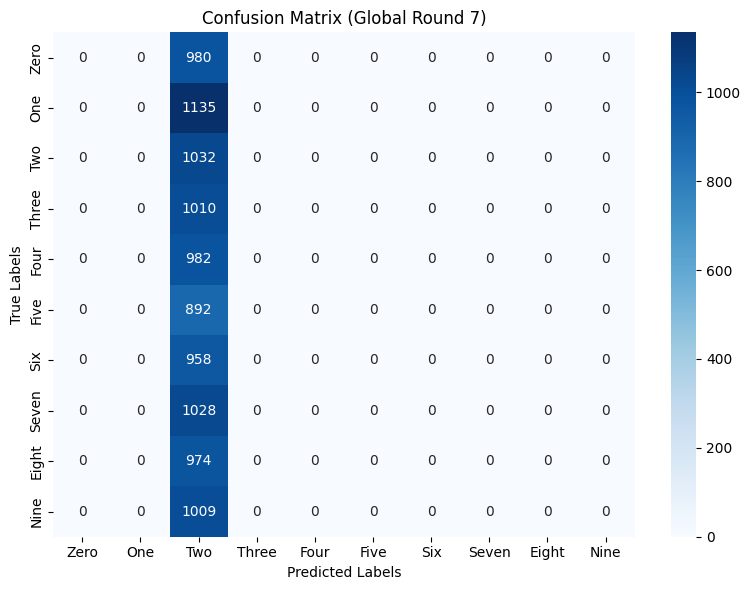


 | Global training round : 8/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 7.5456, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


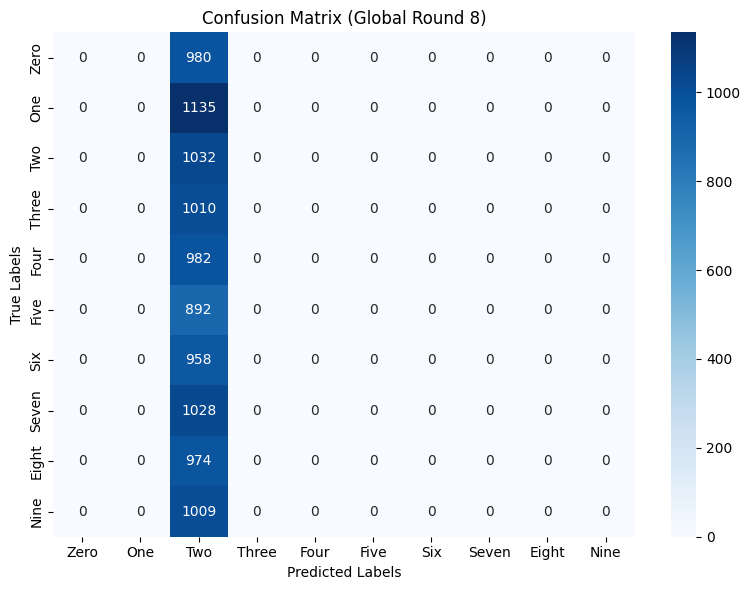


 | Global training round : 9/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 12.6362, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


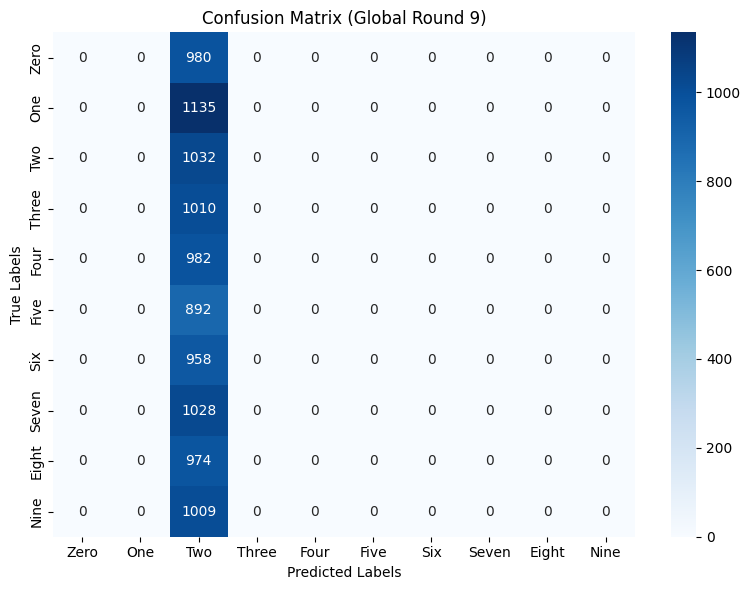


 | Global training round : 10/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 10.7371, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


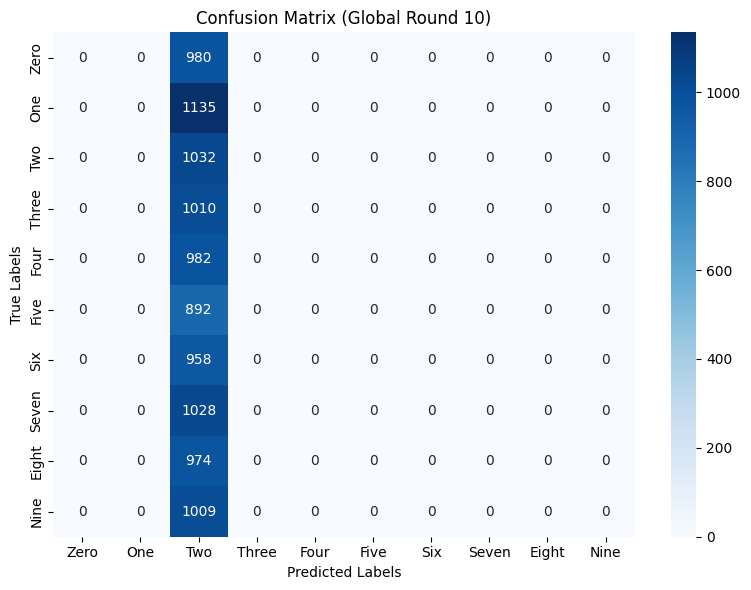


 | Global training round : 11/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 14.7730, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


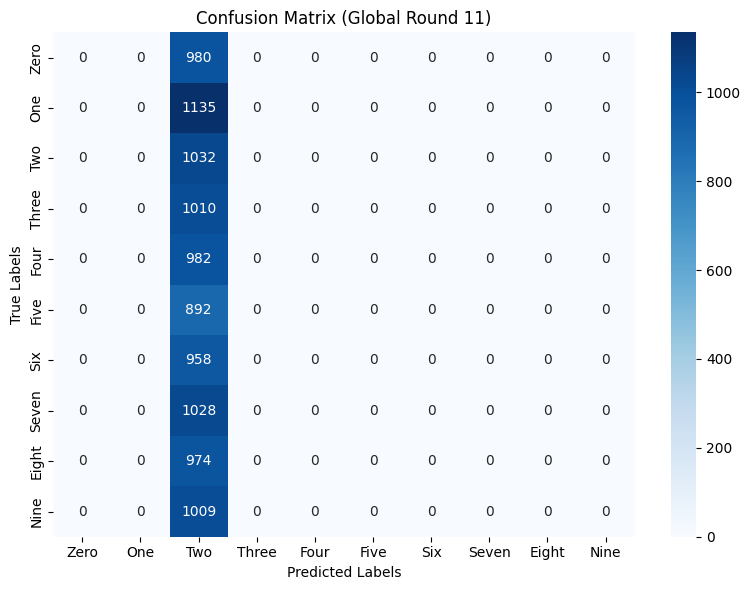


 | Global training round : 12/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 12.8863, Test accuracy: 1169/10000 (11.69%)

Class      - Accuracy
Zero       - 0.0
One        - 12.1
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


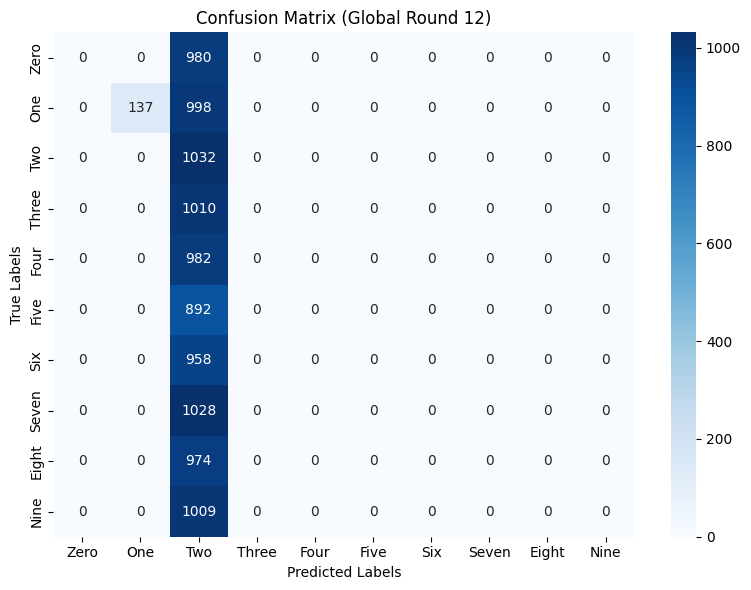


 | Global training round : 13/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 18.3467, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


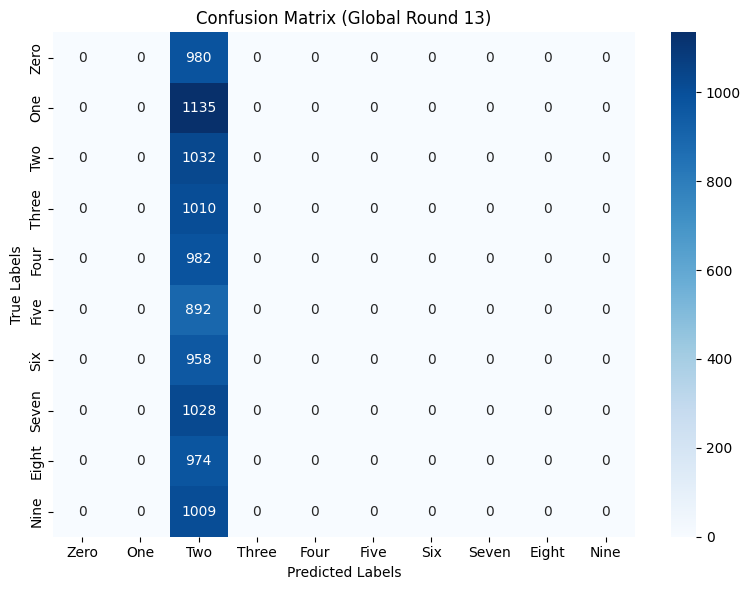


 | Global training round : 14/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 12.5591, Test accuracy: 2119/10000 (21.19%)

Class      - Accuracy
Zero       - 0.0
One        - 95.8
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


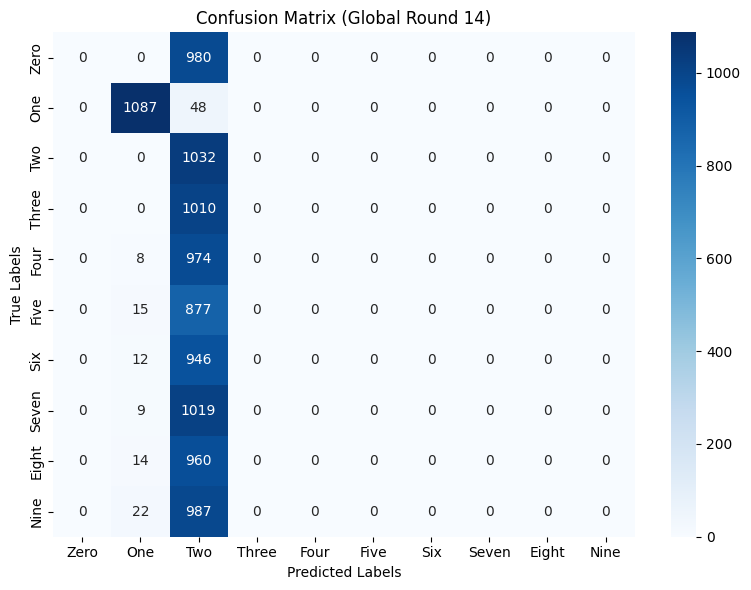


 | Global training round : 15/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 23.5550, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


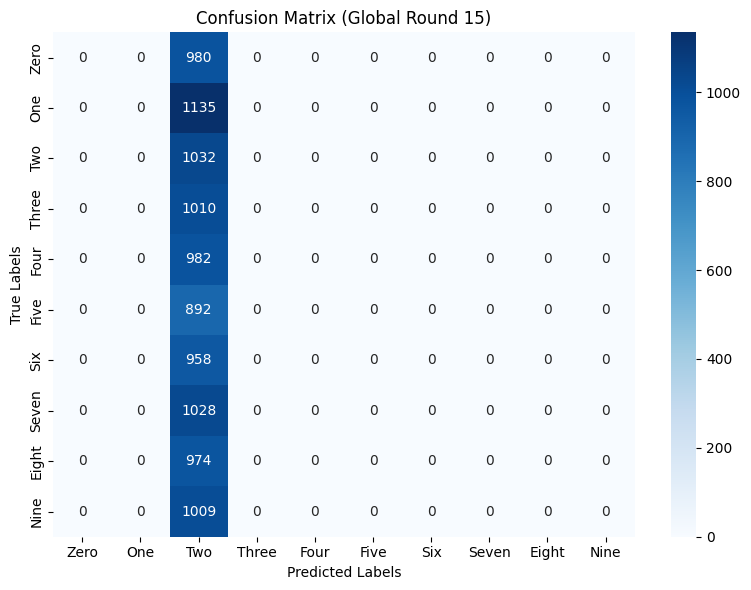


 | Global training round : 16/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 12.1308, Test accuracy: 2104/10000 (21.04%)

Class      - Accuracy
Zero       - 0.0
One        - 94.4
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


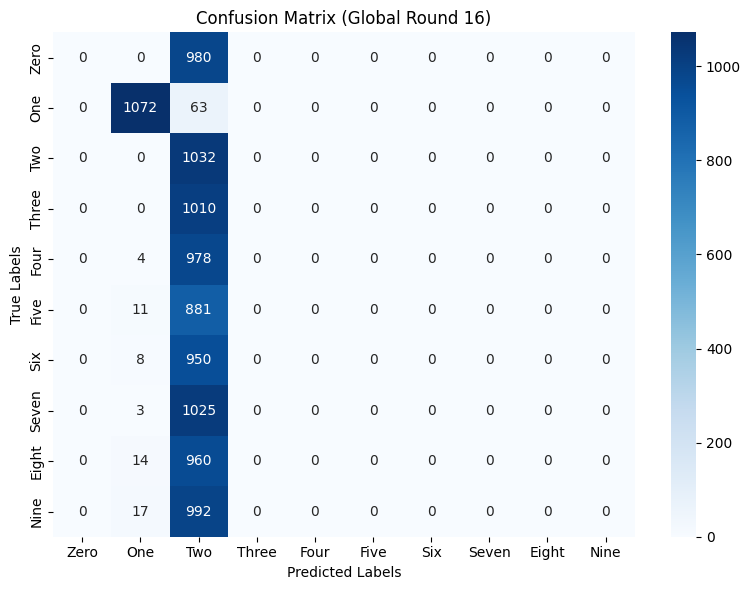


 | Global training round : 17/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 21.4650, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


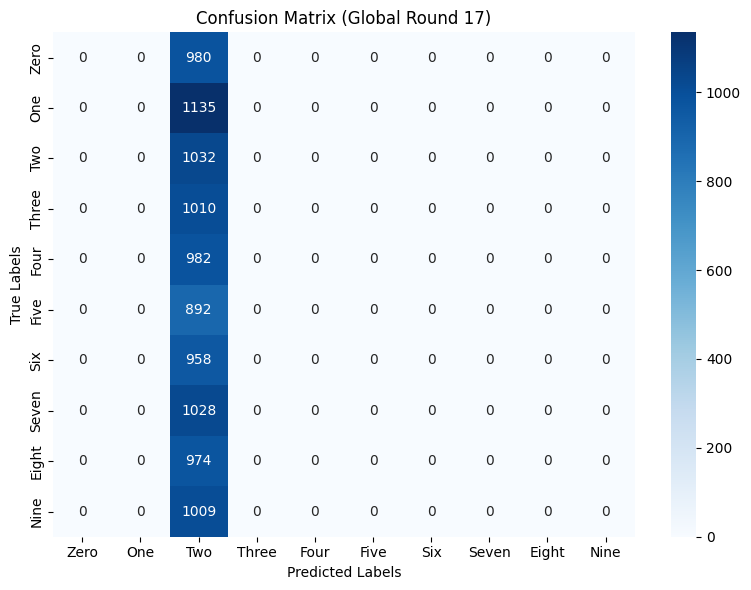


 | Global training round : 18/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 13.6597, Test accuracy: 2132/10000 (21.32%)

Class      - Accuracy
Zero       - 0.0
One        - 96.9
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


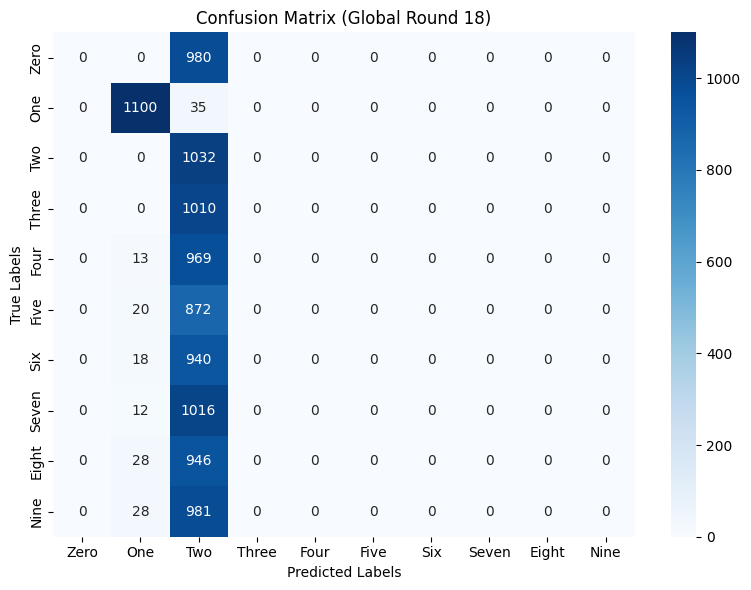


 | Global training round : 19/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 21.6724, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


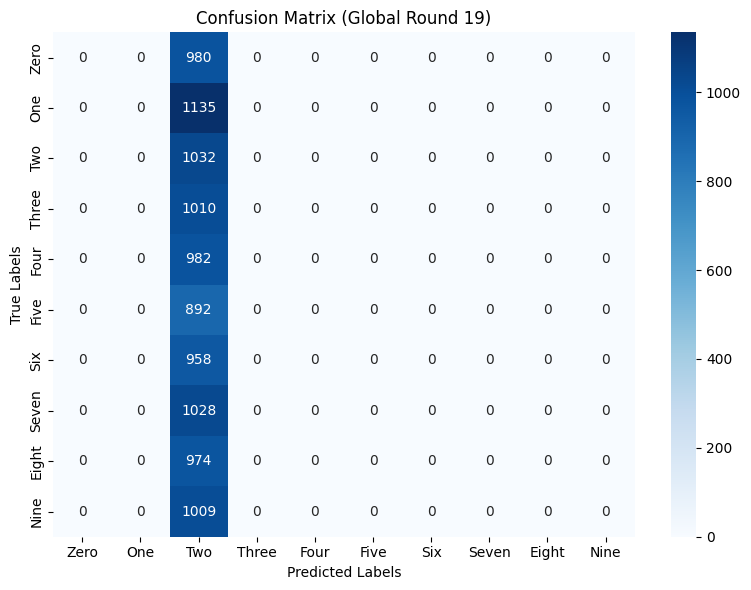


 | Global training round : 20/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1

Average test loss: 14.8716, Test accuracy: 2138/10000 (21.38%)

Class      - Accuracy
Zero       - 0.0
One        - 97.4
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0
Last 10 updates results

Average test loss: 16.2195, Test accuracy: 1043/10000 (10.43%)

***********************************************************************************
Class      - Accuracy
Zero       - 0.0
One        - 1.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


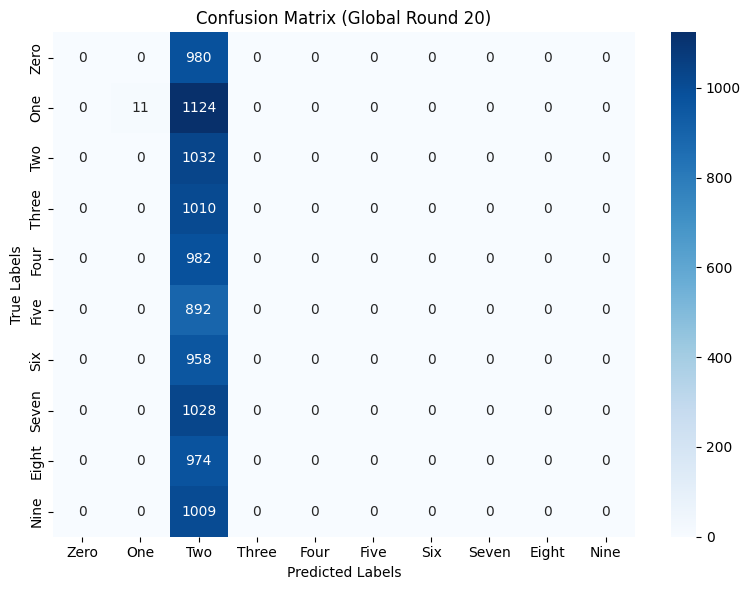

Global accuracies:  [np.float64(10.32), np.float64(11.35), np.float64(10.32), np.float64(10.32), np.float64(10.32), np.float64(10.32), np.float64(10.32), np.float64(10.32), np.float64(10.32), np.float64(10.32), np.float64(10.32), np.float64(11.69), np.float64(10.32), np.float64(21.19), np.float64(10.32), np.float64(21.04), np.float64(10.32), np.float64(21.32), np.float64(10.32), np.float64(21.38), np.float64(10.43)]
Class 7 accuracies:  [np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0)]
Test loss: [np.float64(94.5846), np.float64(5.8596), np.float64(19.8078), np.float64(4.4498), np.float64(13.6246), np.float64(5.7897), np.float64(11.3137), np.float64(7.5456), np.float64(12.6362), np.f

In [ ]:
RULE = 'mkrum'
ATTACK_TYPE='label_flipping'
MALICIOUS_BEHAVIOR_RATE = 1
for atr in [0.4]:
    run_exp(dataset_name = DATASET_NAME, model_name = MODEL_NAME, dd_type = DD_TYPE, num_peers = NUM_PEERS,
            frac_peers = FRAC_PEERS, seed = SEED, test_batch_size = TEST_BATCH_SIZE,
                criterion = CRITERION, global_rounds = GLOBAL_ROUNDS, local_epochs = LOCAL_EPOCHS, local_bs = LOCAL_BS,
                 local_lr = LOCAL_LR, local_momentum = LOCAL_MOMENTUM, labels_dict = LABELS_DICT, device = DEVICE,
                attackers_ratio = atr, attack_type=ATTACK_TYPE,
                 malicious_behavior_rate = MALICIOUS_BEHAVIOR_RATE, rule = RULE,
                source_class = SOURCE_CLASS, target_class = TARGET_CLASS,
               class_per_peer = CLASS_PER_PEER, samples_per_class = SAMPLES_PER_CLASS,
               rate_unbalance = RATE_UNBALANCE, alpha = ALPHA, resume = False)


--> Label FLIP experiment on our algo...
--> Loading of MNIST dataset
--> Dataset has been loaded!
--> Creating CNNMNIST model.....
--> Model has been created!
--> Distributing training data among peers
--> Training data have been distributed among peers
--> Creating peets instances
Data set: MNIST
Data distribution: EXTREME_NON_IID
Aggregation rule: robutslfd
Attack Type: label_flipping
Attackers Ratio: 40.0 %
Malicious Behavior Rate: 100 %

===>Simulation started...

====>Global model training started...



  0%|          | 0/20 [00:00<?, ?it/s]


 | Global training round : 1/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 24.5966, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


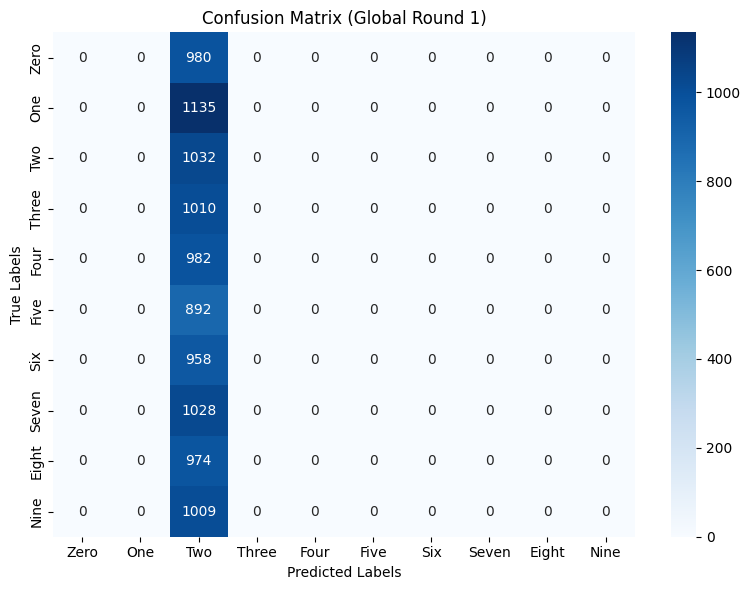


 | Global training round : 2/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 3.9591, Test accuracy: 1184/10000 (11.84%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 53.8
Seven      - 0.0
Eight      - 2.4
Nine       - 64.0


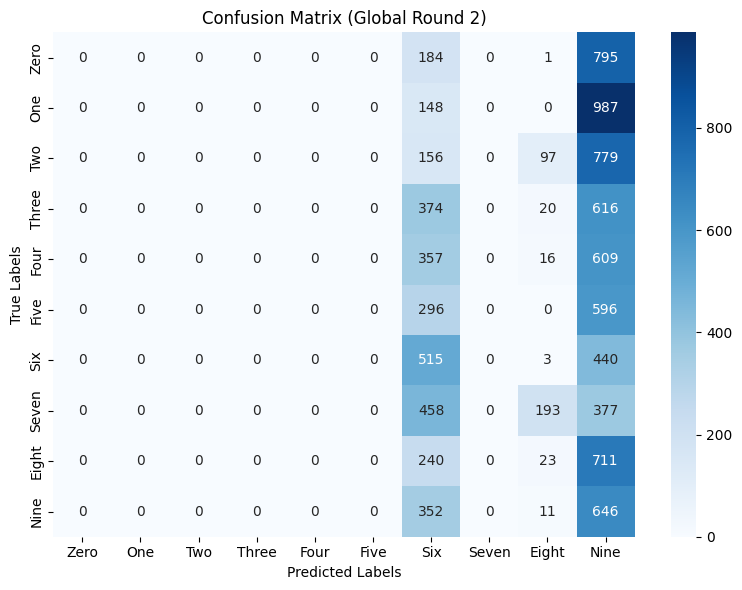


 | Global training round : 3/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 16.2372, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


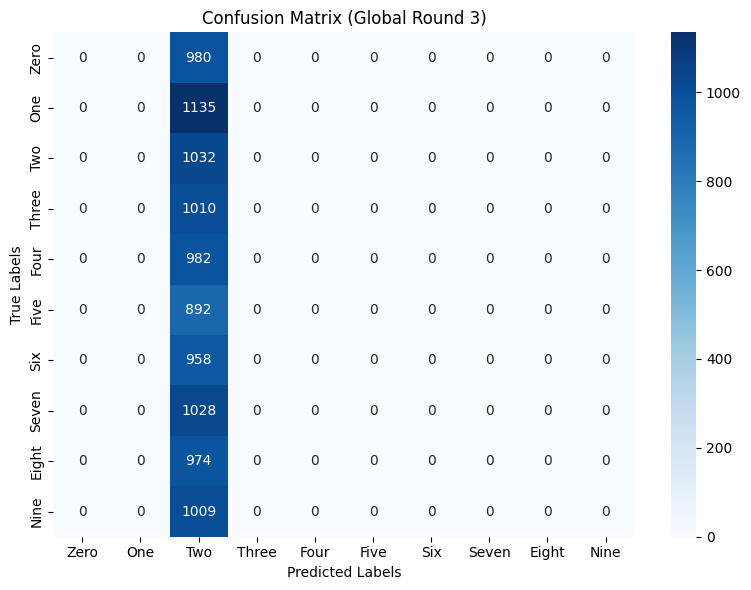


 | Global training round : 4/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 2.3526, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


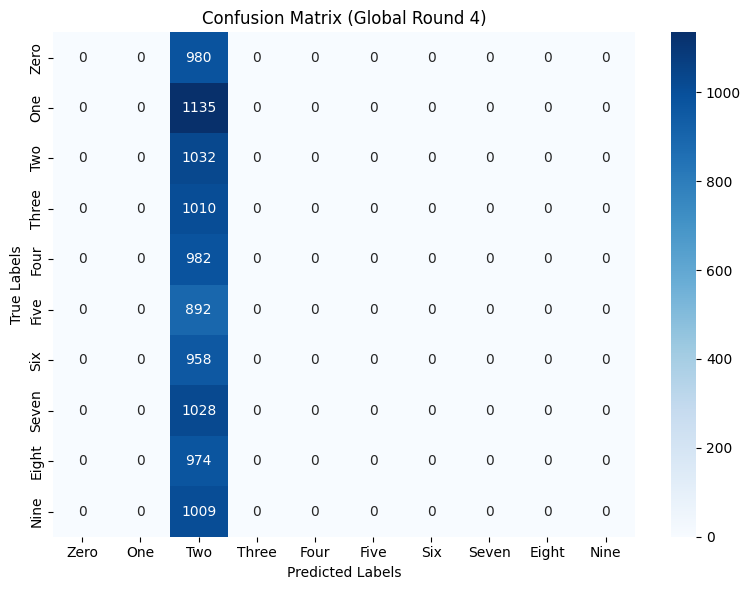


 | Global training round : 5/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 15.8291, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


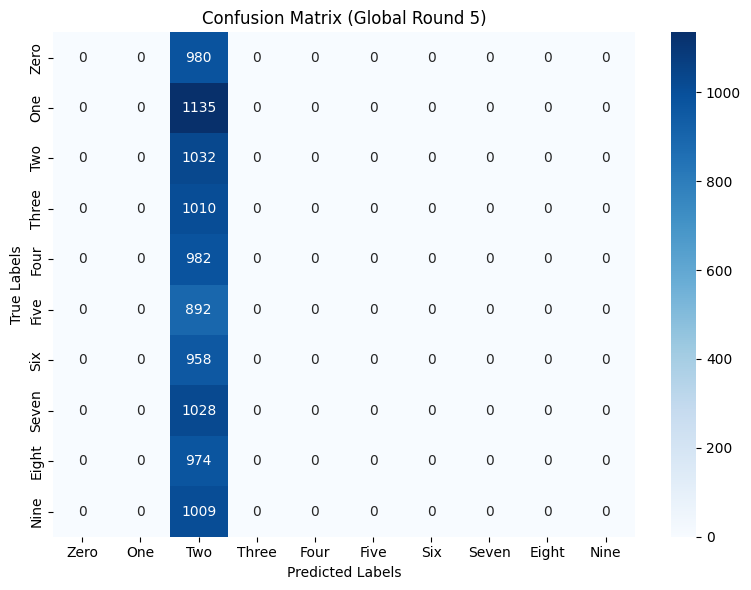


 | Global training round : 6/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 8.0953, Test accuracy: 1135/10000 (11.35%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


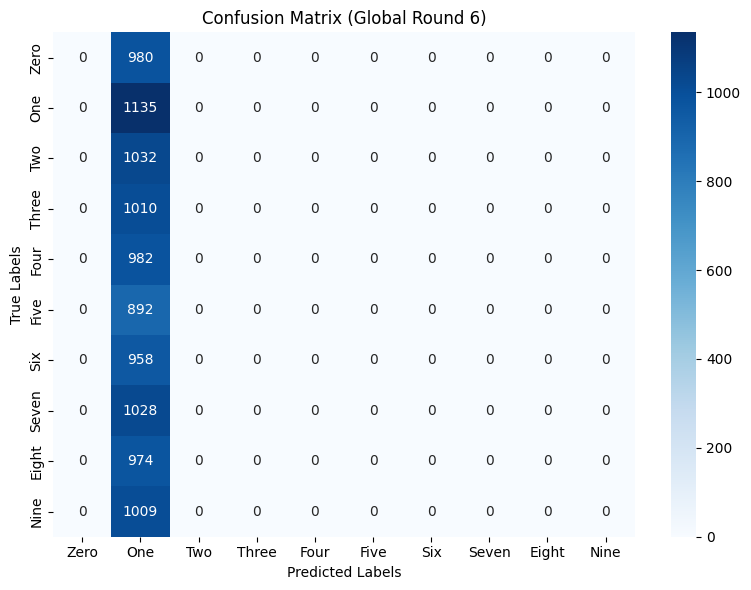


 | Global training round : 7/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 2.6170, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


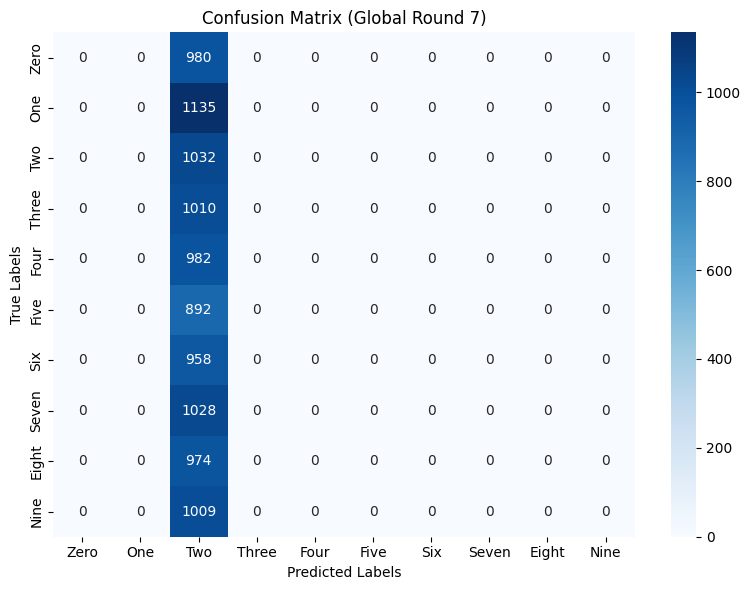


 | Global training round : 8/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 16.7679, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


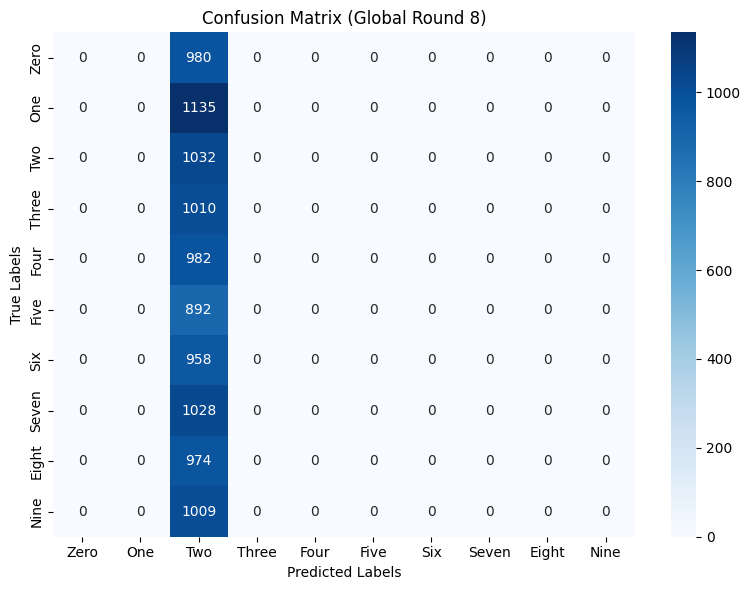


 | Global training round : 9/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 4.5826, Test accuracy: 1510/10000 (15.10%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 56.6
Seven      - 0.0
Eight      - 99.3
Nine       - 0.1


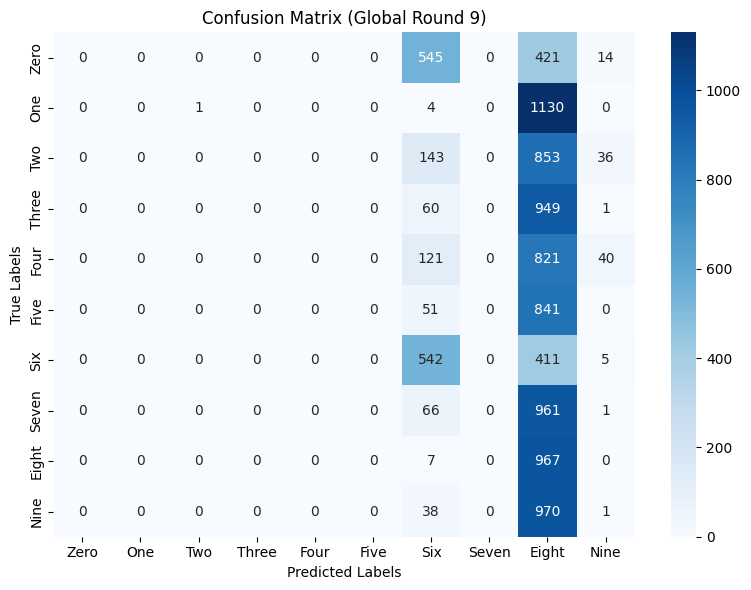


 | Global training round : 10/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 13.1827, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


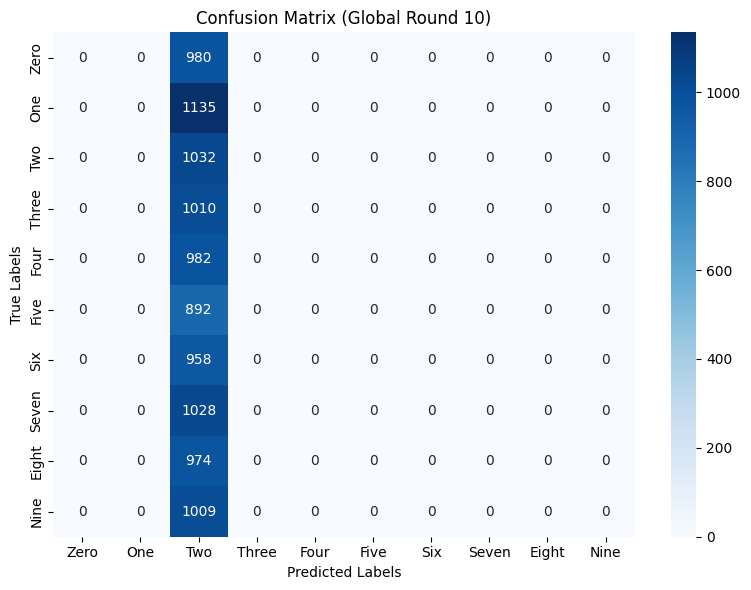


 | Global training round : 11/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 2.9488, Test accuracy: 1135/10000 (11.35%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


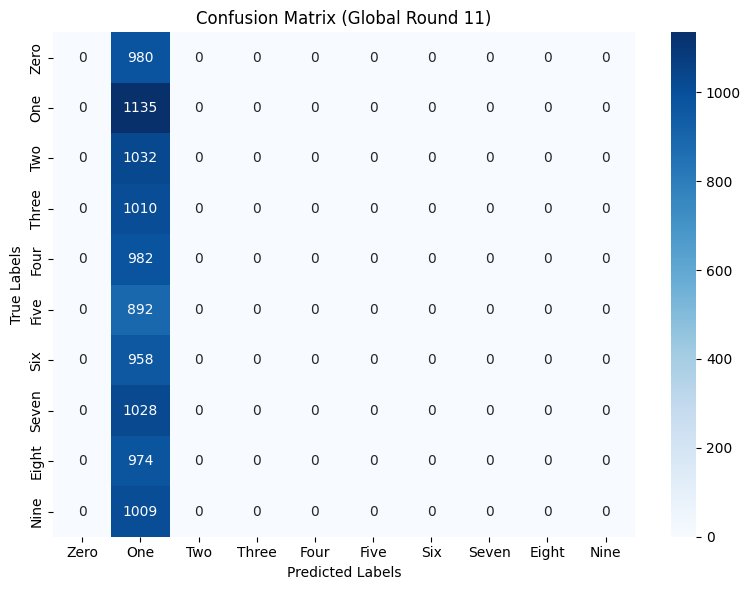


 | Global training round : 12/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 3.0899, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


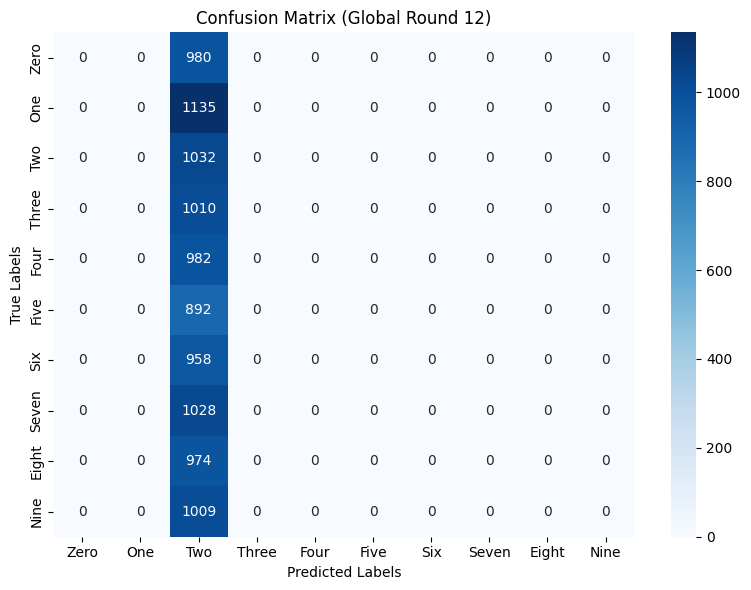


 | Global training round : 13/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 3.4184, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


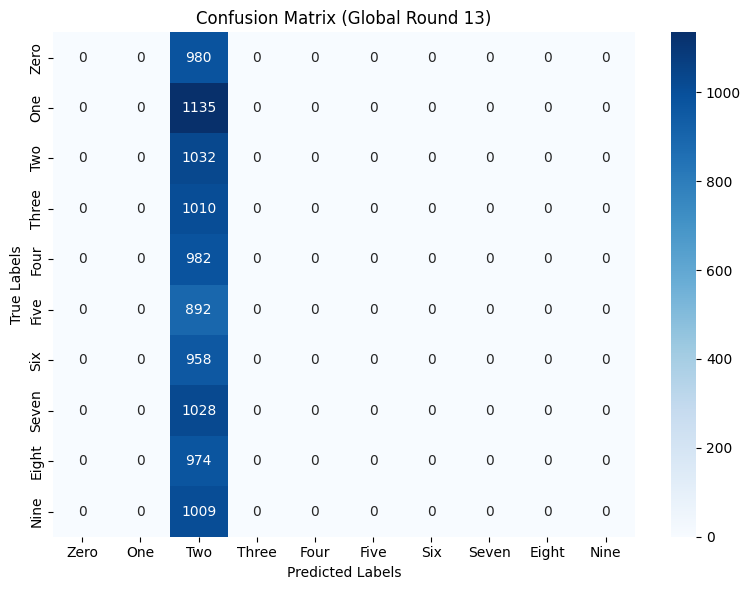


 | Global training round : 14/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 3.0992, Test accuracy: 1401/10000 (14.01%)

Class      - Accuracy
Zero       - 0.0
One        - 89.7
Two        - 37.1
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


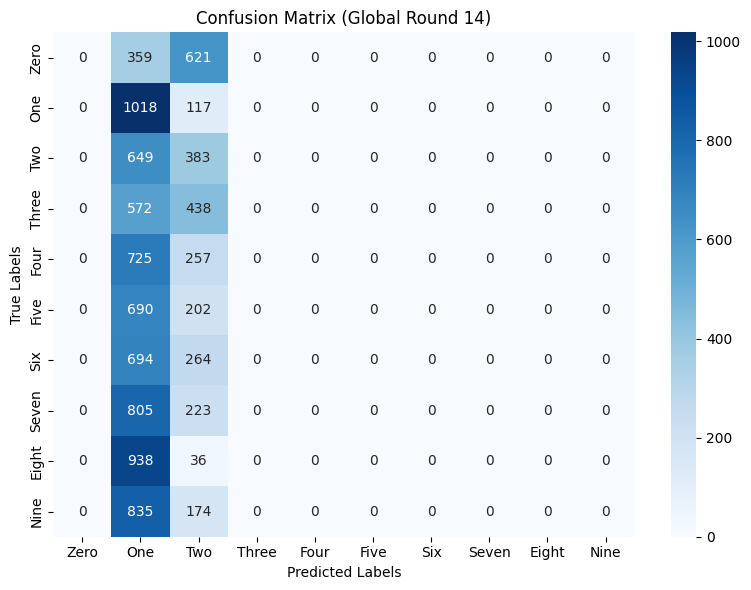


 | Global training round : 15/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 5.0699, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


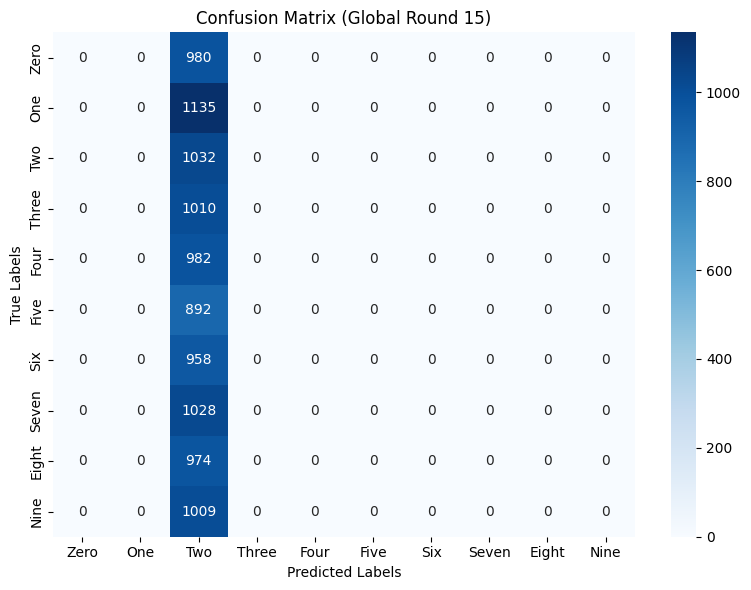


 | Global training round : 16/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 3.4372, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


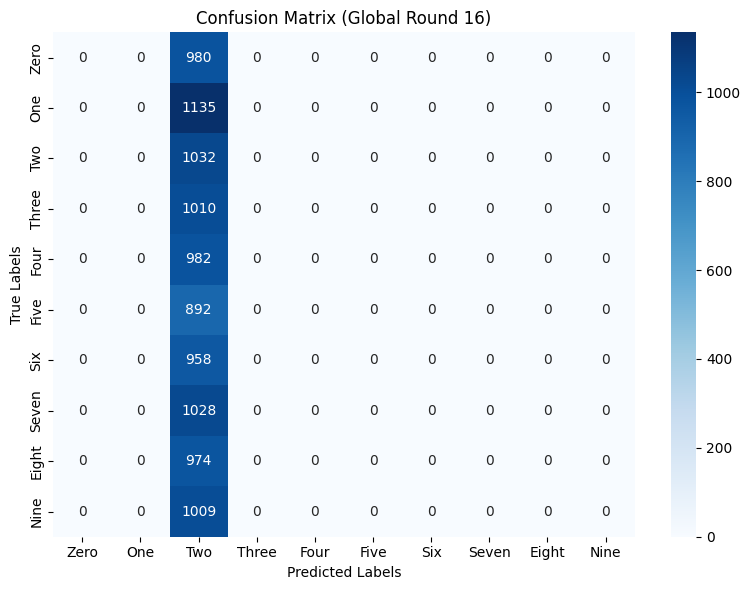


 | Global training round : 17/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 8.2771, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


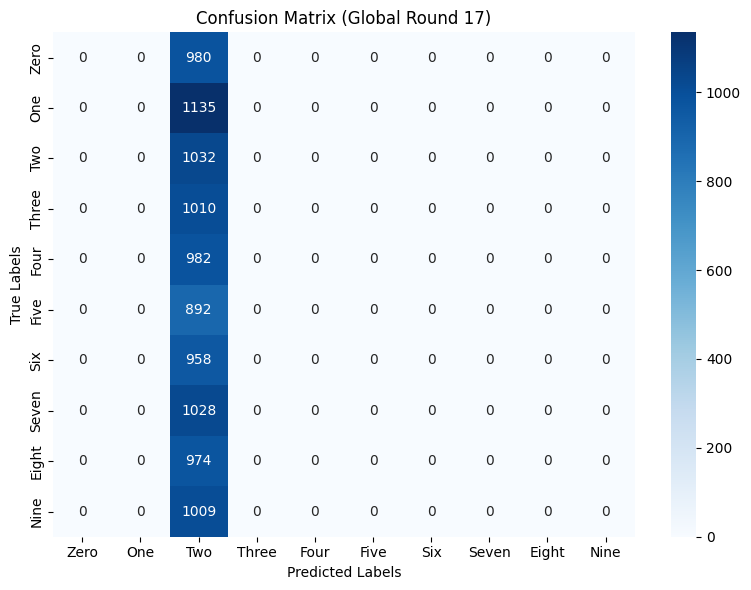


 | Global training round : 18/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 6.1625, Test accuracy: 1135/10000 (11.35%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


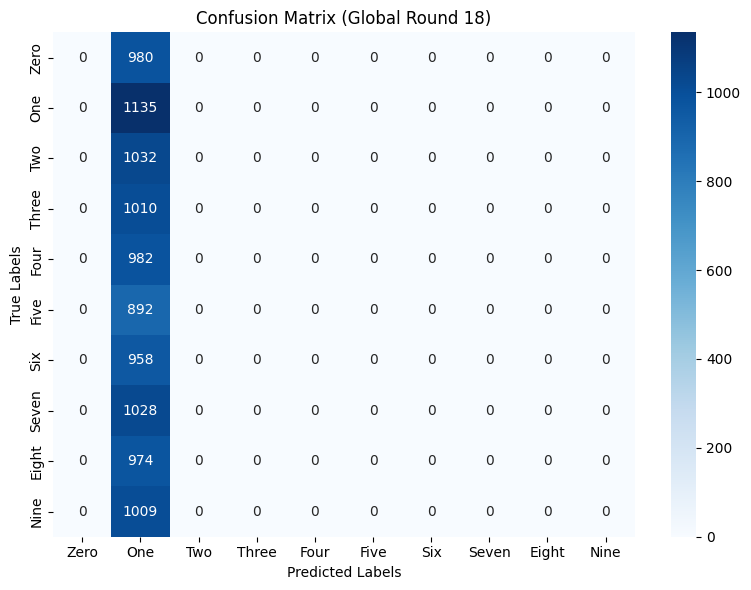


 | Global training round : 19/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 4.4007, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


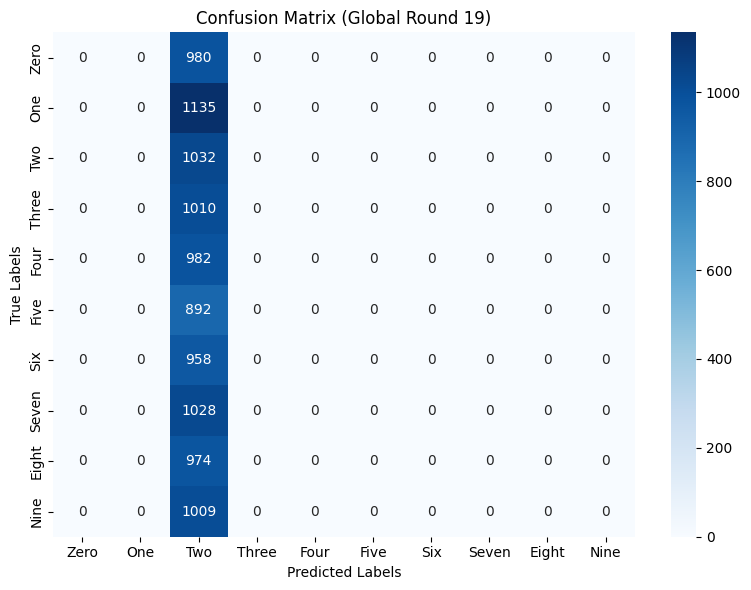


 | Global training round : 20/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
 our aggregation
inside robust aggregate

Average test loss: 3.8730, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0
Last 10 updates results

Average test loss: 3.2261, Test accuracy: 1032/10000 (10.32%)

***********************************************************************************
Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


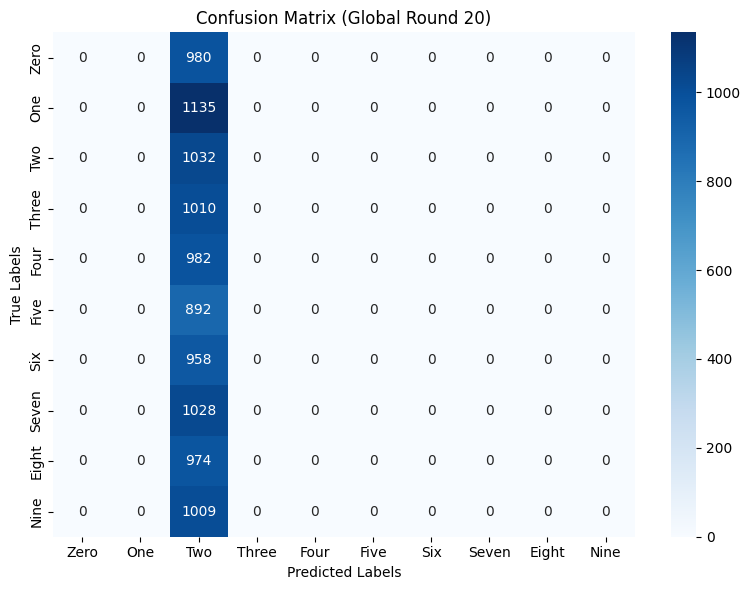

Global accuracies:  [np.float64(10.32), np.float64(11.84), np.float64(10.32), np.float64(10.32), np.float64(10.32), np.float64(11.35), np.float64(10.32), np.float64(10.32), np.float64(15.1), np.float64(10.32), np.float64(11.35), np.float64(10.32), np.float64(10.32), np.float64(14.01), np.float64(10.32), np.float64(10.32), np.float64(10.32), np.float64(11.35), np.float64(10.32), np.float64(10.32), np.float64(10.32)]
Class 7 accuracies:  [np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0)]
Test loss: [np.float64(24.5966), np.float64(3.9591), np.float64(16.2372), np.float64(2.3526), np.float64(15.8291), np.float64(8.0953), np.float64(2.617), np.float64(16.7679), np.float64(4.5826), np.floa

In [ ]:
RULE = 'robutslfd'
ATTACK_TYPE='label_flipping'
MALICIOUS_BEHAVIOR_RATE = 1
for atr in [0.4]:
    run_exp(dataset_name = DATASET_NAME, model_name = MODEL_NAME, dd_type = DD_TYPE, num_peers = NUM_PEERS,
            frac_peers = FRAC_PEERS, seed = SEED, test_batch_size = TEST_BATCH_SIZE,
                criterion = CRITERION, global_rounds = GLOBAL_ROUNDS, local_epochs = LOCAL_EPOCHS, local_bs = LOCAL_BS,
                    local_lr = LOCAL_LR, local_momentum = LOCAL_MOMENTUM, labels_dict = LABELS_DICT, device = DEVICE,
                attackers_ratio = atr, attack_type=ATTACK_TYPE,
                    malicious_behavior_rate = MALICIOUS_BEHAVIOR_RATE, rule = RULE,
                source_class = SOURCE_CLASS, target_class = TARGET_CLASS,
                class_per_peer = CLASS_PER_PEER, samples_per_class = SAMPLES_PER_CLASS,
                rate_unbalance = RATE_UNBALANCE, alpha = ALPHA, resume = False)


--> Label FLIP experiment on our algo...
--> Loading of MNIST dataset
--> Dataset has been loaded!
--> Creating CNNMNIST model.....
--> Model has been created!
--> Distributing training data among peers
--> Training data have been distributed among peers
--> Creating peets instances
Data set: MNIST
Data distribution: EXTREME_NON_IID
Aggregation rule: lfighter
Attack Type: label_flipping
Attackers Ratio: 40.0 %
Malicious Behavior Rate: 100 %

===>Simulation started...

====>Global model training started...



  0%|          | 0/20 [00:00<?, ?it/s]


 | Global training round : 1/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
aggregate a achi
Potential source and target classes: [1 2]

Average test loss: 40.4428, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


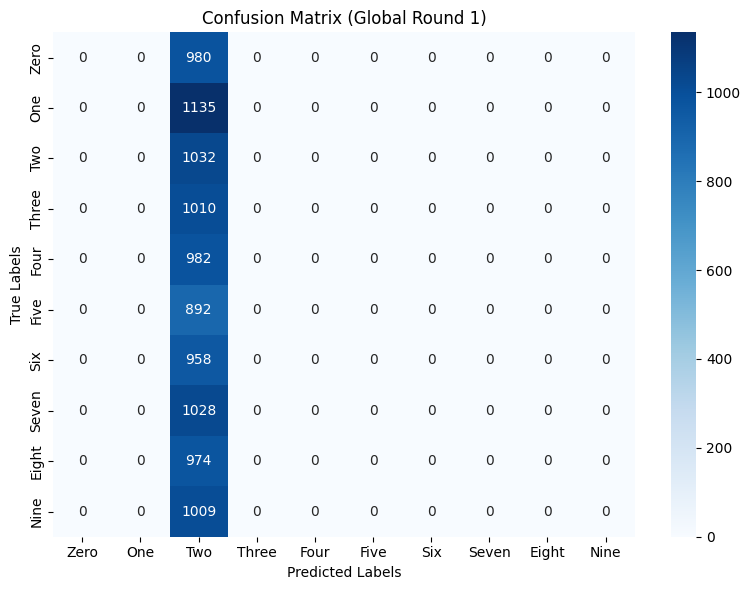


 | Global training round : 2/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
aggregate a achi
Potential source and target classes: [1 2]

Average test loss: 14.6150, Test accuracy: 958/10000 (9.58%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 100.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


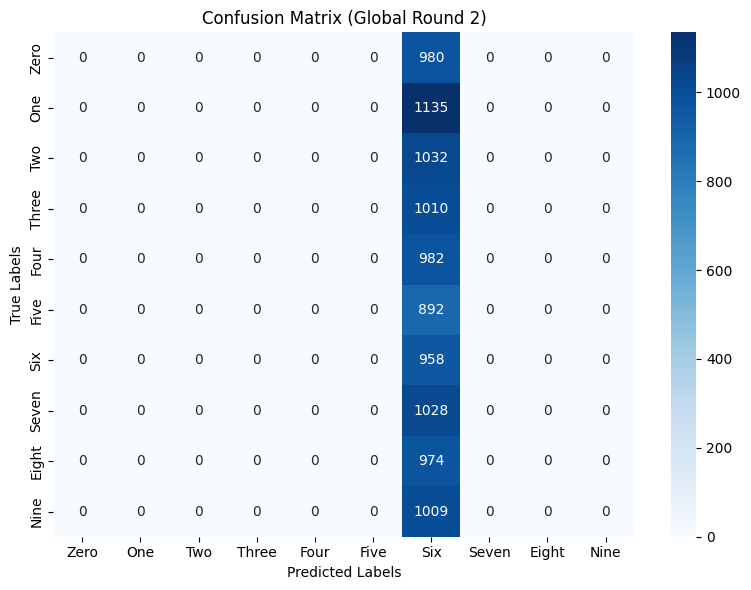


 | Global training round : 3/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
aggregate a achi
Potential source and target classes: [2 6]

Average test loss: 10.3977, Test accuracy: 1135/10000 (11.35%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


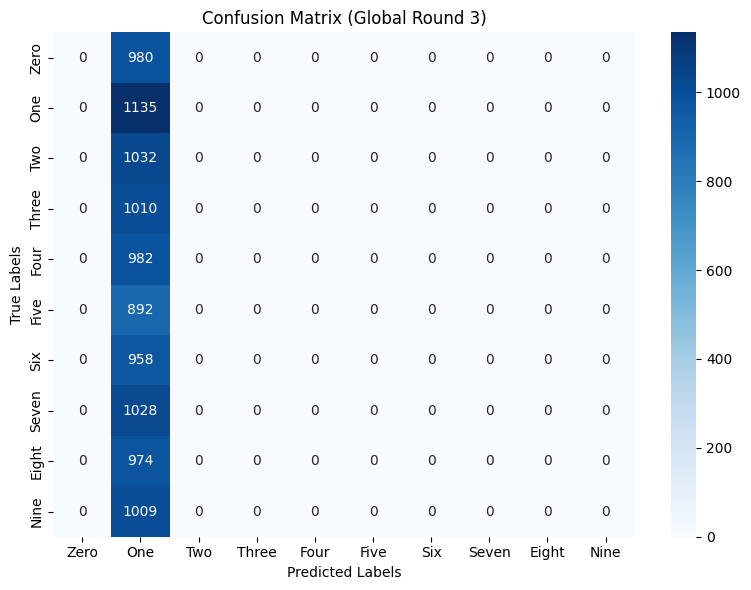


 | Global training round : 4/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
aggregate a achi
Potential source and target classes: [1 2]

Average test loss: 3.4215, Test accuracy: 976/10000 (9.76%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 99.8
Nine       - 0.4


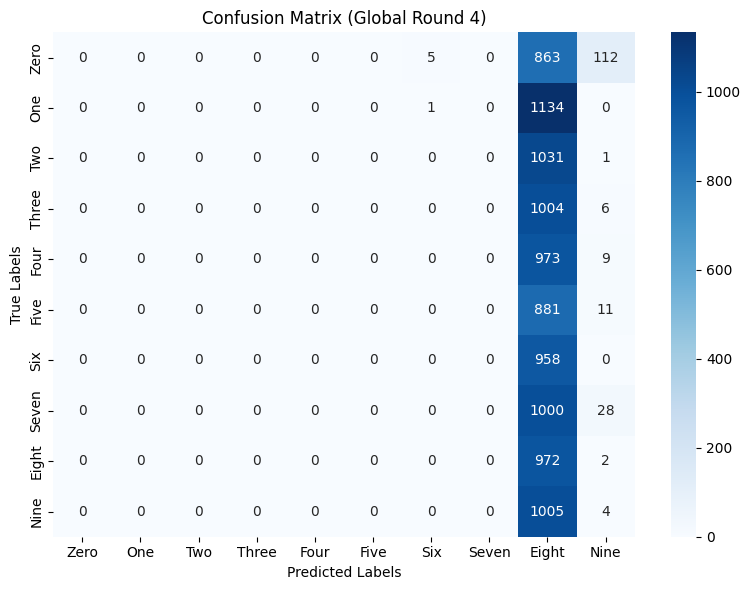


 | Global training round : 5/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
aggregate a achi
Potential source and target classes: [1 2]

Average test loss: 2.4193, Test accuracy: 1032/10000 (10.32%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 100.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


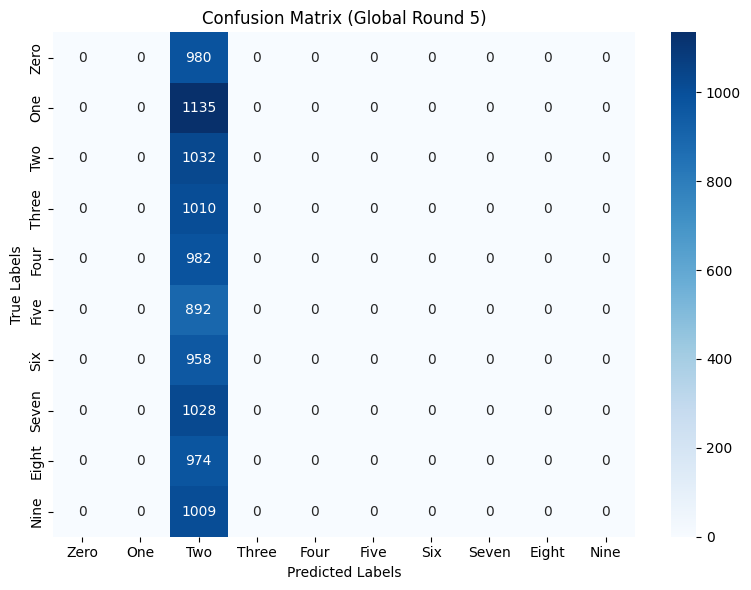


 | Global training round : 6/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
aggregate a achi
Potential source and target classes: [1 2]

Average test loss: 3.0854, Test accuracy: 947/10000 (9.47%)

Class      - Accuracy
Zero       - 0.0
One        - 0.1
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 91.2
Nine       - 5.7


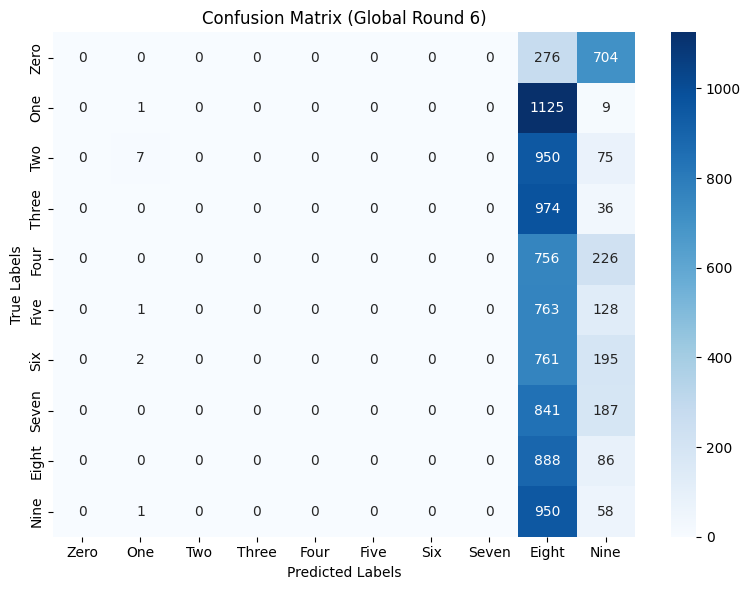


 | Global training round : 7/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
aggregate a achi
Potential source and target classes: [1 2]

Average test loss: 3.7222, Test accuracy: 1135/10000 (11.35%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


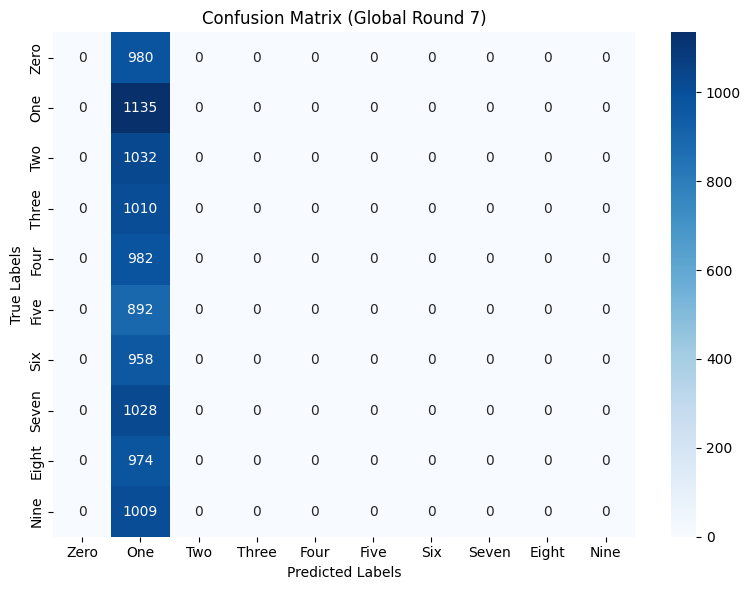


 | Global training round : 8/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
aggregate a achi
Potential source and target classes: [1 2]

Average test loss: 2.8484, Test accuracy: 974/10000 (9.74%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 100.0
Nine       - 0.0


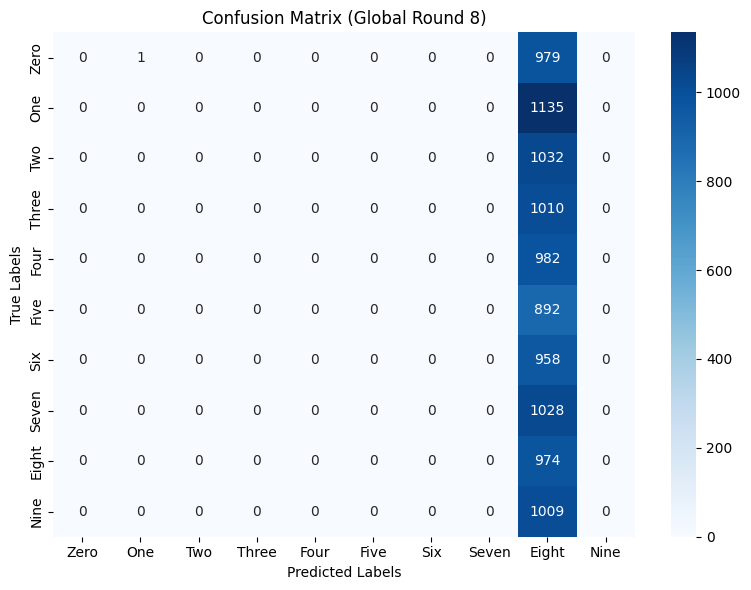


 | Global training round : 9/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
aggregate a achi
Potential source and target classes: [8 2]

Average test loss: 3.8450, Test accuracy: 1135/10000 (11.35%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


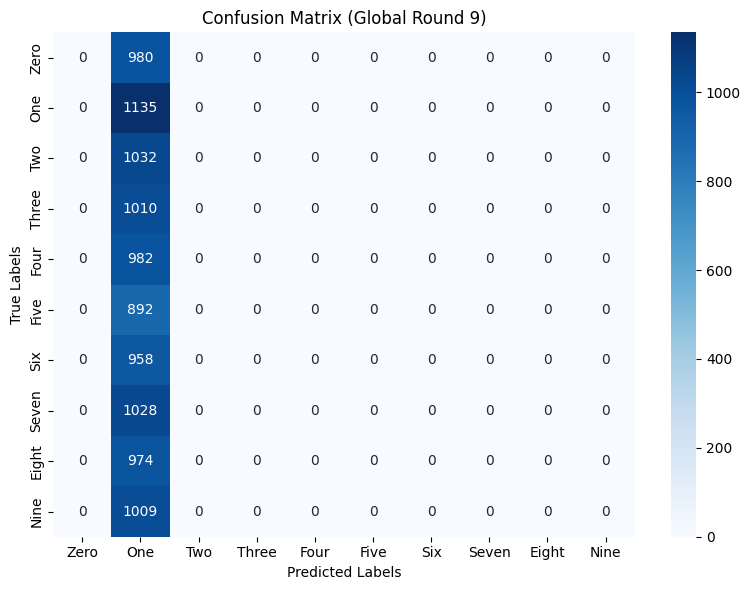


 | Global training round : 10/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
aggregate a achi
Potential source and target classes: [1 2]

Average test loss: 3.8640, Test accuracy: 957/10000 (9.57%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 99.8
Seven      - 0.0
Eight      - 0.1
Nine       - 0.0


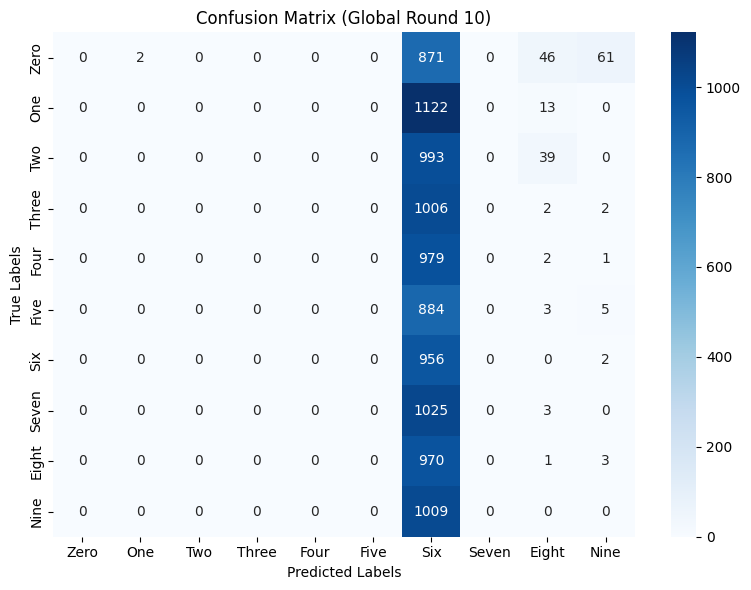


 | Global training round : 11/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
aggregate a achi
Potential source and target classes: [6 2]

Average test loss: 5.6256, Test accuracy: 1135/10000 (11.35%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.0
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


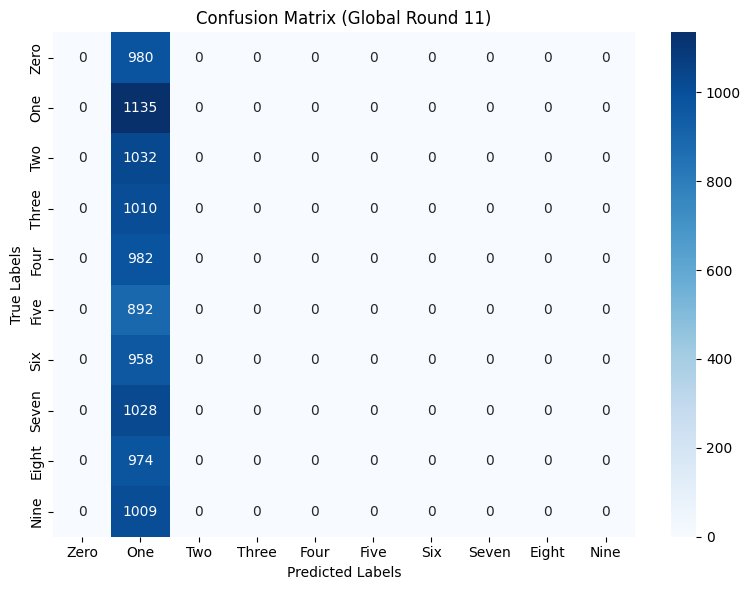


 | Global training round : 12/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
aggregate a achi
Potential source and target classes: [1 2]

Average test loss: 3.8005, Test accuracy: 1230/10000 (12.30%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.1
Seven      - 0.0
Eight      - 26.1
Nine       - 96.6


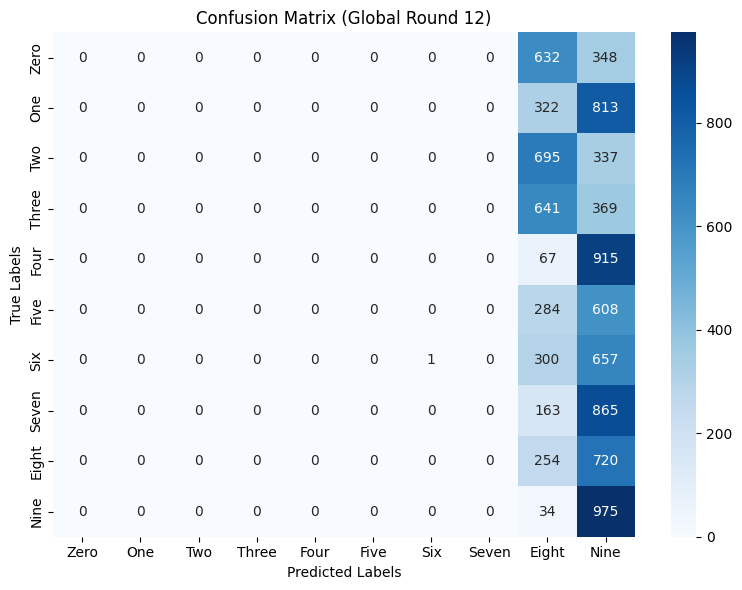


 | Global training round : 13/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
aggregate a achi
Potential source and target classes: [1 2]

Average test loss: 4.6811, Test accuracy: 1136/10000 (11.36%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 0.1
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


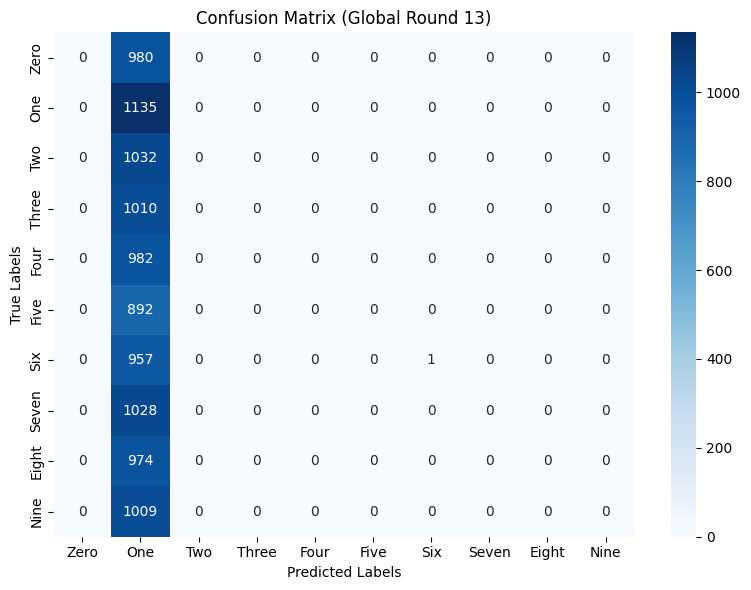


 | Global training round : 14/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
aggregate a achi
Potential source and target classes: [1 2]

Average test loss: 3.9748, Test accuracy: 1099/10000 (10.99%)

Class      - Accuracy
Zero       - 0.0
One        - 0.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 9.2
Seven      - 0.0
Eight      - 99.8
Nine       - 3.9


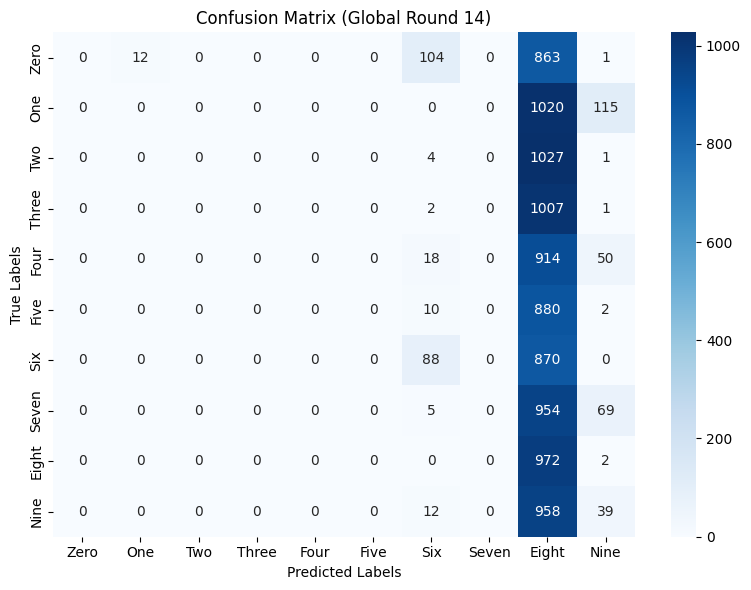


 | Global training round : 15/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
aggregate a achi
Potential source and target classes: [1 2]

Average test loss: 3.3014, Test accuracy: 1732/10000 (17.32%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 62.3
Seven      - 0.0
Eight      - 0.0
Nine       - 0.0


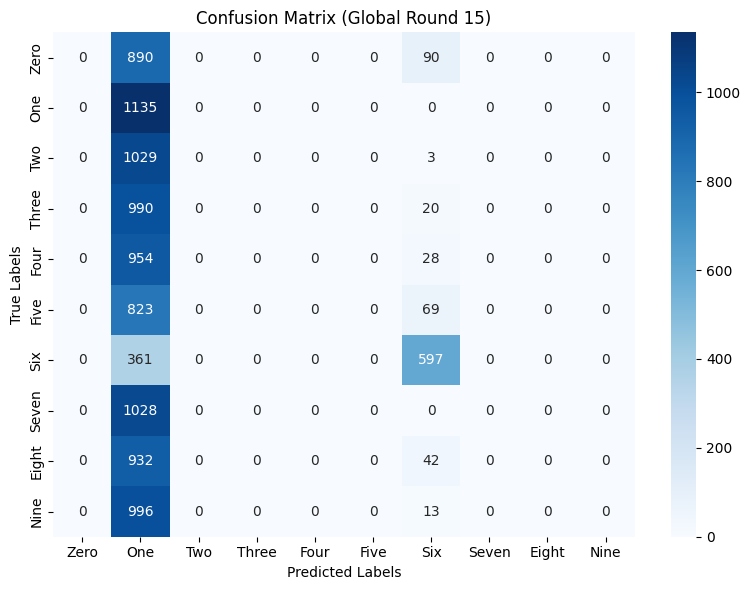


 | Global training round : 16/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
aggregate a achi
Potential source and target classes: [1 2]

Average test loss: 4.3745, Test accuracy: 2162/10000 (21.62%)

Class      - Accuracy
Zero       - 0.0
One        - 2.6
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 95.4
Seven      - 0.0
Eight      - 60.6
Nine       - 62.2


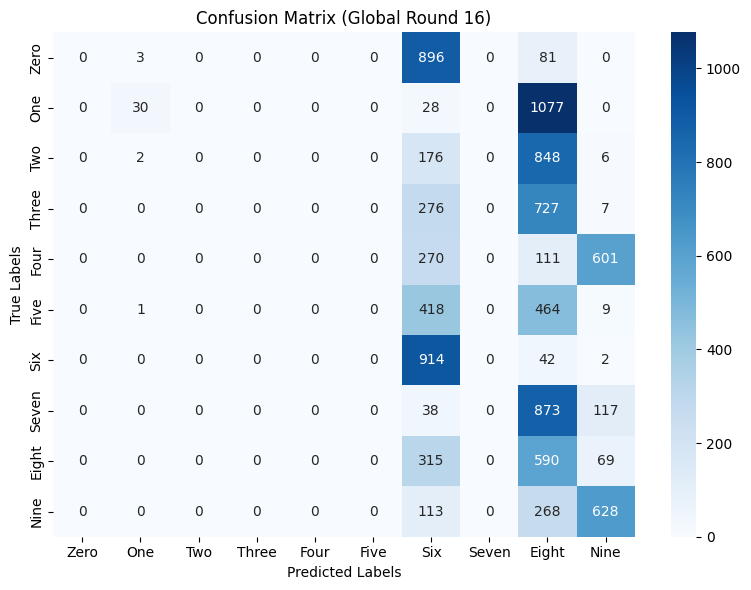


 | Global training round : 17/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
aggregate a achi
Potential source and target classes: [1 2]

Average test loss: 4.0193, Test accuracy: 1859/10000 (18.59%)

Class      - Accuracy
Zero       - 0.0
One        - 99.9
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.7
Six        - 74.7
Seven      - 0.0
Eight      - 0.1
Nine       - 0.2


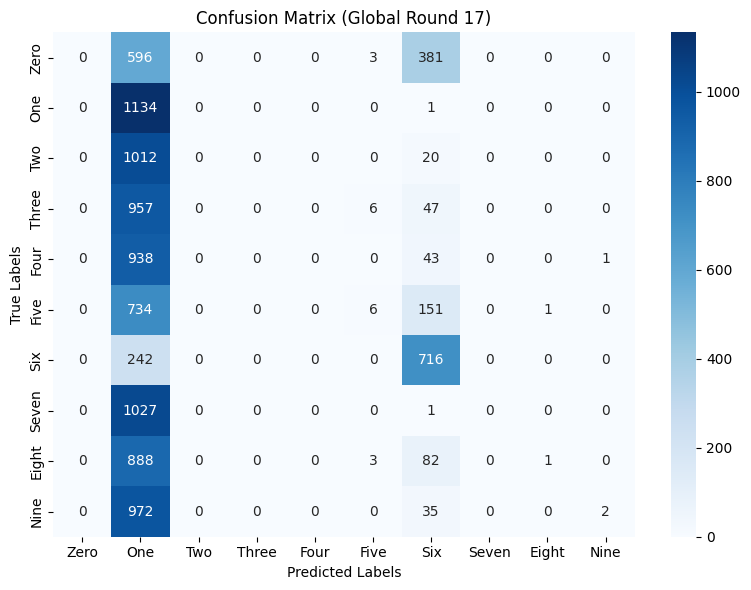


 | Global training round : 18/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
aggregate a achi
Potential source and target classes: [1 2]

Average test loss: 5.3504, Test accuracy: 2936/10000 (29.36%)

Class      - Accuracy
Zero       - 0.0
One        - 49.3
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 97.5
Seven      - 0.0
Eight      - 65.9
Nine       - 79.3


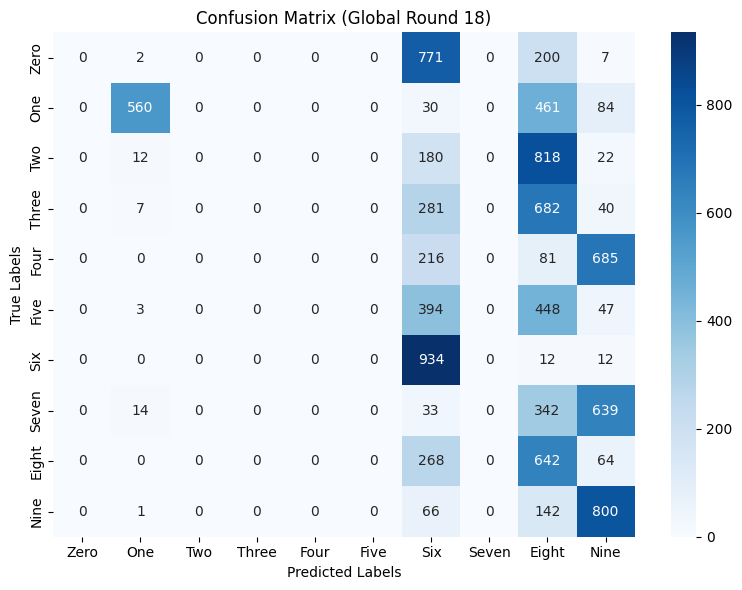


 | Global training round : 19/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
aggregate a achi
Potential source and target classes: [1 2]

Average test loss: 4.0836, Test accuracy: 1792/10000 (17.92%)

Class      - Accuracy
Zero       - 0.0
One        - 100.0
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 8.5
Six        - 58.0
Seven      - 0.0
Eight      - 0.1
Nine       - 2.4


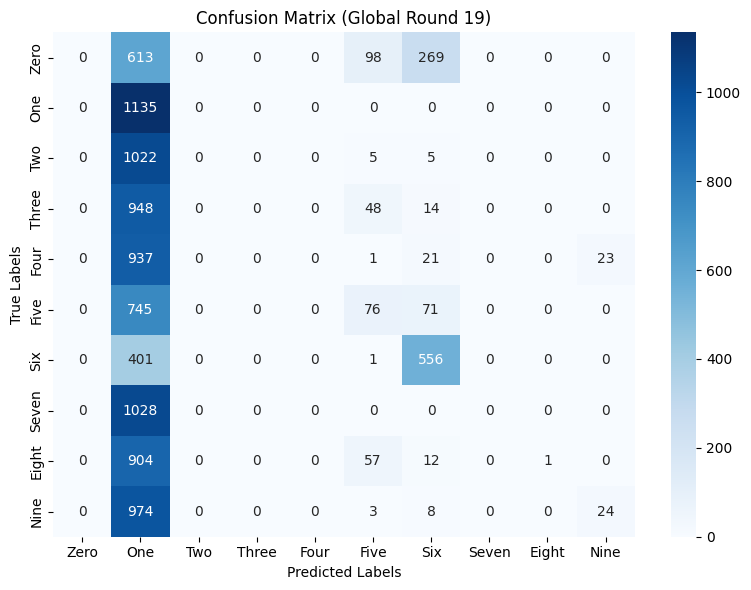


 | Global training round : 20/20 |

Label flipping attack launched by Peer 16 to flip class  7  to class  1
aggregate a achi
Potential source and target classes: [1 2]

Average test loss: 5.2721, Test accuracy: 2898/10000 (28.98%)

Class      - Accuracy
Zero       - 0.0
One        - 34.7
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 94.7
Seven      - 0.0
Eight      - 70.1
Nine       - 90.6
Last 10 updates results

Average test loss: 3.3388, Test accuracy: 3065/10000 (30.65%)

***********************************************************************************
Class      - Accuracy
Zero       - 0.0
One        - 99.2
Two        - 0.0
Three      - 0.0
Four       - 0.0
Five       - 0.0
Six        - 98.0
Seven      - 0.0
Eight      - 64.3
Nine       - 37.1


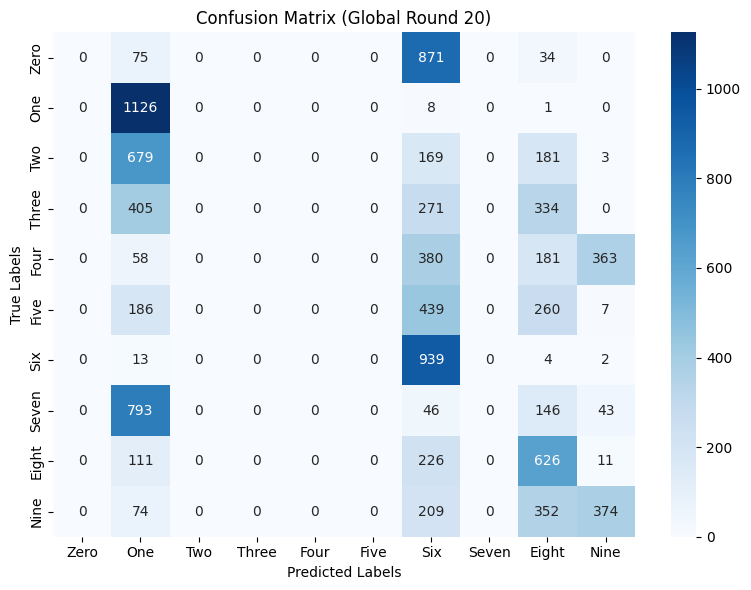

Global accuracies:  [np.float64(10.32), np.float64(9.58), np.float64(11.35), np.float64(9.76), np.float64(10.32), np.float64(9.47), np.float64(11.35), np.float64(9.74), np.float64(11.35), np.float64(9.57), np.float64(11.35), np.float64(12.3), np.float64(11.36), np.float64(10.99), np.float64(17.32), np.float64(21.62), np.float64(18.59), np.float64(29.36), np.float64(17.92), np.float64(28.98), np.float64(30.65)]
Class 7 accuracies:  [np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0), np.float64(0.0)]
Test loss: [np.float64(40.4428), np.float64(14.615), np.float64(10.3977), np.float64(3.4215), np.float64(2.4193), np.float64(3.0854), np.float64(3.7222), np.float64(2.8484), np.float64(3.845), np.float64(3.8

In [ ]:
RULE = 'lfighter'
ATTACK_TYPE='label_flipping'
MALICIOUS_BEHAVIOR_RATE = 1
for atr in [0.4]:
    run_exp(dataset_name = DATASET_NAME, model_name = MODEL_NAME, dd_type = DD_TYPE, num_peers = NUM_PEERS,
            frac_peers = FRAC_PEERS, seed = SEED, test_batch_size = TEST_BATCH_SIZE,
                criterion = CRITERION, global_rounds = GLOBAL_ROUNDS, local_epochs = LOCAL_EPOCHS, local_bs = LOCAL_BS,
                 local_lr = LOCAL_LR, local_momentum = LOCAL_MOMENTUM, labels_dict = LABELS_DICT, device = DEVICE,
                attackers_ratio = atr, attack_type=ATTACK_TYPE,
                 malicious_behavior_rate = MALICIOUS_BEHAVIOR_RATE, rule = RULE,
                source_class = SOURCE_CLASS, target_class = TARGET_CLASS,
               class_per_peer = CLASS_PER_PEER, samples_per_class = SAMPLES_PER_CLASS,
               rate_unbalance = RATE_UNBALANCE, alpha = ALPHA, resume = False)

MNIST, NON-IID, 50% attacker

In [ ]:
#=============================== Defining global variables ========================#
DATASET_NAME = "MNIST"
MODEL_NAME = "CNNMNIST"
DD_TYPE = 'NON_IID'
ALPHA = 1
NUM_PEERS = 20 # "number of peers: K"
FRAC_PEERS = 1 #'the fraction of peers: C to bel selected in each round'
SEED = 7 #fixed seed
random.seed(SEED)
CRITERION = nn.CrossEntropyLoss()
GLOBAL_ROUNDS = 20 #"number of rounds of federated model training"
LOCAL_EPOCHS = 3 #"the number of local epochs: E for each peer"
TEST_BATCH_SIZE = 1000
LOCAL_BS = 64 #"local batch size: B for each peer"
LOCAL_LR =  0.01#local learning rate: lr for each peer
LOCAL_MOMENTUM = 0.9 #local momentum for each peer
NUM_CLASSES = 10 # number of classes in an experiment
LABELS_DICT = {'Zero':0,
               'One':1,
               'Two':2,
               'Three':3,
               'Four':4,
               'Five':5,
               'Six':6,
               'Seven':7,
               'Eight':8,
               'Nine':9}

#select the device to work with cpu or gpu
if torch.cuda.is_available():
    DEVICE = "cuda"
else:
    DEVICE = "cpu"
DEVICE = torch.device(DEVICE)
print(DEVICE)
SOURCE_CLASS = 7 # the source class
TARGET_CLASS = 1 # the target class

CLASS_PER_PEER = 10
SAMPLES_PER_CLASS = 582
RATE_UNBALANCE = 1

cuda



--> Label FLIP experiment on our algo...
--> Loading of MNIST dataset
--> Dataset has been loaded!
--> Creating CNNMNIST model.....
--> Model has been created!
--> Distributing training data among peers
--> Training data have been distributed among peers
--> Creating peets instances
Data set: MNIST
Data distribution: NON_IID
Aggregation rule: tmean
Attack Type: label_flipping
Attackers Ratio: 40.0 %
Malicious Behavior Rate: 100 %

===>Simulation started...

====>Global model training started...



  0%|          | 0/20 [00:00<?, ?it/s]


 | Global training round : 1/20 |

Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 14 to flip class  7  to class  1
Label flipping attack launched by Peer 2 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 10 to flip class  7  to class  1

Average test loss: 1.1235, Test accuracy: 7406/10000 (74.06%)

Class      - Accuracy
Zero       - 92.9
One        - 98.9
Two        - 88.4
Three      - 86.7
Four       - 96.9
Five       - 84.6
Six        - 90.8
Seven      - 0.5
Eight      - 63.7
Nine       - 38.0


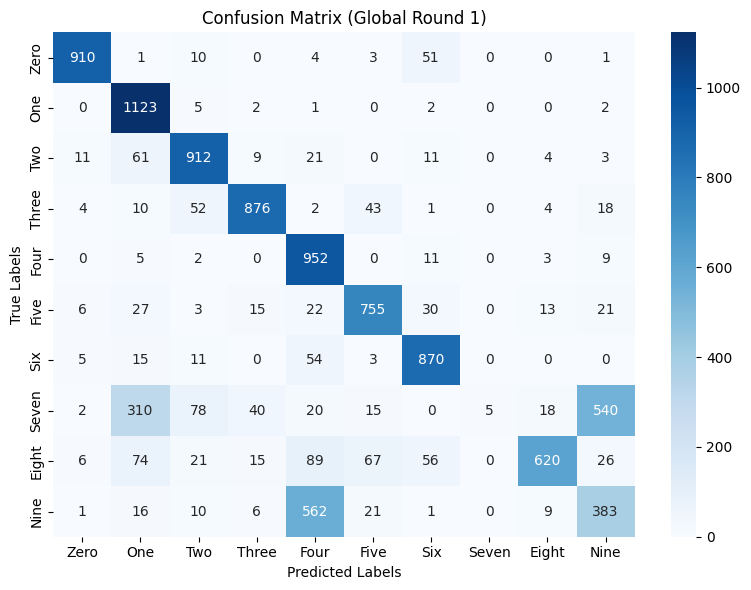


 | Global training round : 2/20 |

Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 14 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 2 to flip class  7  to class  1
Label flipping attack launched by Peer 10 to flip class  7  to class  1

Average test loss: 0.3893, Test accuracy: 8785/10000 (87.85%)

Class      - Accuracy
Zero       - 98.1
One        - 98.7
Two        - 95.2
Three      - 92.5
Four       - 96.5
Five       - 96.5
Six        - 96.1
Seven      - 31.2
Eight      - 82.8
Nine       - 92.3


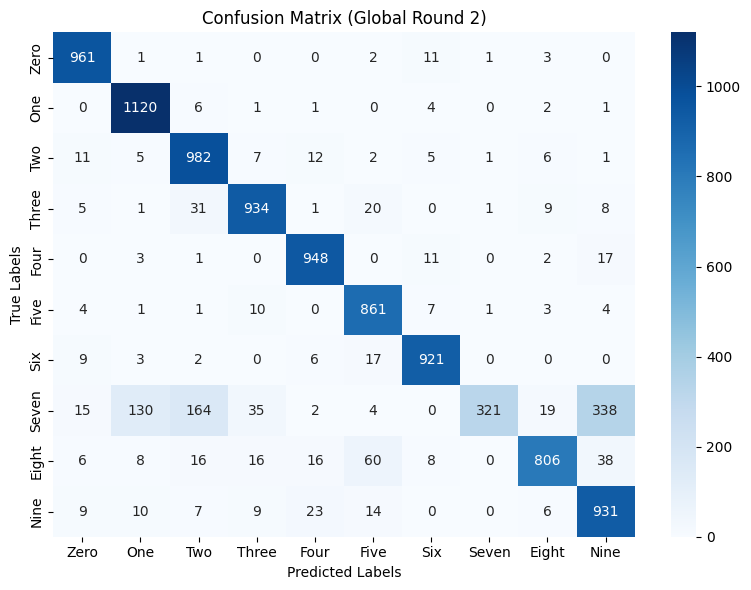


 | Global training round : 3/20 |

Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 10 to flip class  7  to class  1
Label flipping attack launched by Peer 14 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 2 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1

Average test loss: 0.2612, Test accuracy: 9165/10000 (91.65%)

Class      - Accuracy
Zero       - 98.6
One        - 99.0
Two        - 96.3
Three      - 94.7
Four       - 96.7
Five       - 97.4
Six        - 97.1
Seven      - 52.3
Eight      - 89.8
Nine       - 95.4


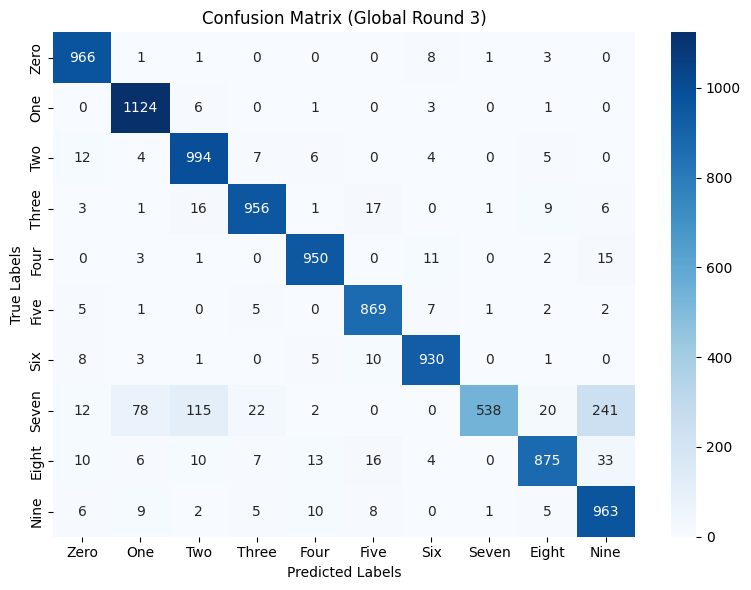


 | Global training round : 4/20 |

Label flipping attack launched by Peer 2 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 14 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 10 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1

Average test loss: 0.2236, Test accuracy: 9265/10000 (92.65%)

Class      - Accuracy
Zero       - 99.0
One        - 99.1
Two        - 96.9
Three      - 95.4
Four       - 96.8
Five       - 98.1
Six        - 97.5
Seven      - 57.7
Eight      - 91.0
Nine       - 95.8


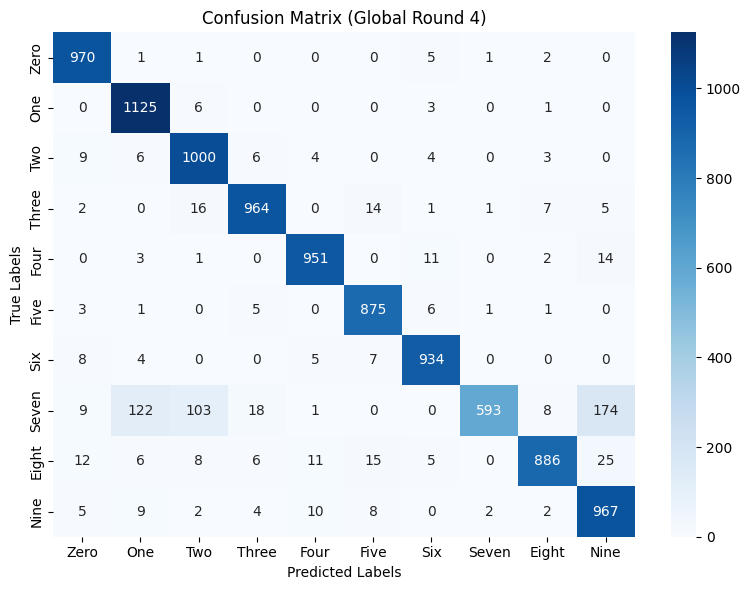


 | Global training round : 5/20 |

Label flipping attack launched by Peer 14 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 10 to flip class  7  to class  1
Label flipping attack launched by Peer 2 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1

Average test loss: 0.1854, Test accuracy: 9391/10000 (93.91%)

Class      - Accuracy
Zero       - 98.8
One        - 99.1
Two        - 98.0
Three      - 96.1
Four       - 97.3
Five       - 98.2
Six        - 97.5
Seven      - 66.8
Eight      - 91.7
Nine       - 96.2


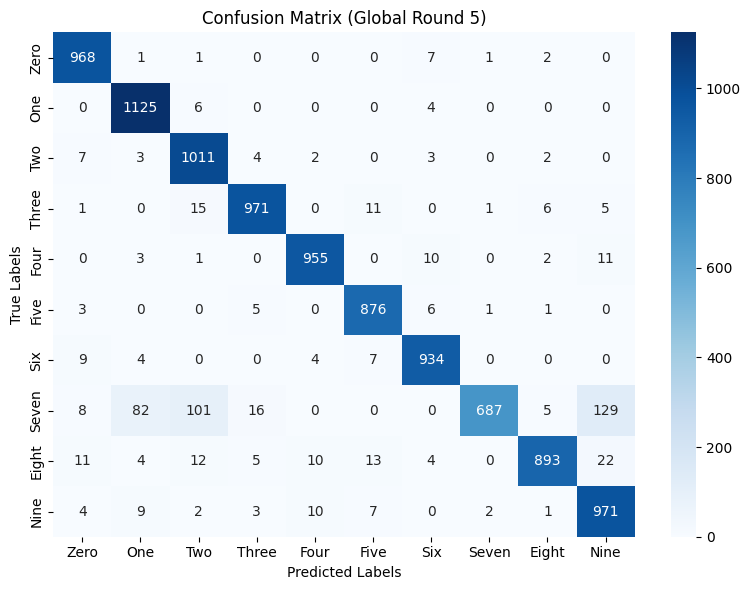


 | Global training round : 6/20 |

Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 14 to flip class  7  to class  1
Label flipping attack launched by Peer 10 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 2 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1

Average test loss: 0.1680, Test accuracy: 9446/10000 (94.46%)

Class      - Accuracy
Zero       - 98.9
One        - 99.2
Two        - 98.2
Three      - 97.0
Four       - 97.1
Five       - 98.3
Six        - 97.6
Seven      - 69.2
Eight      - 92.8
Nine       - 96.8


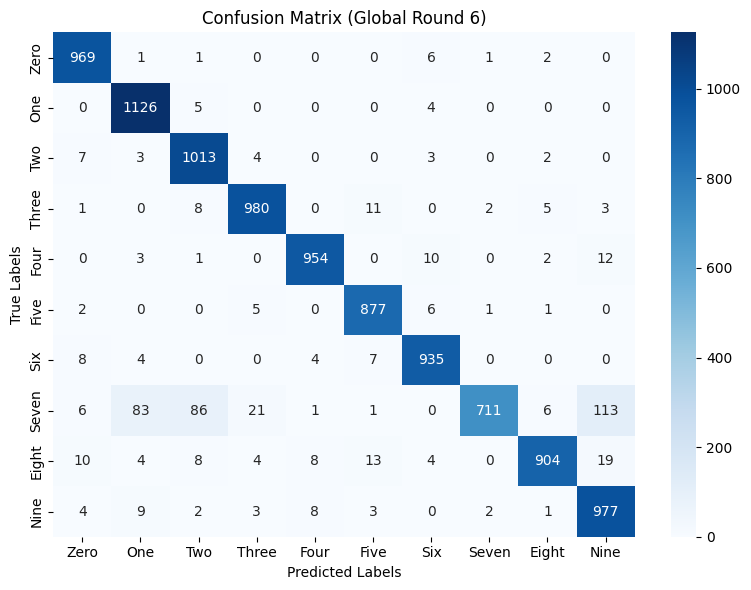


 | Global training round : 7/20 |

Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 2 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 14 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 10 to flip class  7  to class  1

Average test loss: 0.1480, Test accuracy: 9527/10000 (95.27%)

Class      - Accuracy
Zero       - 99.1
One        - 99.3
Two        - 98.2
Three      - 97.2
Four       - 97.0
Five       - 98.5
Six        - 97.7
Seven      - 74.6
Eight      - 94.7
Nine       - 96.8


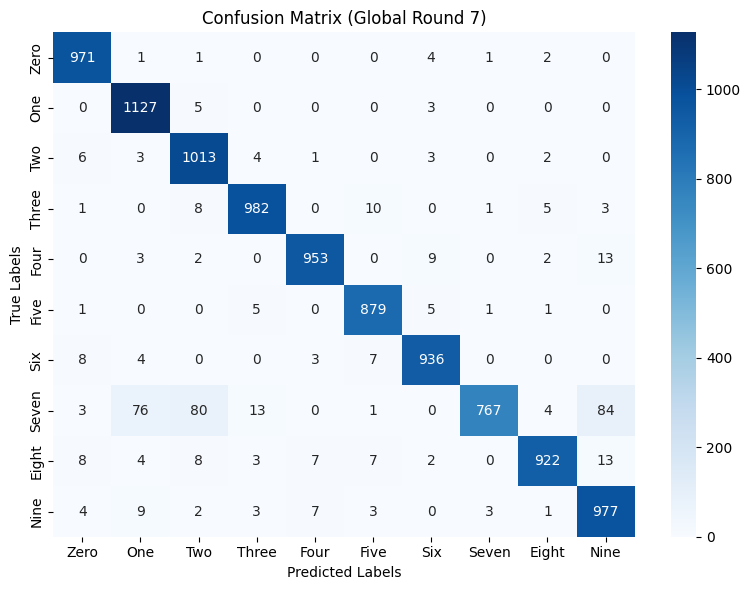


 | Global training round : 8/20 |

Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 2 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 14 to flip class  7  to class  1
Label flipping attack launched by Peer 10 to flip class  7  to class  1

Average test loss: 0.1340, Test accuracy: 9574/10000 (95.74%)

Class      - Accuracy
Zero       - 99.1
One        - 99.3
Two        - 98.4
Three      - 97.2
Four       - 97.3
Five       - 98.8
Six        - 98.0
Seven      - 78.4
Eight      - 94.6
Nine       - 96.8


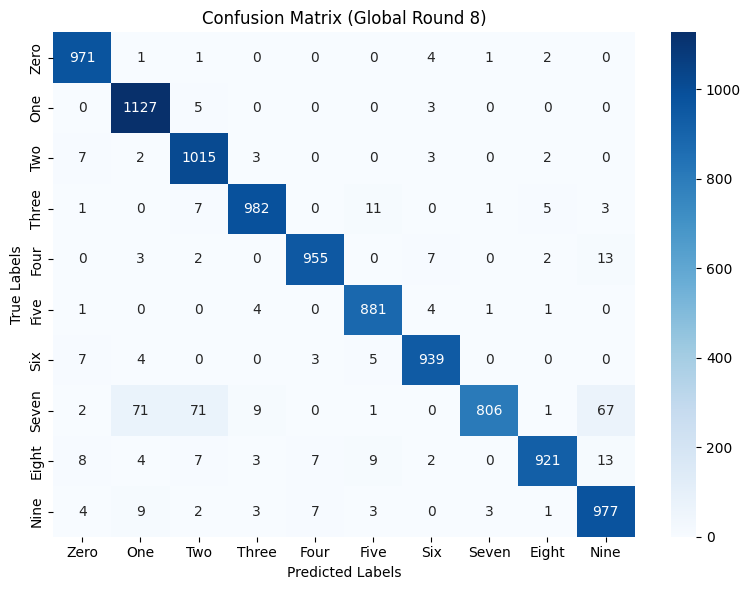


 | Global training round : 9/20 |

Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 14 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 10 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 2 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1

Average test loss: 0.1207, Test accuracy: 9632/10000 (96.32%)

Class      - Accuracy
Zero       - 99.4
One        - 99.4
Two        - 98.5
Three      - 97.5
Four       - 97.6
Five       - 98.7
Six        - 98.3
Seven      - 81.7
Eight      - 95.7
Nine       - 96.7


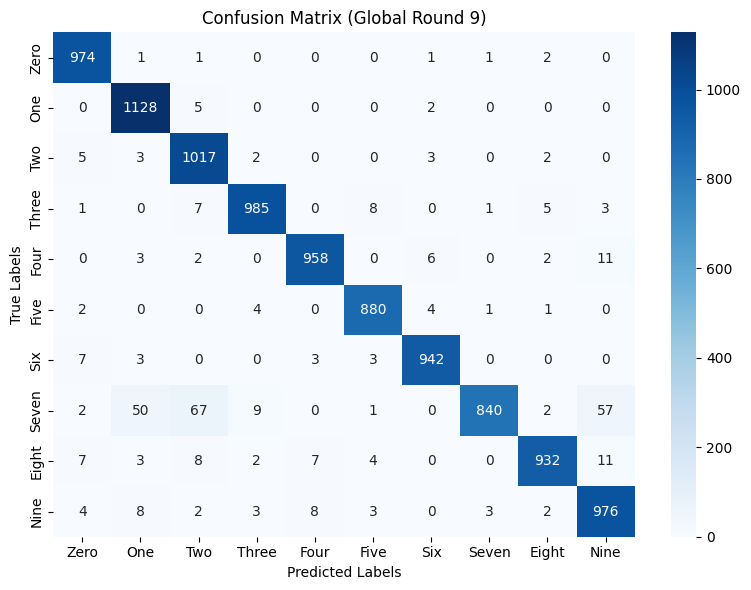


 | Global training round : 10/20 |

Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 10 to flip class  7  to class  1
Label flipping attack launched by Peer 2 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 14 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1

Average test loss: 0.1157, Test accuracy: 9637/10000 (96.37%)

Class      - Accuracy
Zero       - 99.4
One        - 99.5
Two        - 98.9
Three      - 97.9
Four       - 98.0
Five       - 98.5
Six        - 97.9
Seven      - 81.9
Eight      - 94.9
Nine       - 97.0


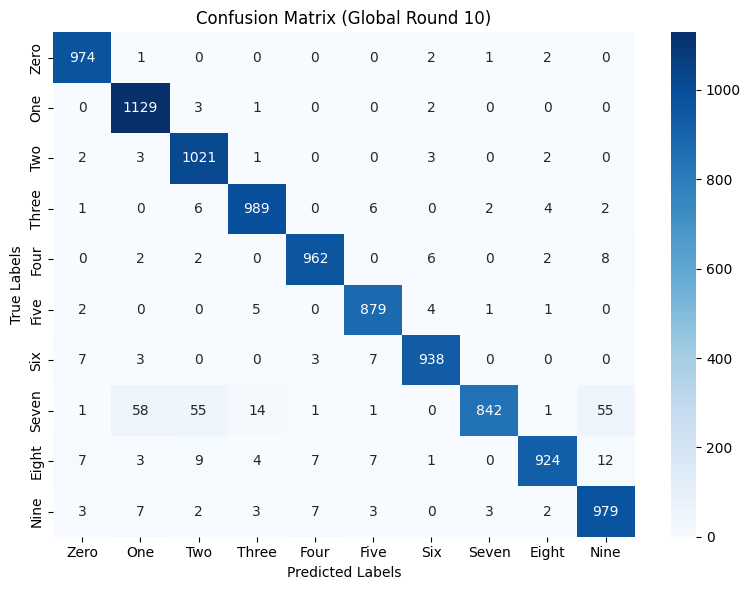


 | Global training round : 11/20 |

Label flipping attack launched by Peer 2 to flip class  7  to class  1
Label flipping attack launched by Peer 14 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 10 to flip class  7  to class  1

Average test loss: 0.1117, Test accuracy: 9641/10000 (96.41%)

Class      - Accuracy
Zero       - 99.5
One        - 99.4
Two        - 98.6
Three      - 97.2
Four       - 97.8
Five       - 98.7
Six        - 98.3
Seven      - 82.2
Eight      - 96.1
Nine       - 96.6


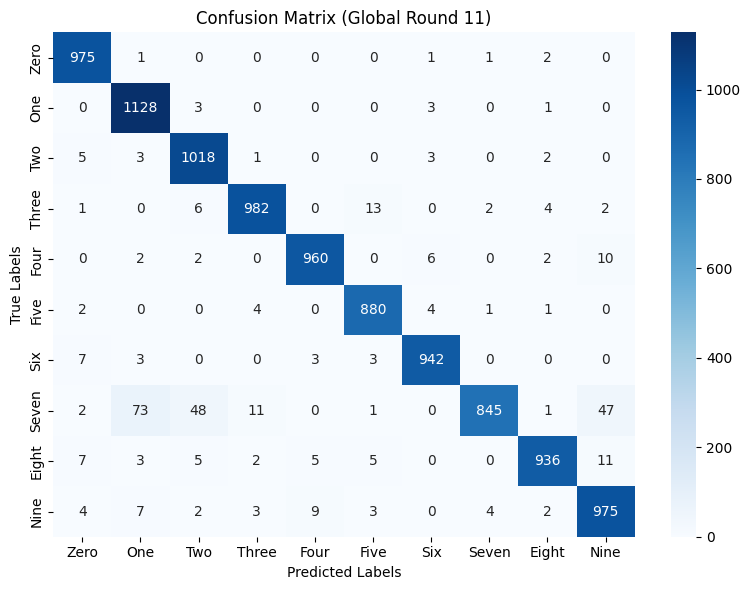


 | Global training round : 12/20 |

Label flipping attack launched by Peer 10 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 2 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 14 to flip class  7  to class  1

Average test loss: 0.1000, Test accuracy: 9695/10000 (96.95%)

Class      - Accuracy
Zero       - 99.6
One        - 99.5
Two        - 98.9
Three      - 97.7
Four       - 97.8
Five       - 98.8
Six        - 98.2
Seven      - 86.1
Eight      - 96.0
Nine       - 97.1


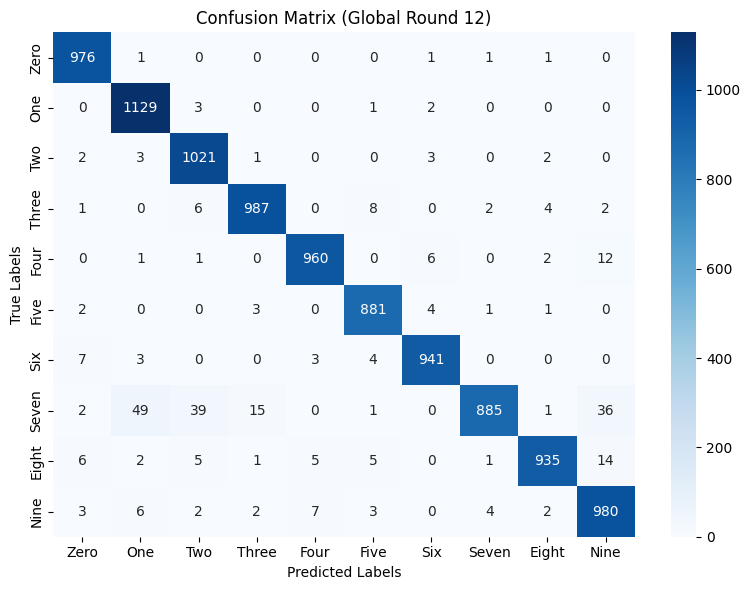


 | Global training round : 13/20 |

Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 14 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 10 to flip class  7  to class  1
Label flipping attack launched by Peer 2 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1

Average test loss: 0.0947, Test accuracy: 9722/10000 (97.22%)

Class      - Accuracy
Zero       - 99.6
One        - 99.5
Two        - 99.0
Three      - 97.9
Four       - 97.9
Five       - 98.8
Six        - 98.4
Seven      - 87.0
Eight      - 96.9
Nine       - 97.4


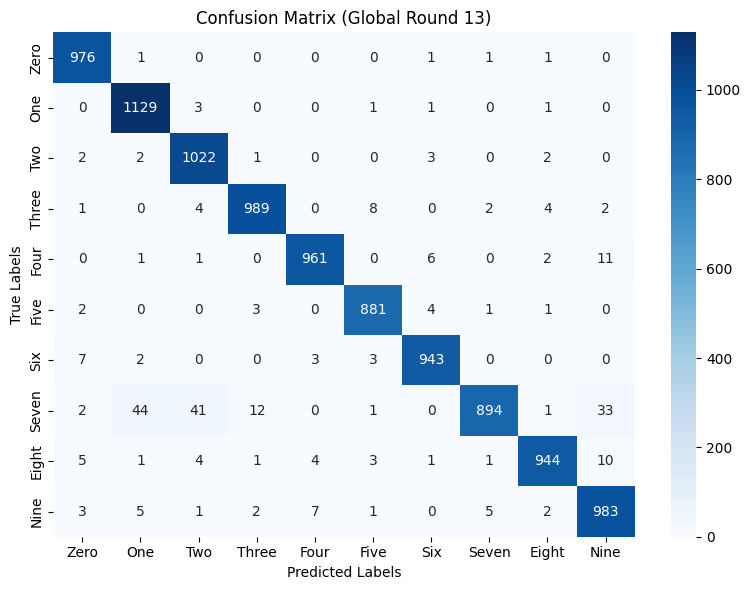


 | Global training round : 14/20 |

Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 10 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 2 to flip class  7  to class  1
Label flipping attack launched by Peer 14 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1

Average test loss: 0.0935, Test accuracy: 9723/10000 (97.23%)

Class      - Accuracy
Zero       - 99.6
One        - 99.6
Two        - 99.3
Three      - 97.8
Four       - 98.5
Five       - 98.9
Six        - 98.6
Seven      - 86.5
Eight      - 96.7
Nine       - 97.0


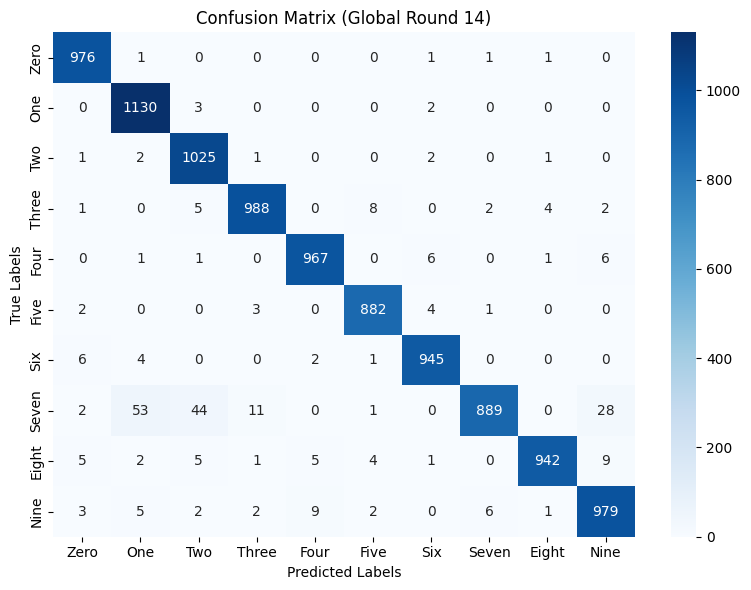


 | Global training round : 15/20 |

Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 10 to flip class  7  to class  1
Label flipping attack launched by Peer 2 to flip class  7  to class  1
Label flipping attack launched by Peer 14 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1

Average test loss: 0.0898, Test accuracy: 9740/10000 (97.40%)

Class      - Accuracy
Zero       - 99.5
One        - 99.6
Two        - 99.3
Three      - 98.2
Four       - 98.1
Five       - 98.9
Six        - 98.5
Seven      - 87.9
Eight      - 96.7
Nine       - 97.4


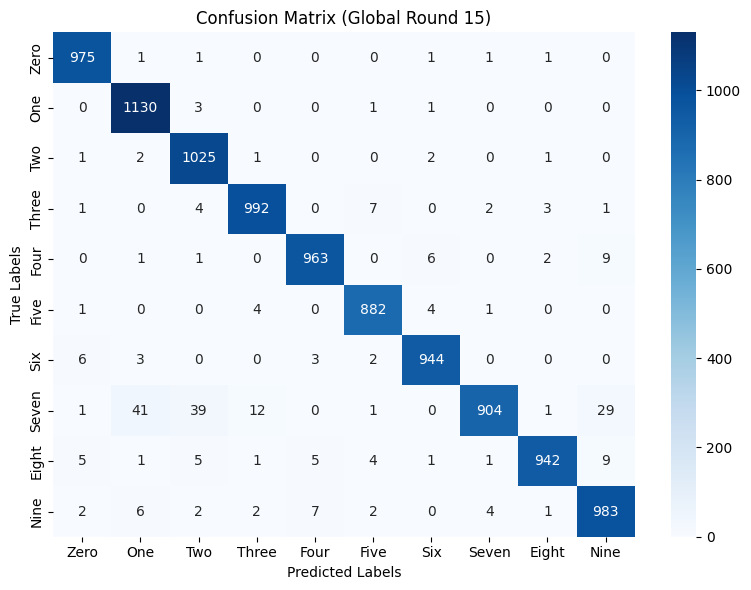


 | Global training round : 16/20 |

Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 14 to flip class  7  to class  1
Label flipping attack launched by Peer 2 to flip class  7  to class  1
Label flipping attack launched by Peer 10 to flip class  7  to class  1

Average test loss: 0.0871, Test accuracy: 9744/10000 (97.44%)

Class      - Accuracy
Zero       - 99.5
One        - 99.6
Two        - 99.4
Three      - 98.0
Four       - 98.2
Five       - 98.7
Six        - 98.6
Seven      - 88.1
Eight      - 96.8
Nine       - 97.6


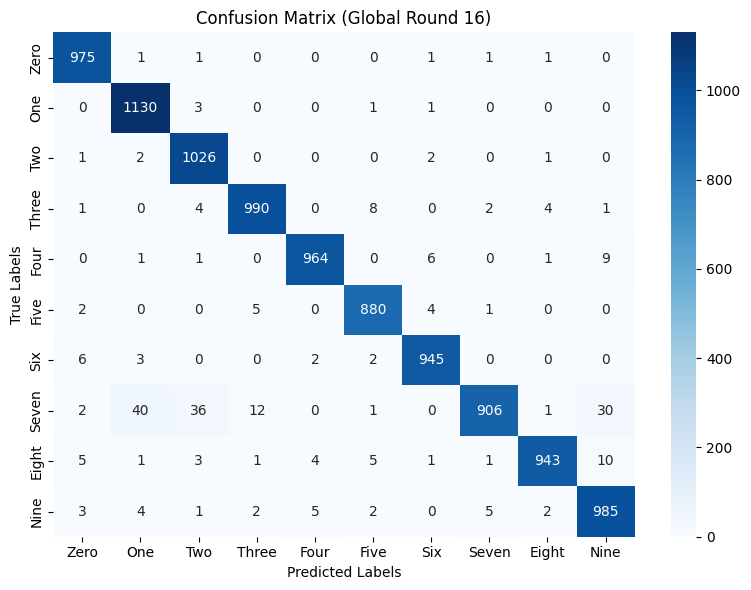


 | Global training round : 17/20 |

Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 10 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 2 to flip class  7  to class  1
Label flipping attack launched by Peer 14 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1

Average test loss: 0.0850, Test accuracy: 9764/10000 (97.64%)

Class      - Accuracy
Zero       - 99.5
One        - 99.6
Two        - 99.5
Three      - 98.0
Four       - 98.6
Five       - 98.8
Six        - 98.7
Seven      - 89.6
Eight      - 96.9
Nine       - 97.3


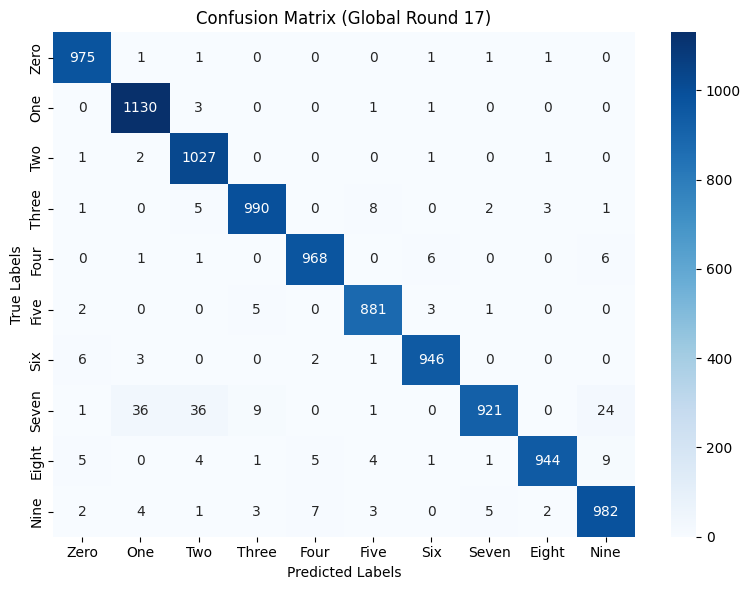


 | Global training round : 18/20 |

Label flipping attack launched by Peer 10 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 14 to flip class  7  to class  1
Label flipping attack launched by Peer 2 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1

Average test loss: 0.0845, Test accuracy: 9756/10000 (97.56%)

Class      - Accuracy
Zero       - 99.5
One        - 99.4
Two        - 99.6
Three      - 98.1
Four       - 98.5
Five       - 98.7
Six        - 98.4
Seven      - 88.9
Eight      - 97.0
Nine       - 97.6


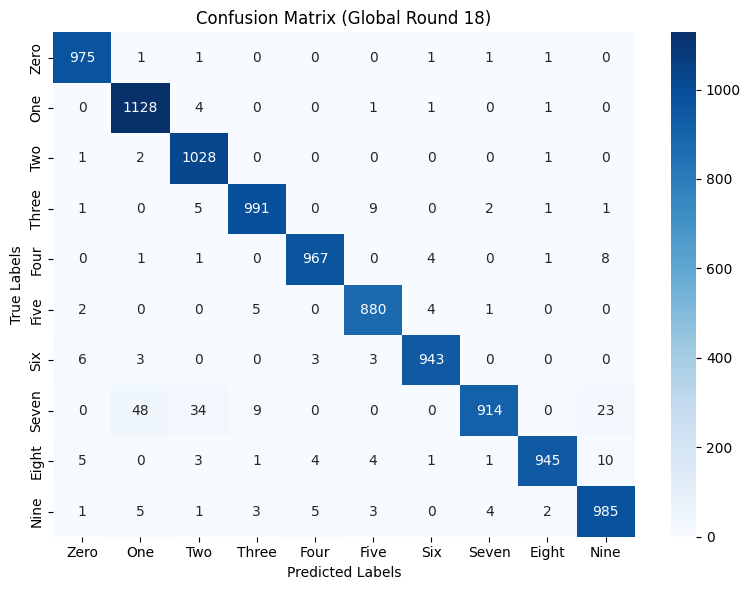


 | Global training round : 19/20 |

Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 2 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 14 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 10 to flip class  7  to class  1

Average test loss: 0.0770, Test accuracy: 9783/10000 (97.83%)

Class      - Accuracy
Zero       - 99.5
One        - 99.5
Two        - 99.6
Three      - 98.4
Four       - 98.5
Five       - 98.8
Six        - 98.7
Seven      - 90.7
Eight      - 97.0
Nine       - 97.7


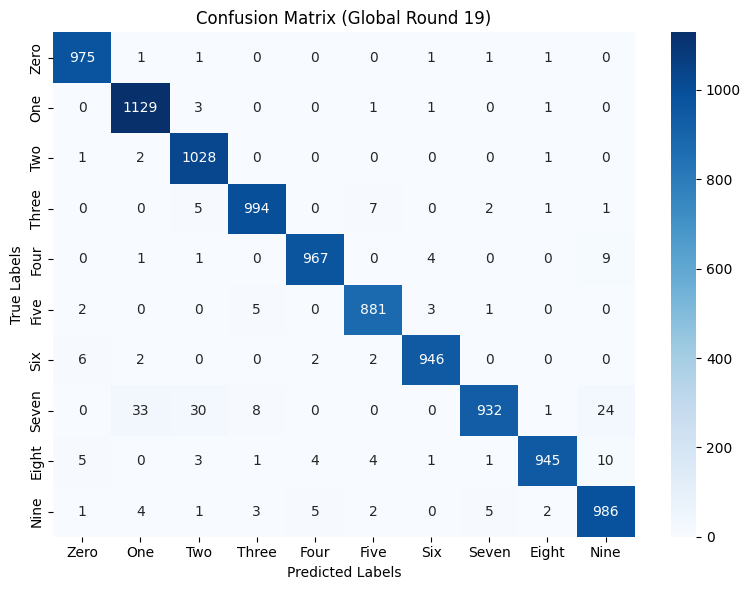


 | Global training round : 20/20 |

Label flipping attack launched by Peer 14 to flip class  7  to class  1
Label flipping attack launched by Peer 3 to flip class  7  to class  1
Label flipping attack launched by Peer 2 to flip class  7  to class  1
Label flipping attack launched by Peer 5 to flip class  7  to class  1
Label flipping attack launched by Peer 12 to flip class  7  to class  1
Label flipping attack launched by Peer 9 to flip class  7  to class  1
Label flipping attack launched by Peer 20 to flip class  7  to class  1
Label flipping attack launched by Peer 10 to flip class  7  to class  1

Average test loss: 0.0767, Test accuracy: 9783/10000 (97.83%)

Class      - Accuracy
Zero       - 99.5
One        - 99.6
Two        - 99.3
Three      - 98.2
Four       - 98.5
Five       - 98.8
Six        - 98.9
Seven      - 91.1
Eight      - 97.0
Nine       - 97.6
Last 10 updates results

Average test loss: 0.0892, Test accuracy: 9737/10000 (97.37%)

*************************************

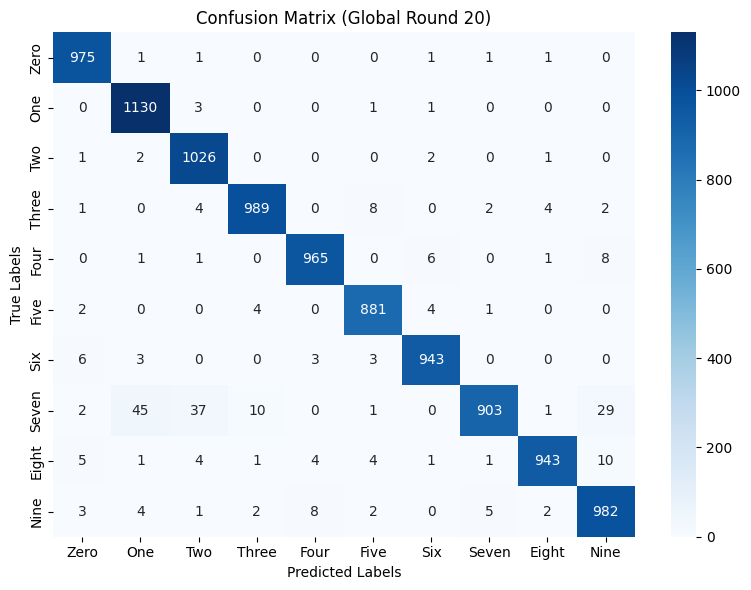

Global accuracies:  [np.float64(74.06), np.float64(87.85), np.float64(91.65), np.float64(92.65), np.float64(93.91), np.float64(94.46), np.float64(95.27), np.float64(95.74), np.float64(96.32), np.float64(96.37), np.float64(96.41), np.float64(96.95), np.float64(97.22), np.float64(97.23), np.float64(97.4), np.float64(97.44), np.float64(97.64), np.float64(97.56), np.float64(97.83), np.float64(97.83), np.float64(97.37)]
Class 7 accuracies:  [np.float64(0.49), np.float64(31.23), np.float64(52.33), np.float64(57.68), np.float64(66.83), np.float64(69.16), np.float64(74.61), np.float64(78.4), np.float64(81.71), np.float64(81.91), np.float64(82.2), np.float64(86.09), np.float64(86.96), np.float64(86.48), np.float64(87.94), np.float64(88.13), np.float64(89.59), np.float64(88.91), np.float64(90.66), np.float64(91.05), np.float64(87.84)]
Test loss: [np.float64(1.1235), np.float64(0.3893), np.float64(0.2612), np.float64(0.2236), np.float64(0.1854), np.float64(0.168), np.float64(0.148), np.float64(0.

In [ ]:
RULE = 'tmean'
ATTACK_TYPE='label_flipping'
MALICIOUS_BEHAVIOR_RATE = 1
for atr in [0.4]:
    run_exp(dataset_name = DATASET_NAME, model_name = MODEL_NAME, dd_type = DD_TYPE, num_peers = NUM_PEERS,
            frac_peers = FRAC_PEERS, seed = SEED, test_batch_size = TEST_BATCH_SIZE,
                criterion = CRITERION, global_rounds = GLOBAL_ROUNDS, local_epochs = LOCAL_EPOCHS, local_bs = LOCAL_BS,
                 local_lr = LOCAL_LR, local_momentum = LOCAL_MOMENTUM, labels_dict = LABELS_DICT, device = DEVICE,
                attackers_ratio = atr, attack_type=ATTACK_TYPE,
                 malicious_behavior_rate = MALICIOUS_BEHAVIOR_RATE, rule = RULE,
                source_class = SOURCE_CLASS, target_class = TARGET_CLASS,
               class_per_peer = CLASS_PER_PEER, samples_per_class = SAMPLES_PER_CLASS,
               rate_unbalance = RATE_UNBALANCE, alpha = ALPHA, resume = False)